In [ ]:
pip install --quiet --upgrade --pre mesa[rec] #installs Mesa 3.0

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.3/44.3 kB 3.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 226.5/226.5 kB 15.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 52.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 9.6/9.6 MB 93.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 15.7/15.7 MB 83.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 107.9/107.9 kB 9.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 73.3/73.3 kB 6.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 63.7/63.7 kB 5.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.1/79.1 kB 6.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 425.7/425.7 kB 31.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 168.2/168.2 kB 15.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 263.4/263.4 kB 21.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1

In [ ]:
import mesa

# Data visualization tools.
import seaborn as sns

# Has multi-dimensional arrays and matrices. Has a large collection of
# mathematical functions to operate on these arrays.
import numpy as np

# Data manipulation and analysis.
import pandas as pd

import string

import time

import matplotlib.pyplot as plt #Para mostrar los semaforos

# Agente


In [ ]:
class CarAgent(mesa.Agent):

  def __init__(self, model,destination):
    super().__init__(model)
    self.isParked = False
    self.isMoving = True
    self.destination = destination

    posDestination=self.model.grid.properties["Estacionamiento"].select_cells(lambda x: x == self.destination)
    posDestinationAround=[(posDestination[0][0]+1,posDestination[0][1]),(posDestination[0][0]-1,posDestination[0][1]),(posDestination[0][0],posDestination[0][1]+1),(posDestination[0][0],posDestination[0][1]-1)]
    for p in posDestinationAround:
      if self.model.grid.properties["Left"].data[p]==1 or self.model.grid.properties["Right"].data[p]==1 or self.model.grid.properties["Up"].data[p]==1 or self.model.grid.properties["Down"].data[p]==1:
        self.destinationStreet=p

  def move(self):
    possibleMoves=[]

    #select posible movements

    if self.model.grid.properties["Left"].data[self.pos] == 1 :
      possibleMoves.append((self.pos[0],self.pos[1]-1))
      if self.pos[0]!=self.model.grid.width-1:
        if self.model.grid.properties["Left"].data[self.pos[0]+1,self.pos[1]-1]==1:
          possibleMoves.append((self.pos[0]+1,self.pos[1]-1))
      if self.pos[0]!=0:
        if self.model.grid.properties["Left"].data[self.pos[0]-1,self.pos[1]-1]==1:
          possibleMoves.append((self.pos[0]-1,self.pos[1]-1))

    if self.model.grid.properties["Right"].data[self.pos] == 1 :
      possibleMoves.append((self.pos[0],self.pos[1]+1))
      if self.pos[0]!=self.model.grid.width-1:
        if self.model.grid.properties["Right"].data[self.pos[0]+1,self.pos[1]+1]==1:
          possibleMoves.append((self.pos[0]+1,self.pos[1]+1))
      if self.pos[0]!=0:
        if self.model.grid.properties["Right"].data[self.pos[0]-1,self.pos[1]+1]==1:
          possibleMoves.append((self.pos[0]-1,self.pos[1]+1))

    if self.model.grid.properties["Up"].data[self.pos] == 1 :
      possibleMoves.append((self.pos[0]-1,self.pos[1]))
      if self.pos[1]!=self.model.grid.height-1:
        if self.model.grid.properties["Up"].data[self.pos[0]-1,self.pos[1]+1]==1:
          possibleMoves.append((self.pos[0]-1,self.pos[1]+1))
      if self.pos[1]!=0:
        if self.model.grid.properties["Up"].data[self.pos[0]-1,self.pos[1]-1]==1:
          possibleMoves.append((self.pos[0]-1,self.pos[1]-1))

    if self.model.grid.properties["Down"].data[self.pos] == 1 :
      possibleMoves.append((self.pos[0]+1,self.pos[1]))
      if self.pos[1]!=self.model.grid.height-1:
        if self.model.grid.properties["Down"].data[self.pos[0]+1,self.pos[1]+1]==1:
          possibleMoves.append((self.pos[0]+1,self.pos[1]+1))
      if self.pos[1]!=0:
        if self.model.grid.properties["Down"].data[self.pos[0]+1,self.pos[1]-1]==1:
          possibleMoves.append((self.pos[0]+1,self.pos[1]-1))

    #verify possible cells are available (there aren't cars in them) y semaforos
    invalidPostions = [] #temporal

    for pos in possibleMoves:
      cellmates = self.model.grid.get_cell_list_contents([pos]) #Obtener el contenido de la cleda
      # print(f"-------- CELLMATES TIENE:{cellmates}")
      for agent in cellmates:
        if isinstance(agent, CarAgent): #Buscar agentes carro
          invalidPostions.append(pos)
        if isinstance(agent, SemaforoAgent):
          if not agent.colorState: #Buscar agentes semaforo rojo
            invalidPostions.append(pos)

    #Eliminamos las posiciones invalidas
    for pos in invalidPostions: #Recorrer posiciones invalidas
      if pos in possibleMoves: #Remover posiciones invalidad
        possibleMoves.remove(pos)



    #select next move
    if len(possibleMoves) > 0:
      min_moves=[]
      min_moves.append(possibleMoves[0])
      print(min_moves)
      min_distance=abs(self.destinationStreet[0]-min_moves[0][0])+abs(self.destinationStreet[1]-min_moves[0][1])

      for i in possibleMoves:
        distance=abs(self.destinationStreet[0]-i[0])+abs(self.destinationStreet[1]-i[1])
        if distance<min_distance:
          min_moves.append(i)
          min_distance=distance
      for m in min_moves:
        distance=abs(self.destinationStreet[0]-m[0])+abs(self.destinationStreet[1]-m[1])
        if distance>min_distance:
          min_moves.remove(m)

      min_move=min_moves[self.random.randrange(len(min_moves))]

      #move agent
      self.model.grid.move_agent(self, min_move)

  def isDestination(self):
    neighbours=self.model.grid.get_neighborhood(self.pos, moore=False, include_center=False)
    for n in neighbours:
      #print(n)
      if self.model.grid.properties["Estacionamiento"].data[n]==self.destination:
        self.model.grid.move_agent(self,n)
        self.isParked = True
        print(f"carro {self.unique_id} estacionado")
        self.model.parked+=1
    return self.isParked

  def lookingPark(self):
    if self.isMoving:
      self.move()
    else:
      self.isMoving = False
      self.isParked = True
      pass

  def carHi(self):
    print(f"Carro #{self.unique_id} | Posición: {self.pos}")

  def checkSemaforo(self):
    neighbors = self.model.grid.get_neighbors(self.pos, moore=False, include_center=True) #Se incluye el centro porque el carro puede estar "abajo" del semaforo

    for agent in neighbors:
      if isinstance(agent, SemaforoAgent):
        return agent.colorState #Refresamos si el semaforo esta

    return True #Decimos que el semaforo esta en verde para que siga avanzando


  def checkAnnotherCarr(self):
    neighbors  =self.model.grid.get_neighbors(self.pos, moore=False, include_center=False)
    if isinstance(agent, CarAgent):
      print(f"Carro #{self.unique_id} en: {self.pos} ve el carro #{agent.unique_id} en {agent.pos}")
      return True #Avisa que tenemos un carro cerca
    return False #Avisa que el camino esta despejado



class SemaforoAgent(mesa.Agent):
  def __init__(self, model, colorBool):
    super().__init__(model)
    self.colorState = colorBool #True -> Verde | False -> Rojo
    self.stepCounter = 0
    self.time = 0

  def changeColor(self):
    self.time += 1/4

    if self.time >= 10:
      self.time = 0 #Reiniciamos el contador
      self.colorState = not self.colorState #Invertimos el color
      print(f"Semaforo {self.unique_id} cambión de color")
      self.say_hi()


  def say_hi(self):
    if self.colorState:
      print(f"Semaforo: {self.unique_id} | Color: VERDE | Posicion {self.pos}")
    else:
      print(f"Semaforo: {self.unique_id} | Color: ROJO | Posicion {self.pos}")

#Modelo

In [ ]:
#model

class CityModel(mesa.Model):
    def __init__(self, carsNum, seed=None):
      super().__init__(seed=seed)
      self.carsNum = carsNum
      self.width=24
      self.height=24
      self.running = True
      self.parked=0

      #create property layers
      propertyUp=mesa.space.PropertyLayer("Up",self.width, self.height, 0)
      propertyDown=mesa.space.PropertyLayer("Down",self.width, self.height,0)
      propertyRight=mesa.space.PropertyLayer("Right",self.width, self.height, 0)
      propertyLeft=mesa.space.PropertyLayer("Left",self.width, self.height, 0)
      propertyEstacionamiento=mesa.space.PropertyLayer("Estacionamiento",self.width, self.height, 0)

      #create grid
      self.grid=mesa.space.MultiGrid(self.width, self.height, False,property_layers=[propertyEstacionamiento,propertyUp,propertyDown,propertyRight,propertyLeft])

      #define grid's property layers
      self.estacionamientos=[(2,9),(3,2),(3,17),(4,11),(4,20),(5,6),(8,8),(9,21),(10,4),(10,11),(10,16),(17,2),(17,17),(17,19),(20,5),(20,8),(20,19)]
      for i in range(len(self.estacionamientos)):
        self.grid.properties["Estacionamiento"].set_cell((self.estacionamientos[i][1],self.estacionamientos[i][0]),i+1)

      self.direccionDerecha=[[[1,11],[14,15]],[[15,21],[14,15]],[[12,14],[15,15]],[[7,11],[18,19]],[[0,22],[22,23]]]
      self.direccionIzquierda=[[[1,23],[0,1]],[[8,12],[5,6]],[[16,22],[6,7]],[[2,12],[12,13]],[[16,22],[12,13]],[[13,15],[12,12]],[[2,6],[18,19]]]
      self.direccionAbajo=[[[0,1],[0,21]],[[6,7],[15,21]],[[12,13],[1,11]],[[12,13],[15,21]],[[12,12],[12,14]]]
      self.direccionArriba=[[[6,7],[2,12]],[[14,15],[2,12]],[[14,15],[16,22]],[[15,15],[13,15]],[[18,19],[16,22]],[[22,23],[2,23]]]

      for r in self.direccionDerecha:
        for i in range(r[1][0],r[1][1]+1 ):
          for j in range(r[0][0],r[0][1]+1):
            self.grid.properties["Right"].set_cell((i,j),1)

      for l in self.direccionIzquierda:
        for i in range(l[1][0],l[1][1]+1):
          for j in range(l[0][0],l[0][1]+1):
            self.grid.properties["Left"].set_cell((i,j),1)

      for d in self.direccionAbajo:
        for i in range(d[1][0],d[1][1]+1):
          for j in range(d[0][0],d[0][1]+1):
            self.grid.properties["Down"].set_cell((i,j),1)

      for u in self.direccionArriba:
        for i in range(u[1][0],u[1][1]+1):
          for j in range(u[0][0],u[0][1]+1):
            self.grid.properties["Up"].set_cell((i,j),1)


      # --------------------------------- CREACIÓN DE SEMAFOROS ----------------------------------
      semVer = [[6,2],[7,2],[6,7],[7,7],[0,17],[1,17],[6,21],[7,21],[18,16],[19,16]] #Revisar esto | Valores invertidos
      semRoj = [[8,0],[8,1],[8,5],[8,6],[2,18],[2,19],[5,22],[5,23],[17,14],[17,15]]

      #Semaforos verdes
      for sv in semVer:
        self.grid.place_agent(SemaforoAgent(self,True),(sv[1],sv[0]))

      #Semaforos rojos
      for sr in semRoj:
        self.grid.place_agent(SemaforoAgent(self,False),(sr[1],sr[0]))


      # ------------------------------------  CREACIÓN DE CARROS  ------------------------------------
      estacionamientosSeleccionados=[]
      for _ in range(self.carsNum):
        estacionamiento = self.random.randrange(1,18)
        while estacionamiento in estacionamientosSeleccionados:
          estacionamiento = self.random.randrange(1,18)
        estacionamientosSeleccionados.append(estacionamiento)
        c = CarAgent(self,estacionamiento)
        added = False

        while not added: #Asegurar que el carro sea agregado y no se quede con posición NONE
          x = self.random.randrange(self.grid.width)
          y = self.random.randrange(self.grid.height)

          cellmates = self.grid.get_cell_list_contents([x,y])

          if not any(isinstance(agent, CarAgent) for agent in cellmates): #Revisamos que no tengamos agentes Carro en la celda
            #Revisar si la celda es viable
            if self.grid.properties["Up"].data[x,y]:
              self.grid.place_agent(c, (x, y))
              added = True
            elif self.grid.properties["Down"].data[x,y]:
              self.grid.place_agent(c, (x, y))
              added = True
            elif self.grid.properties["Left"].data[x,y]:
              self.grid.place_agent(c, (x, y))
              added = True
            elif self.grid.properties["Right"].data[x,y]:
              self.grid.place_agent(c, (x,y))
              added = True

        print(f"Carro #{c.unique_id} | agregado en posición: {c.pos}")

      self.running = True

    def step(self):
      for agent in self.agents: #Iterar sobre todos los agentes del modelo
          if isinstance(agent, SemaforoAgent):
              #Acciones para los semaforos
              agent.changeColor()
          if isinstance(agent, CarAgent):
              #Accioens para los carros
              if agent.isParked==False:
                if agent.isDestination()==False:
                  agent.move()
              else:
                pass


In [ ]:
# Inicializar matrices
def show_agents():
  agent_counts = np.zeros((m.grid.width, m.grid.height))
  color_map = np.zeros((m.grid.width, m.grid.height))

  # Rellenar matrices
  for cell_content, (x, y) in m.grid.coord_iter():
      agent_count = len(cell_content)
      agent_counts[x][y] = agent_count
      for agent in cell_content:
          if isinstance(agent, SemaforoAgent):
              color_map[x][y] = 1 if agent.colorState else -1  # 1 para verde, -1 para rojo
          if isinstance(agent, CarAgent):
              color_map[x][y] = 2  # 2 para carros
      if m.grid.properties["Estacionamiento"].data[x, y]:
          color_map[x][y] = 3  # 3 para estacionamiento

  # Trasponer las matrices si es necesario
  #agent_counts = agent_counts.T
  #color_map = color_map.T

  # Crear una paleta de colores personalizada
  custom_cmap = sns.color_palette(["red", "white", "green", "blue", "yellow"], as_cmap=True)

  # Plot usando seaborn
  g = sns.heatmap(color_map, cmap=custom_cmap, annot=True, cbar=False, square=True, linewidths=0.5, linecolor='black')
  g.figure.set_size_inches(5, 5)
  g.set(title="Estado de los semáforos en la cuadricula")
  plt.show()


In [ ]:
m=CityModel(10)
for a in m.agents:
  if isinstance(a, CarAgent):
    print(a.destination)

Carro #21 | agregado en posición: (4, 0)
14


<ipython-input-117-bcfb99632dd4>:13: UserWarning: Default value 0 (int) might not be best suitable with dtype=float64.
  propertyUp=mesa.space.PropertyLayer("Up",self.width, self.height, 0)
<ipython-input-117-bcfb99632dd4>:14: UserWarning: Default value 0 (int) might not be best suitable with dtype=float64.
  propertyDown=mesa.space.PropertyLayer("Down",self.width, self.height,0)
<ipython-input-117-bcfb99632dd4>:15: UserWarning: Default value 0 (int) might not be best suitable with dtype=float64.
  propertyRight=mesa.space.PropertyLayer("Right",self.width, self.height, 0)
<ipython-input-117-bcfb99632dd4>:16: UserWarning: Default value 0 (int) might not be best suitable with dtype=float64.
  propertyLeft=mesa.space.PropertyLayer("Left",self.width, self.height, 0)
<ipython-input-117-bcfb99632dd4>:17: UserWarning: Default value 0 (int) might not be best suitable with dtype=float64.
  propertyEstacionamiento=mesa.space.PropertyLayer("Estacionamiento",self.width, self.height, 0)


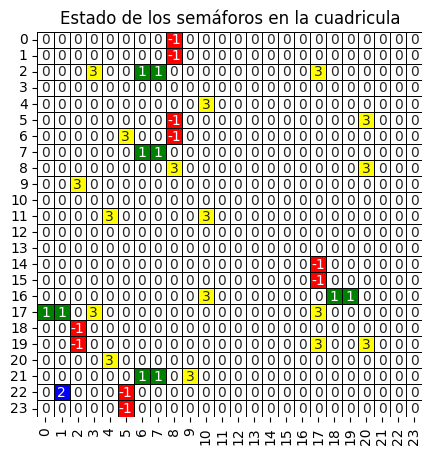

posicion: (22, 1)
[(22, 2)]


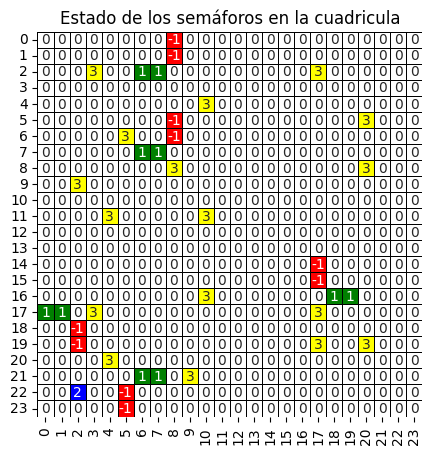

posicion: (22, 2)
[(22, 3)]


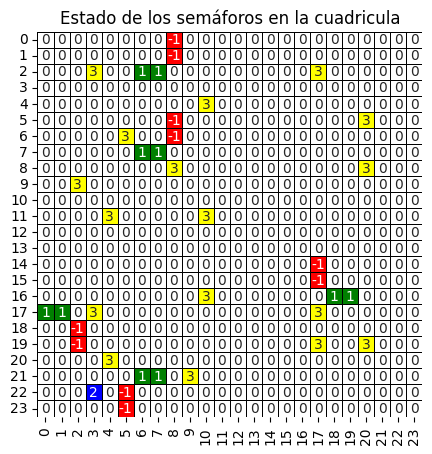

posicion: (22, 3)
[(22, 4)]


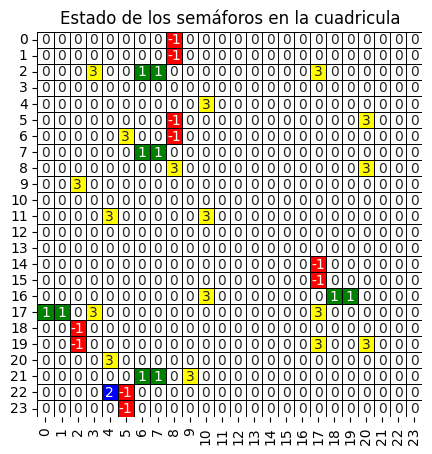

posicion: (22, 4)


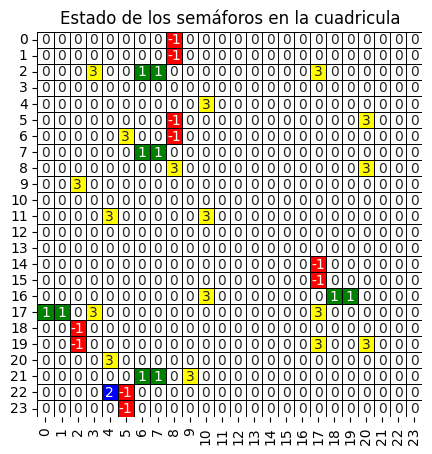

posicion: (22, 4)


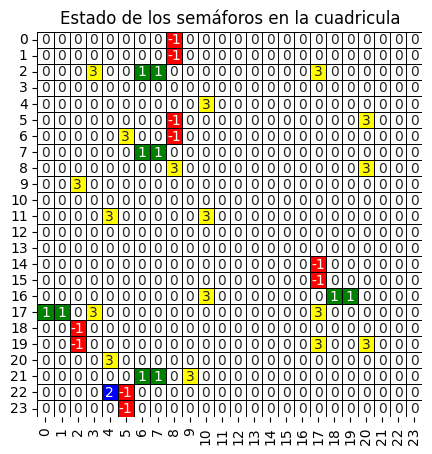

posicion: (22, 4)


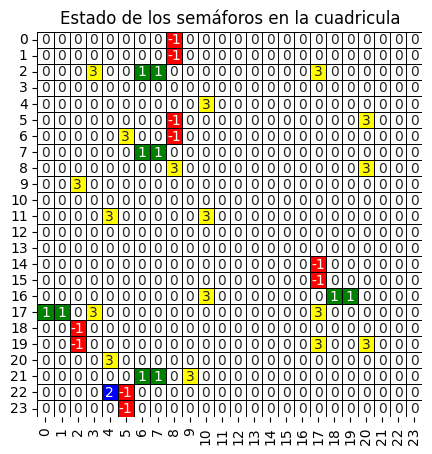

posicion: (22, 4)


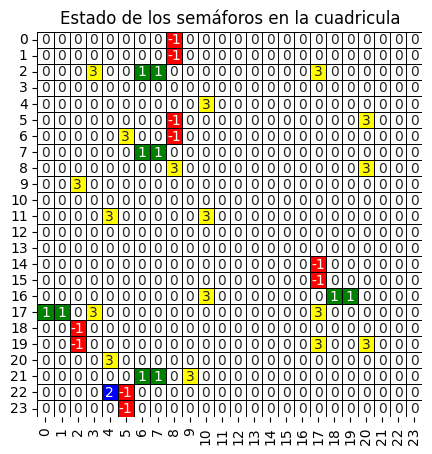

posicion: (22, 4)


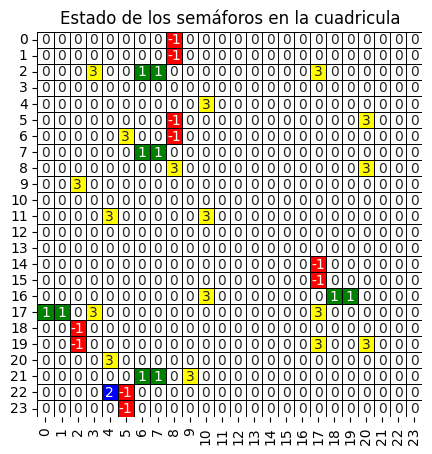

posicion: (22, 4)


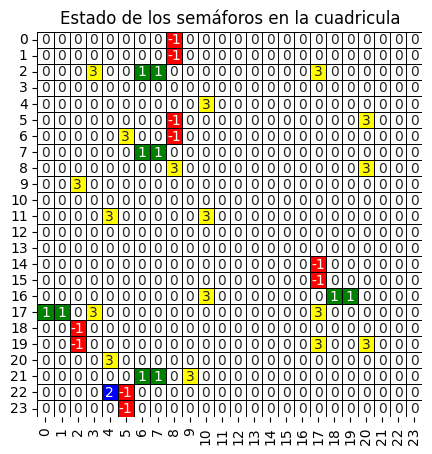

posicion: (22, 4)


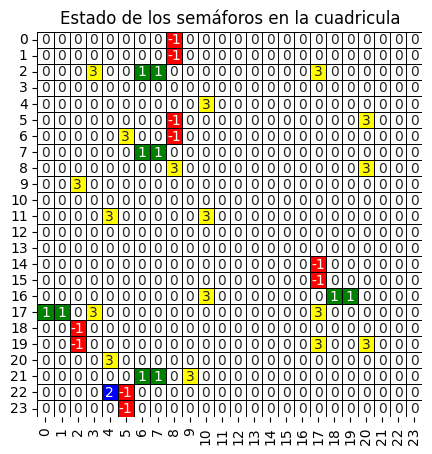

posicion: (22, 4)


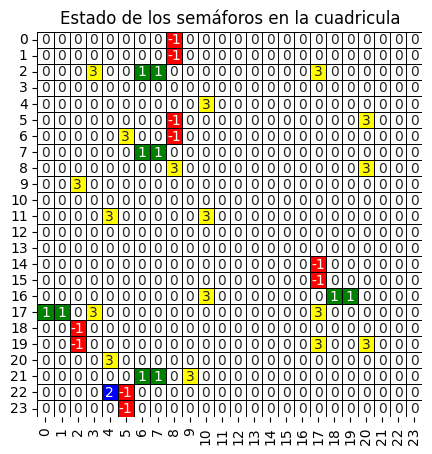

posicion: (22, 4)


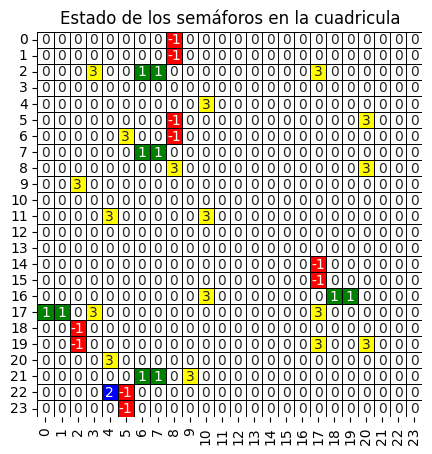

posicion: (22, 4)


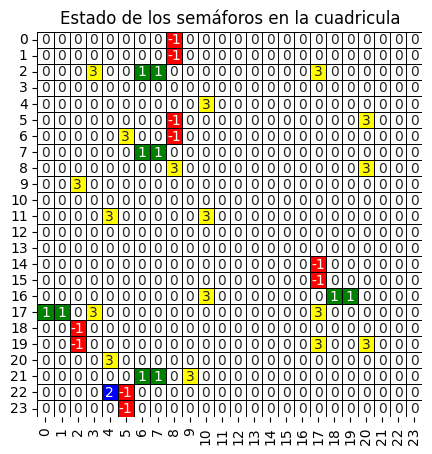

posicion: (22, 4)


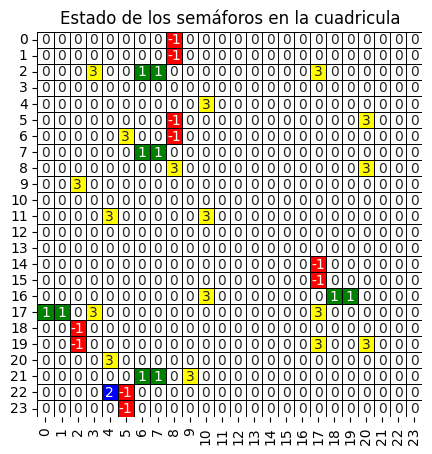

posicion: (22, 4)


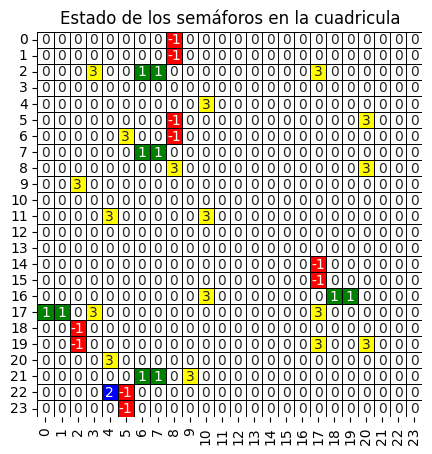

posicion: (22, 4)


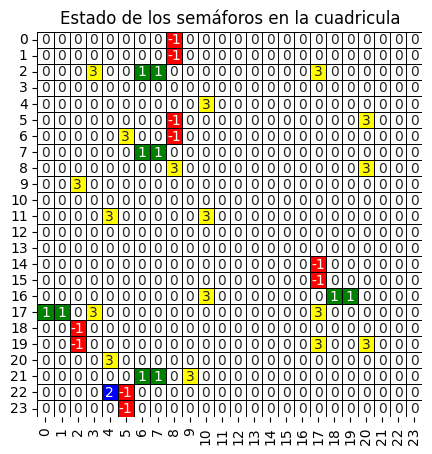

posicion: (22, 4)


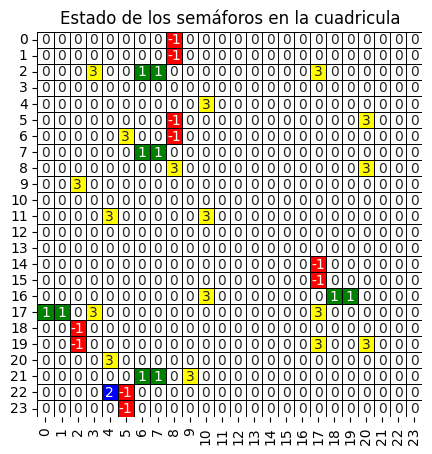

posicion: (22, 4)


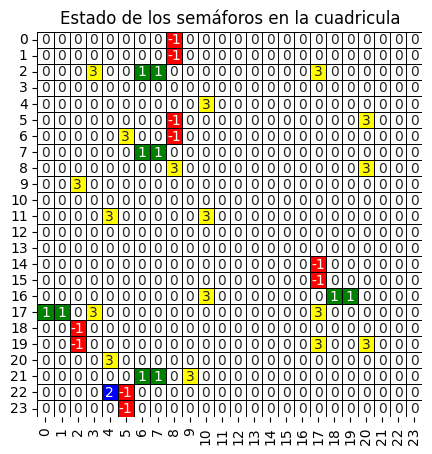

posicion: (22, 4)


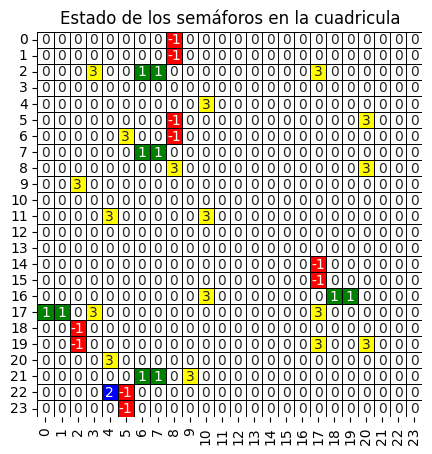

posicion: (22, 4)


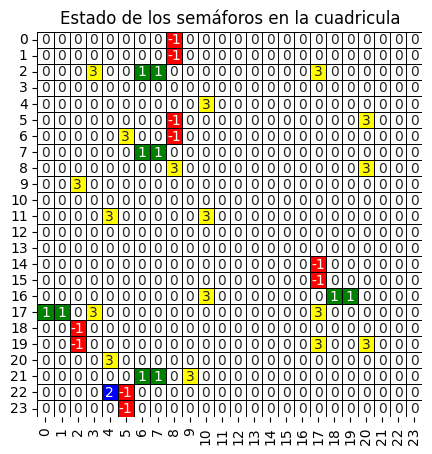

posicion: (22, 4)


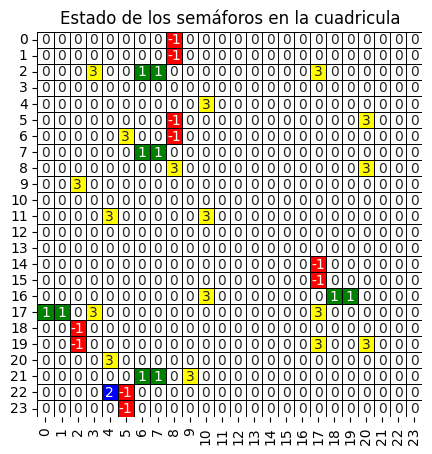

posicion: (22, 4)


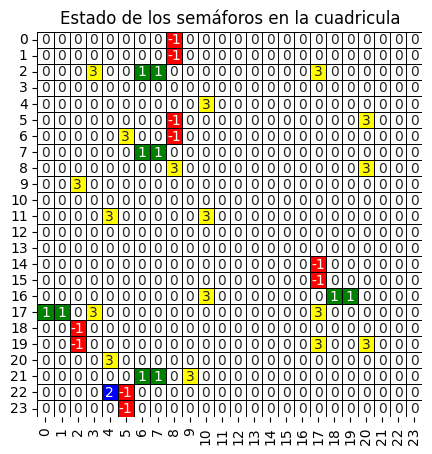

posicion: (22, 4)


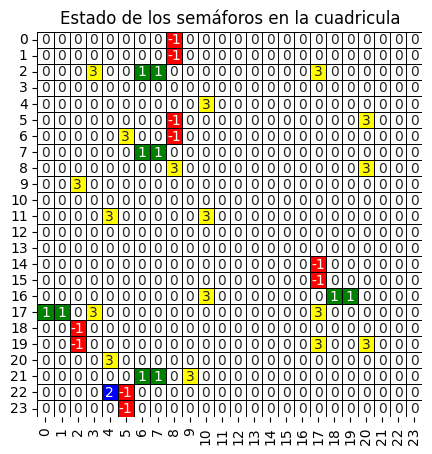

posicion: (22, 4)


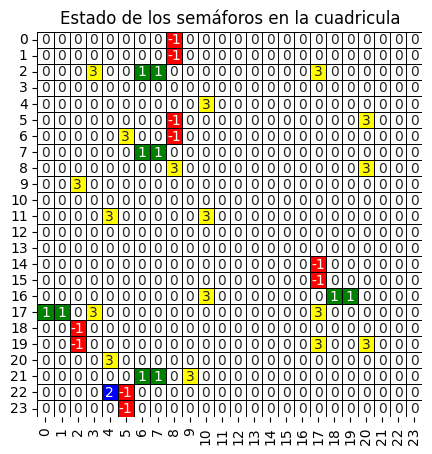

posicion: (22, 4)


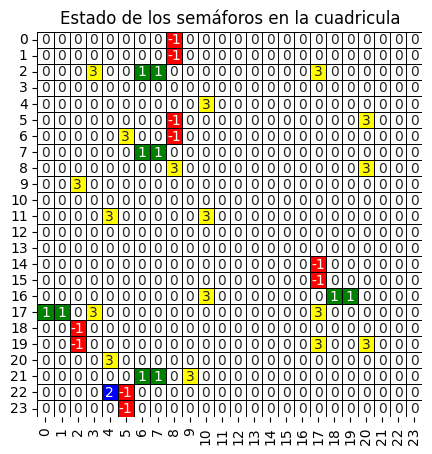

posicion: (22, 4)


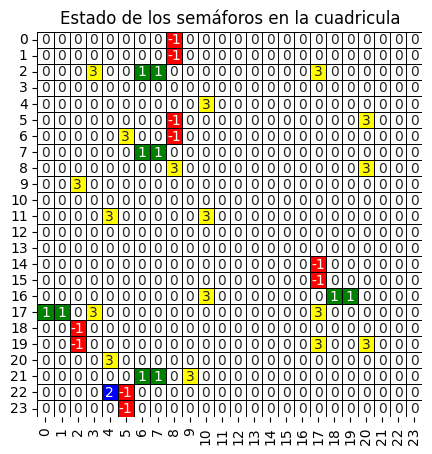

posicion: (22, 4)


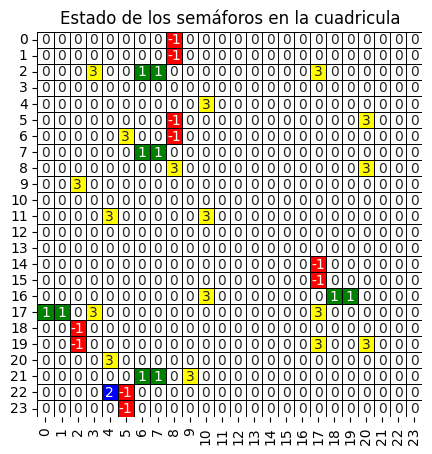

posicion: (22, 4)


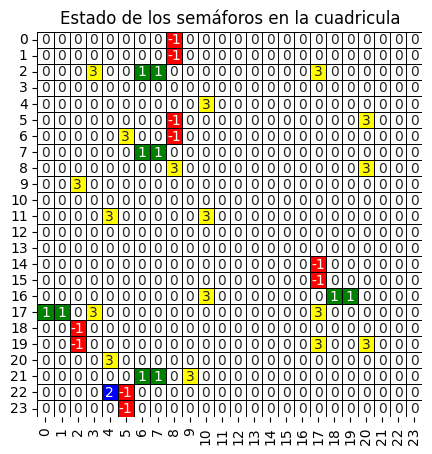

posicion: (22, 4)


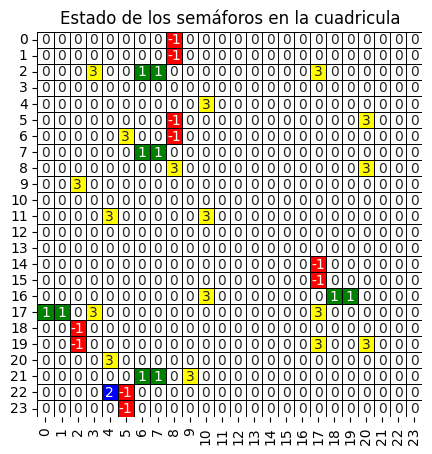

posicion: (22, 4)


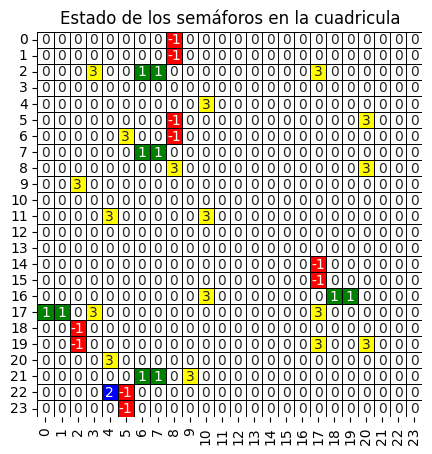

posicion: (22, 4)


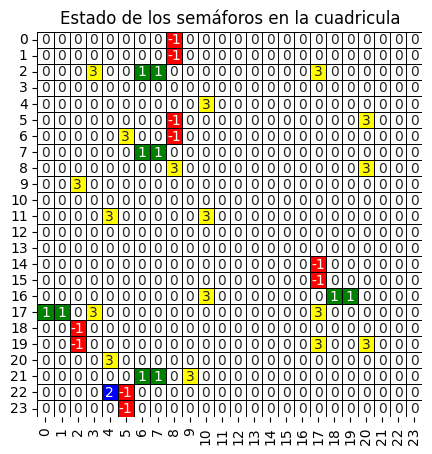

posicion: (22, 4)


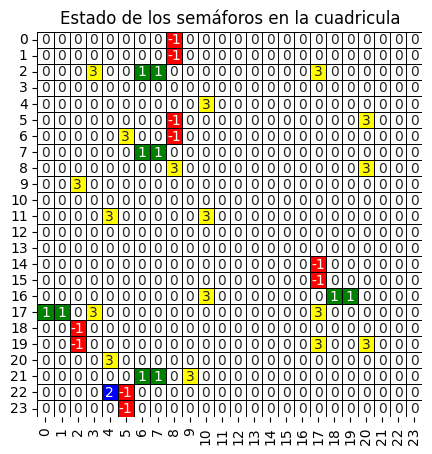

posicion: (22, 4)


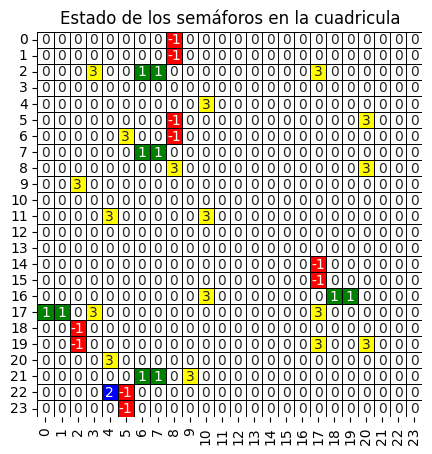

posicion: (22, 4)


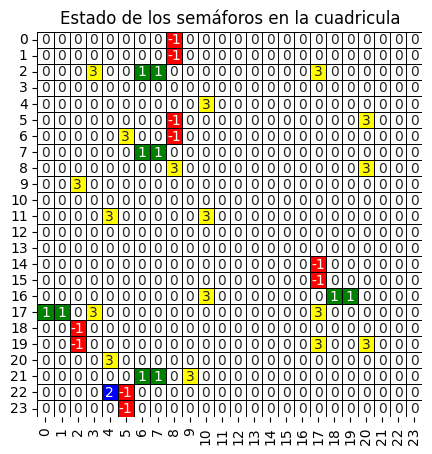

posicion: (22, 4)


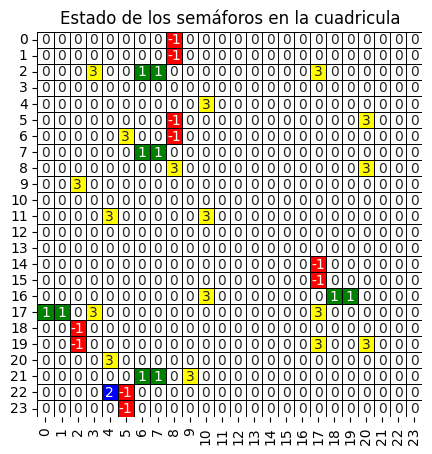

posicion: (22, 4)


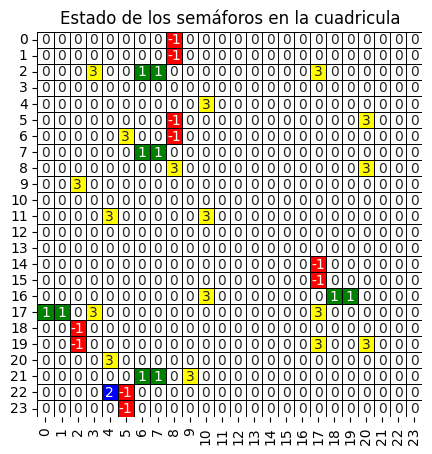

posicion: (22, 4)


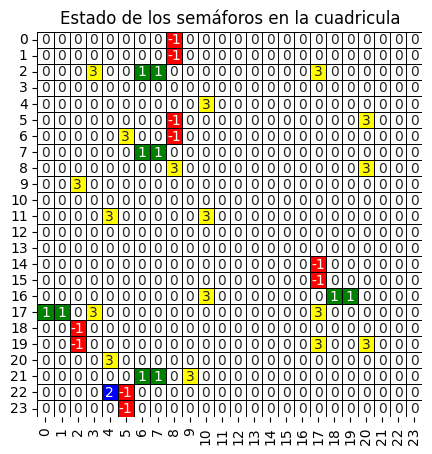

posicion: (22, 4)


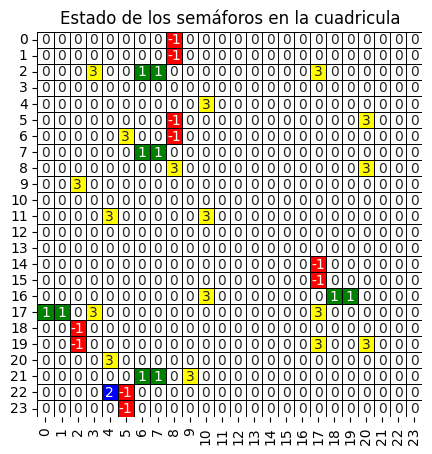

posicion: (22, 4)


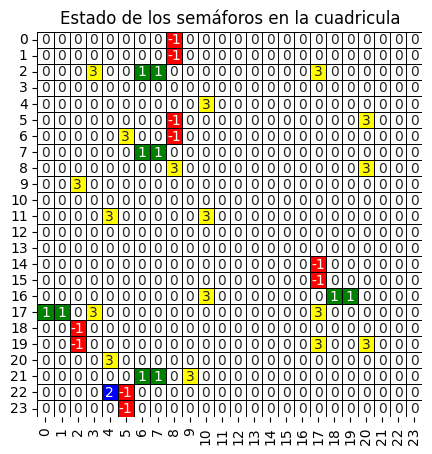

Semaforo 1 cambión de color
Semaforo: 1 | Color: ROJO | Posicion (2, 6)
Semaforo 2 cambión de color
Semaforo: 2 | Color: ROJO | Posicion (2, 7)
Semaforo 3 cambión de color
Semaforo: 3 | Color: ROJO | Posicion (7, 6)
Semaforo 4 cambión de color
Semaforo: 4 | Color: ROJO | Posicion (7, 7)
Semaforo 5 cambión de color
Semaforo: 5 | Color: ROJO | Posicion (17, 0)
Semaforo 6 cambión de color
Semaforo: 6 | Color: ROJO | Posicion (17, 1)
Semaforo 7 cambión de color
Semaforo: 7 | Color: ROJO | Posicion (21, 6)
Semaforo 8 cambión de color
Semaforo: 8 | Color: ROJO | Posicion (21, 7)
Semaforo 9 cambión de color
Semaforo: 9 | Color: ROJO | Posicion (16, 18)
Semaforo 10 cambión de color
Semaforo: 10 | Color: ROJO | Posicion (16, 19)
Semaforo 11 cambión de color
Semaforo: 11 | Color: VERDE | Posicion (0, 8)
Semaforo 12 cambión de color
Semaforo: 12 | Color: VERDE | Posicion (1, 8)
Semaforo 13 cambión de color
Semaforo: 13 | Color: VERDE | Posicion (5, 8)
Semaforo 14 cambión de color
Semaforo: 14 | C

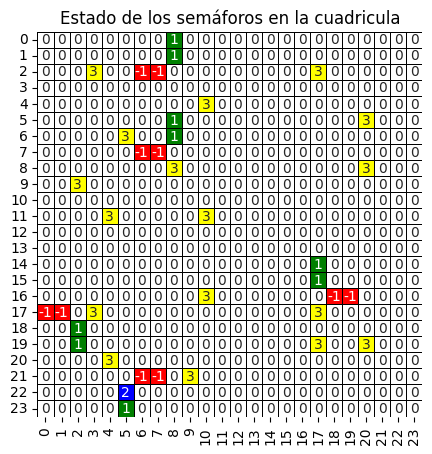

posicion: (22, 5)
[(22, 6)]


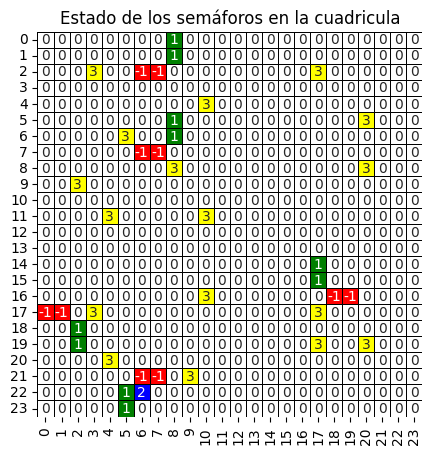

posicion: (22, 6)
[(22, 7)]


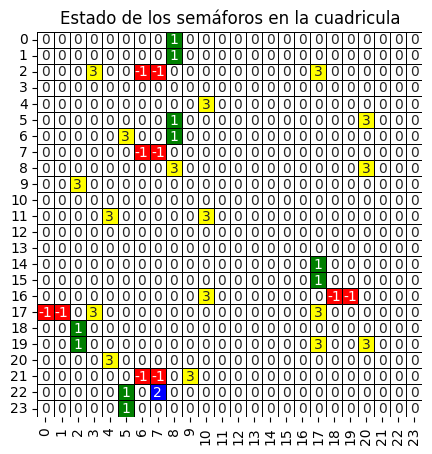

posicion: (22, 7)
[(22, 8)]


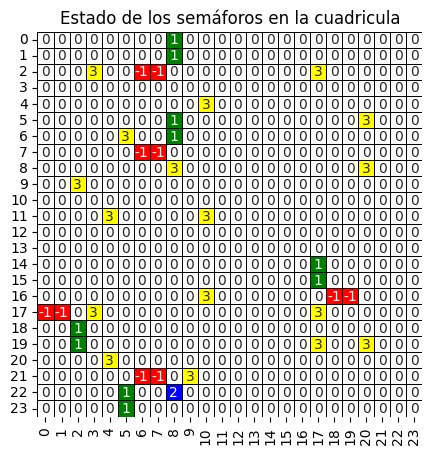

posicion: (22, 8)
[(22, 9)]


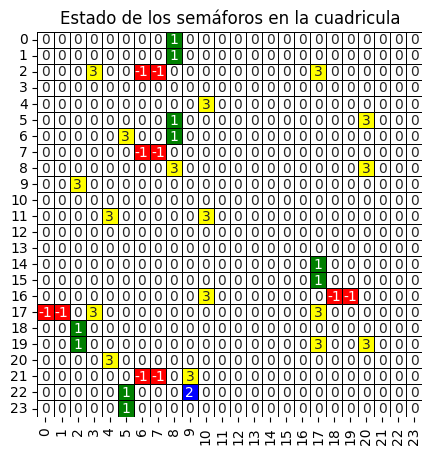

posicion: (22, 9)
[(22, 10)]


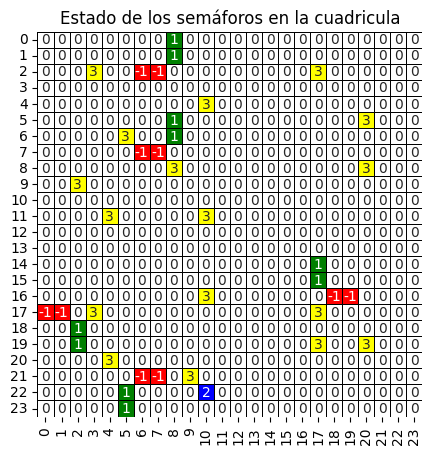

posicion: (22, 10)
[(22, 11)]


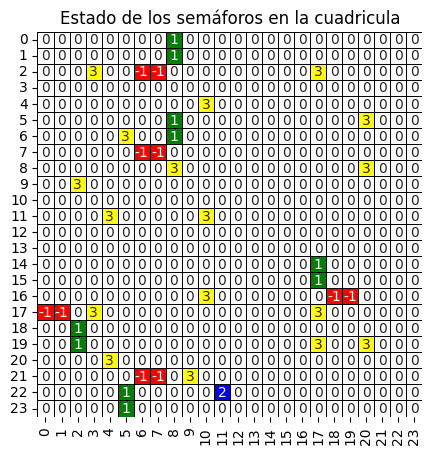

posicion: (22, 11)
[(22, 12)]


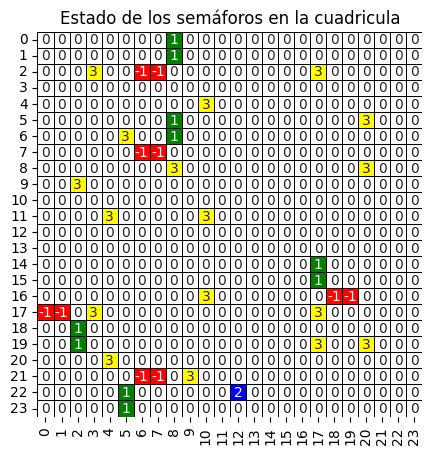

posicion: (22, 12)
[(22, 13)]


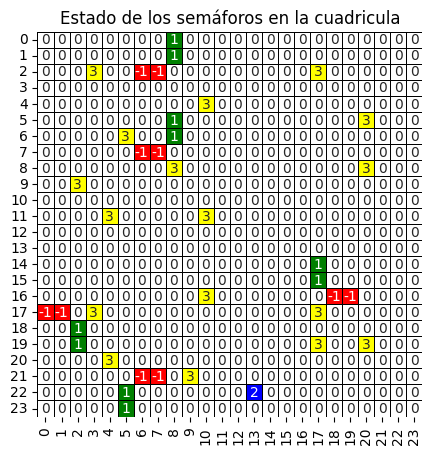

posicion: (22, 13)
[(22, 14)]


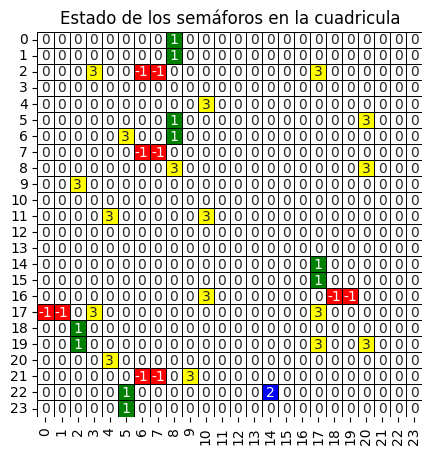

posicion: (22, 14)
[(22, 15)]


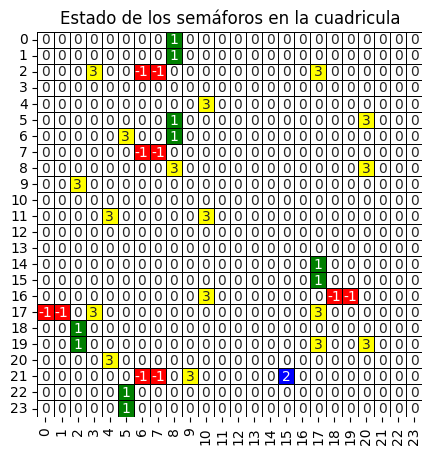

posicion: (21, 15)
[(20, 15)]


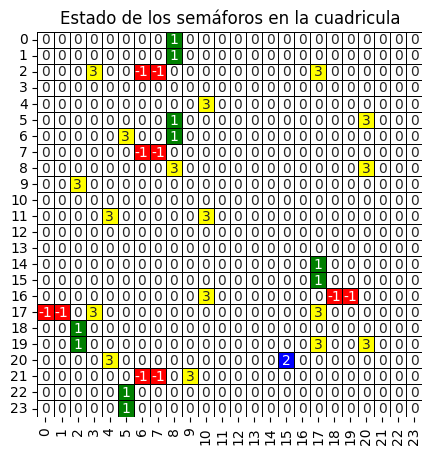

posicion: (20, 15)
[(19, 15)]


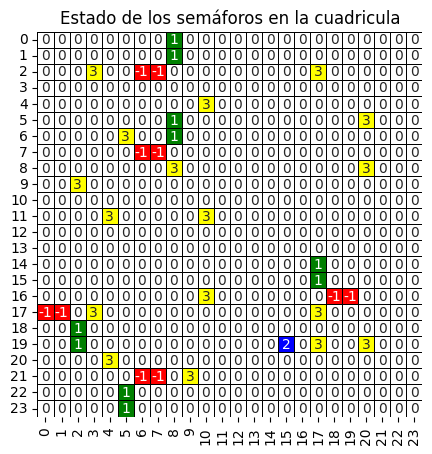

posicion: (19, 15)
[(18, 15)]


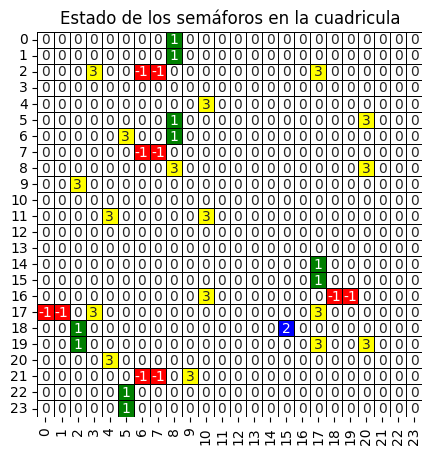

posicion: (18, 15)
[(17, 15)]


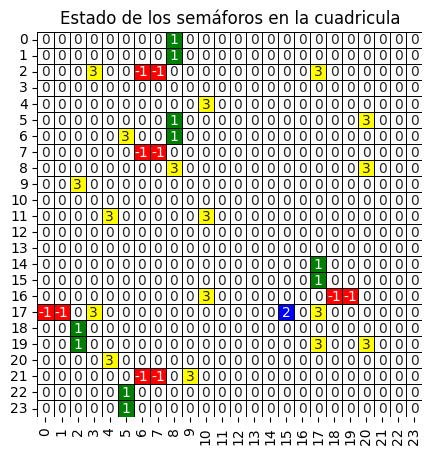

posicion: (17, 15)
[(16, 15)]


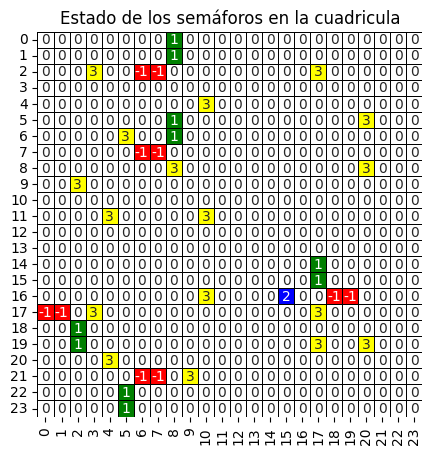

posicion: (16, 15)
[(15, 15)]


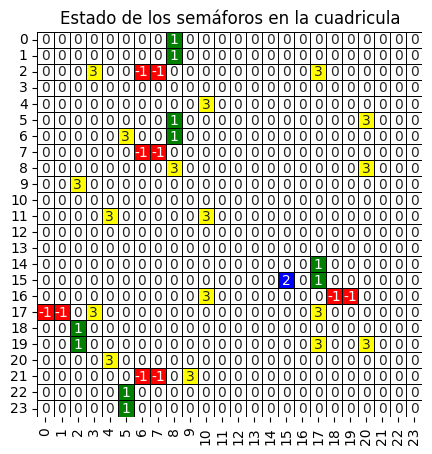

posicion: (15, 15)
[(15, 16)]


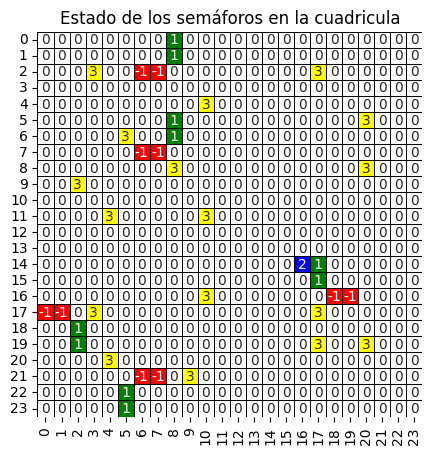

posicion: (14, 16)
[(14, 17)]


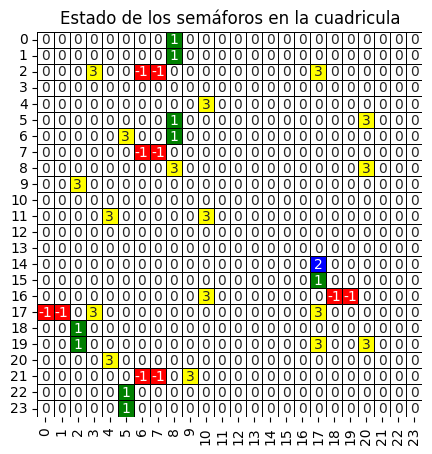

posicion: (14, 17)
[(14, 18)]


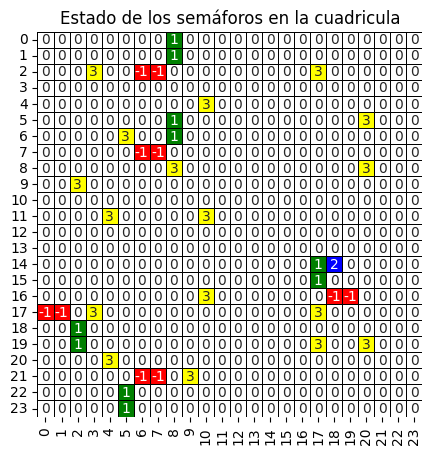

posicion: (14, 18)
[(14, 19)]


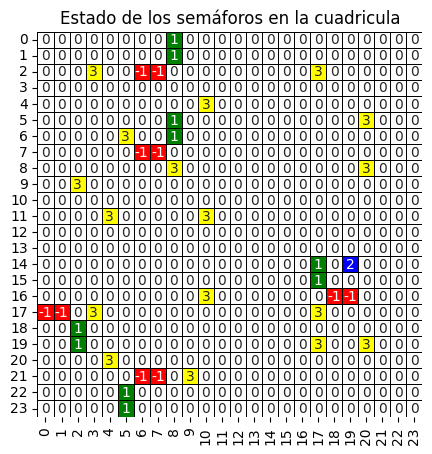

posicion: (14, 19)
[(14, 20)]


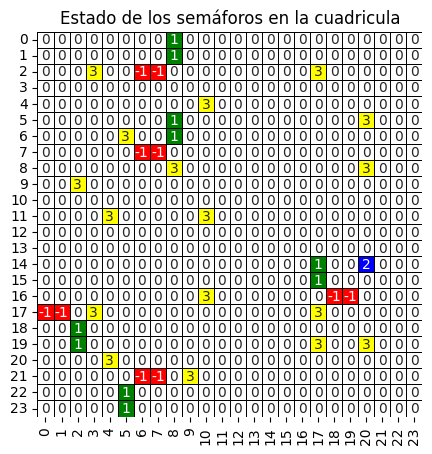

posicion: (14, 20)
[(14, 21)]


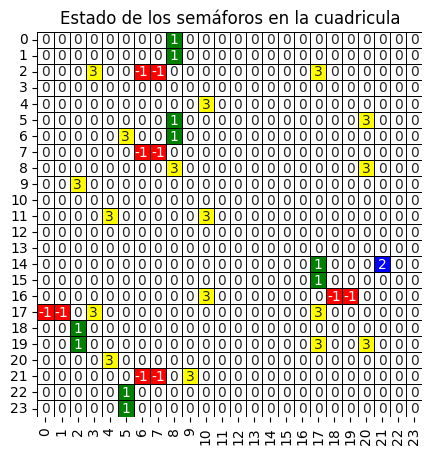

posicion: (14, 21)
[(14, 22)]


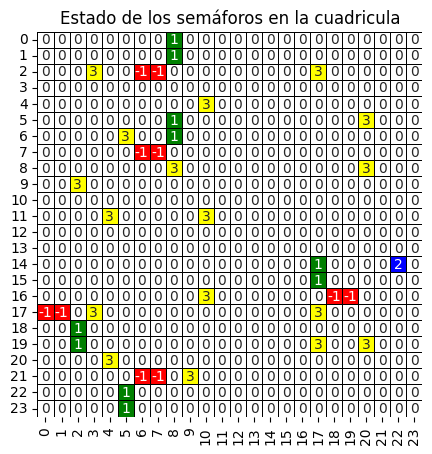

posicion: (14, 22)
[(13, 22)]


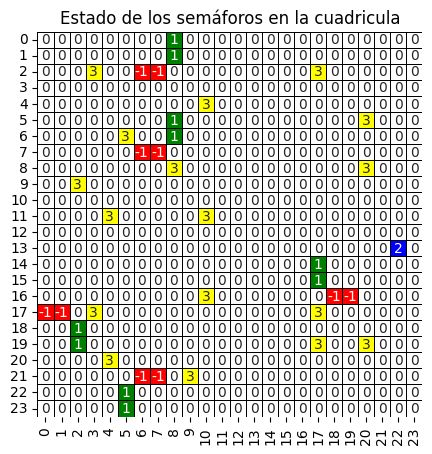

posicion: (13, 22)
[(13, 21)]


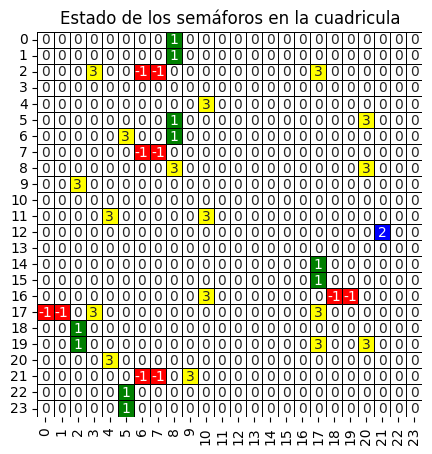

posicion: (12, 21)
[(12, 20)]


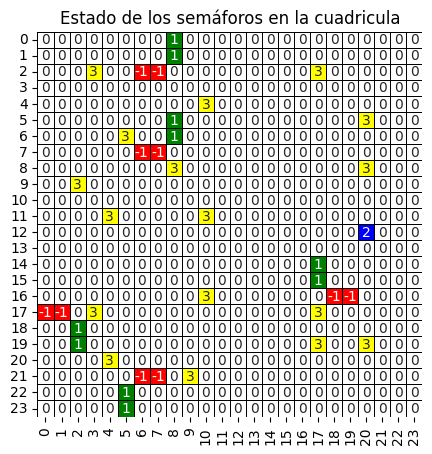

posicion: (12, 20)
[(12, 19)]


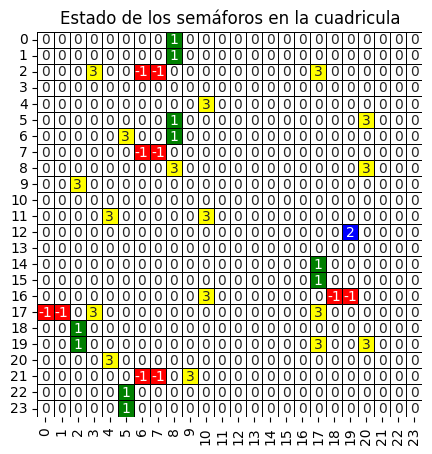

posicion: (12, 19)
[(12, 18)]


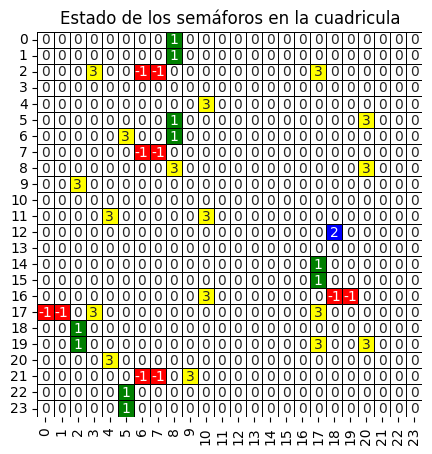

posicion: (12, 18)
[(12, 17)]


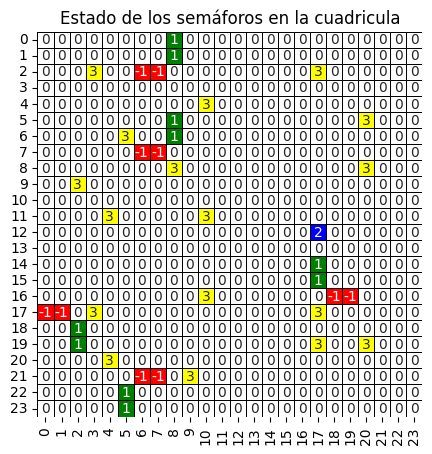

posicion: (12, 17)
[(12, 16)]


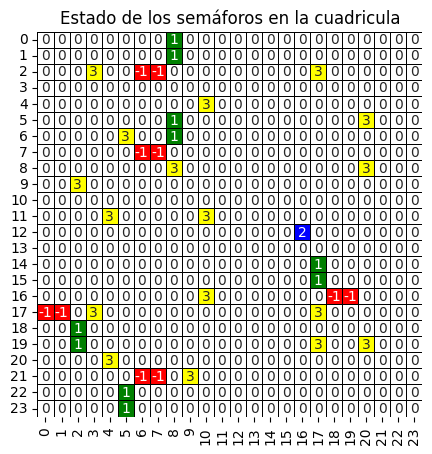

posicion: (12, 16)
[(12, 15)]


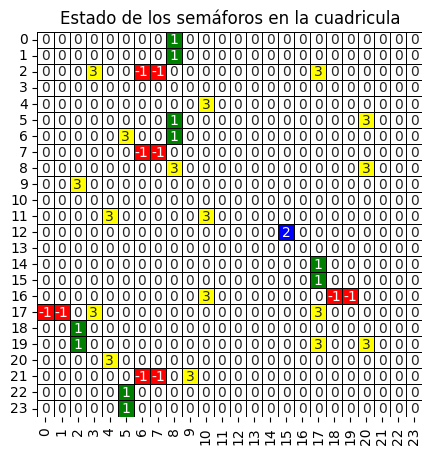

posicion: (12, 15)
[(12, 14)]


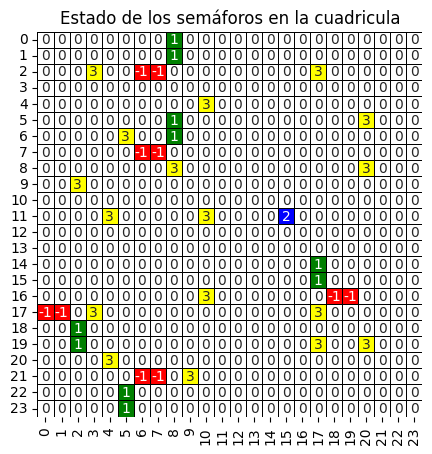

posicion: (11, 15)
[(10, 15)]


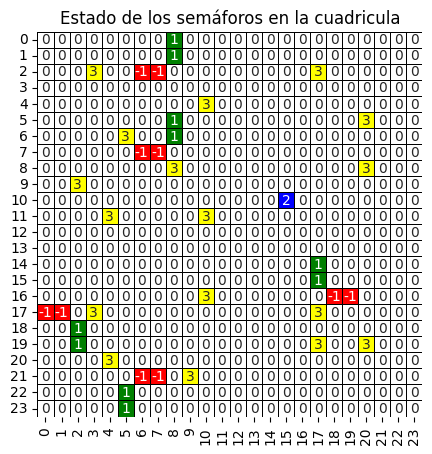

posicion: (10, 15)
[(9, 15)]


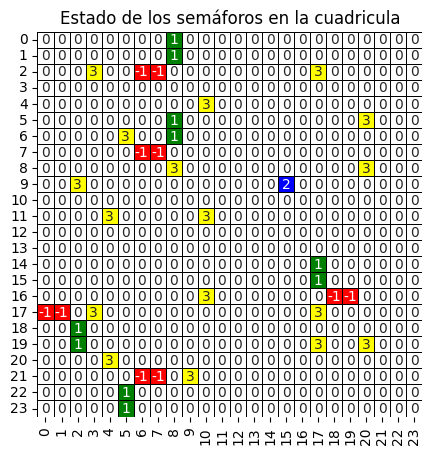

posicion: (9, 15)
[(8, 15)]


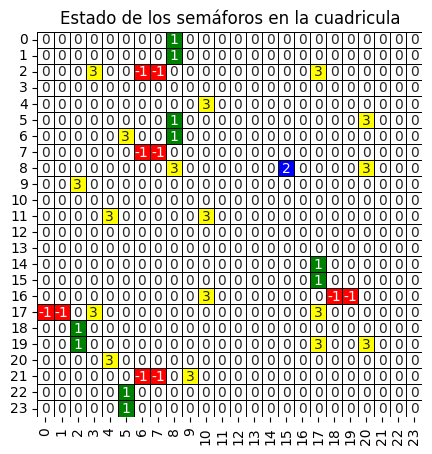

posicion: (8, 15)
[(7, 15)]


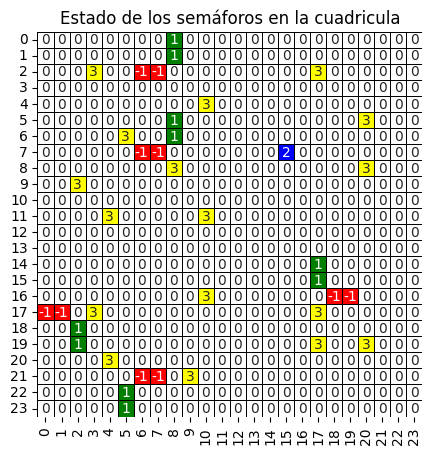

posicion: (7, 15)
[(6, 15)]


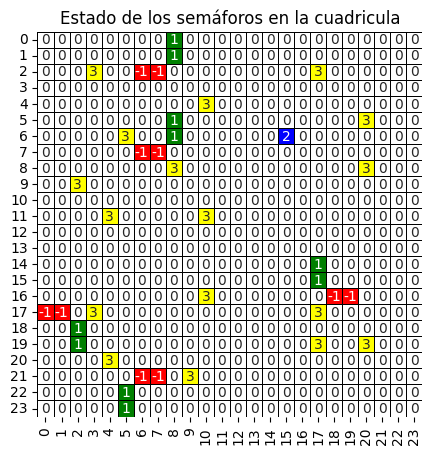

posicion: (6, 15)
[(5, 15)]


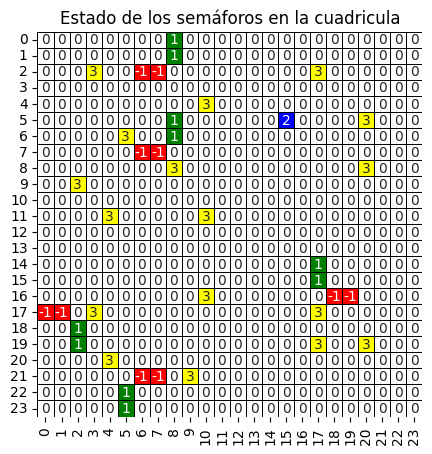

posicion: (5, 15)
[(4, 15)]


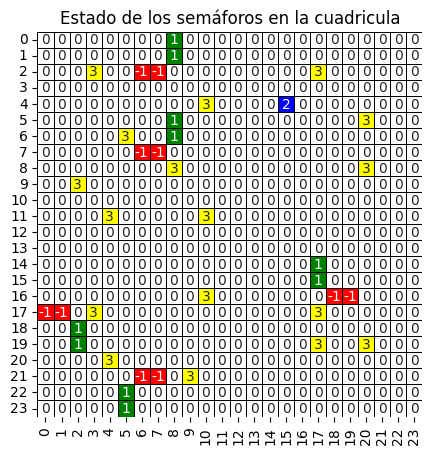

Semaforo 1 cambión de color
Semaforo: 1 | Color: VERDE | Posicion (2, 6)
Semaforo 2 cambión de color
Semaforo: 2 | Color: VERDE | Posicion (2, 7)
Semaforo 3 cambión de color
Semaforo: 3 | Color: VERDE | Posicion (7, 6)
Semaforo 4 cambión de color
Semaforo: 4 | Color: VERDE | Posicion (7, 7)
Semaforo 5 cambión de color
Semaforo: 5 | Color: VERDE | Posicion (17, 0)
Semaforo 6 cambión de color
Semaforo: 6 | Color: VERDE | Posicion (17, 1)
Semaforo 7 cambión de color
Semaforo: 7 | Color: VERDE | Posicion (21, 6)
Semaforo 8 cambión de color
Semaforo: 8 | Color: VERDE | Posicion (21, 7)
Semaforo 9 cambión de color
Semaforo: 9 | Color: VERDE | Posicion (16, 18)
Semaforo 10 cambión de color
Semaforo: 10 | Color: VERDE | Posicion (16, 19)
Semaforo 11 cambión de color
Semaforo: 11 | Color: ROJO | Posicion (0, 8)
Semaforo 12 cambión de color
Semaforo: 12 | Color: ROJO | Posicion (1, 8)
Semaforo 13 cambión de color
Semaforo: 13 | Color: ROJO | Posicion (5, 8)
Semaforo 14 cambión de color
Semaforo:

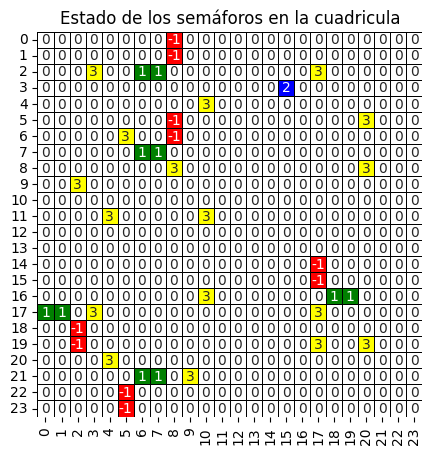

posicion: (3, 15)
[(2, 15)]


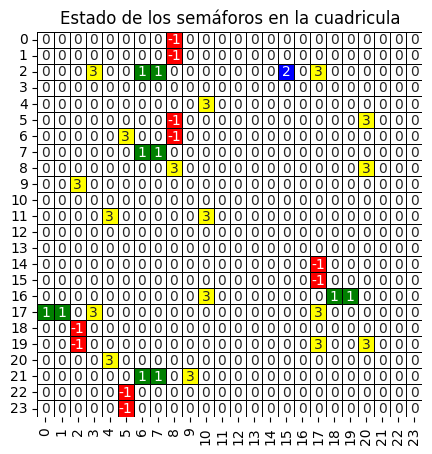

posicion: (2, 15)
[(1, 15)]


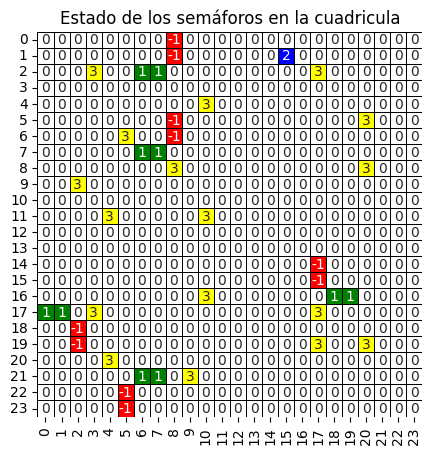

posicion: (1, 15)
[(1, 14)]


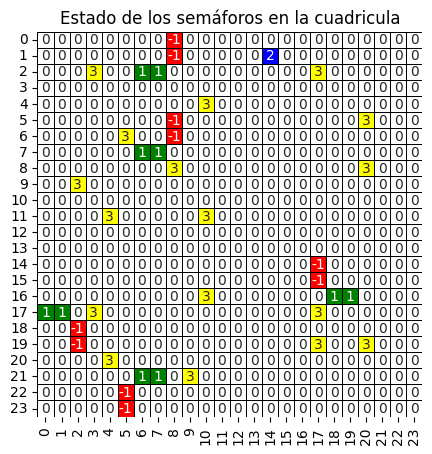

posicion: (1, 14)
[(1, 13)]


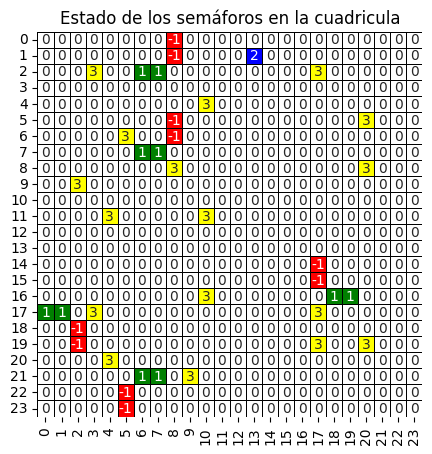

posicion: (1, 13)
[(1, 12)]


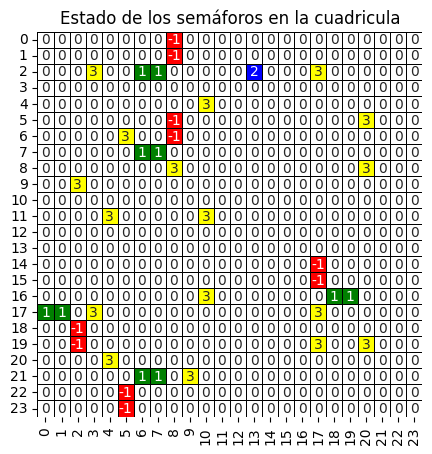

posicion: (2, 13)
[(3, 13)]


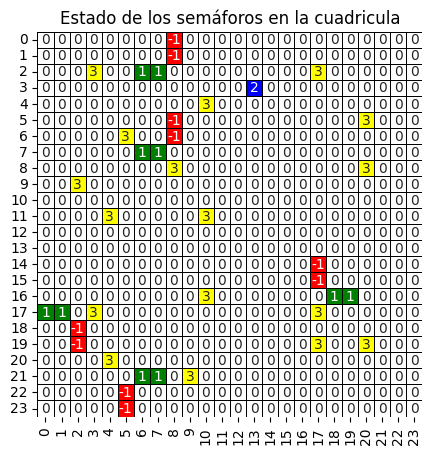

posicion: (3, 13)
[(4, 13)]


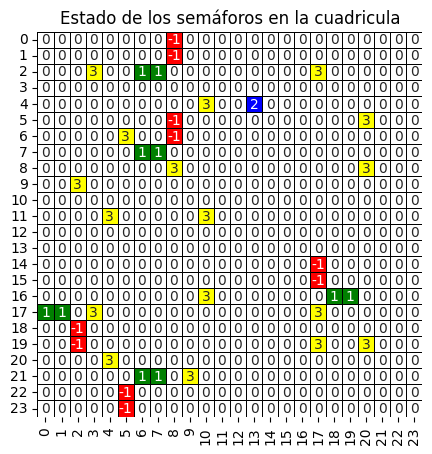

posicion: (4, 13)
[(5, 13)]


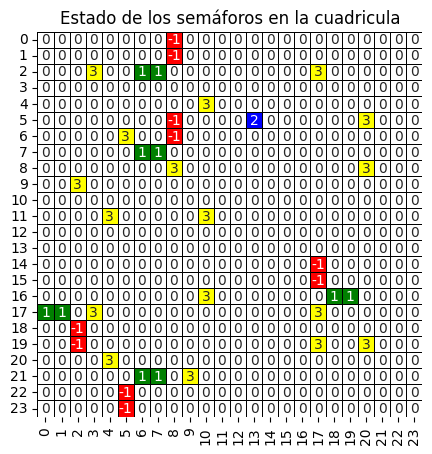

posicion: (5, 13)
[(6, 13)]


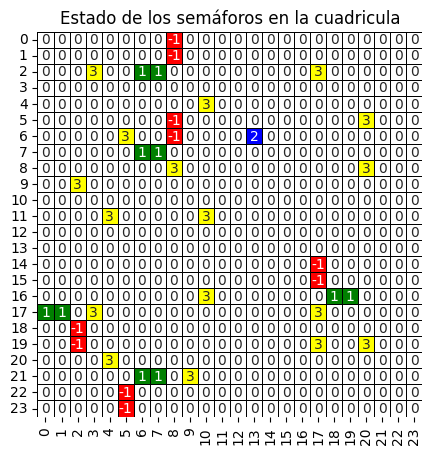

posicion: (6, 13)
[(7, 13)]


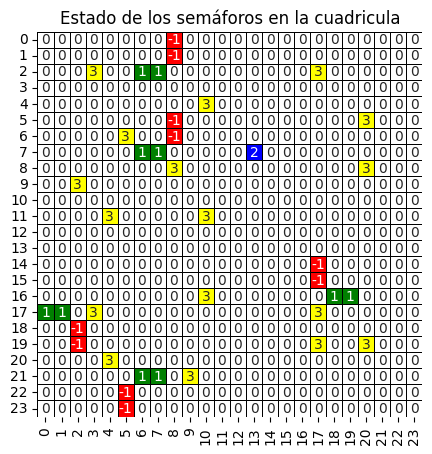

posicion: (7, 13)
[(8, 13)]


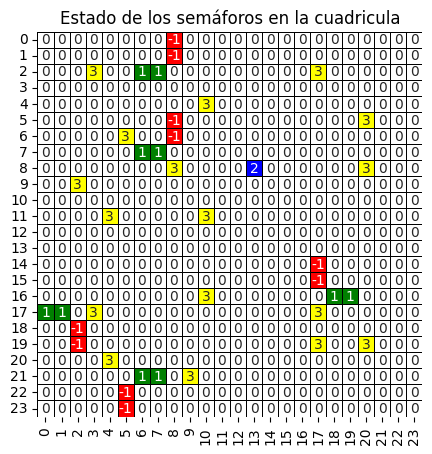

posicion: (8, 13)
[(9, 13)]


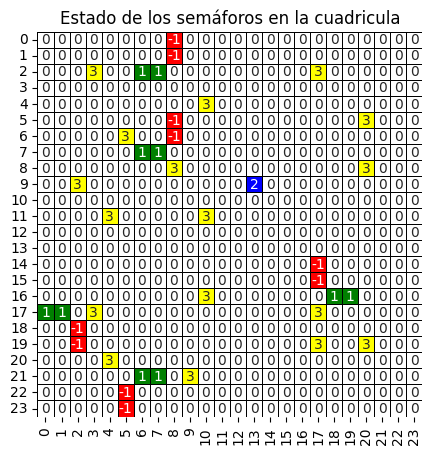

posicion: (9, 13)
[(10, 13)]


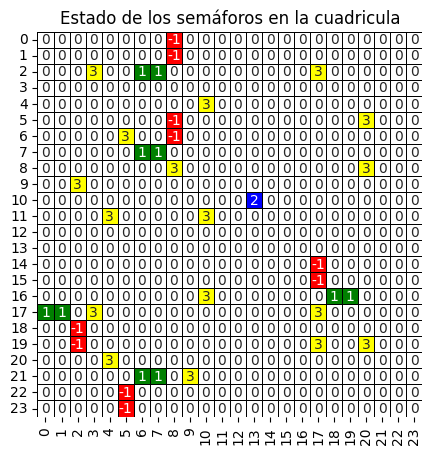

posicion: (10, 13)
[(11, 13)]


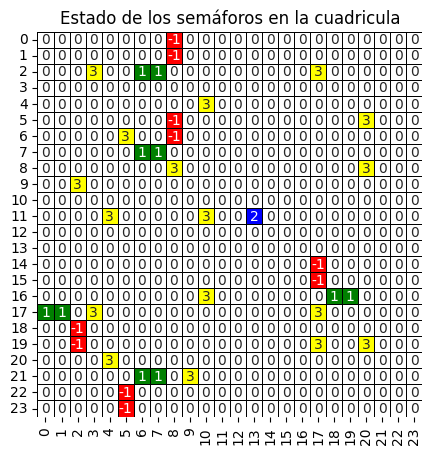

posicion: (11, 13)
[(12, 13)]


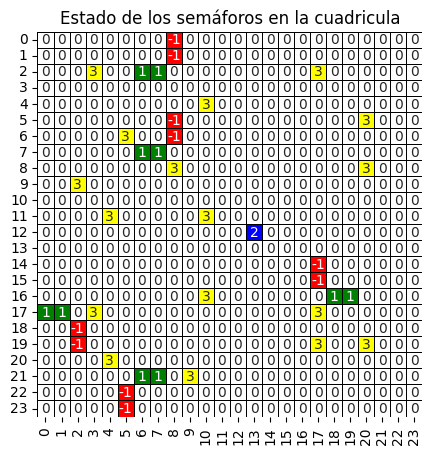

posicion: (12, 13)
[(12, 12)]


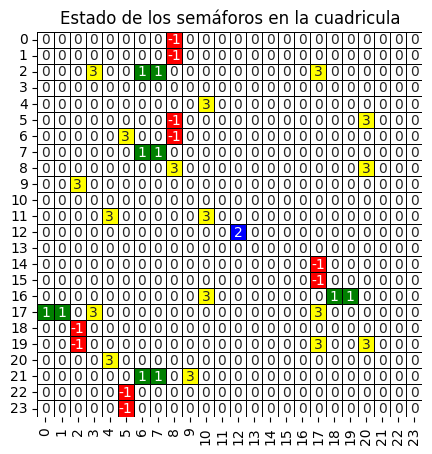

posicion: (12, 12)
[(12, 11)]


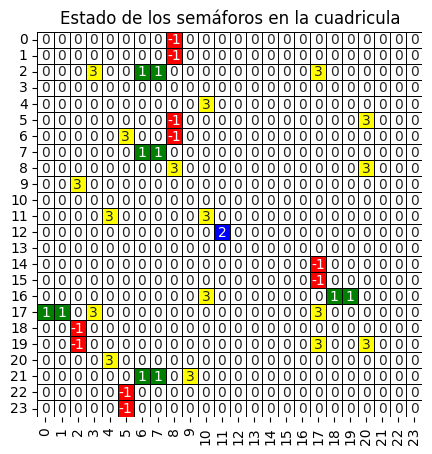

posicion: (12, 11)
[(12, 10)]


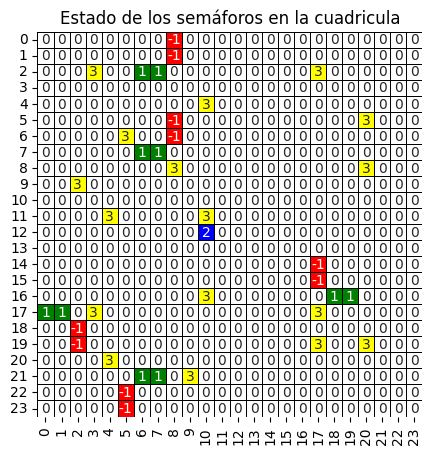

posicion: (12, 10)
[(12, 9)]


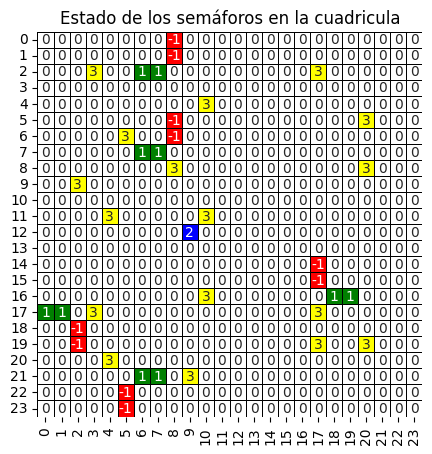

posicion: (12, 9)
[(12, 8)]


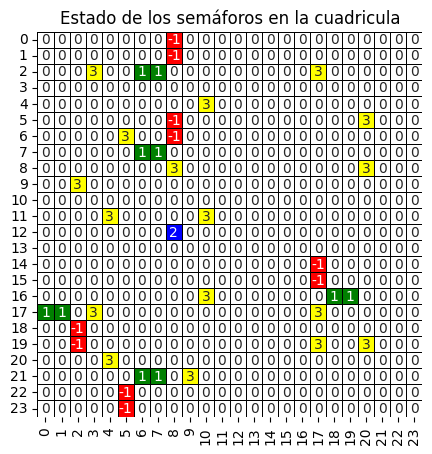

posicion: (12, 8)
[(12, 7)]


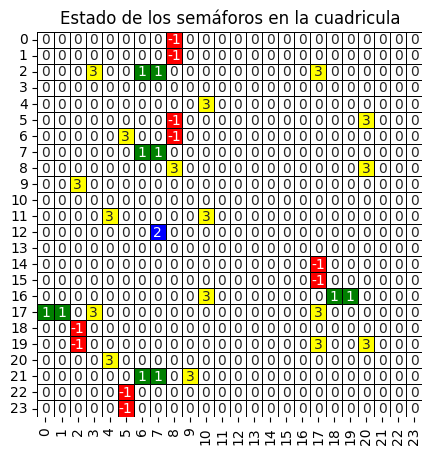

posicion: (12, 7)
[(12, 6)]


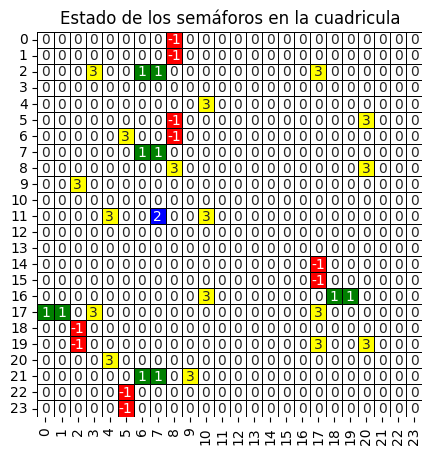

posicion: (11, 7)
[(10, 7)]


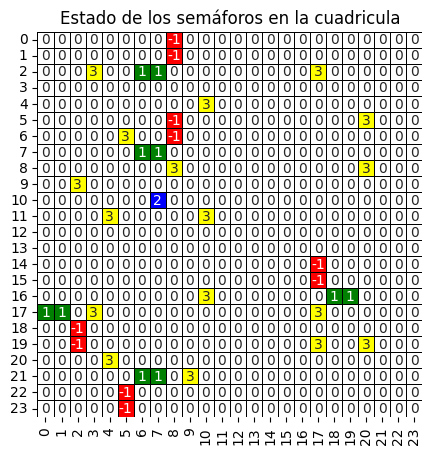

posicion: (10, 7)
[(9, 7)]


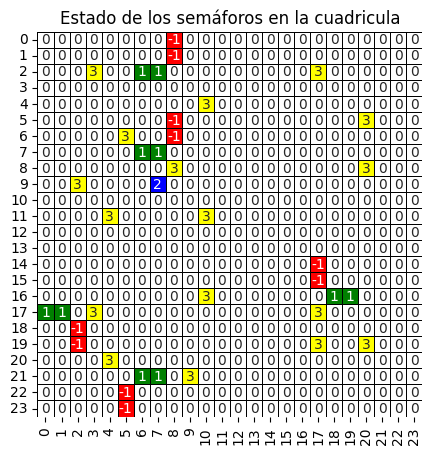

posicion: (9, 7)
[(8, 7)]


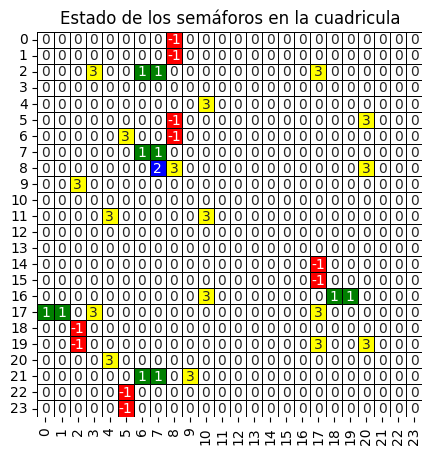

posicion: (8, 7)
[(7, 7)]


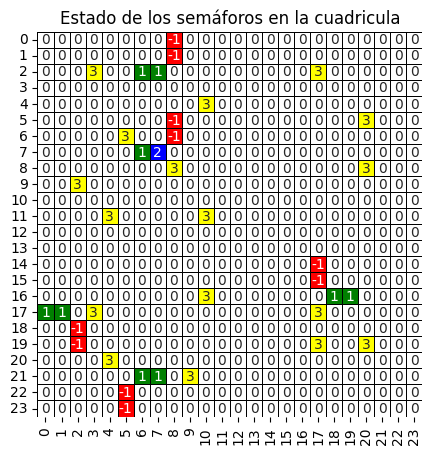

posicion: (7, 7)
[(6, 7)]


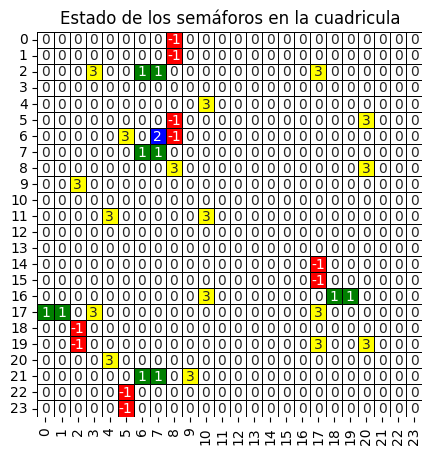

posicion: (6, 7)
[(5, 7)]


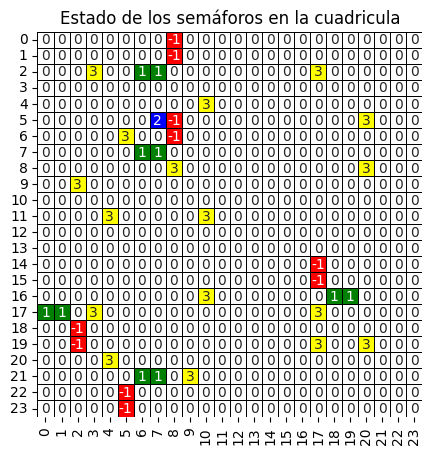

posicion: (5, 7)
[(4, 7)]


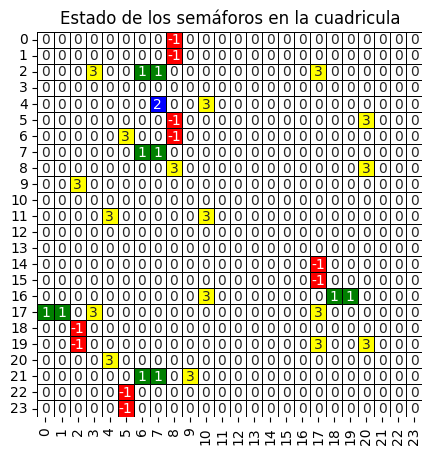

posicion: (4, 7)
[(3, 7)]


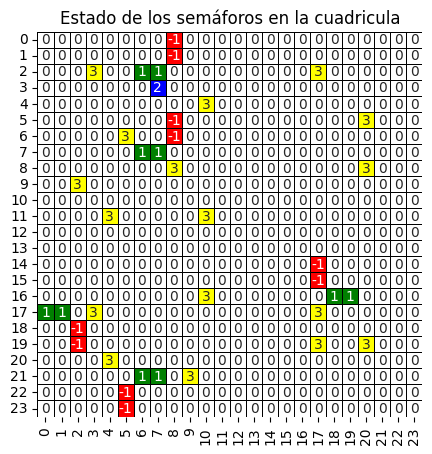

posicion: (3, 7)
[(2, 7)]


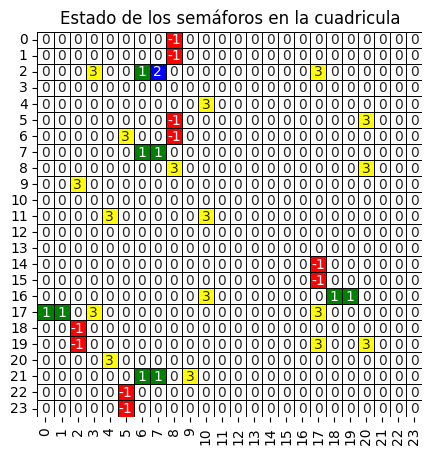

posicion: (2, 7)
[(1, 7)]


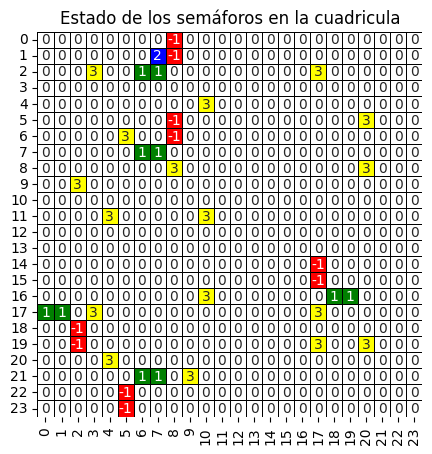

posicion: (1, 7)
[(1, 6)]


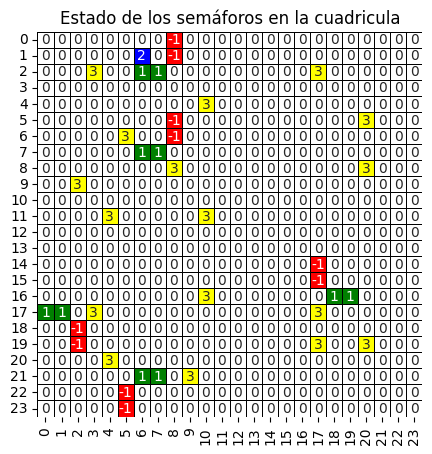

posicion: (1, 6)
[(1, 5)]


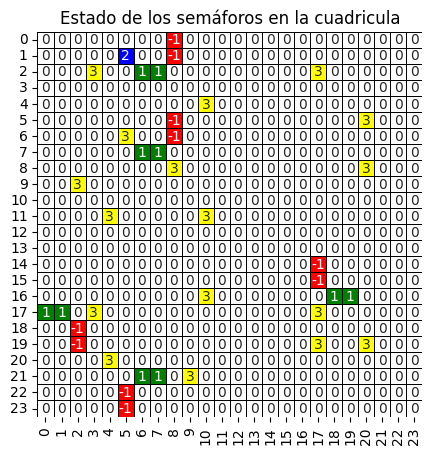

posicion: (1, 5)
[(1, 4)]


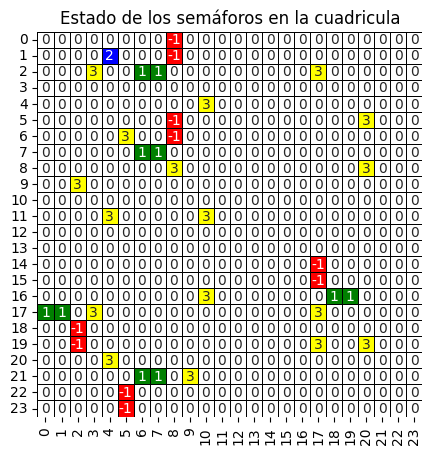

posicion: (1, 4)
[(1, 3)]


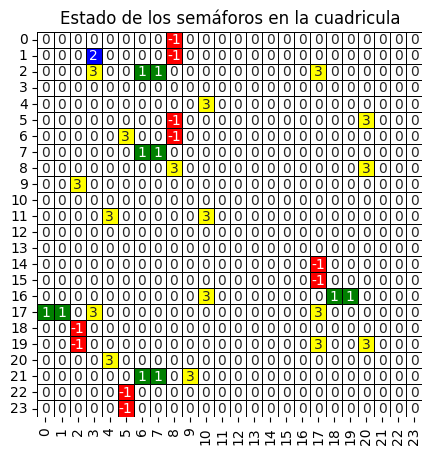

posicion: (1, 3)
[(1, 2)]


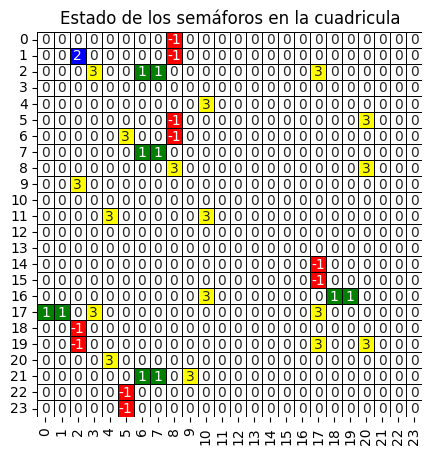

posicion: (1, 2)
[(1, 1)]


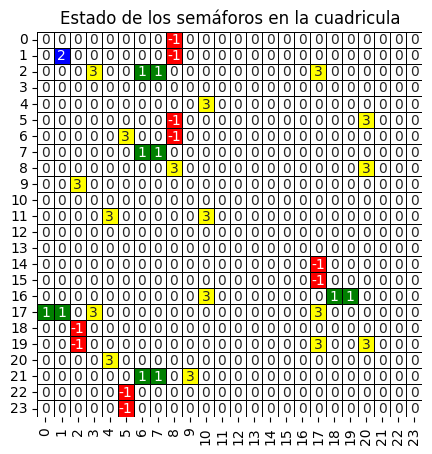

posicion: (1, 1)
[(1, 0)]


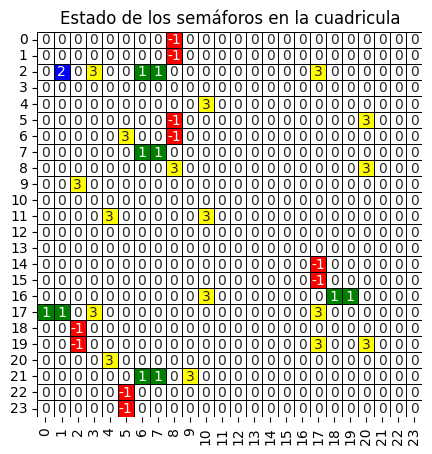

Semaforo 1 cambión de color
Semaforo: 1 | Color: ROJO | Posicion (2, 6)
Semaforo 2 cambión de color
Semaforo: 2 | Color: ROJO | Posicion (2, 7)
Semaforo 3 cambión de color
Semaforo: 3 | Color: ROJO | Posicion (7, 6)
Semaforo 4 cambión de color
Semaforo: 4 | Color: ROJO | Posicion (7, 7)
Semaforo 5 cambión de color
Semaforo: 5 | Color: ROJO | Posicion (17, 0)
Semaforo 6 cambión de color
Semaforo: 6 | Color: ROJO | Posicion (17, 1)
Semaforo 7 cambión de color
Semaforo: 7 | Color: ROJO | Posicion (21, 6)
Semaforo 8 cambión de color
Semaforo: 8 | Color: ROJO | Posicion (21, 7)
Semaforo 9 cambión de color
Semaforo: 9 | Color: ROJO | Posicion (16, 18)
Semaforo 10 cambión de color
Semaforo: 10 | Color: ROJO | Posicion (16, 19)
Semaforo 11 cambión de color
Semaforo: 11 | Color: VERDE | Posicion (0, 8)
Semaforo 12 cambión de color
Semaforo: 12 | Color: VERDE | Posicion (1, 8)
Semaforo 13 cambión de color
Semaforo: 13 | Color: VERDE | Posicion (5, 8)
Semaforo 14 cambión de color
Semaforo: 14 | C

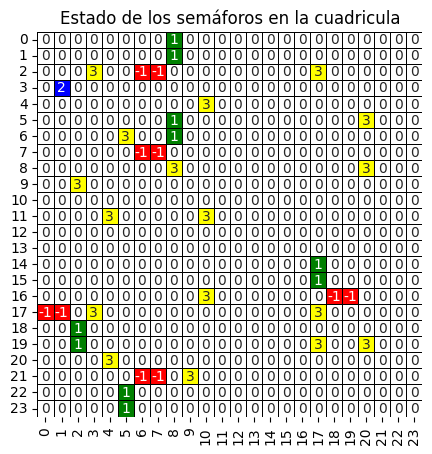

posicion: (3, 1)
[(4, 1)]


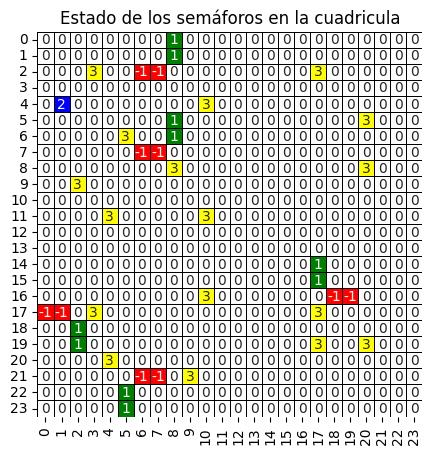

posicion: (4, 1)
[(5, 1)]


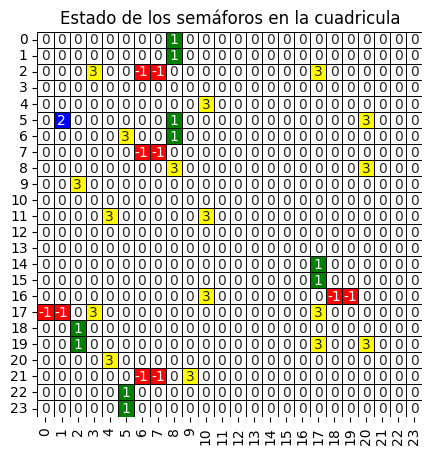

posicion: (5, 1)
[(6, 1)]


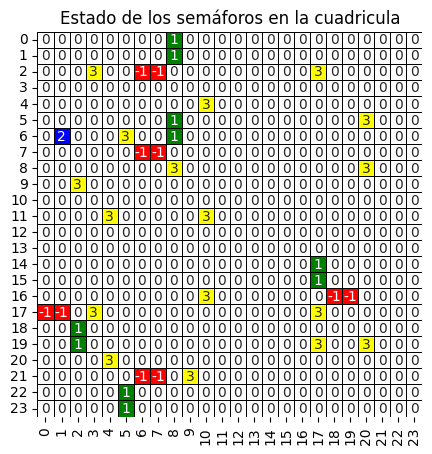

posicion: (6, 1)
[(7, 1)]


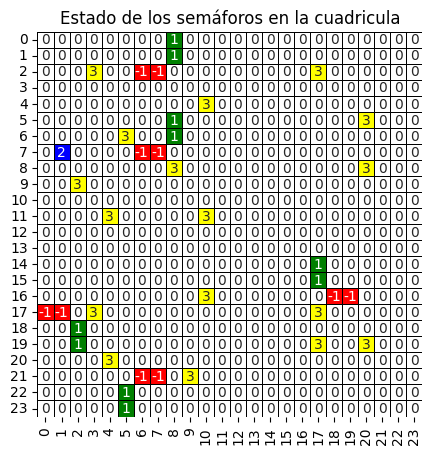

posicion: (7, 1)
[(8, 1)]


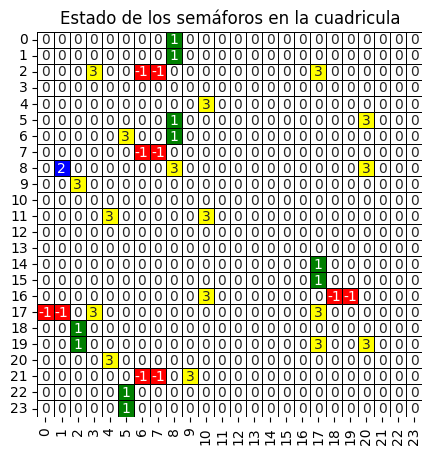

posicion: (8, 1)
[(9, 1)]


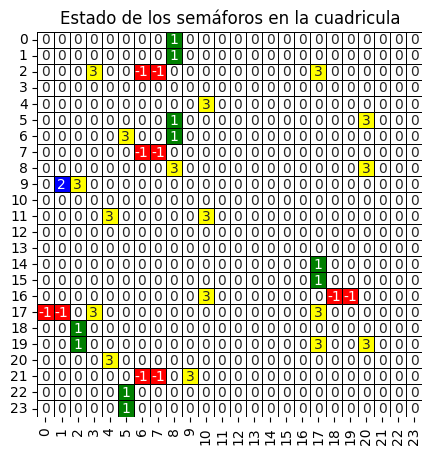

posicion: (9, 1)
[(10, 1)]


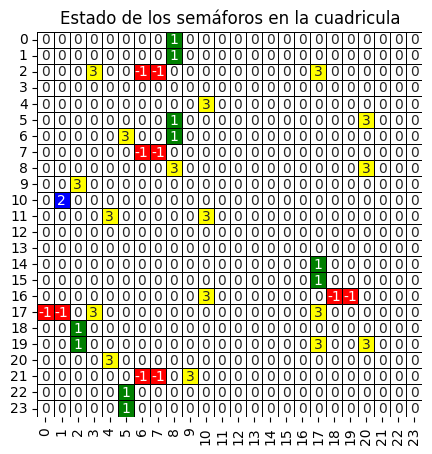

posicion: (10, 1)
[(11, 1)]


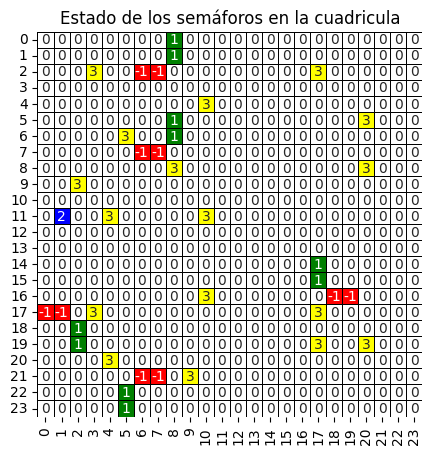

posicion: (11, 1)
[(12, 1)]


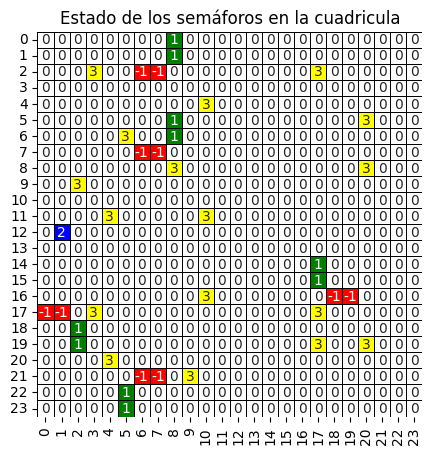

posicion: (12, 1)
[(13, 1)]


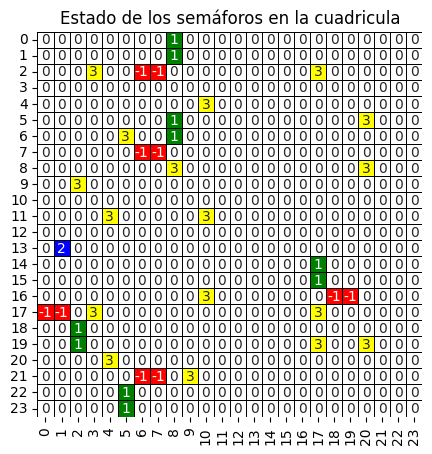

posicion: (13, 1)
[(14, 1)]


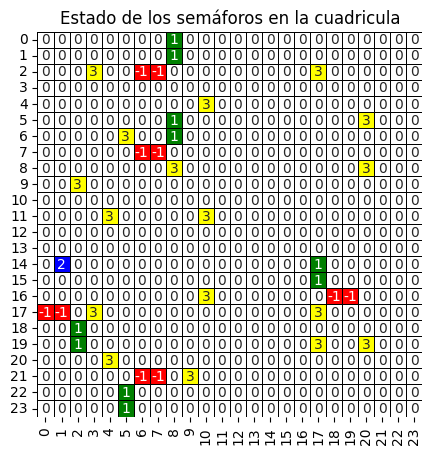

posicion: (14, 1)
[(14, 2)]


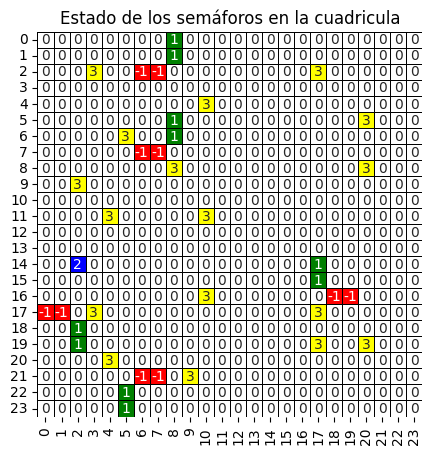

posicion: (14, 2)
[(14, 3)]


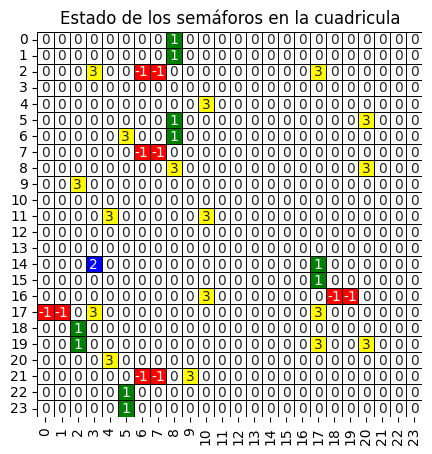

posicion: (14, 3)
[(14, 4)]


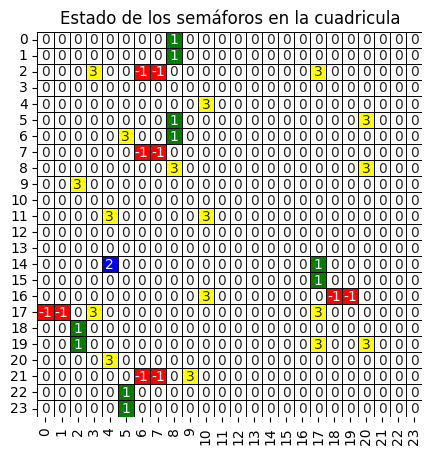

posicion: (14, 4)
[(14, 5)]


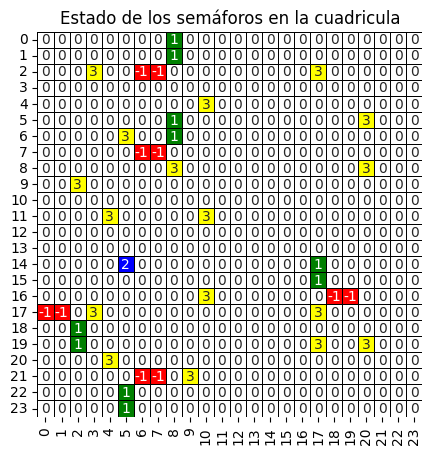

posicion: (14, 5)
[(14, 6)]


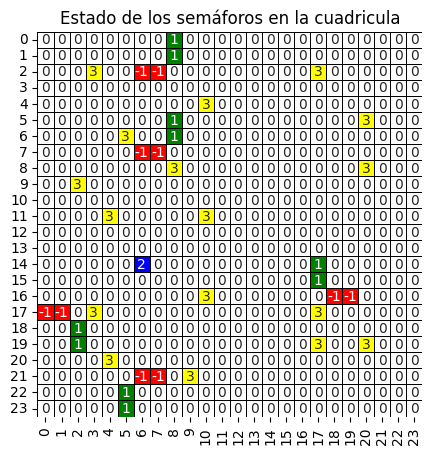

posicion: (14, 6)
[(14, 7)]


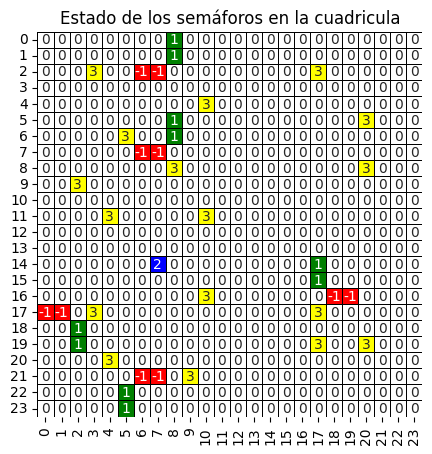

posicion: (14, 7)
[(14, 8)]


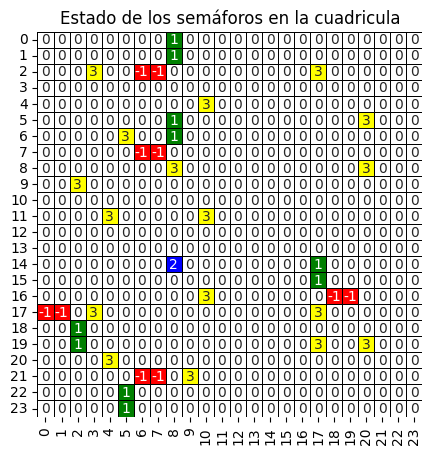

posicion: (14, 8)
[(14, 9)]


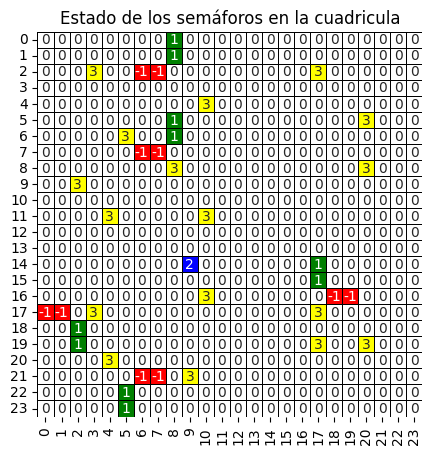

posicion: (14, 9)
[(14, 10)]


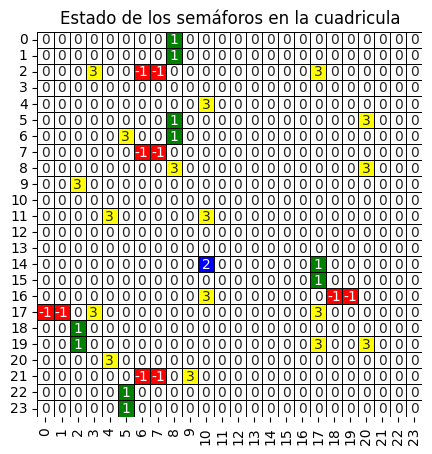

posicion: (14, 10)
[(14, 11)]


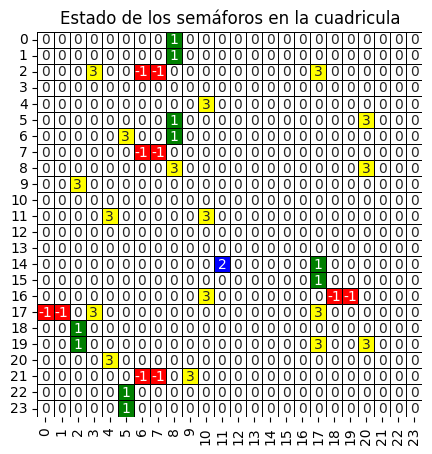

posicion: (14, 11)
[(14, 12)]


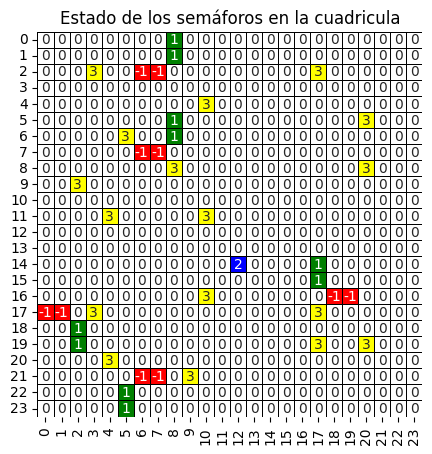

posicion: (14, 12)
[(15, 12)]


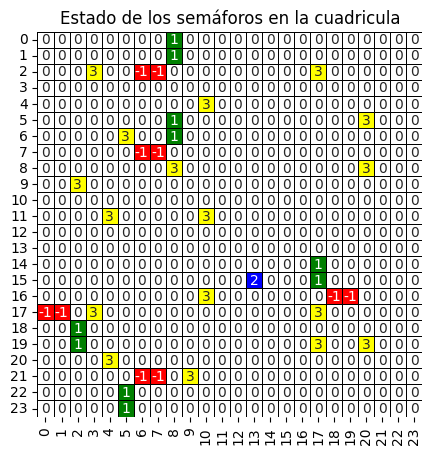

posicion: (15, 13)
[(15, 14)]


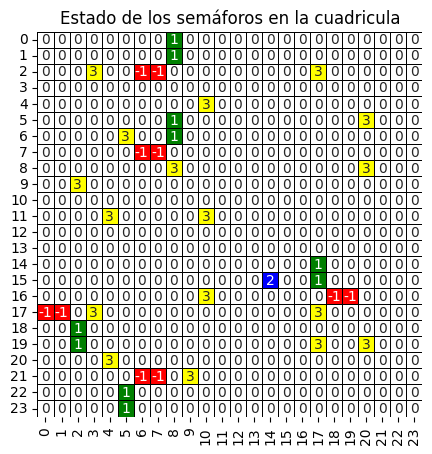

posicion: (15, 14)
[(15, 15)]


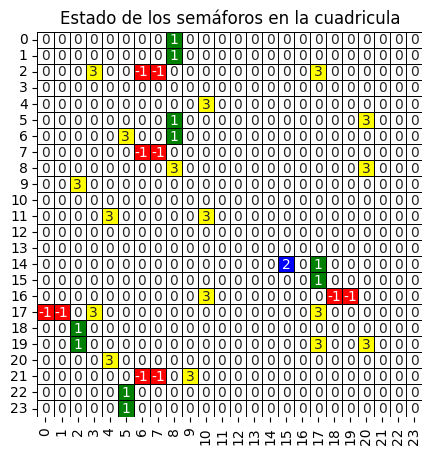

posicion: (14, 15)
[(14, 16)]


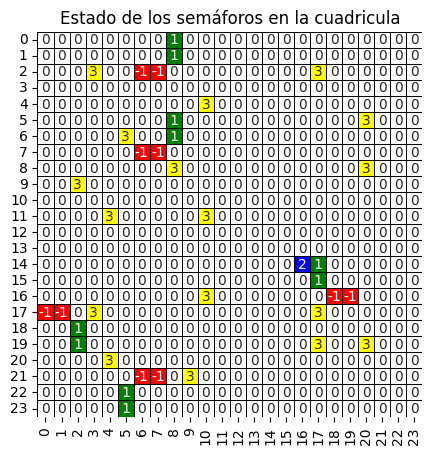

posicion: (14, 16)
[(14, 17)]


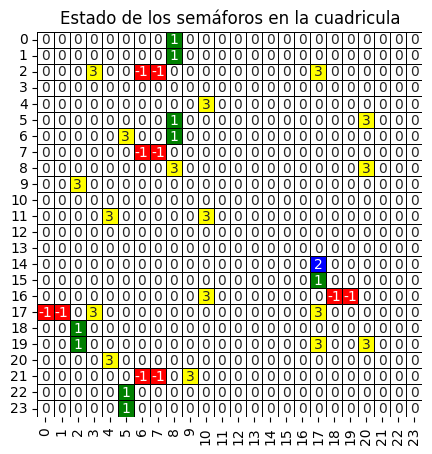

posicion: (14, 17)
[(14, 18)]


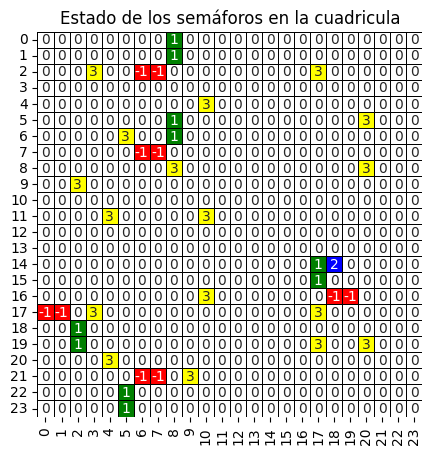

posicion: (14, 18)
[(14, 19)]


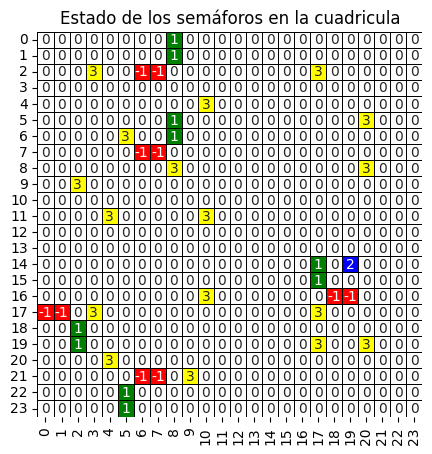

posicion: (14, 19)
[(14, 20)]


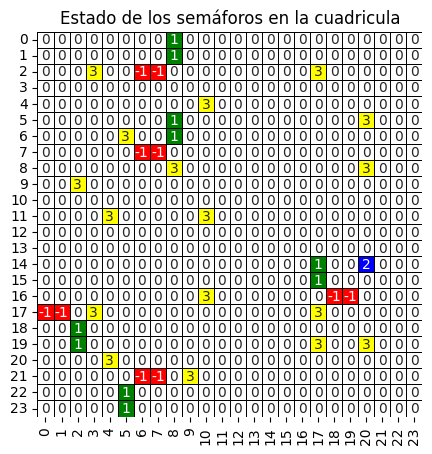

posicion: (14, 20)
[(14, 21)]


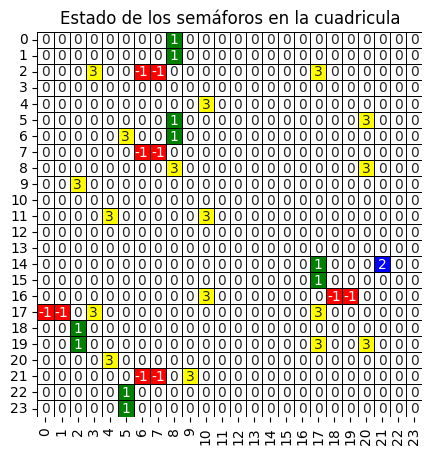

posicion: (14, 21)
[(14, 22)]


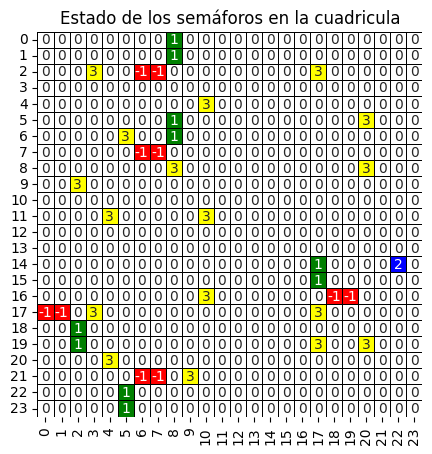

posicion: (14, 22)
[(13, 22)]


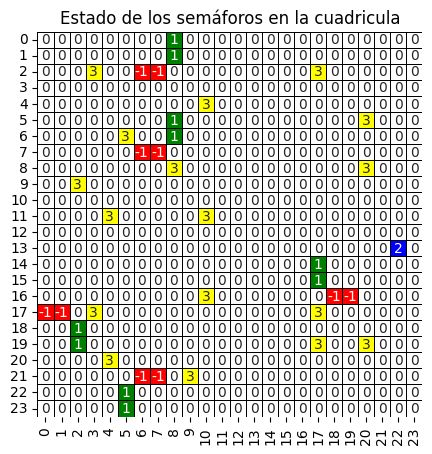

posicion: (13, 22)
[(13, 21)]


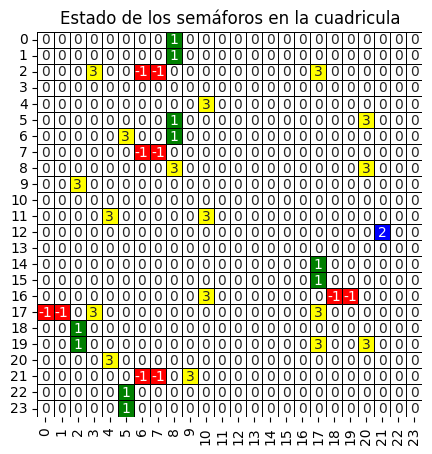

posicion: (12, 21)
[(12, 20)]


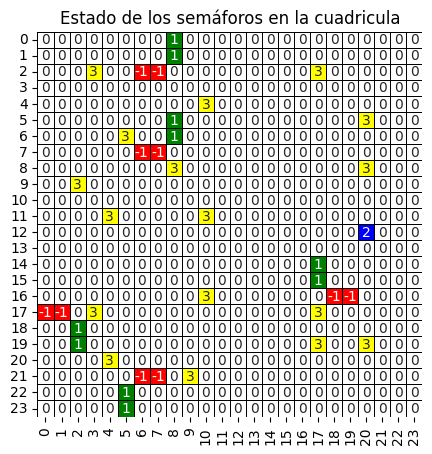

posicion: (12, 20)
[(12, 19)]


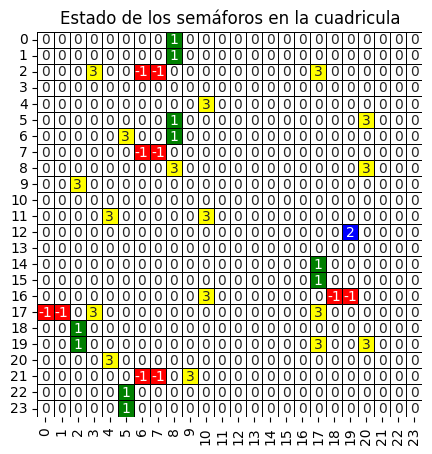

posicion: (12, 19)
[(12, 18)]


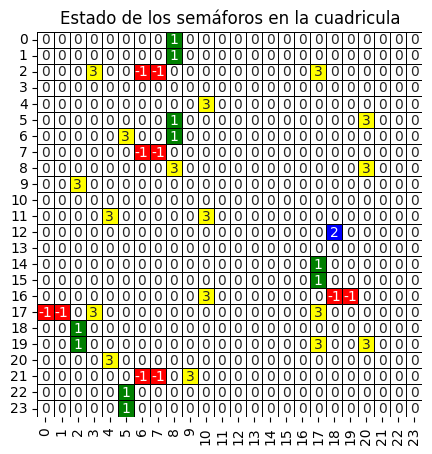

posicion: (12, 18)
[(12, 17)]


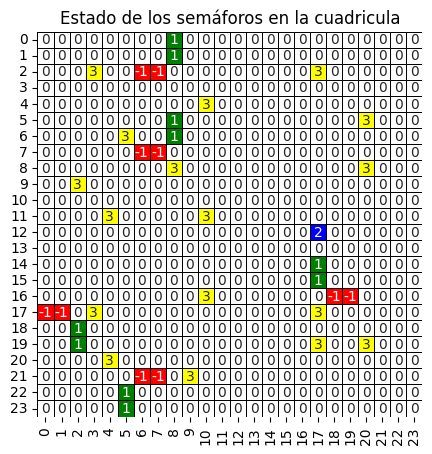

posicion: (12, 17)
[(12, 16)]


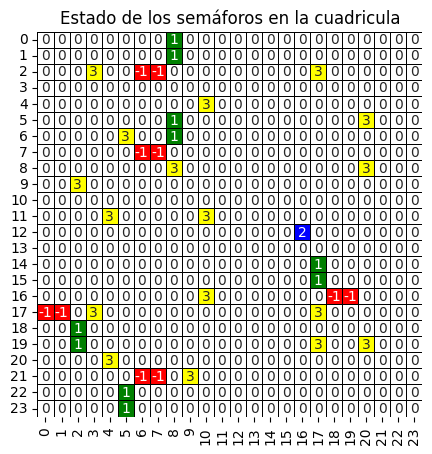

Semaforo 1 cambión de color
Semaforo: 1 | Color: VERDE | Posicion (2, 6)
Semaforo 2 cambión de color
Semaforo: 2 | Color: VERDE | Posicion (2, 7)
Semaforo 3 cambión de color
Semaforo: 3 | Color: VERDE | Posicion (7, 6)
Semaforo 4 cambión de color
Semaforo: 4 | Color: VERDE | Posicion (7, 7)
Semaforo 5 cambión de color
Semaforo: 5 | Color: VERDE | Posicion (17, 0)
Semaforo 6 cambión de color
Semaforo: 6 | Color: VERDE | Posicion (17, 1)
Semaforo 7 cambión de color
Semaforo: 7 | Color: VERDE | Posicion (21, 6)
Semaforo 8 cambión de color
Semaforo: 8 | Color: VERDE | Posicion (21, 7)
Semaforo 9 cambión de color
Semaforo: 9 | Color: VERDE | Posicion (16, 18)
Semaforo 10 cambión de color
Semaforo: 10 | Color: VERDE | Posicion (16, 19)
Semaforo 11 cambión de color
Semaforo: 11 | Color: ROJO | Posicion (0, 8)
Semaforo 12 cambión de color
Semaforo: 12 | Color: ROJO | Posicion (1, 8)
Semaforo 13 cambión de color
Semaforo: 13 | Color: ROJO | Posicion (5, 8)
Semaforo 14 cambión de color
Semaforo:

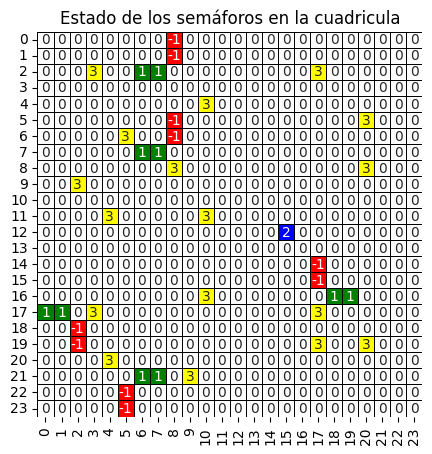

posicion: (12, 15)
[(12, 14)]


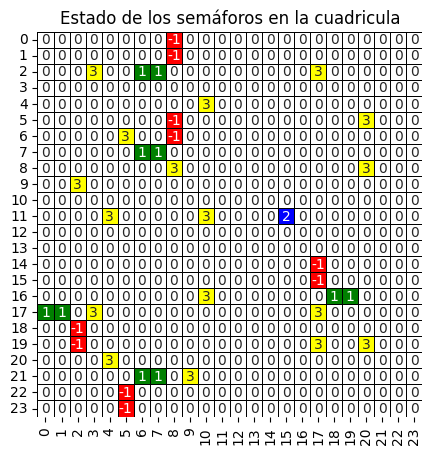

posicion: (11, 15)
[(10, 15)]


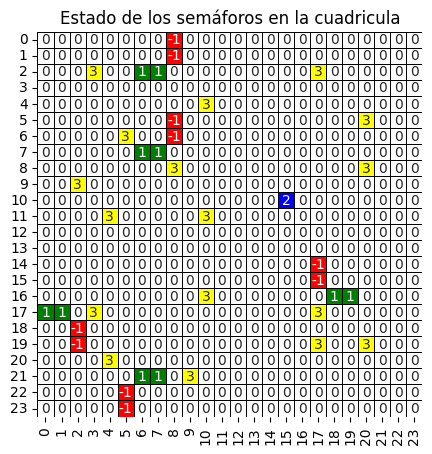

posicion: (10, 15)
[(9, 15)]


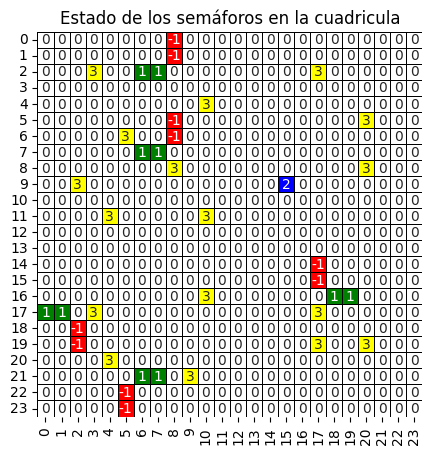

posicion: (9, 15)
[(8, 15)]


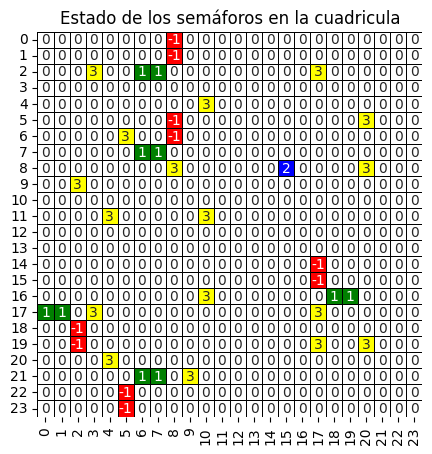

posicion: (8, 15)
[(7, 15)]


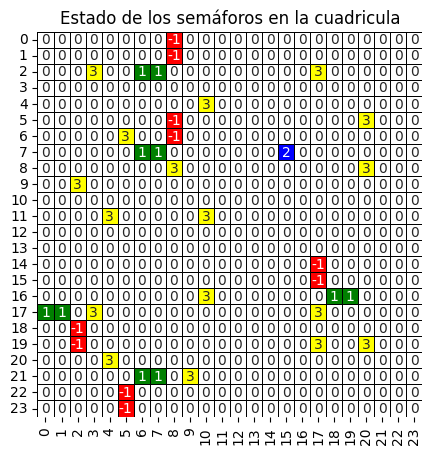

posicion: (7, 15)
[(6, 15)]


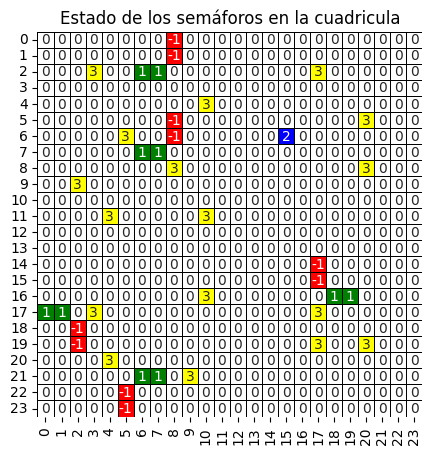

posicion: (6, 15)
[(5, 15)]


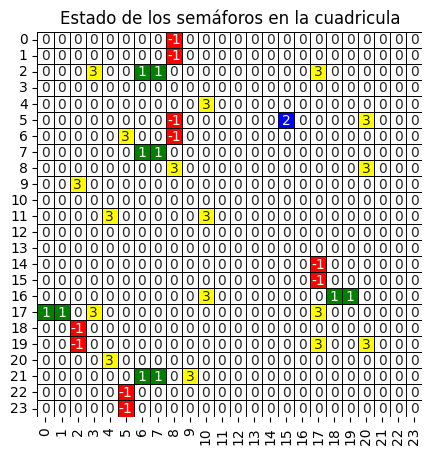

posicion: (5, 15)
[(4, 15)]


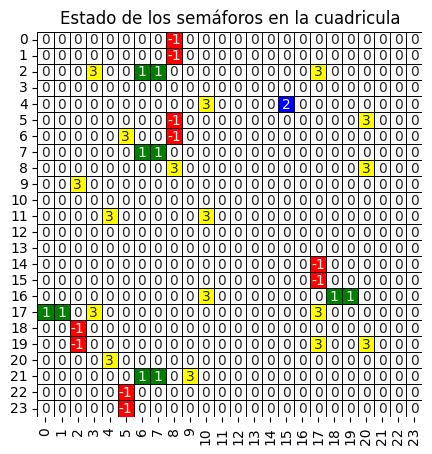

posicion: (4, 15)
[(3, 15)]


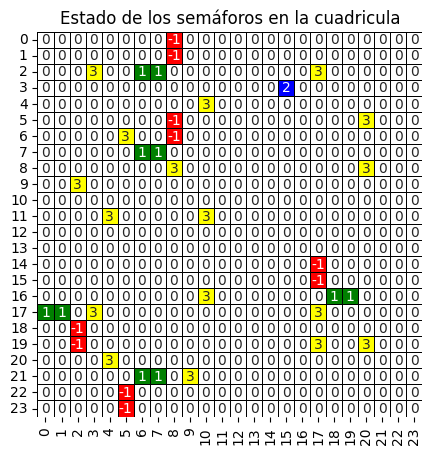

posicion: (3, 15)
[(2, 15)]


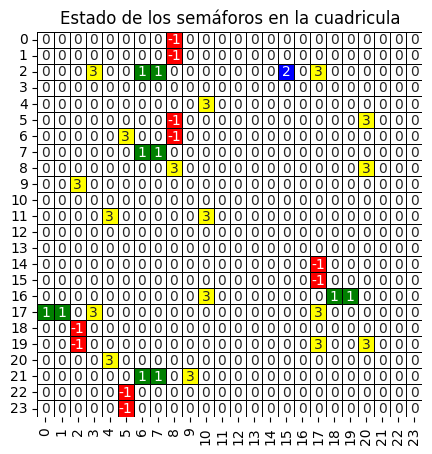

posicion: (2, 15)
[(1, 15)]


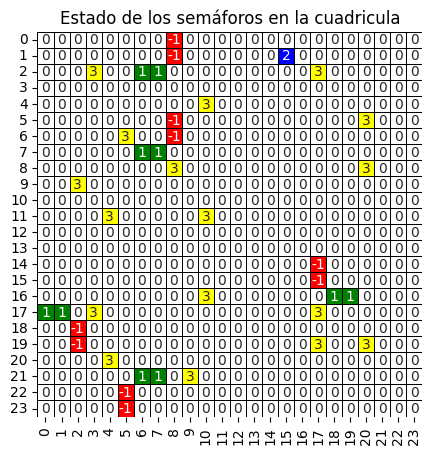

posicion: (1, 15)
[(1, 14)]


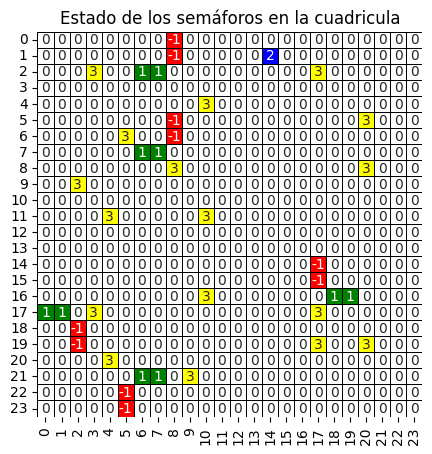

posicion: (1, 14)
[(1, 13)]


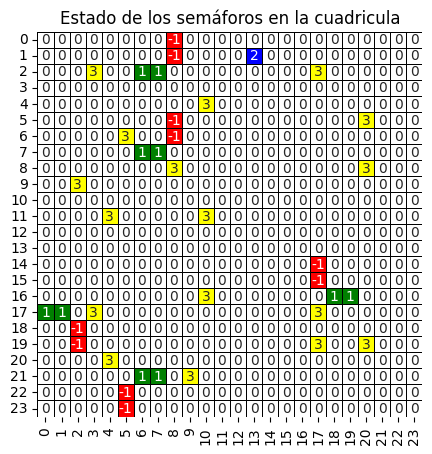

posicion: (1, 13)
[(1, 12)]


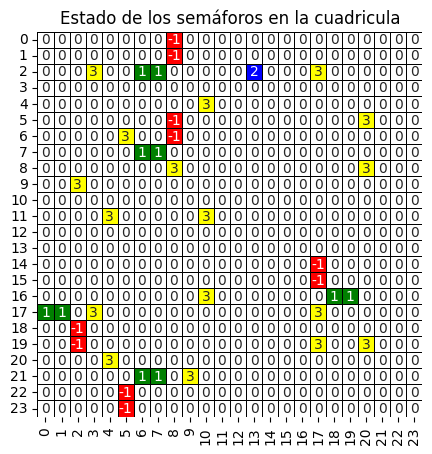

posicion: (2, 13)
[(3, 13)]


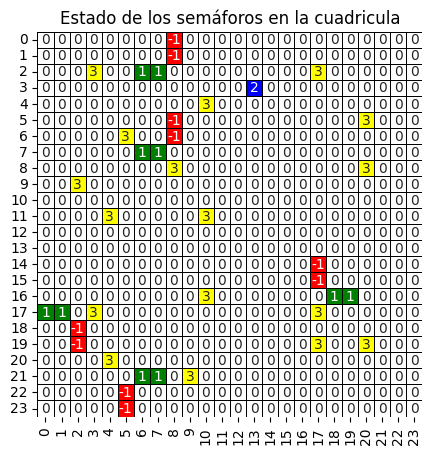

posicion: (3, 13)
[(4, 13)]


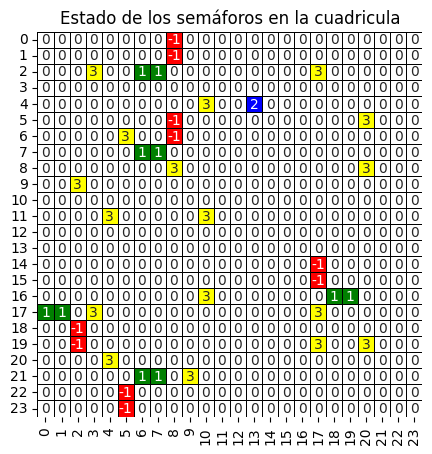

posicion: (4, 13)
[(5, 13)]


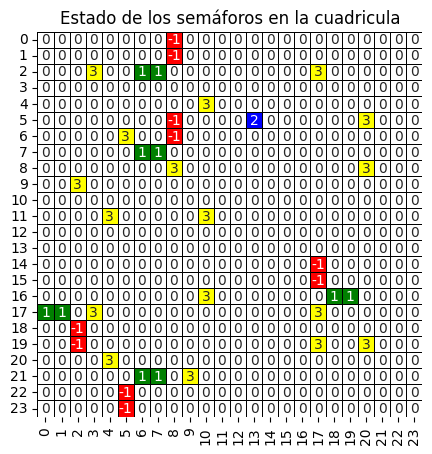

posicion: (5, 13)
[(6, 13)]


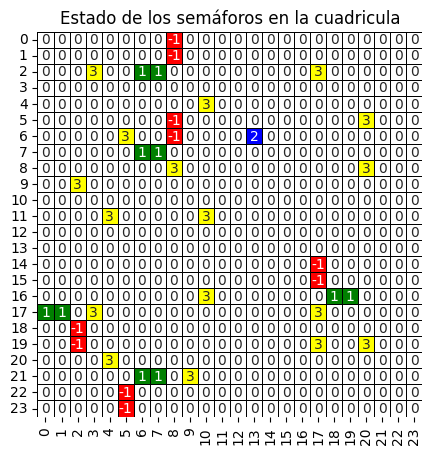

posicion: (6, 13)
[(7, 13)]


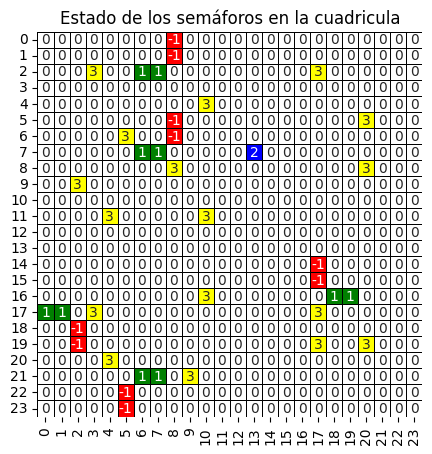

posicion: (7, 13)
[(8, 13)]


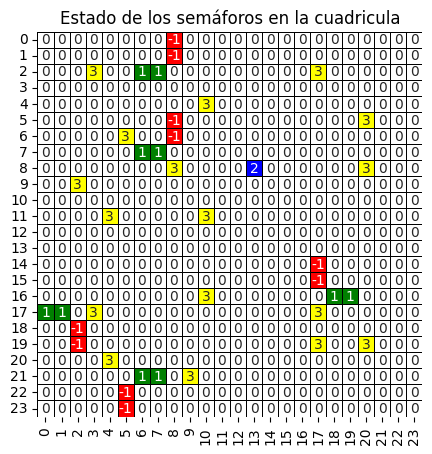

posicion: (8, 13)
[(9, 13)]


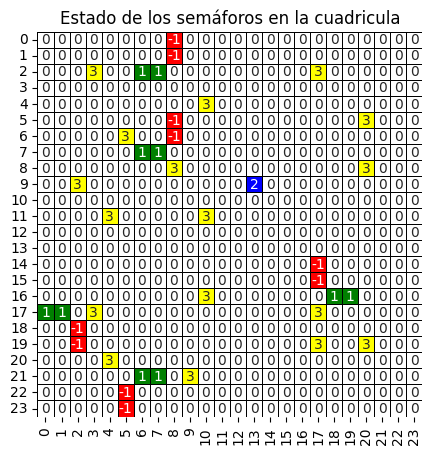

posicion: (9, 13)
[(10, 13)]


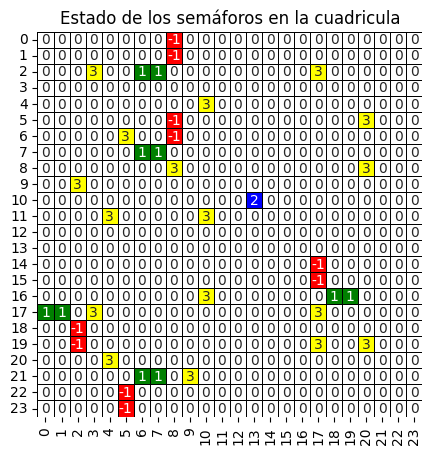

posicion: (10, 13)
[(11, 13)]


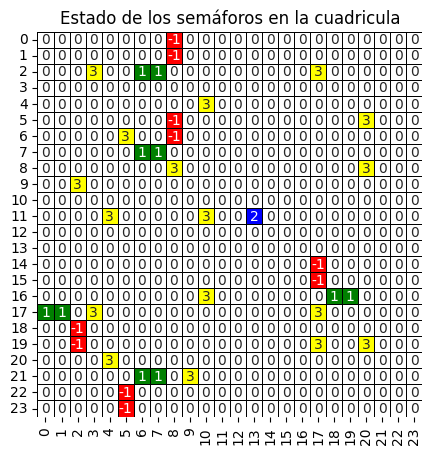

posicion: (11, 13)
[(12, 13)]


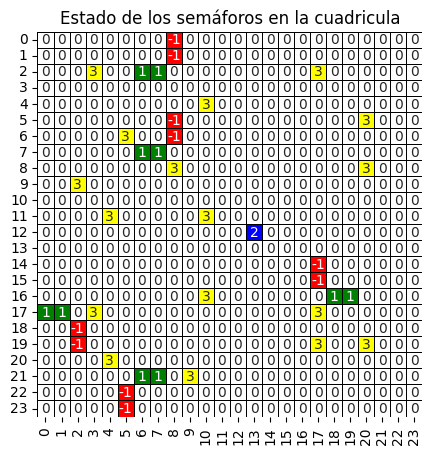

posicion: (12, 13)
[(12, 12)]


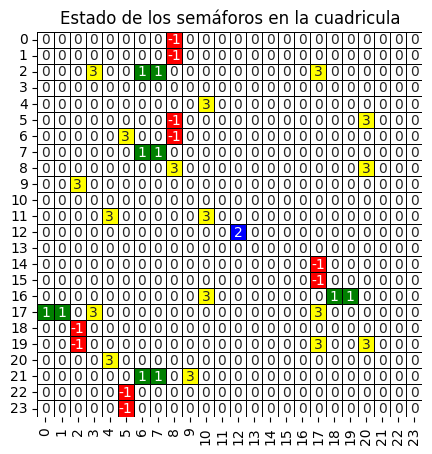

posicion: (12, 12)
[(12, 11)]


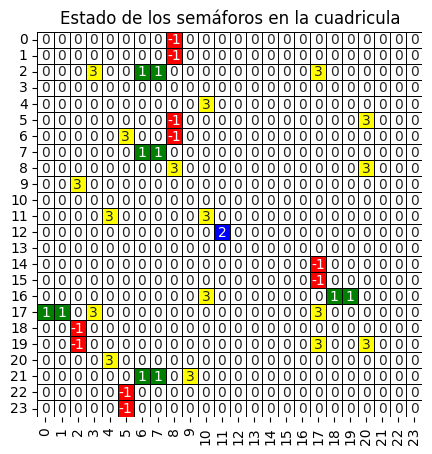

posicion: (12, 11)
[(12, 10)]


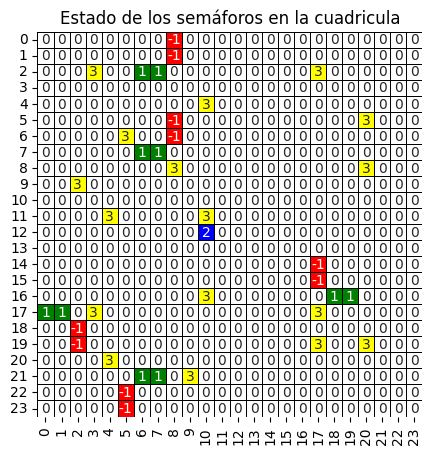

posicion: (12, 10)
[(12, 9)]


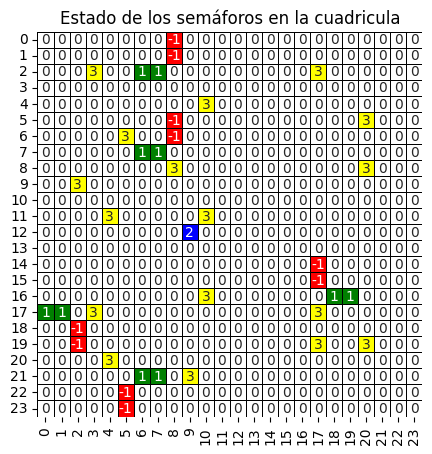

posicion: (12, 9)
[(12, 8)]


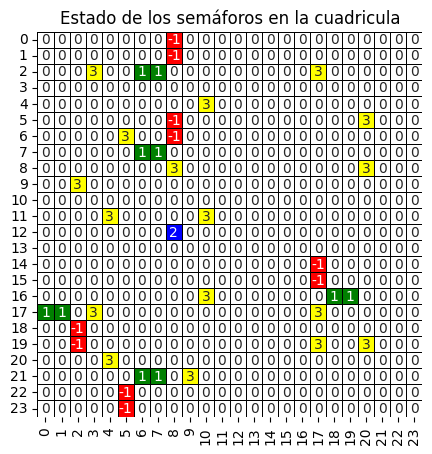

posicion: (12, 8)
[(12, 7)]


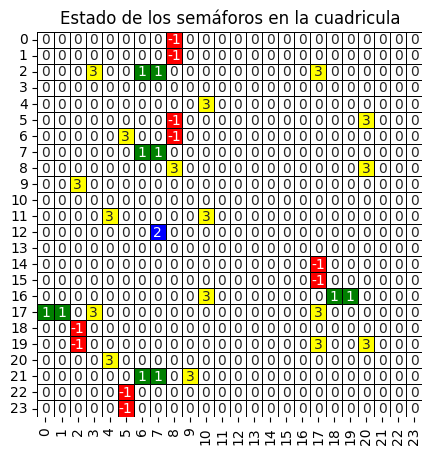

posicion: (12, 7)
[(12, 6)]


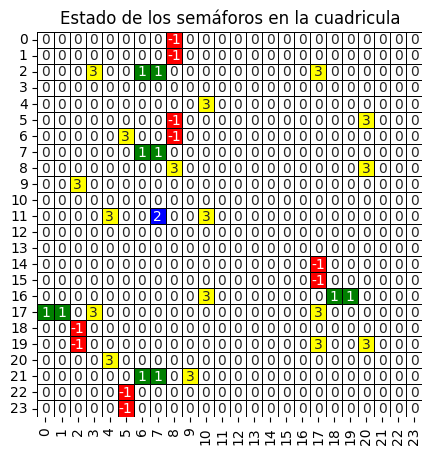

posicion: (11, 7)
[(10, 7)]


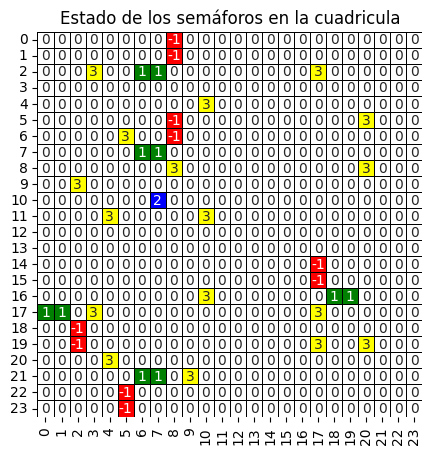

posicion: (10, 7)
[(9, 7)]


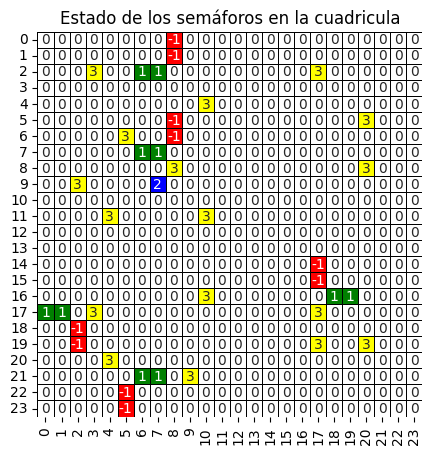

posicion: (9, 7)
[(8, 7)]


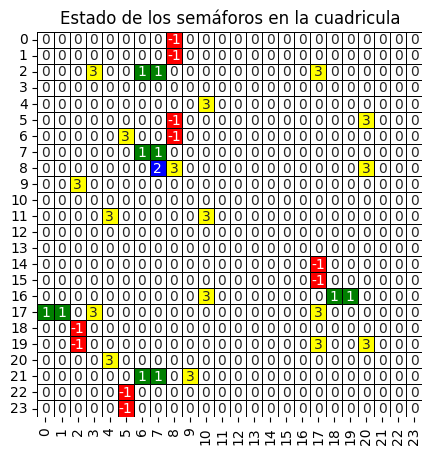

posicion: (8, 7)
[(7, 7)]


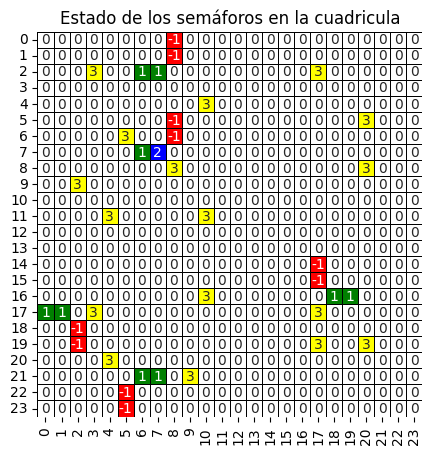

posicion: (7, 7)
[(6, 7)]


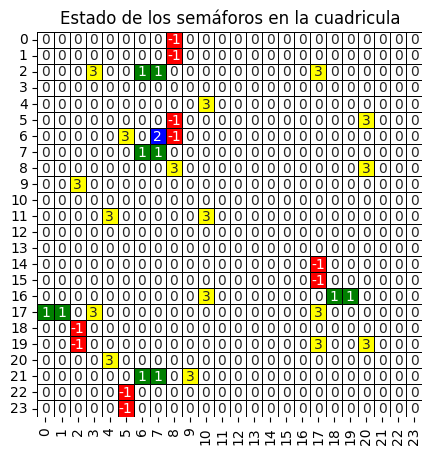

posicion: (6, 7)
[(5, 7)]


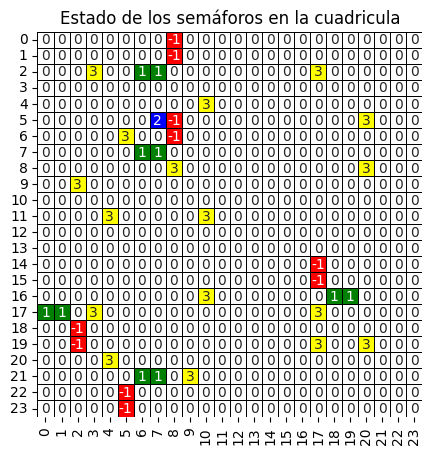

posicion: (5, 7)
[(4, 7)]


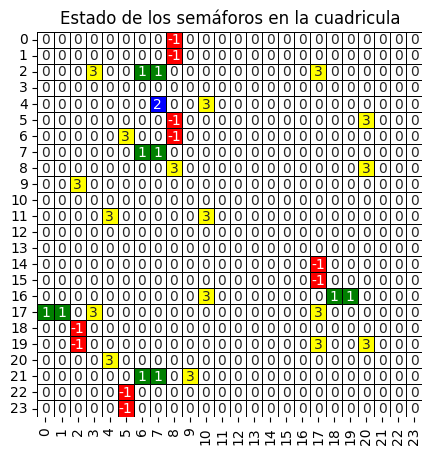

posicion: (4, 7)
[(3, 7)]


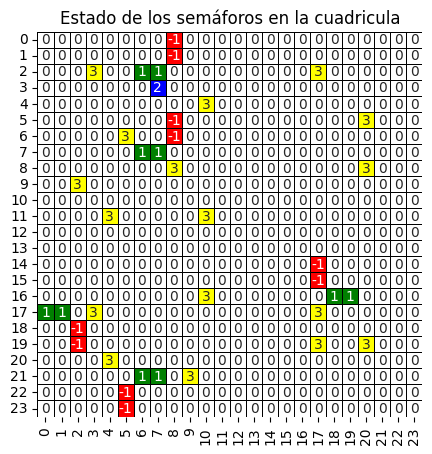

Semaforo 1 cambión de color
Semaforo: 1 | Color: ROJO | Posicion (2, 6)
Semaforo 2 cambión de color
Semaforo: 2 | Color: ROJO | Posicion (2, 7)
Semaforo 3 cambión de color
Semaforo: 3 | Color: ROJO | Posicion (7, 6)
Semaforo 4 cambión de color
Semaforo: 4 | Color: ROJO | Posicion (7, 7)
Semaforo 5 cambión de color
Semaforo: 5 | Color: ROJO | Posicion (17, 0)
Semaforo 6 cambión de color
Semaforo: 6 | Color: ROJO | Posicion (17, 1)
Semaforo 7 cambión de color
Semaforo: 7 | Color: ROJO | Posicion (21, 6)
Semaforo 8 cambión de color
Semaforo: 8 | Color: ROJO | Posicion (21, 7)
Semaforo 9 cambión de color
Semaforo: 9 | Color: ROJO | Posicion (16, 18)
Semaforo 10 cambión de color
Semaforo: 10 | Color: ROJO | Posicion (16, 19)
Semaforo 11 cambión de color
Semaforo: 11 | Color: VERDE | Posicion (0, 8)
Semaforo 12 cambión de color
Semaforo: 12 | Color: VERDE | Posicion (1, 8)
Semaforo 13 cambión de color
Semaforo: 13 | Color: VERDE | Posicion (5, 8)
Semaforo 14 cambión de color
Semaforo: 14 | C

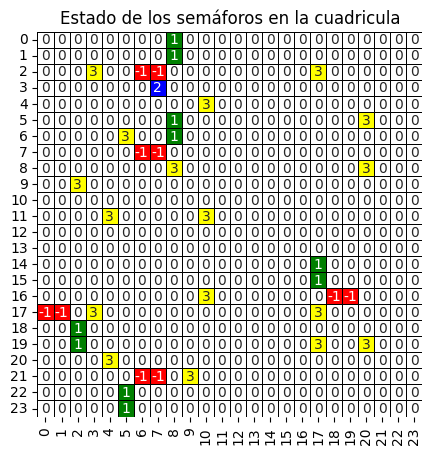

posicion: (3, 7)


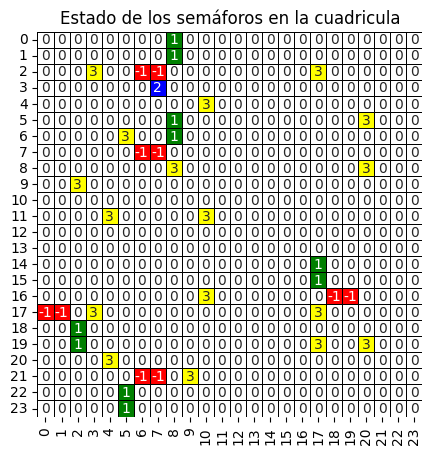

posicion: (3, 7)


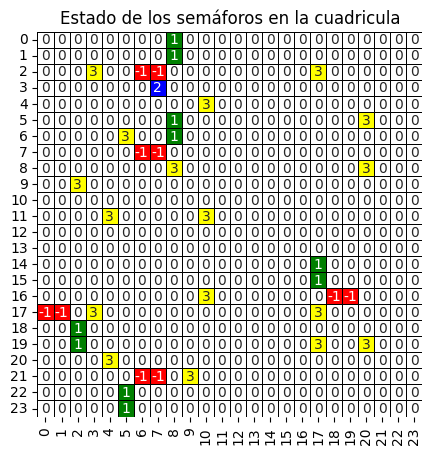

posicion: (3, 7)


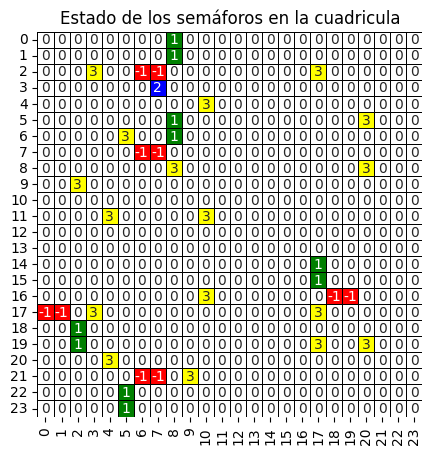

posicion: (3, 7)


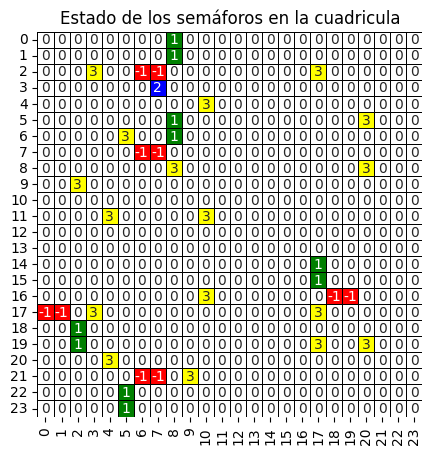

posicion: (3, 7)


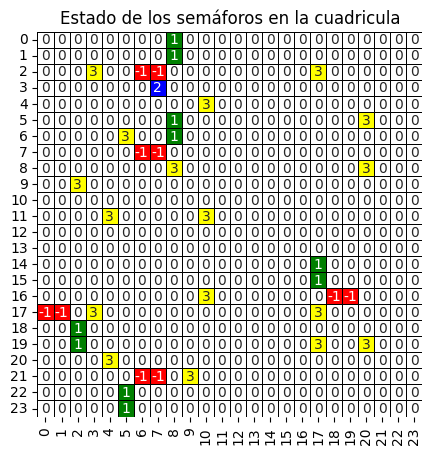

posicion: (3, 7)


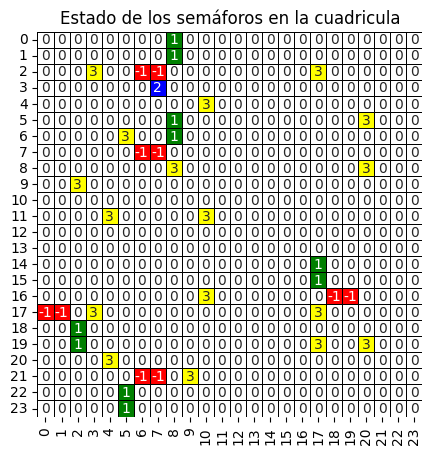

posicion: (3, 7)


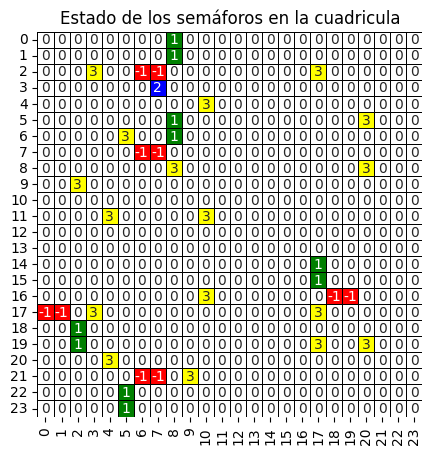

posicion: (3, 7)


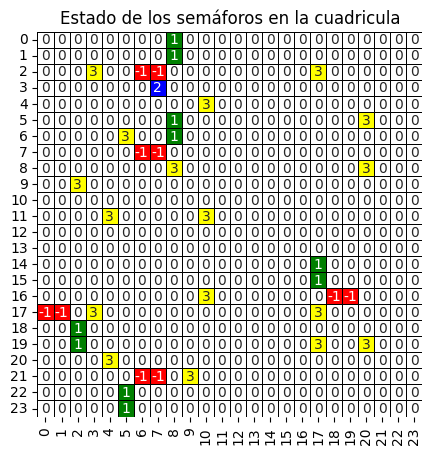

posicion: (3, 7)


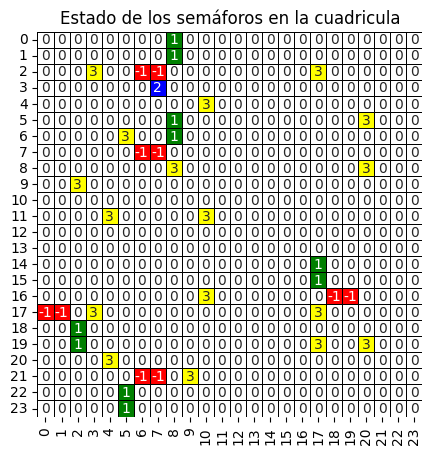

posicion: (3, 7)


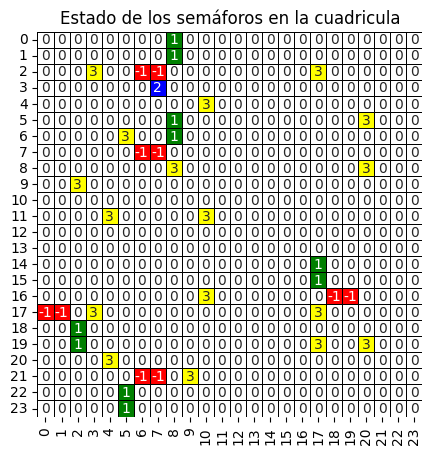

posicion: (3, 7)


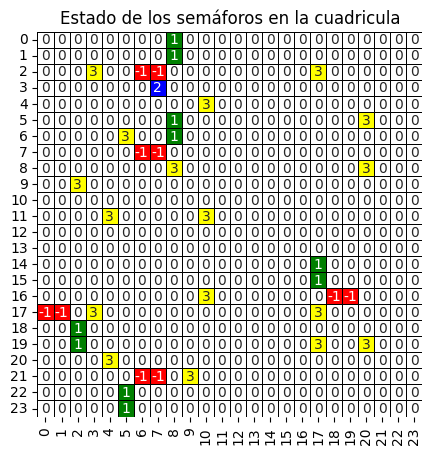

posicion: (3, 7)


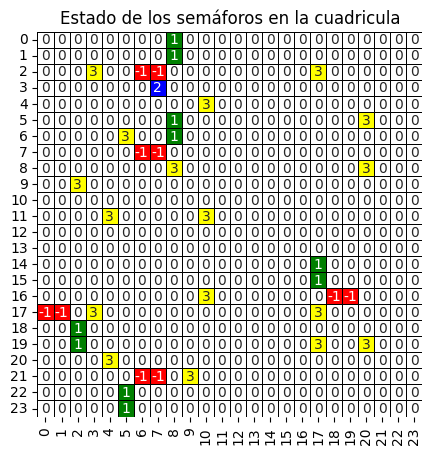

posicion: (3, 7)


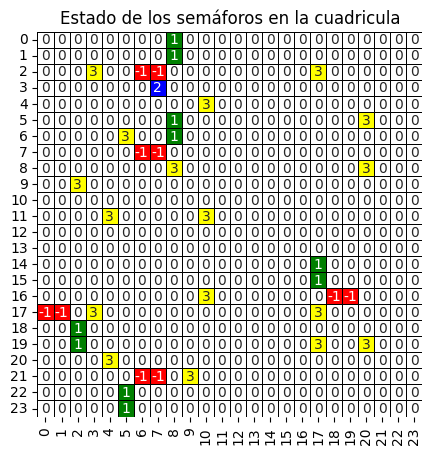

posicion: (3, 7)


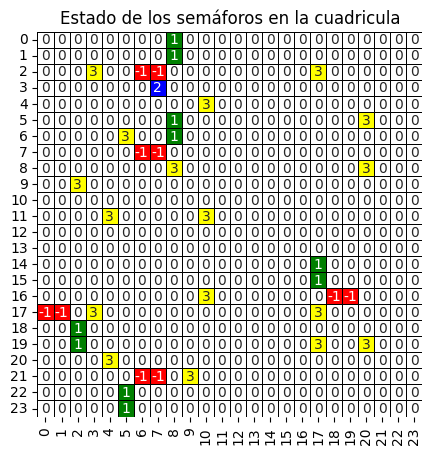

posicion: (3, 7)


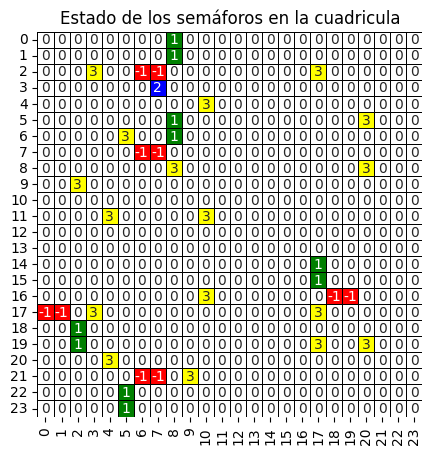

posicion: (3, 7)


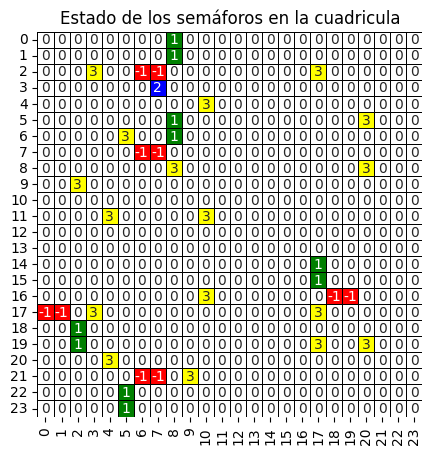

posicion: (3, 7)


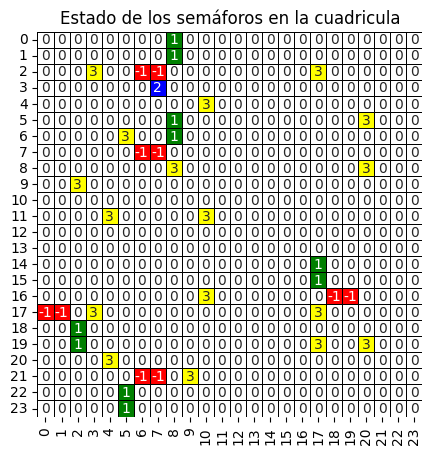

posicion: (3, 7)


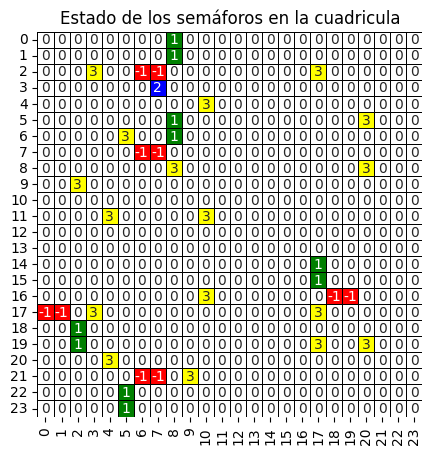

posicion: (3, 7)


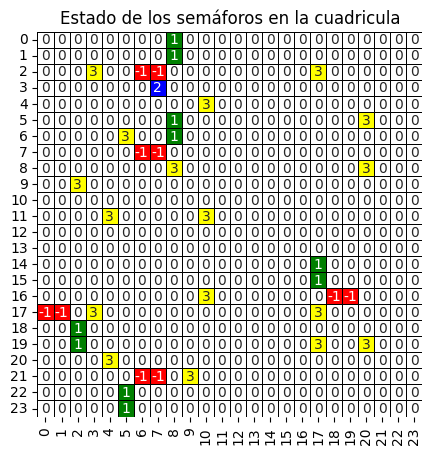

posicion: (3, 7)


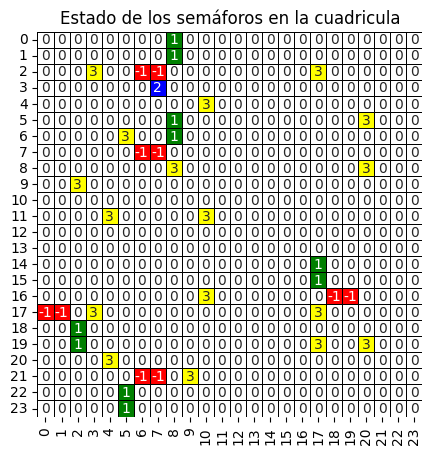

posicion: (3, 7)


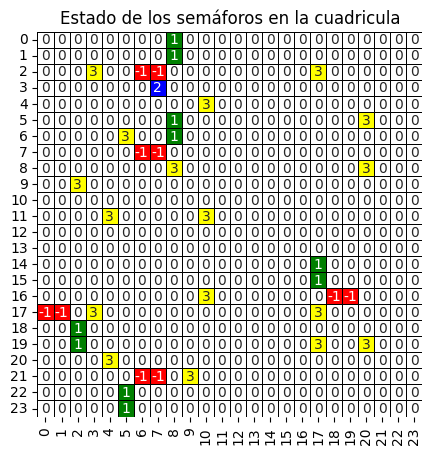

posicion: (3, 7)


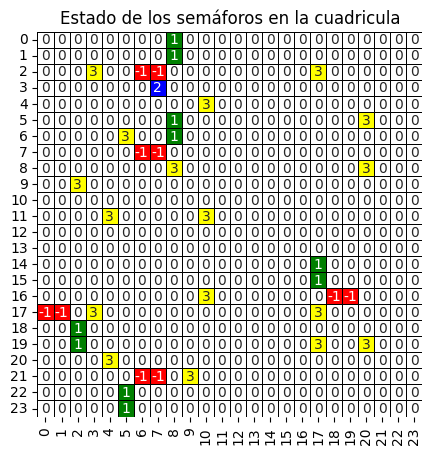

posicion: (3, 7)


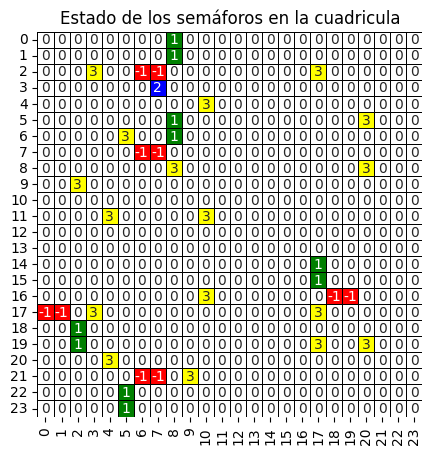

posicion: (3, 7)


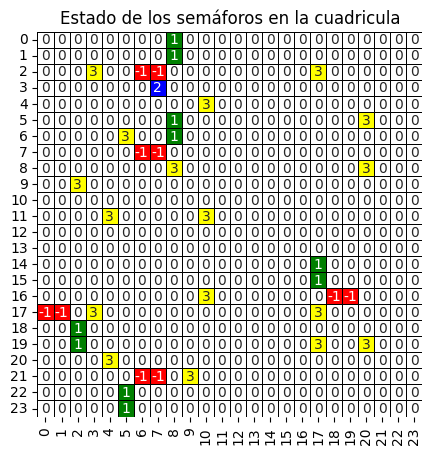

posicion: (3, 7)


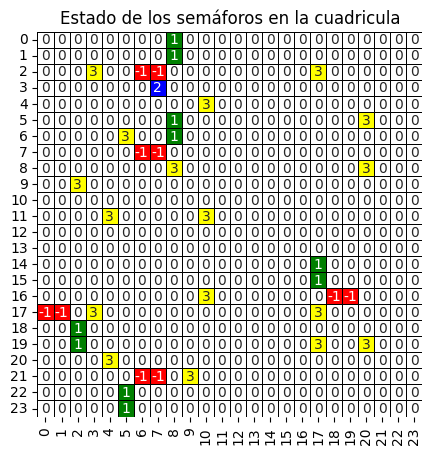

posicion: (3, 7)


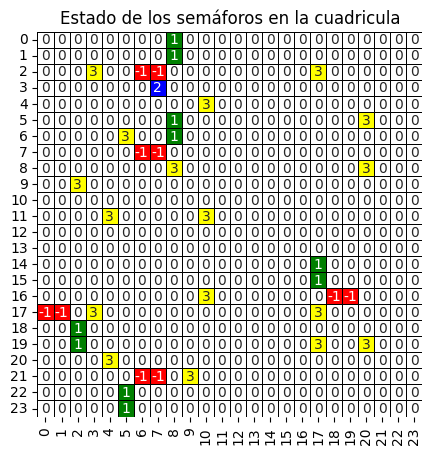

posicion: (3, 7)


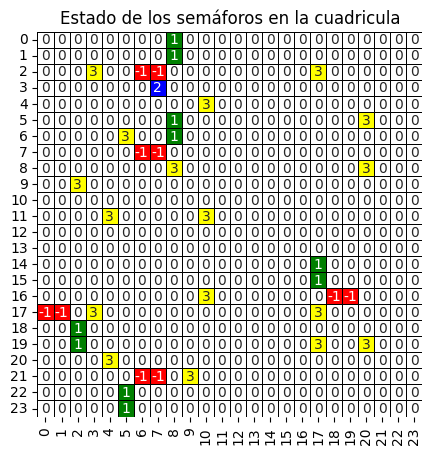

posicion: (3, 7)


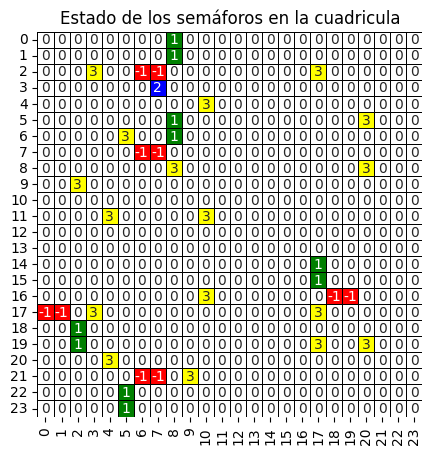

posicion: (3, 7)


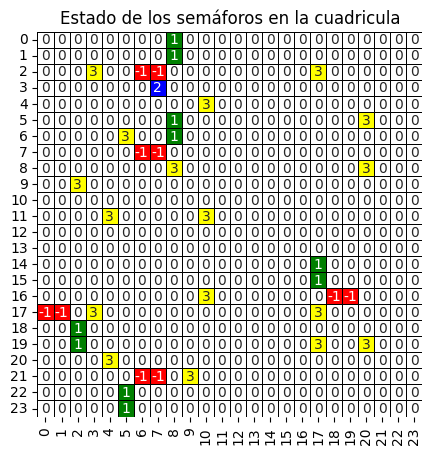

posicion: (3, 7)


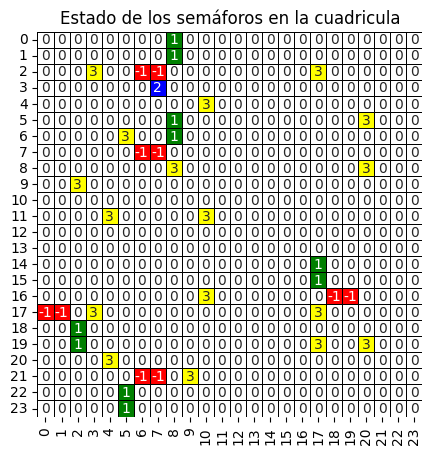

posicion: (3, 7)


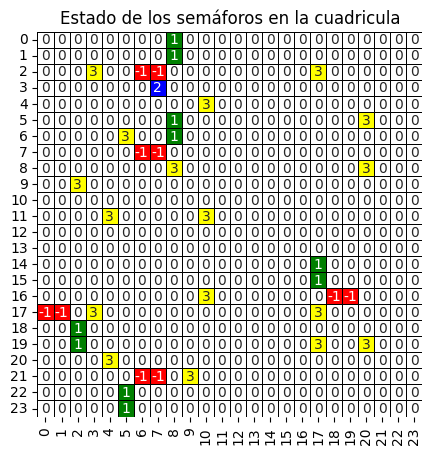

posicion: (3, 7)


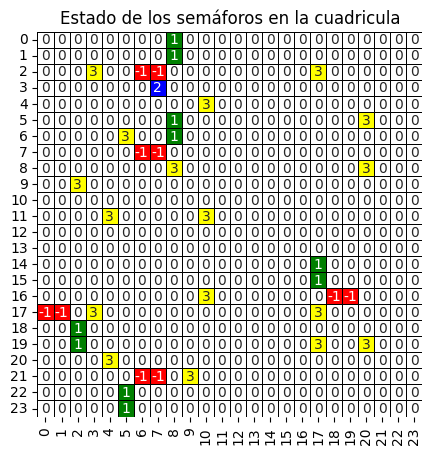

posicion: (3, 7)


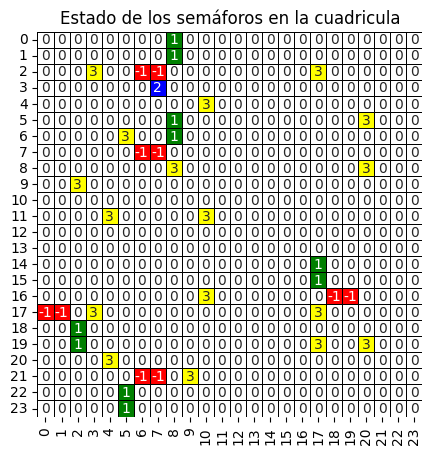

posicion: (3, 7)


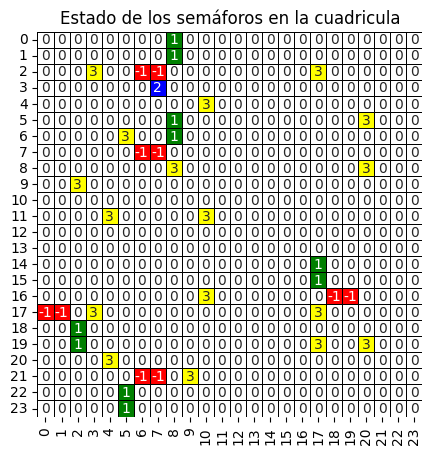

posicion: (3, 7)


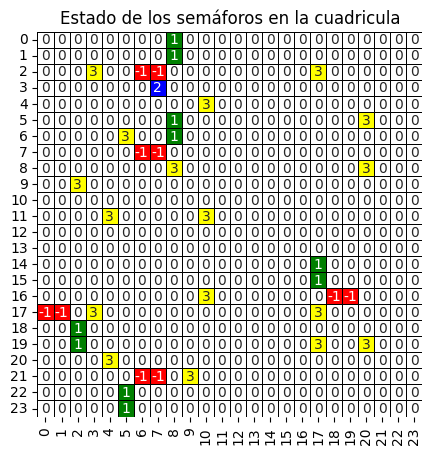

posicion: (3, 7)


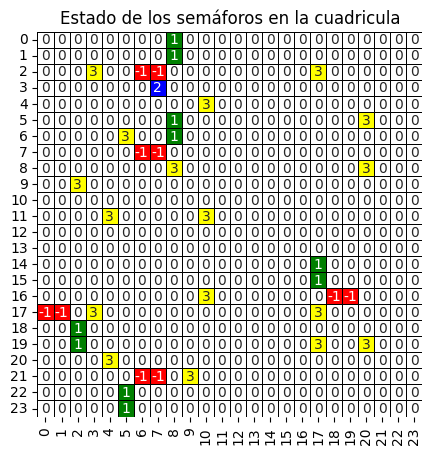

posicion: (3, 7)


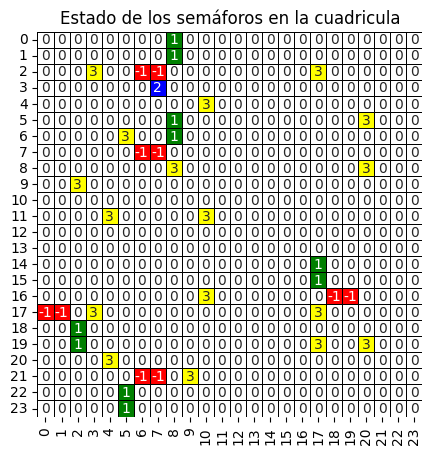

posicion: (3, 7)


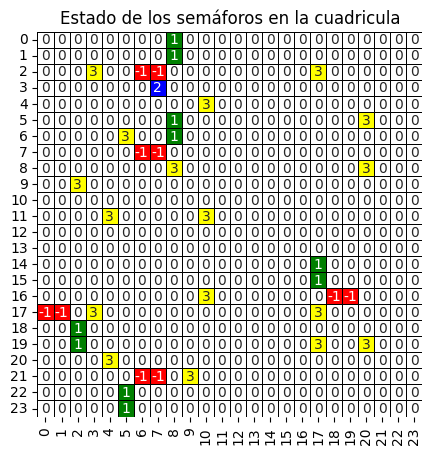

posicion: (3, 7)


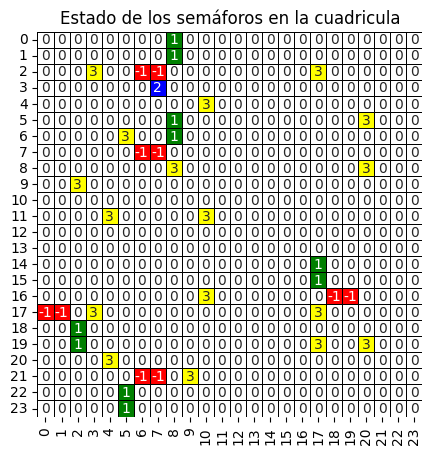

Semaforo 1 cambión de color
Semaforo: 1 | Color: VERDE | Posicion (2, 6)
Semaforo 2 cambión de color
Semaforo: 2 | Color: VERDE | Posicion (2, 7)
Semaforo 3 cambión de color
Semaforo: 3 | Color: VERDE | Posicion (7, 6)
Semaforo 4 cambión de color
Semaforo: 4 | Color: VERDE | Posicion (7, 7)
Semaforo 5 cambión de color
Semaforo: 5 | Color: VERDE | Posicion (17, 0)
Semaforo 6 cambión de color
Semaforo: 6 | Color: VERDE | Posicion (17, 1)
Semaforo 7 cambión de color
Semaforo: 7 | Color: VERDE | Posicion (21, 6)
Semaforo 8 cambión de color
Semaforo: 8 | Color: VERDE | Posicion (21, 7)
Semaforo 9 cambión de color
Semaforo: 9 | Color: VERDE | Posicion (16, 18)
Semaforo 10 cambión de color
Semaforo: 10 | Color: VERDE | Posicion (16, 19)
Semaforo 11 cambión de color
Semaforo: 11 | Color: ROJO | Posicion (0, 8)
Semaforo 12 cambión de color
Semaforo: 12 | Color: ROJO | Posicion (1, 8)
Semaforo 13 cambión de color
Semaforo: 13 | Color: ROJO | Posicion (5, 8)
Semaforo 14 cambión de color
Semaforo:

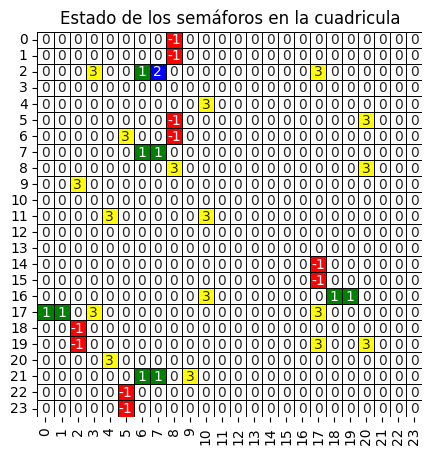

posicion: (2, 7)
[(1, 7)]


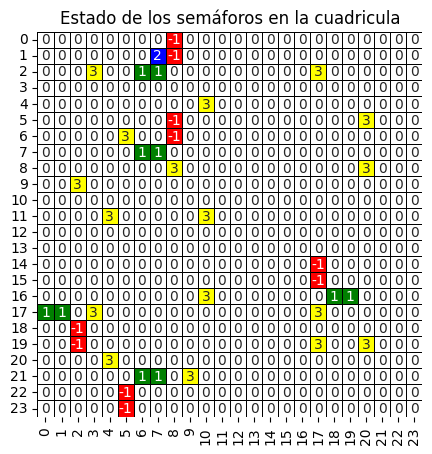

posicion: (1, 7)
[(1, 6)]


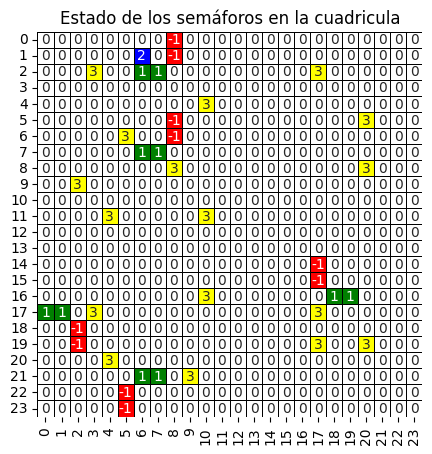

posicion: (1, 6)
[(1, 5)]


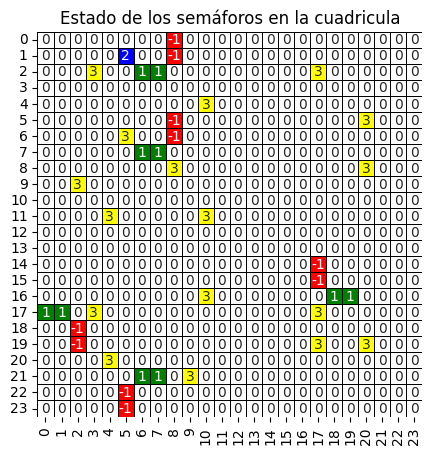

posicion: (1, 5)
[(1, 4)]


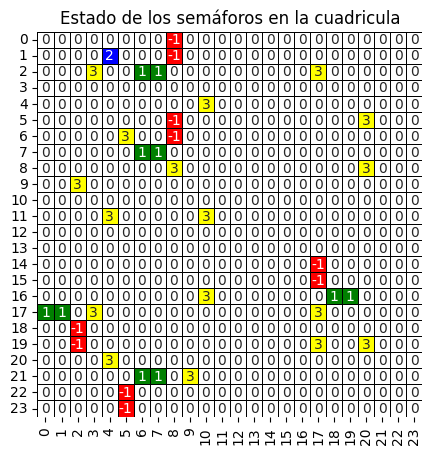

posicion: (1, 4)
[(1, 3)]


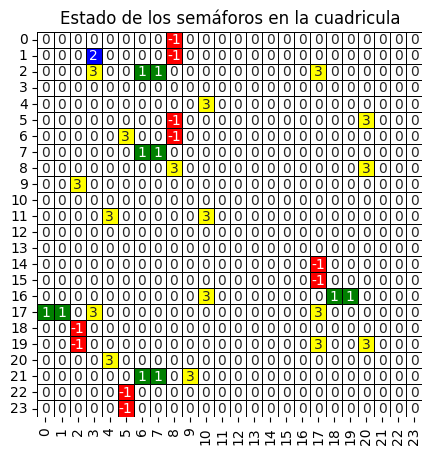

posicion: (1, 3)
[(1, 2)]


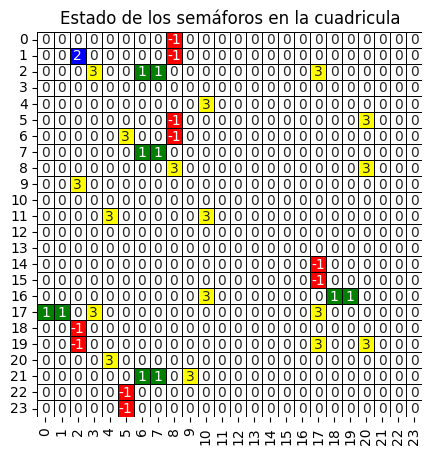

posicion: (1, 2)
[(1, 1)]


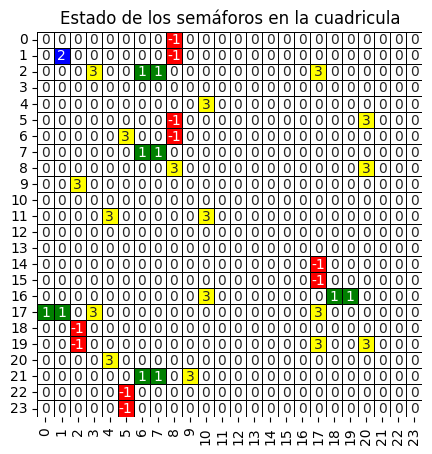

posicion: (1, 1)
[(1, 0)]


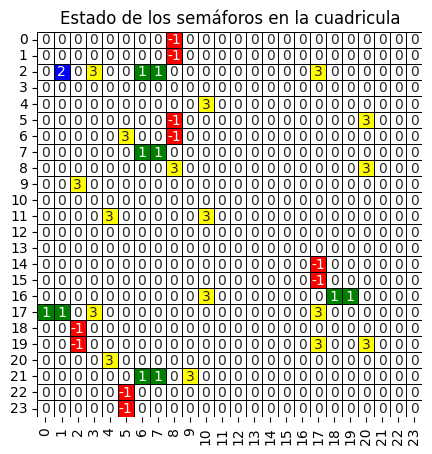

posicion: (2, 1)
[(3, 1)]


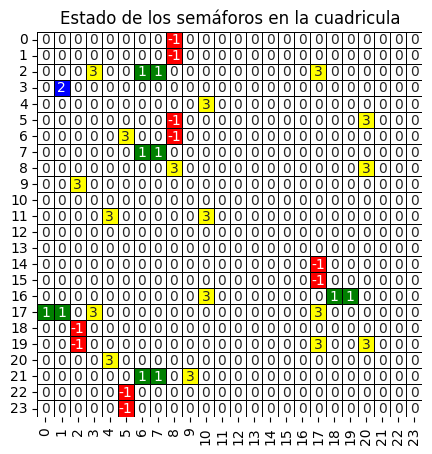

posicion: (3, 1)
[(4, 1)]


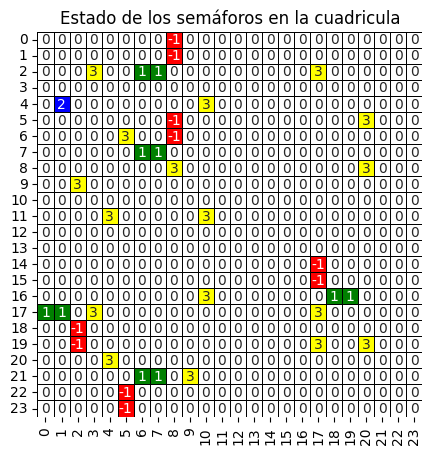

posicion: (4, 1)
[(5, 1)]


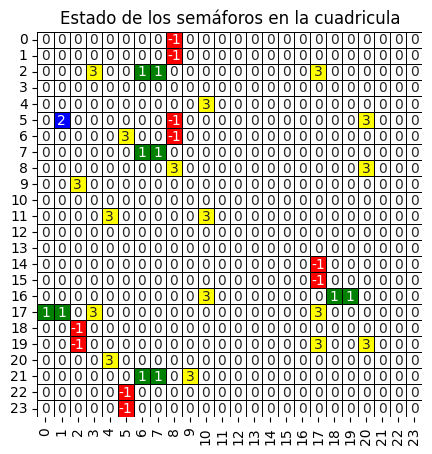

posicion: (5, 1)
[(6, 1)]


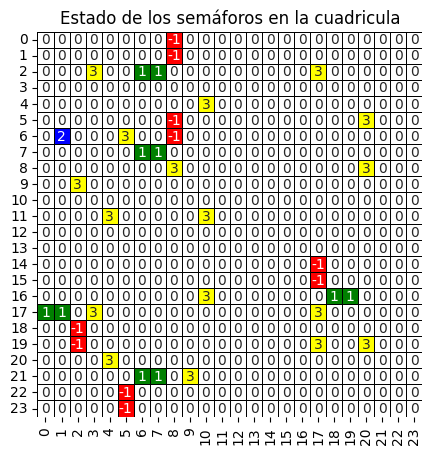

posicion: (6, 1)
[(7, 1)]


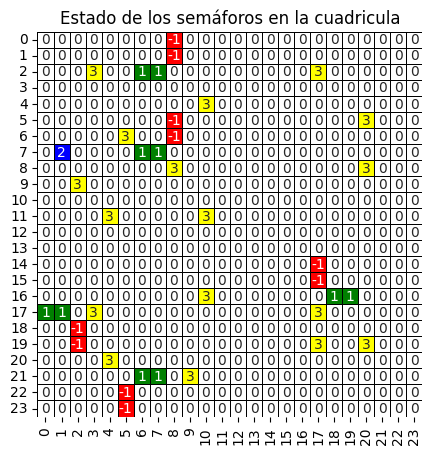

posicion: (7, 1)
[(8, 1)]


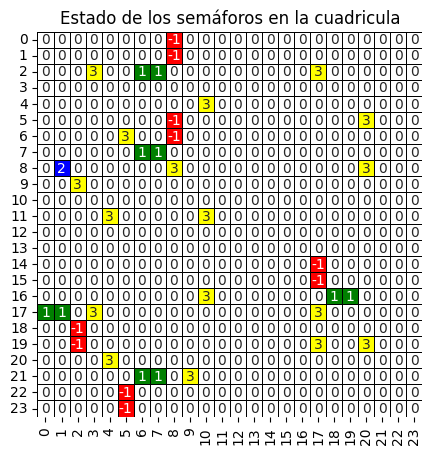

posicion: (8, 1)
[(9, 1)]


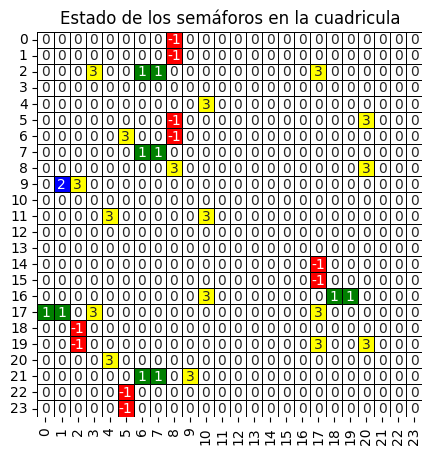

posicion: (9, 1)
[(10, 1)]


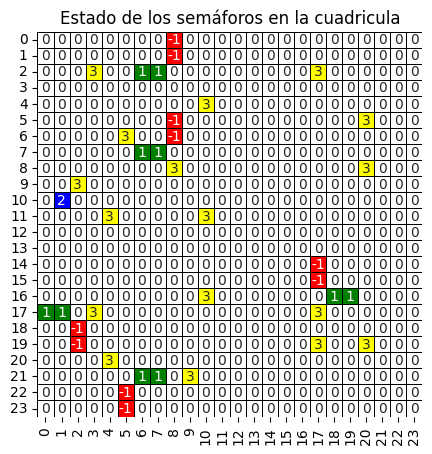

posicion: (10, 1)
[(11, 1)]


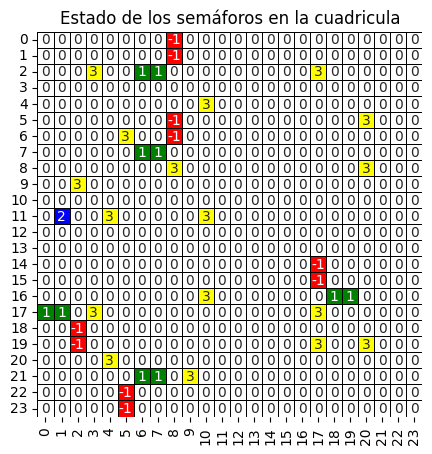

posicion: (11, 1)
[(12, 1)]


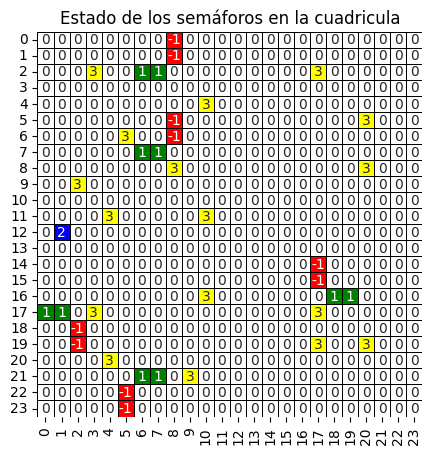

posicion: (12, 1)
[(13, 1)]


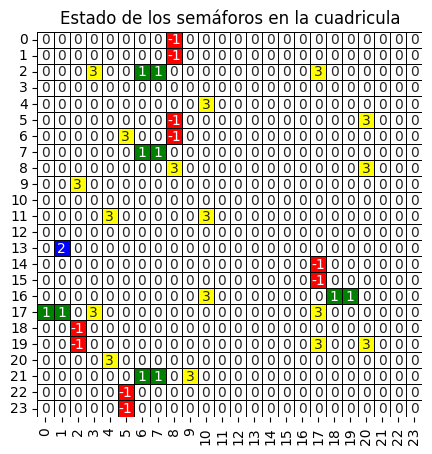

posicion: (13, 1)
[(14, 1)]


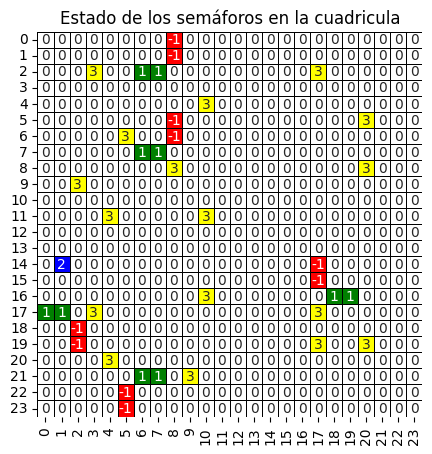

posicion: (14, 1)
[(14, 2)]


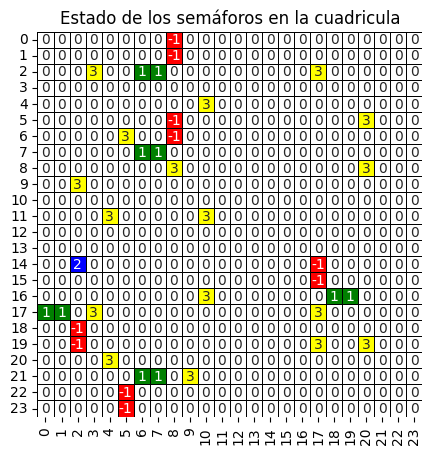

posicion: (14, 2)
[(14, 3)]


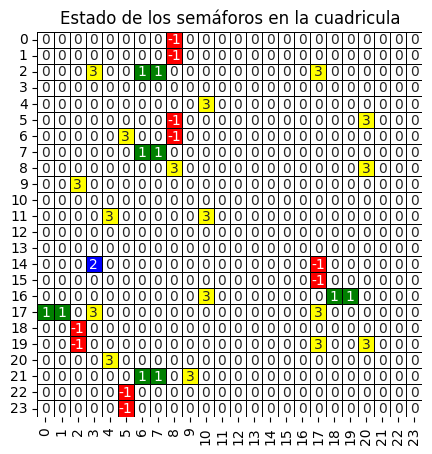

posicion: (14, 3)
[(14, 4)]


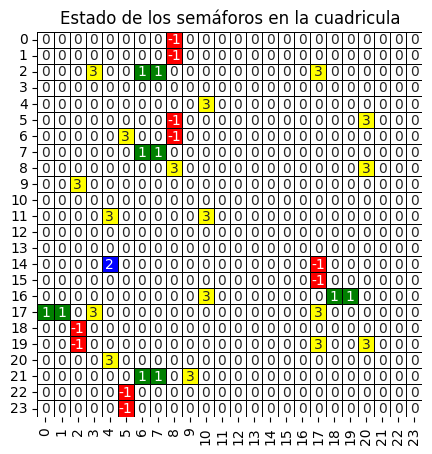

posicion: (14, 4)
[(14, 5)]


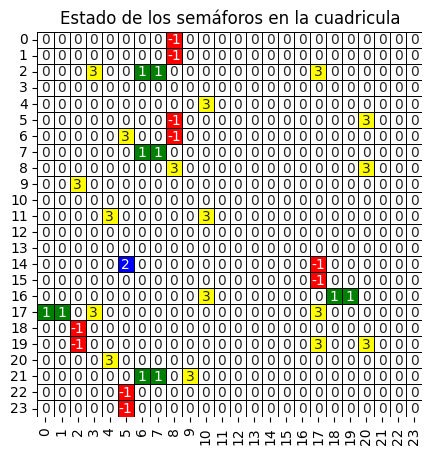

posicion: (14, 5)
[(14, 6)]


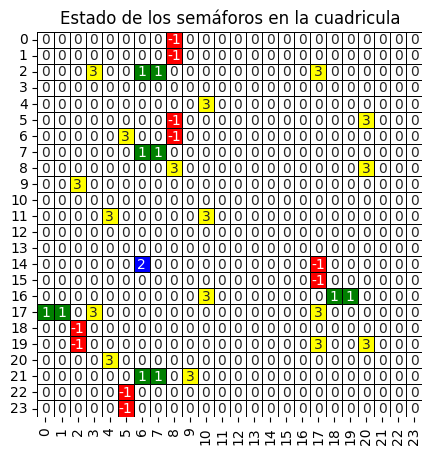

posicion: (14, 6)
[(14, 7)]


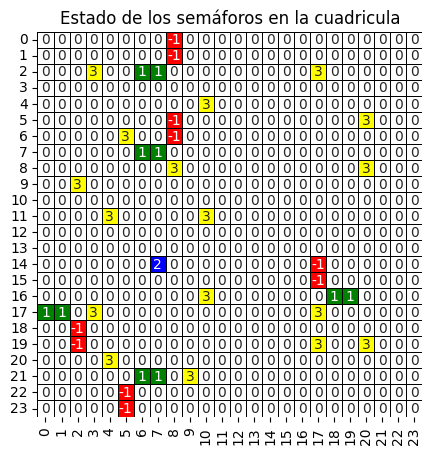

posicion: (14, 7)
[(14, 8)]


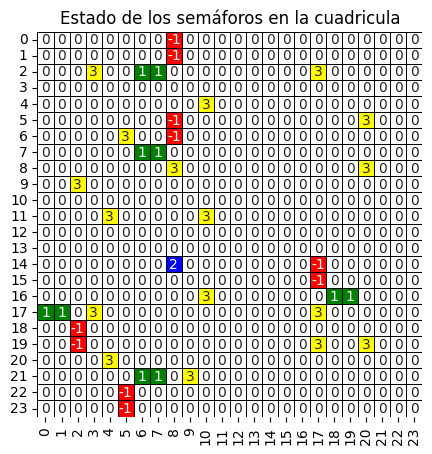

posicion: (14, 8)
[(14, 9)]


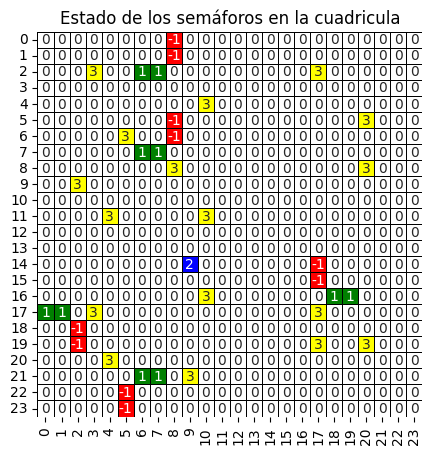

posicion: (14, 9)
[(14, 10)]


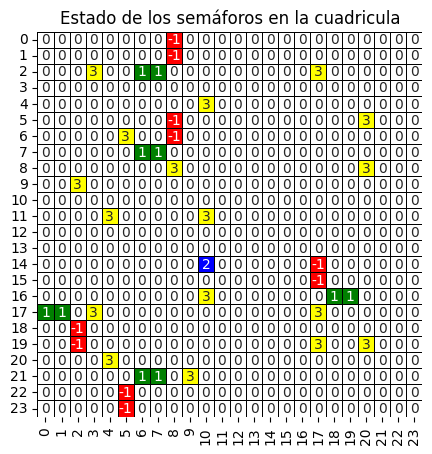

posicion: (14, 10)
[(14, 11)]


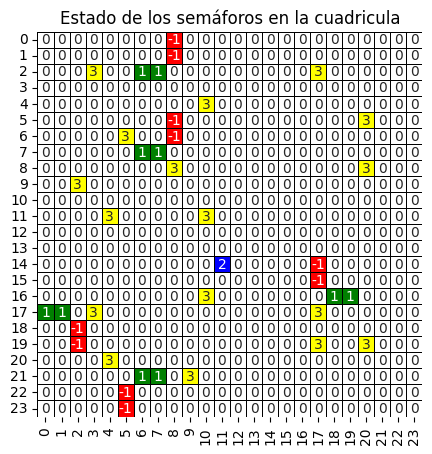

posicion: (14, 11)
[(14, 12)]


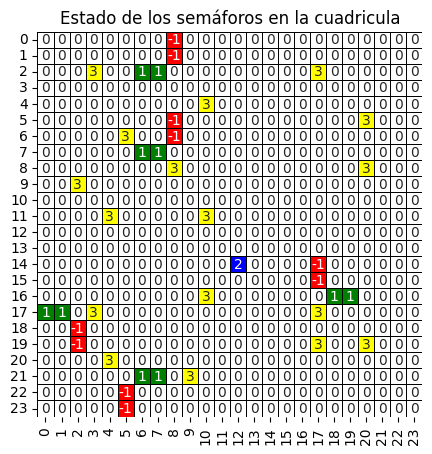

posicion: (14, 12)
[(15, 12)]


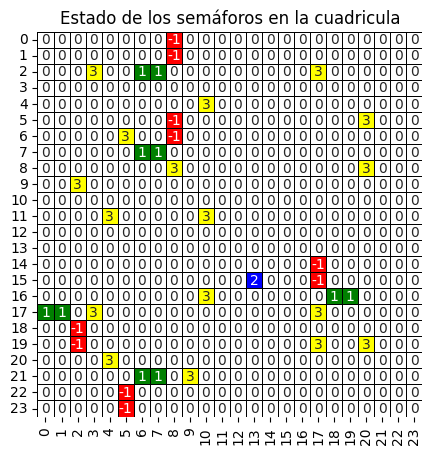

posicion: (15, 13)
[(15, 14)]


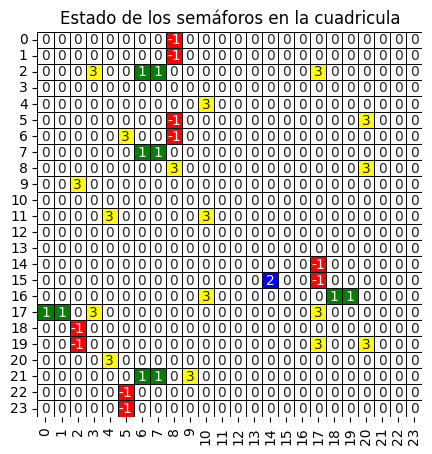

posicion: (15, 14)
[(15, 15)]


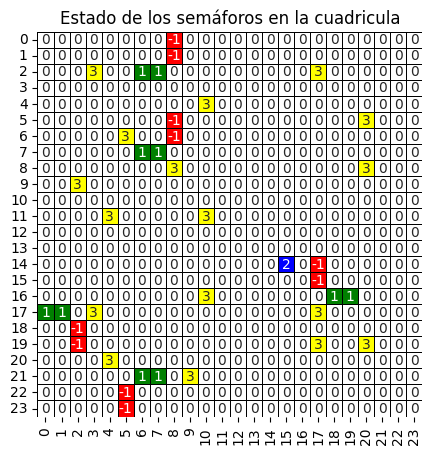

posicion: (14, 15)
[(14, 16)]


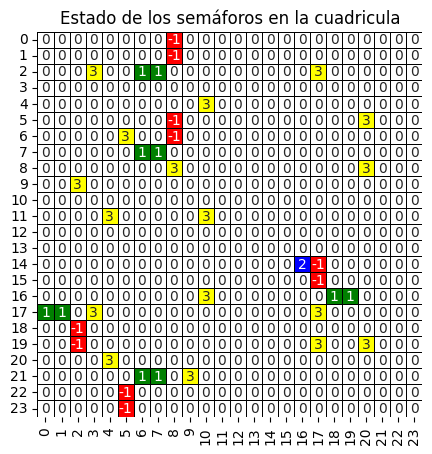

posicion: (14, 16)


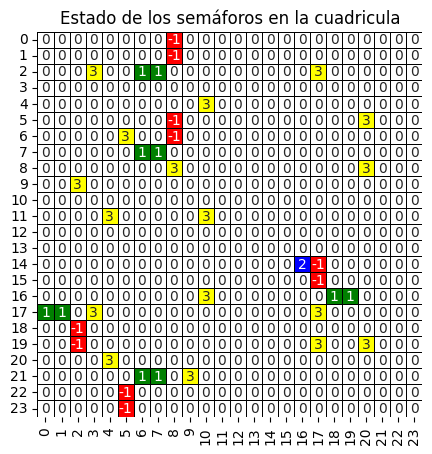

posicion: (14, 16)


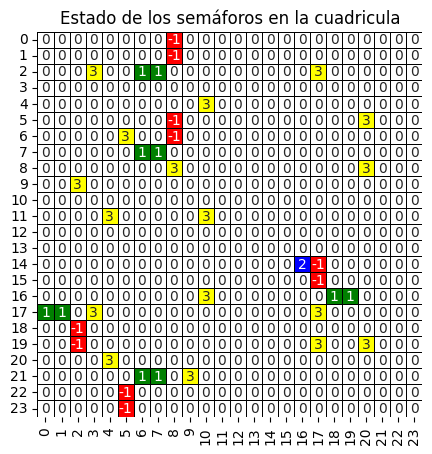

posicion: (14, 16)


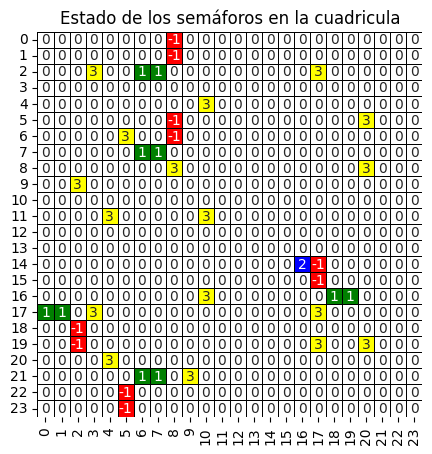

posicion: (14, 16)


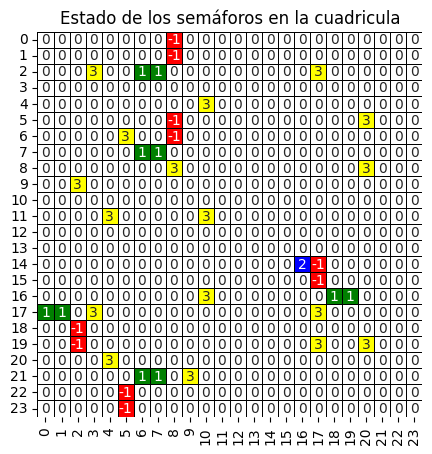

Semaforo 1 cambión de color
Semaforo: 1 | Color: ROJO | Posicion (2, 6)
Semaforo 2 cambión de color
Semaforo: 2 | Color: ROJO | Posicion (2, 7)
Semaforo 3 cambión de color
Semaforo: 3 | Color: ROJO | Posicion (7, 6)
Semaforo 4 cambión de color
Semaforo: 4 | Color: ROJO | Posicion (7, 7)
Semaforo 5 cambión de color
Semaforo: 5 | Color: ROJO | Posicion (17, 0)
Semaforo 6 cambión de color
Semaforo: 6 | Color: ROJO | Posicion (17, 1)
Semaforo 7 cambión de color
Semaforo: 7 | Color: ROJO | Posicion (21, 6)
Semaforo 8 cambión de color
Semaforo: 8 | Color: ROJO | Posicion (21, 7)
Semaforo 9 cambión de color
Semaforo: 9 | Color: ROJO | Posicion (16, 18)
Semaforo 10 cambión de color
Semaforo: 10 | Color: ROJO | Posicion (16, 19)
Semaforo 11 cambión de color
Semaforo: 11 | Color: VERDE | Posicion (0, 8)
Semaforo 12 cambión de color
Semaforo: 12 | Color: VERDE | Posicion (1, 8)
Semaforo 13 cambión de color
Semaforo: 13 | Color: VERDE | Posicion (5, 8)
Semaforo 14 cambión de color
Semaforo: 14 | C

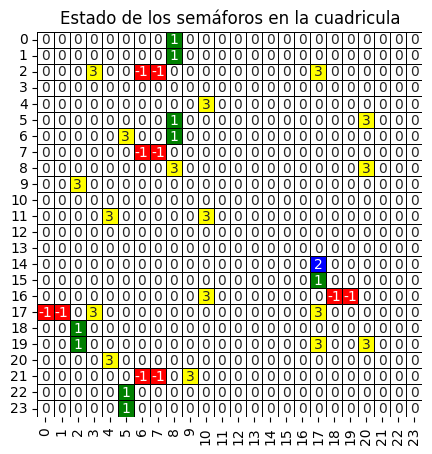

posicion: (14, 17)
[(14, 18)]


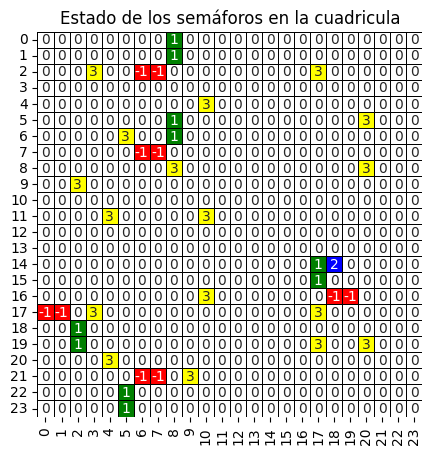

posicion: (14, 18)
[(14, 19)]


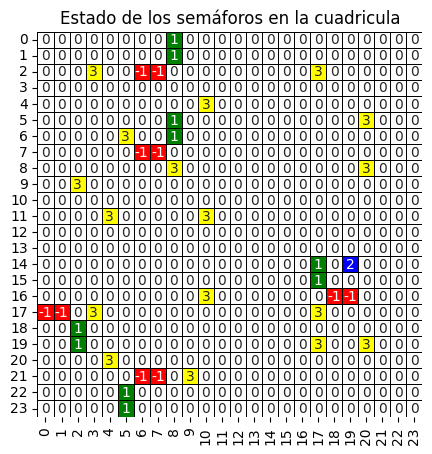

posicion: (14, 19)
[(14, 20)]


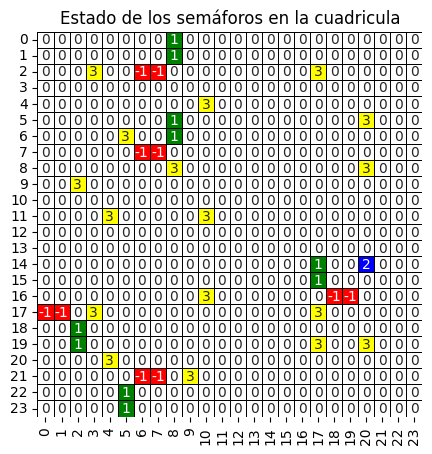

posicion: (14, 20)
[(14, 21)]


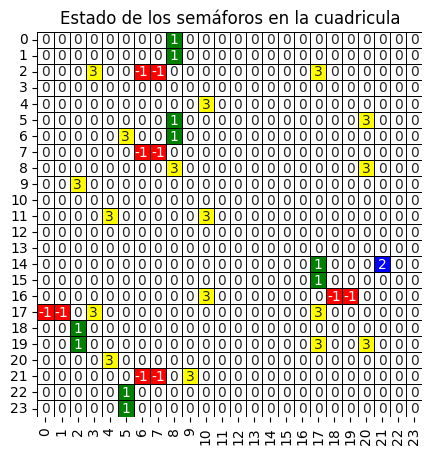

posicion: (14, 21)
[(14, 22)]


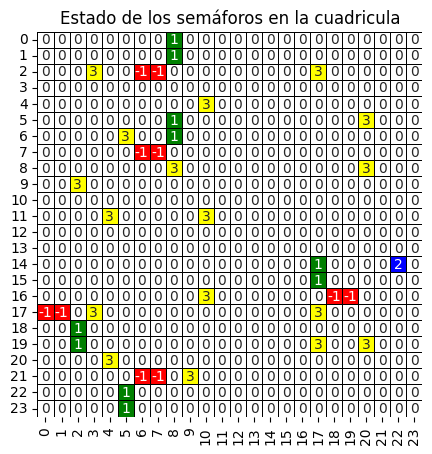

posicion: (14, 22)
[(13, 22)]


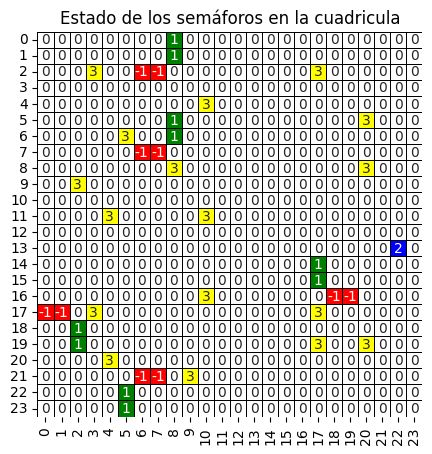

posicion: (13, 22)
[(13, 21)]


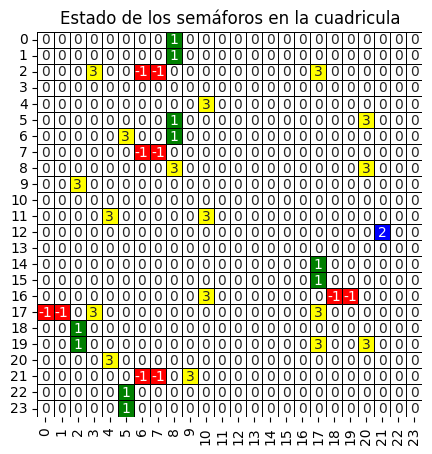

posicion: (12, 21)
[(12, 20)]


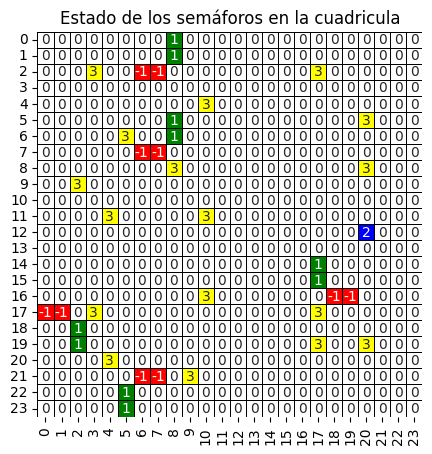

posicion: (12, 20)
[(12, 19)]


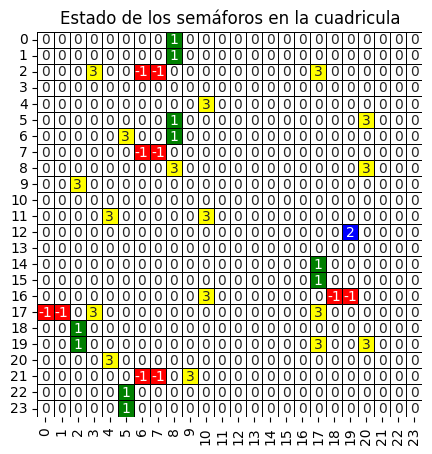

posicion: (12, 19)
[(12, 18)]


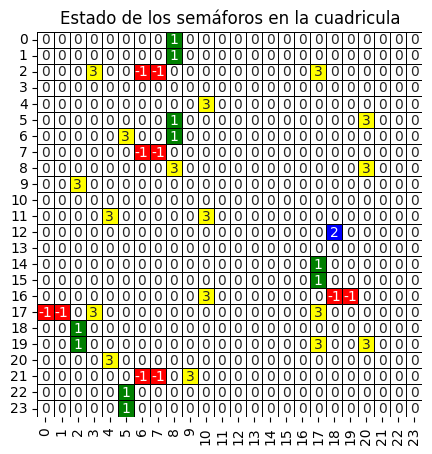

posicion: (12, 18)
[(12, 17)]


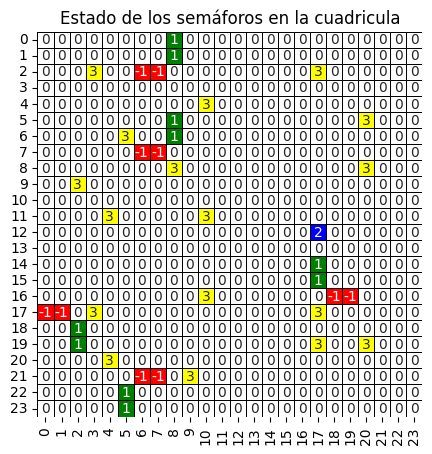

posicion: (12, 17)
[(12, 16)]


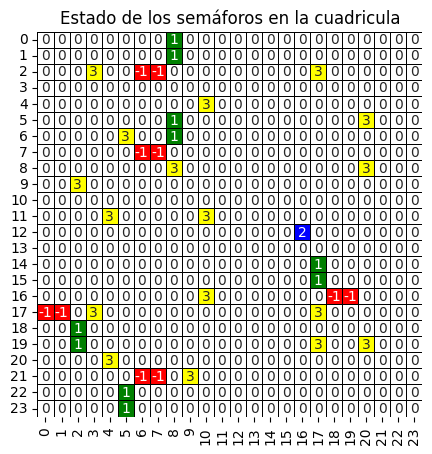

posicion: (12, 16)
[(12, 15)]


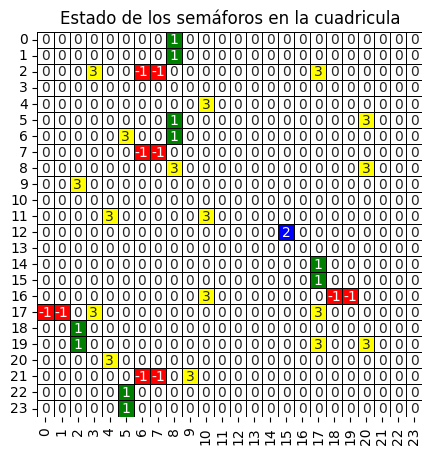

posicion: (12, 15)
[(12, 14)]


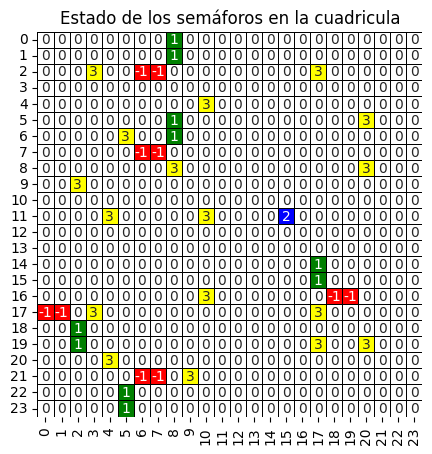

posicion: (11, 15)
[(10, 15)]


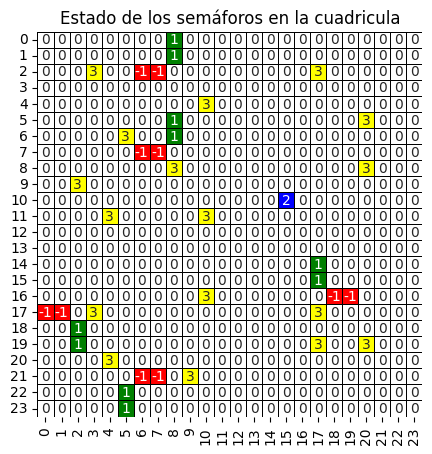

posicion: (10, 15)
[(9, 15)]


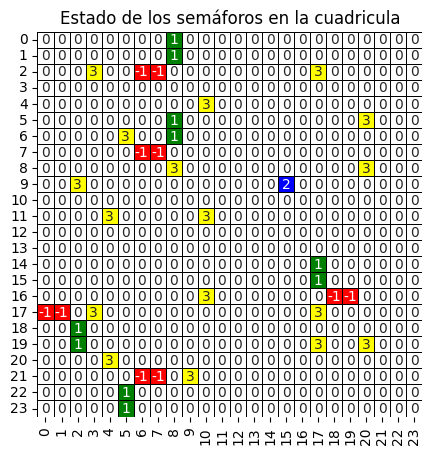

posicion: (9, 15)
[(8, 15)]


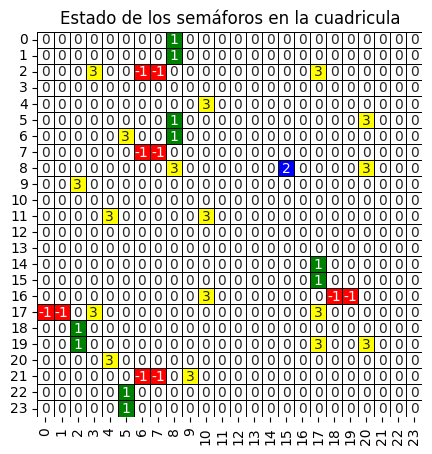

posicion: (8, 15)
[(7, 15)]


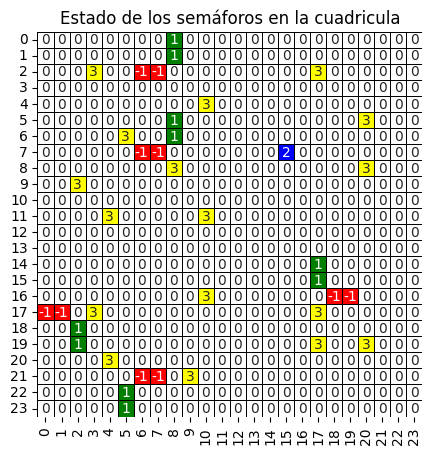

posicion: (7, 15)
[(6, 15)]


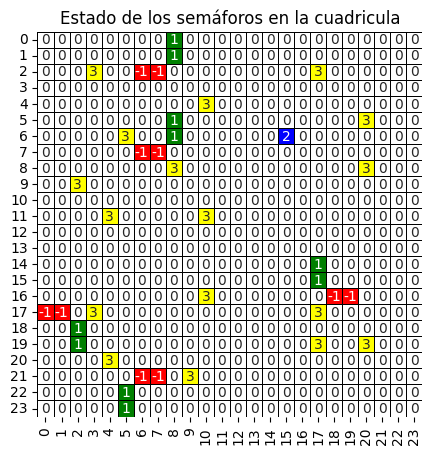

posicion: (6, 15)
[(5, 15)]


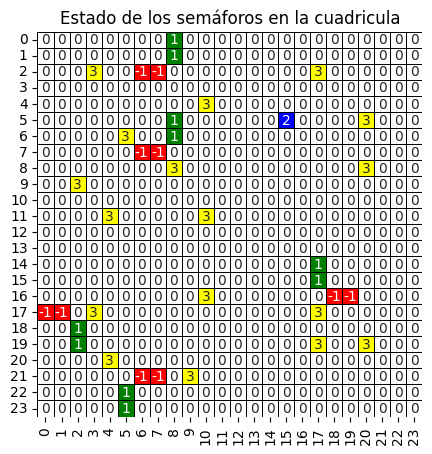

posicion: (5, 15)
[(4, 15)]


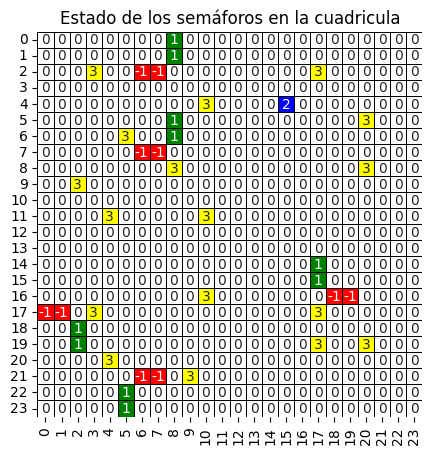

posicion: (4, 15)
[(3, 15)]


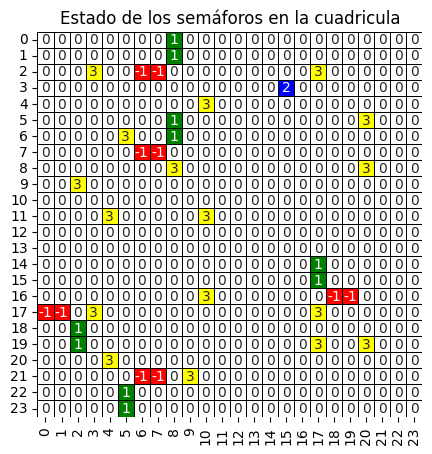

posicion: (3, 15)
[(2, 15)]


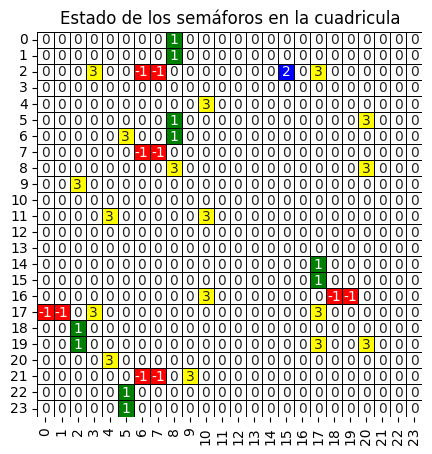

posicion: (2, 15)
[(1, 15)]


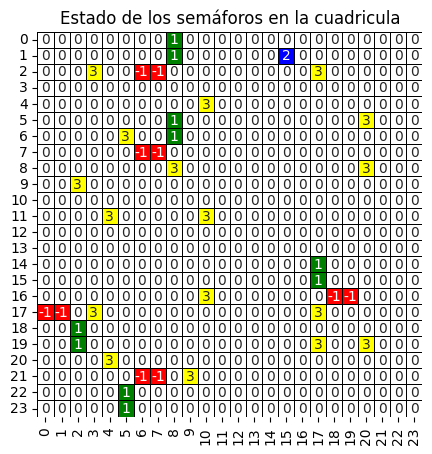

posicion: (1, 15)
[(1, 14)]


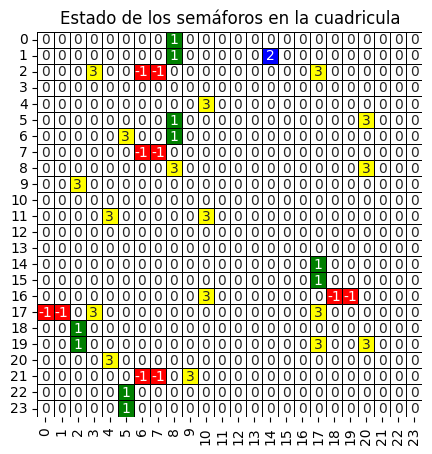

posicion: (1, 14)
[(1, 13)]


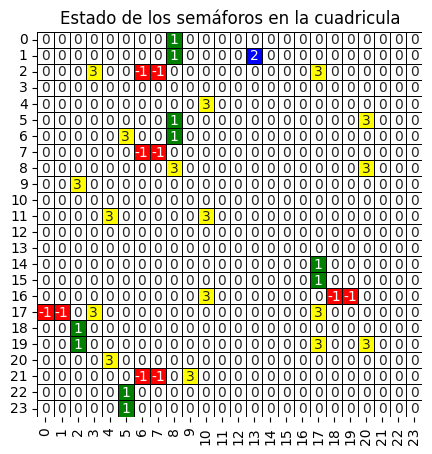

posicion: (1, 13)
[(1, 12)]


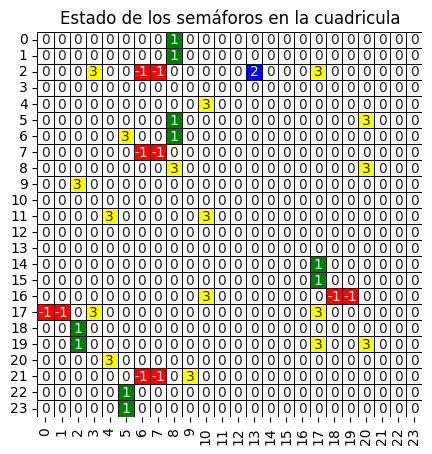

posicion: (2, 13)
[(3, 13)]


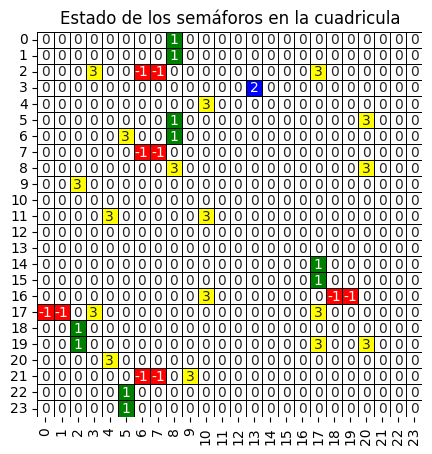

posicion: (3, 13)
[(4, 13)]


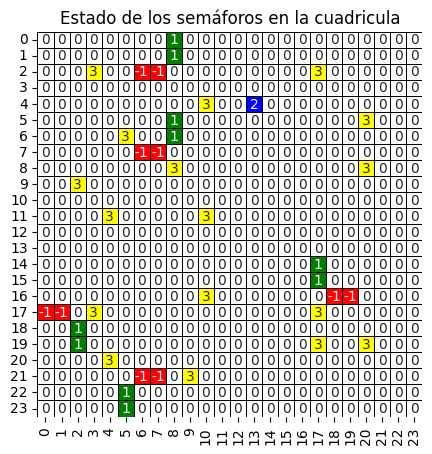

posicion: (4, 13)
[(5, 13)]


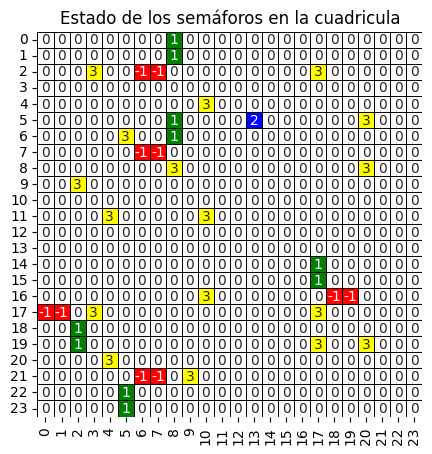

posicion: (5, 13)
[(6, 13)]


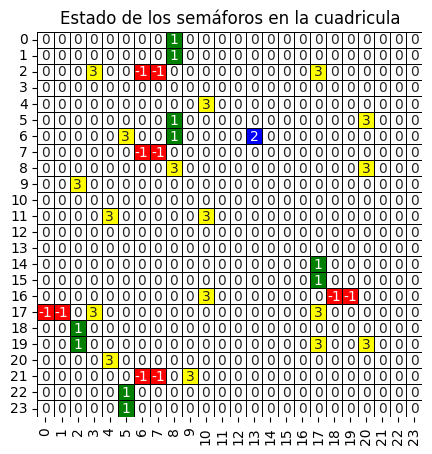

posicion: (6, 13)
[(7, 13)]


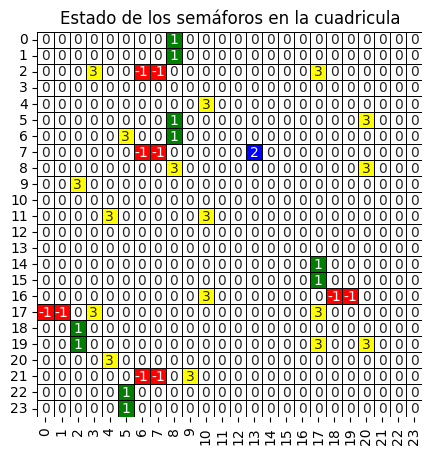

posicion: (7, 13)
[(8, 13)]


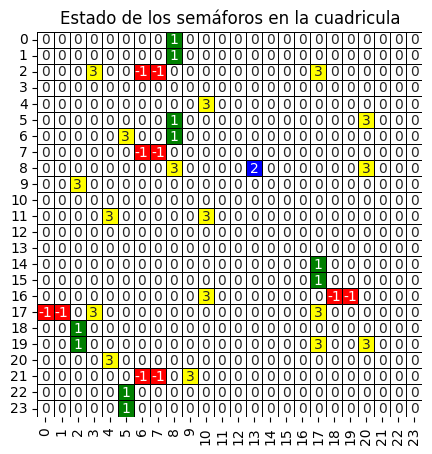

posicion: (8, 13)
[(9, 13)]


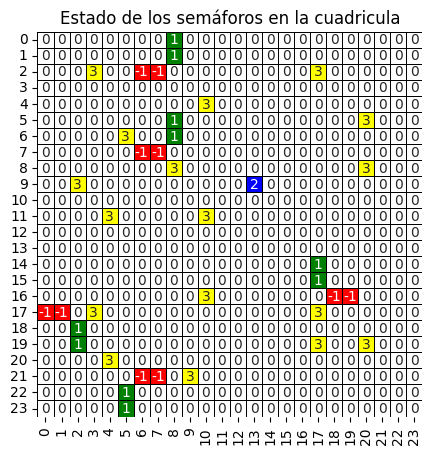

posicion: (9, 13)
[(10, 13)]


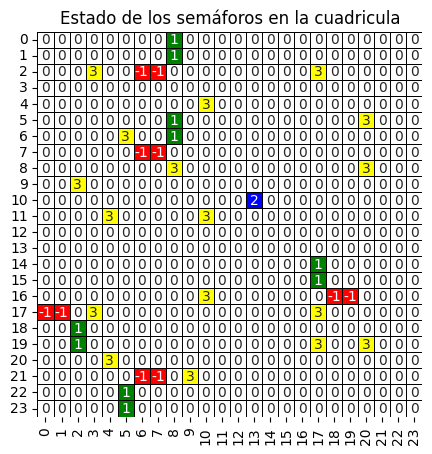

posicion: (10, 13)
[(11, 13)]


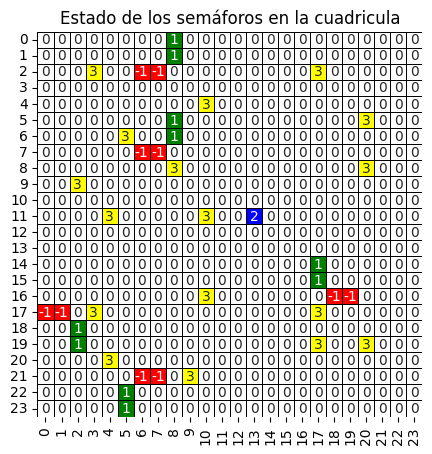

posicion: (11, 13)
[(12, 13)]


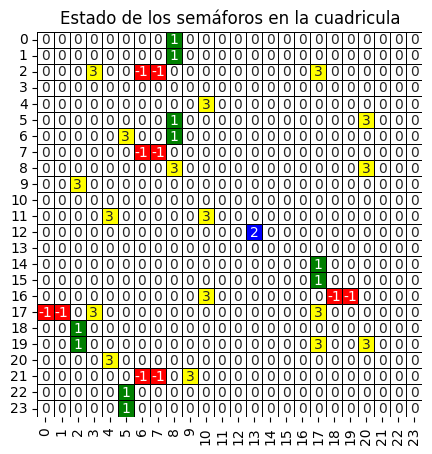

posicion: (12, 13)
[(12, 12)]


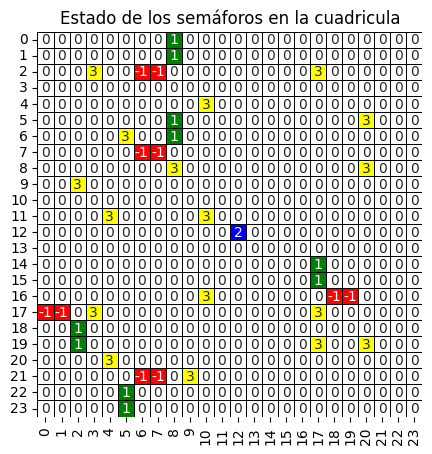

posicion: (12, 12)
[(12, 11)]


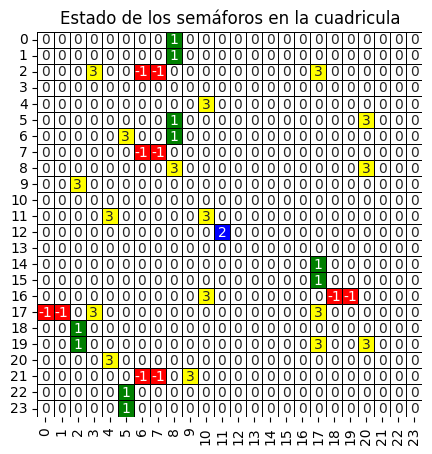

Semaforo 1 cambión de color
Semaforo: 1 | Color: VERDE | Posicion (2, 6)
Semaforo 2 cambión de color
Semaforo: 2 | Color: VERDE | Posicion (2, 7)
Semaforo 3 cambión de color
Semaforo: 3 | Color: VERDE | Posicion (7, 6)
Semaforo 4 cambión de color
Semaforo: 4 | Color: VERDE | Posicion (7, 7)
Semaforo 5 cambión de color
Semaforo: 5 | Color: VERDE | Posicion (17, 0)
Semaforo 6 cambión de color
Semaforo: 6 | Color: VERDE | Posicion (17, 1)
Semaforo 7 cambión de color
Semaforo: 7 | Color: VERDE | Posicion (21, 6)
Semaforo 8 cambión de color
Semaforo: 8 | Color: VERDE | Posicion (21, 7)
Semaforo 9 cambión de color
Semaforo: 9 | Color: VERDE | Posicion (16, 18)
Semaforo 10 cambión de color
Semaforo: 10 | Color: VERDE | Posicion (16, 19)
Semaforo 11 cambión de color
Semaforo: 11 | Color: ROJO | Posicion (0, 8)
Semaforo 12 cambión de color
Semaforo: 12 | Color: ROJO | Posicion (1, 8)
Semaforo 13 cambión de color
Semaforo: 13 | Color: ROJO | Posicion (5, 8)
Semaforo 14 cambión de color
Semaforo:

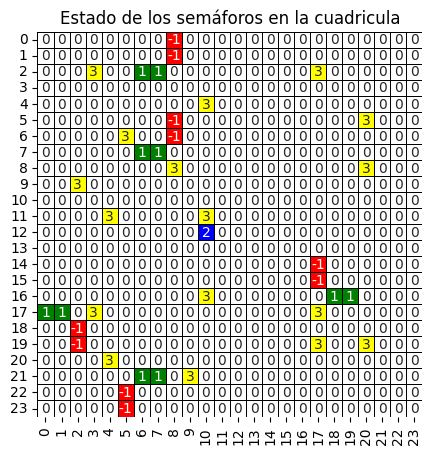

posicion: (12, 10)
[(12, 9)]


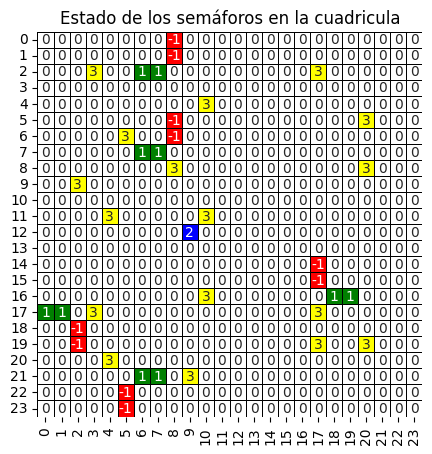

posicion: (12, 9)
[(12, 8)]


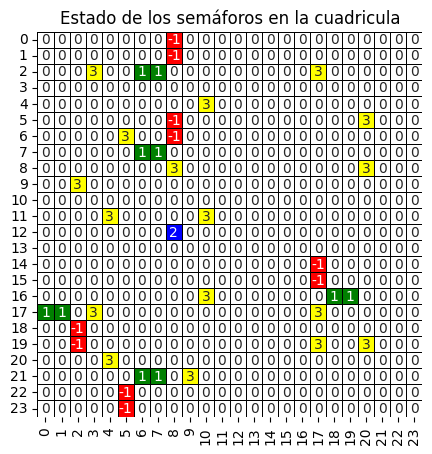

posicion: (12, 8)
[(12, 7)]


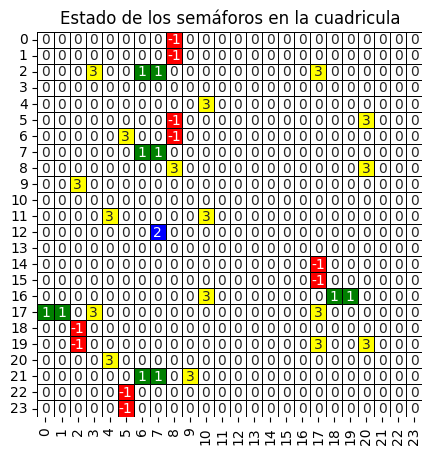

posicion: (12, 7)
[(12, 6)]


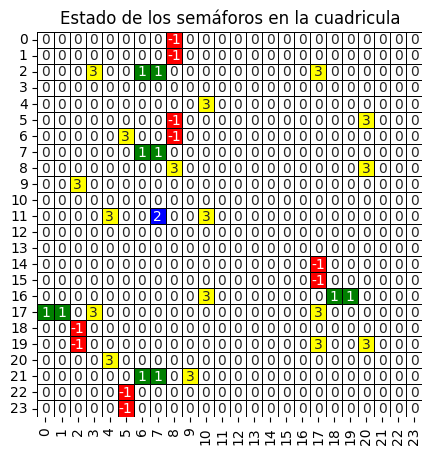

posicion: (11, 7)
[(10, 7)]


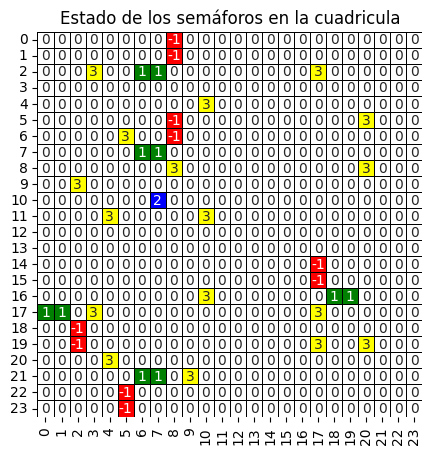

posicion: (10, 7)
[(9, 7)]


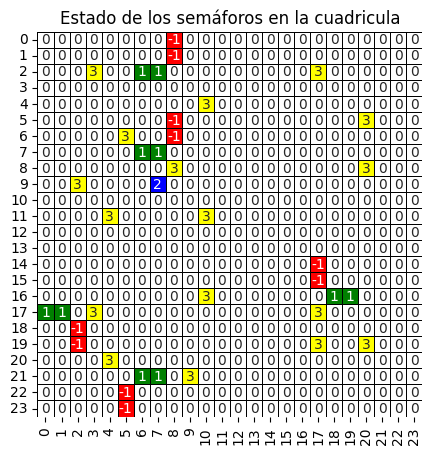

posicion: (9, 7)
[(8, 7)]


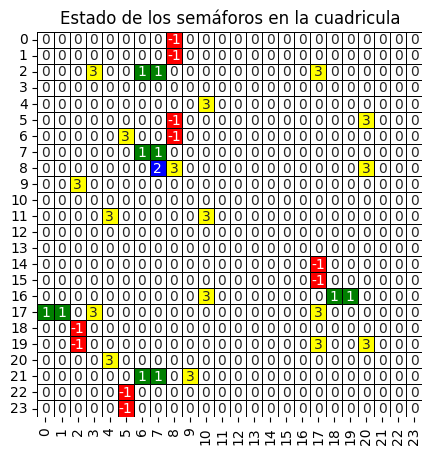

posicion: (8, 7)
[(7, 7)]


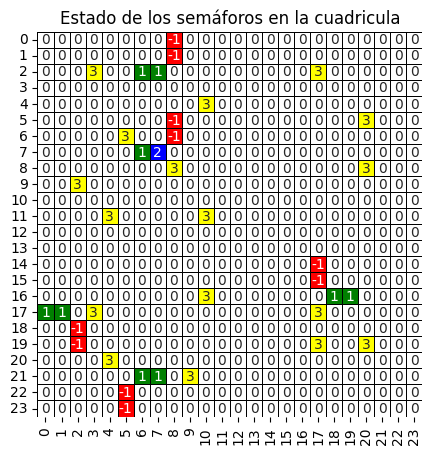

posicion: (7, 7)
[(6, 7)]


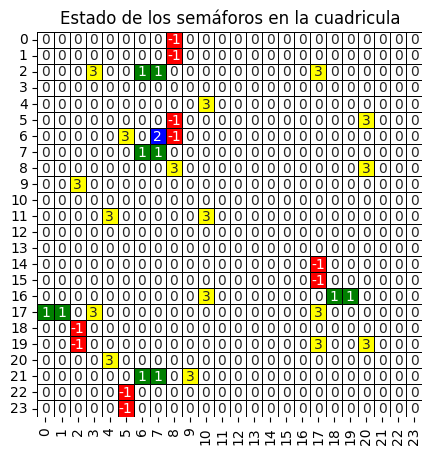

posicion: (6, 7)
[(5, 7)]


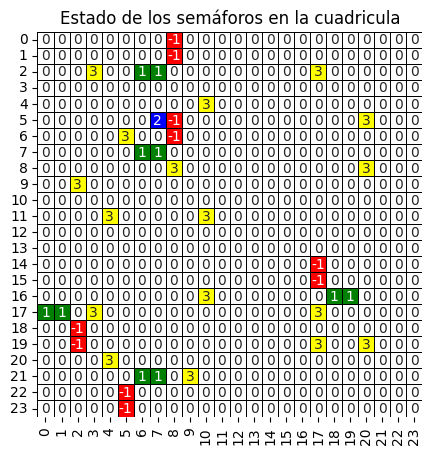

posicion: (5, 7)
[(4, 7)]


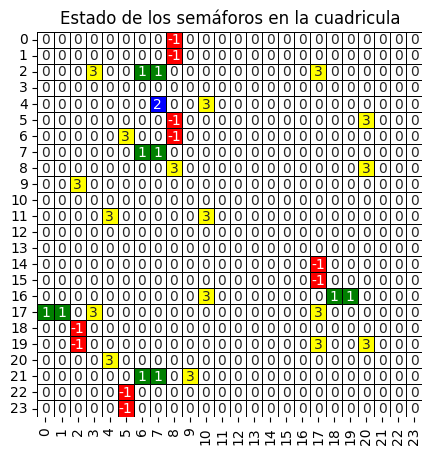

posicion: (4, 7)
[(3, 7)]


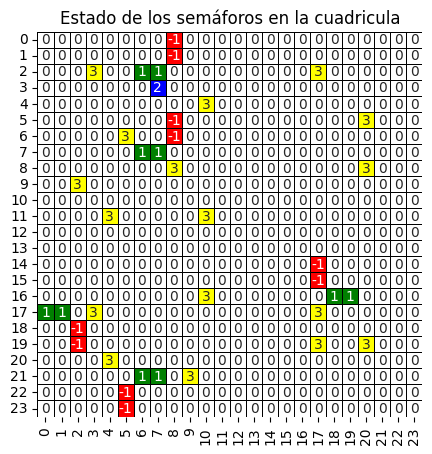

posicion: (3, 7)
[(2, 7)]


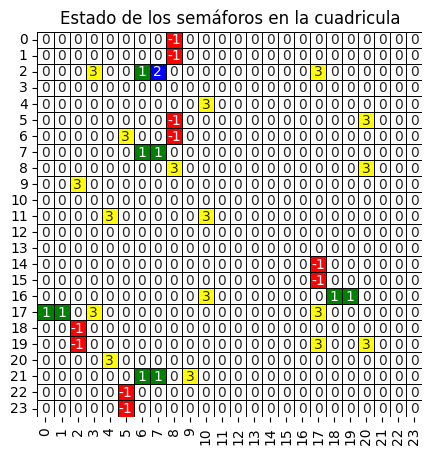

posicion: (2, 7)
[(1, 7)]


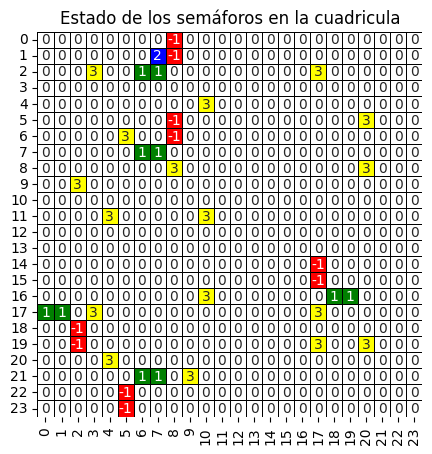

posicion: (1, 7)
[(1, 6)]


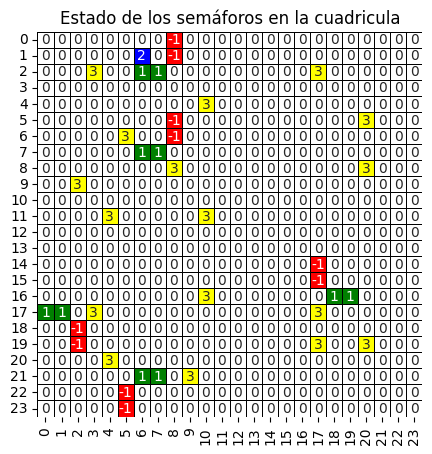

posicion: (1, 6)
[(1, 5)]


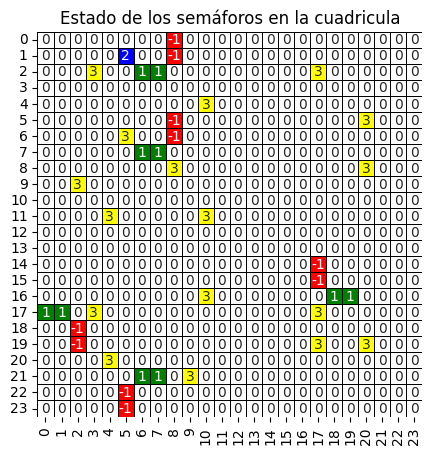

posicion: (1, 5)
[(1, 4)]


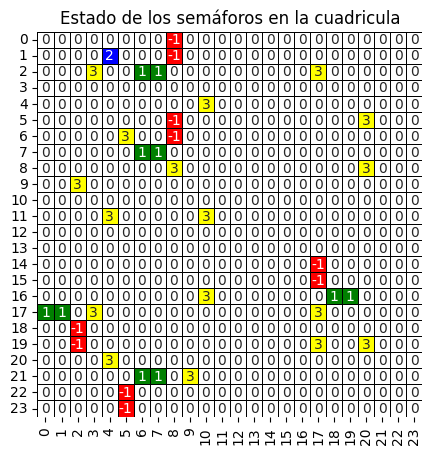

posicion: (1, 4)
[(1, 3)]


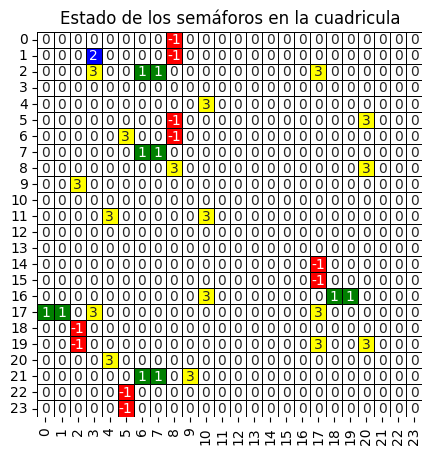

posicion: (1, 3)
[(1, 2)]


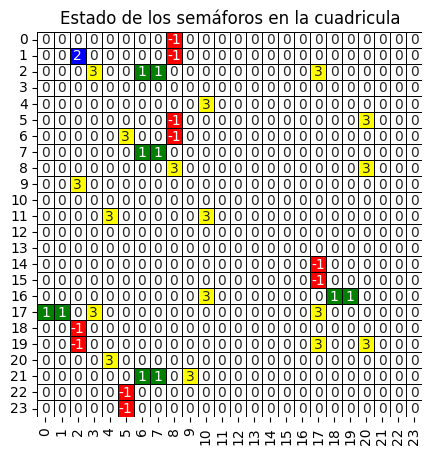

posicion: (1, 2)
[(1, 1)]


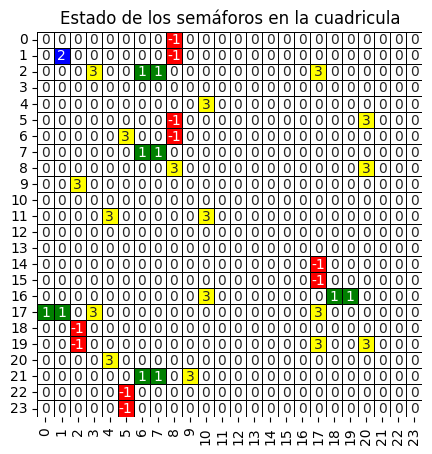

posicion: (1, 1)
[(1, 0)]


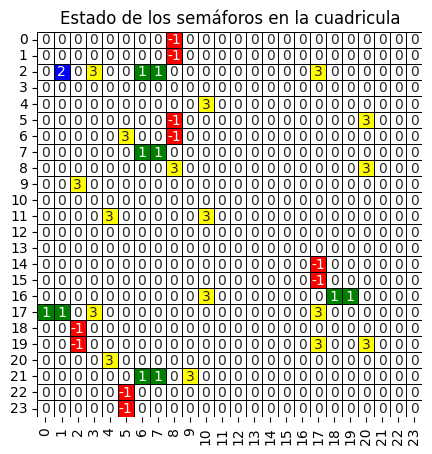

posicion: (2, 1)
[(3, 1)]


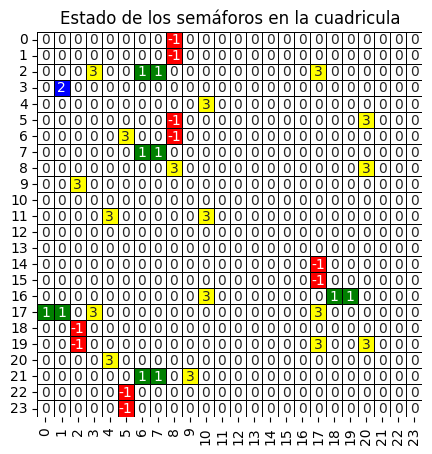

posicion: (3, 1)
[(4, 1)]


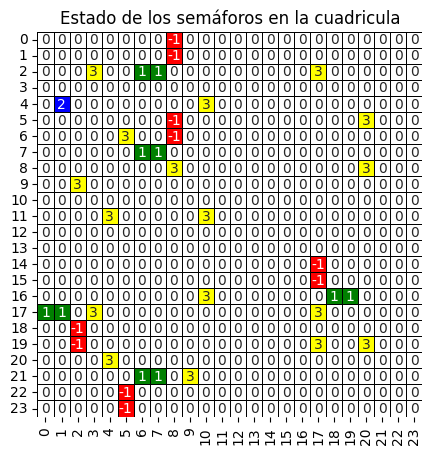

posicion: (4, 1)
[(5, 1)]


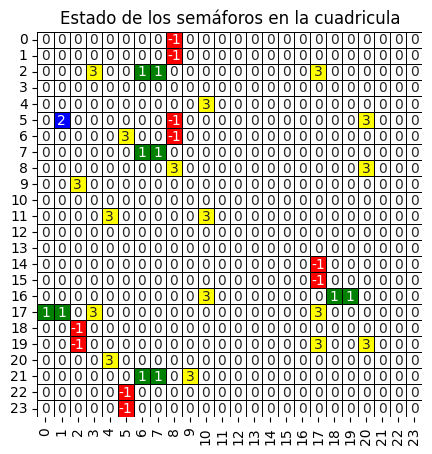

posicion: (5, 1)
[(6, 1)]


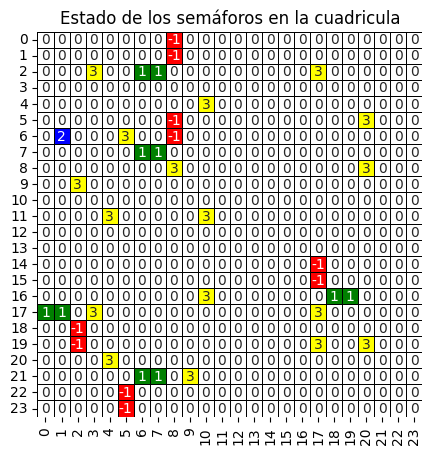

posicion: (6, 1)
[(7, 1)]


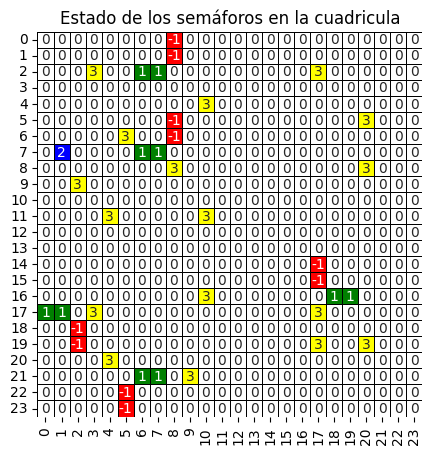

posicion: (7, 1)
[(8, 1)]


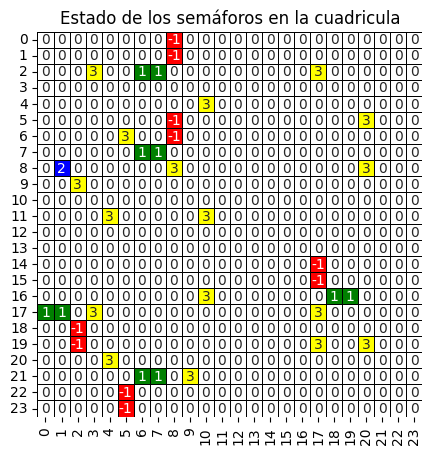

posicion: (8, 1)
[(9, 1)]


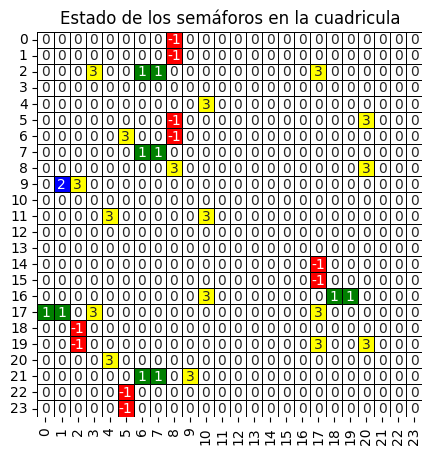

posicion: (9, 1)
[(10, 1)]


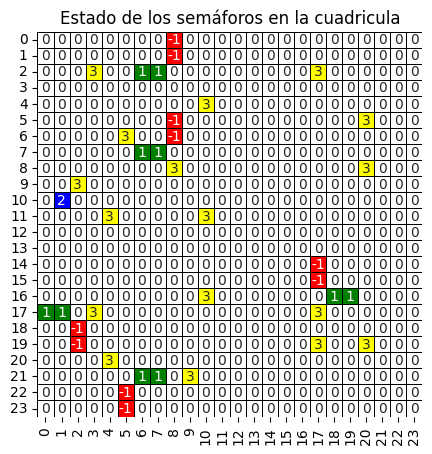

posicion: (10, 1)
[(11, 1)]


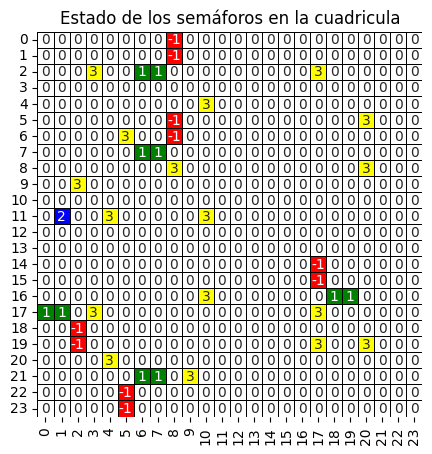

posicion: (11, 1)
[(12, 1)]


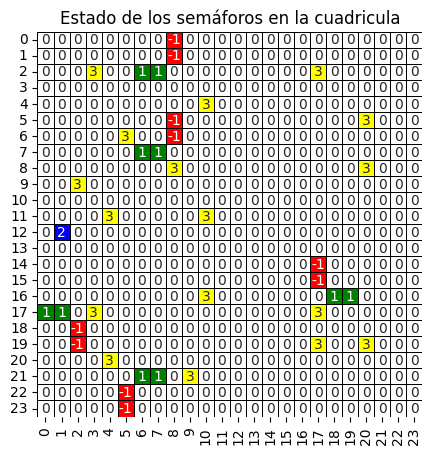

posicion: (12, 1)
[(13, 1)]


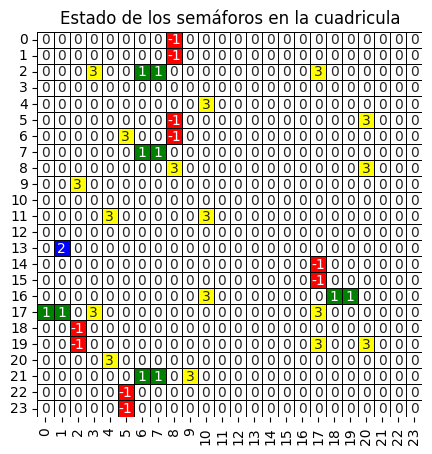

posicion: (13, 1)
[(14, 1)]


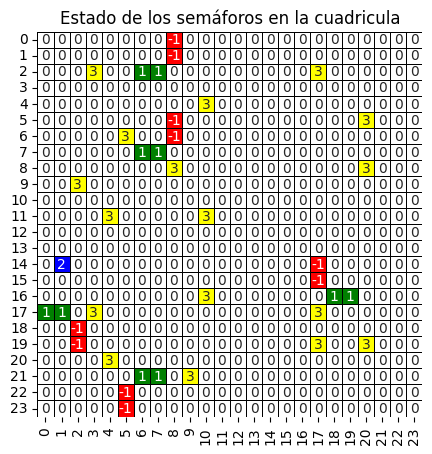

posicion: (14, 1)
[(14, 2)]


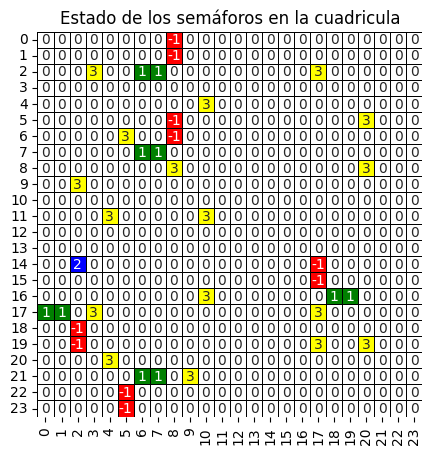

posicion: (14, 2)
[(14, 3)]


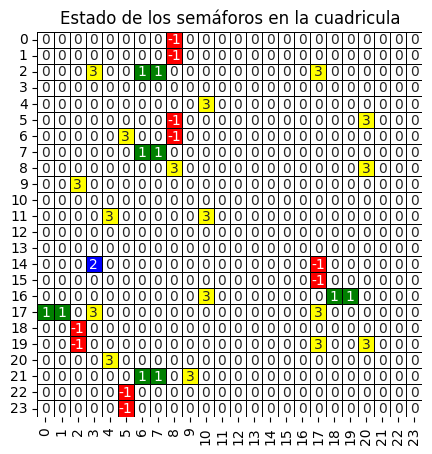

posicion: (14, 3)
[(14, 4)]


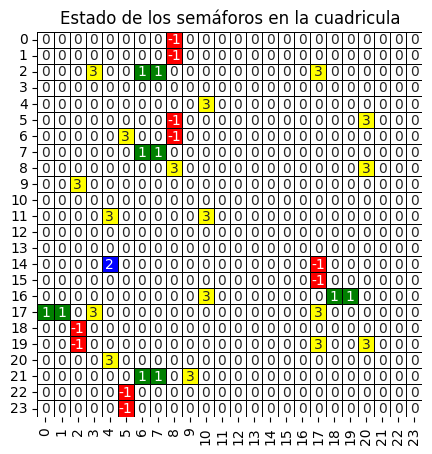

posicion: (14, 4)
[(14, 5)]


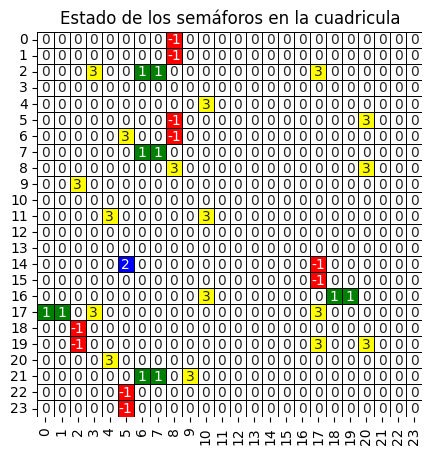

posicion: (14, 5)
[(14, 6)]


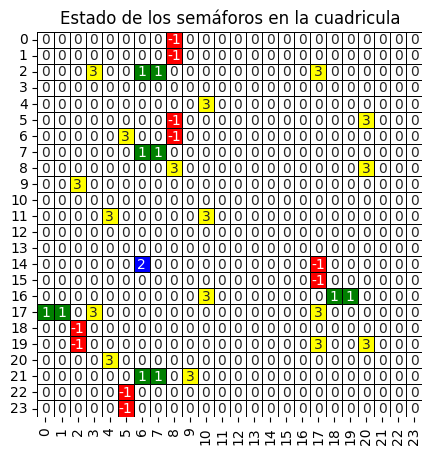

posicion: (14, 6)
[(14, 7)]


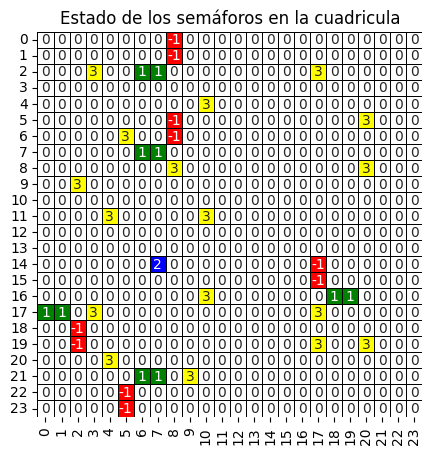

Semaforo 1 cambión de color
Semaforo: 1 | Color: ROJO | Posicion (2, 6)
Semaforo 2 cambión de color
Semaforo: 2 | Color: ROJO | Posicion (2, 7)
Semaforo 3 cambión de color
Semaforo: 3 | Color: ROJO | Posicion (7, 6)
Semaforo 4 cambión de color
Semaforo: 4 | Color: ROJO | Posicion (7, 7)
Semaforo 5 cambión de color
Semaforo: 5 | Color: ROJO | Posicion (17, 0)
Semaforo 6 cambión de color
Semaforo: 6 | Color: ROJO | Posicion (17, 1)
Semaforo 7 cambión de color
Semaforo: 7 | Color: ROJO | Posicion (21, 6)
Semaforo 8 cambión de color
Semaforo: 8 | Color: ROJO | Posicion (21, 7)
Semaforo 9 cambión de color
Semaforo: 9 | Color: ROJO | Posicion (16, 18)
Semaforo 10 cambión de color
Semaforo: 10 | Color: ROJO | Posicion (16, 19)
Semaforo 11 cambión de color
Semaforo: 11 | Color: VERDE | Posicion (0, 8)
Semaforo 12 cambión de color
Semaforo: 12 | Color: VERDE | Posicion (1, 8)
Semaforo 13 cambión de color
Semaforo: 13 | Color: VERDE | Posicion (5, 8)
Semaforo 14 cambión de color
Semaforo: 14 | C

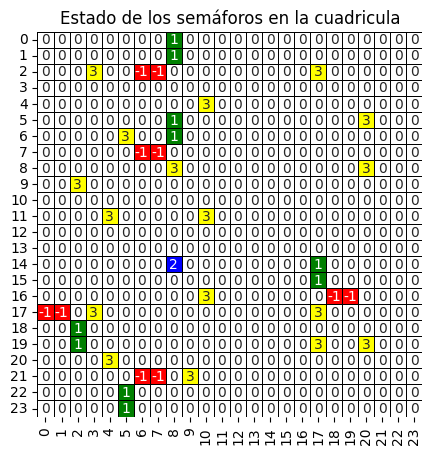

posicion: (14, 8)
[(14, 9)]


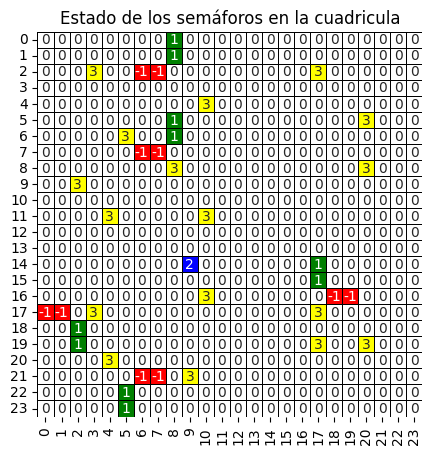

posicion: (14, 9)
[(14, 10)]


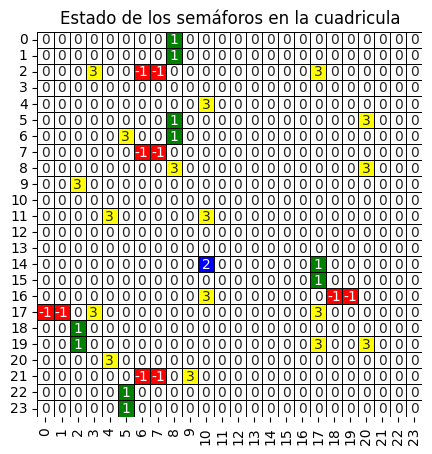

posicion: (14, 10)
[(14, 11)]


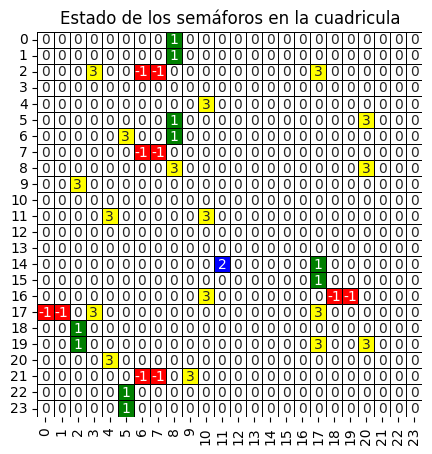

posicion: (14, 11)
[(14, 12)]


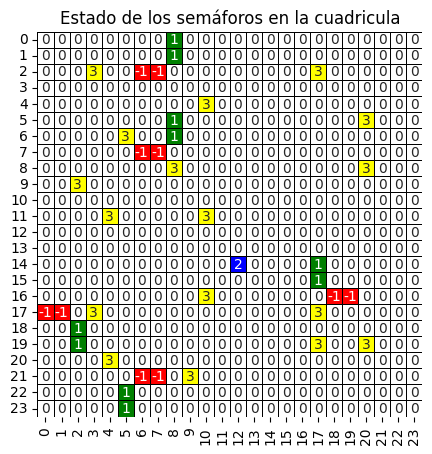

posicion: (14, 12)
[(15, 12)]


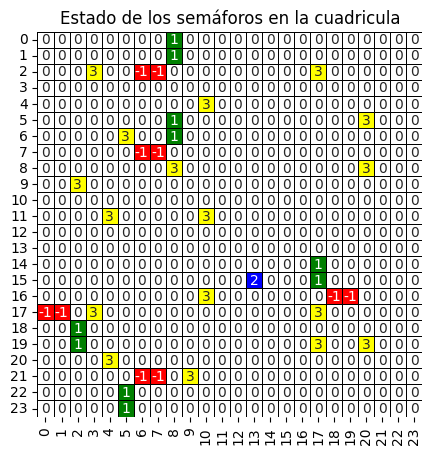

posicion: (15, 13)
[(15, 14)]


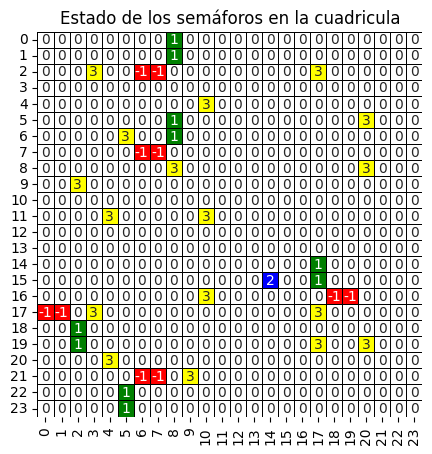

posicion: (15, 14)
[(15, 15)]


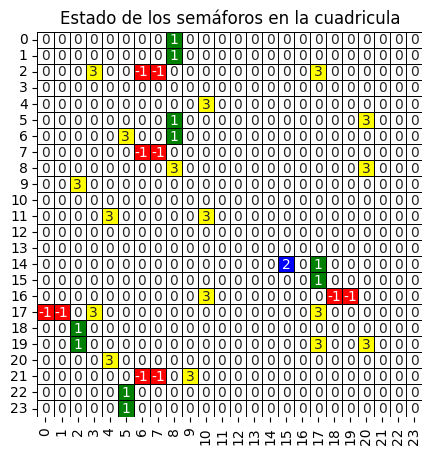

posicion: (14, 15)
[(14, 16)]


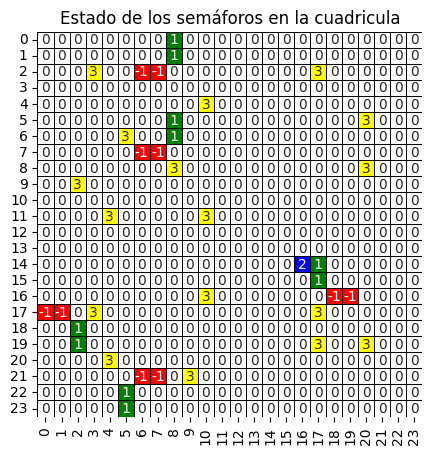

posicion: (14, 16)
[(14, 17)]


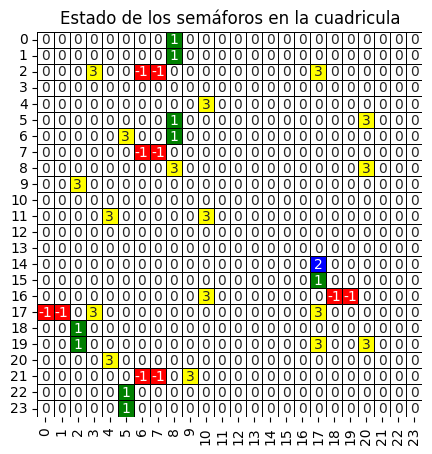

posicion: (14, 17)
[(14, 18)]


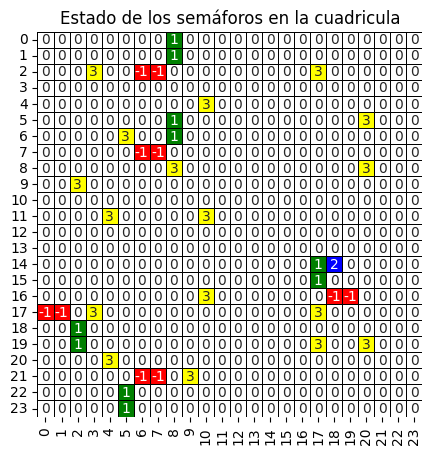

posicion: (14, 18)
[(14, 19)]


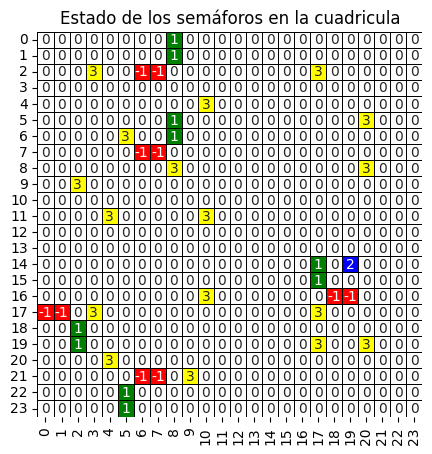

posicion: (14, 19)
[(14, 20)]


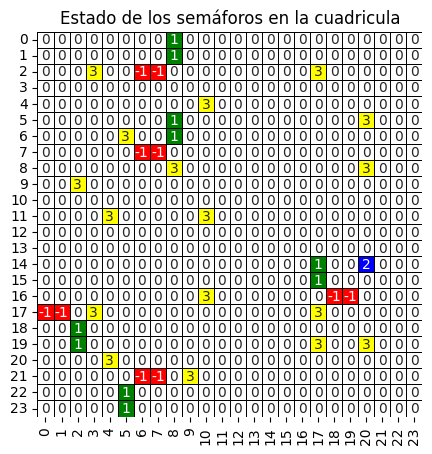

posicion: (14, 20)
[(14, 21)]


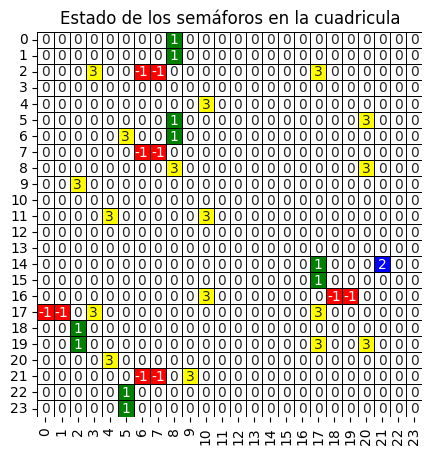

posicion: (14, 21)
[(14, 22)]


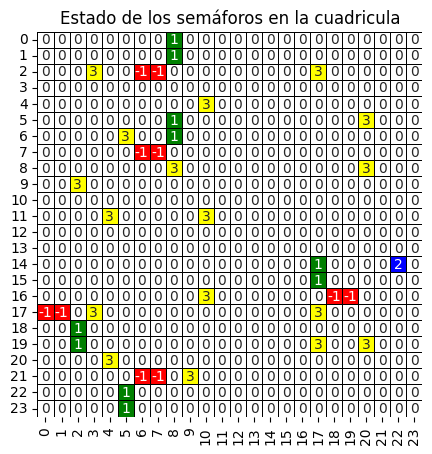

posicion: (14, 22)
[(13, 22)]


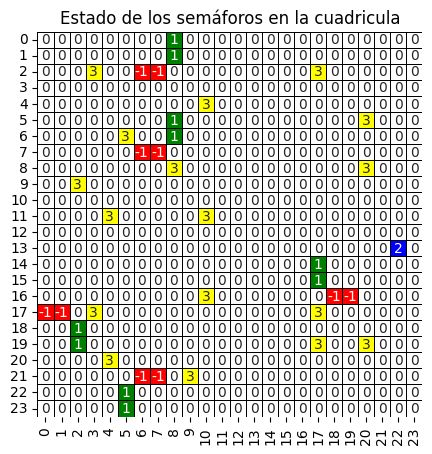

posicion: (13, 22)
[(13, 21)]


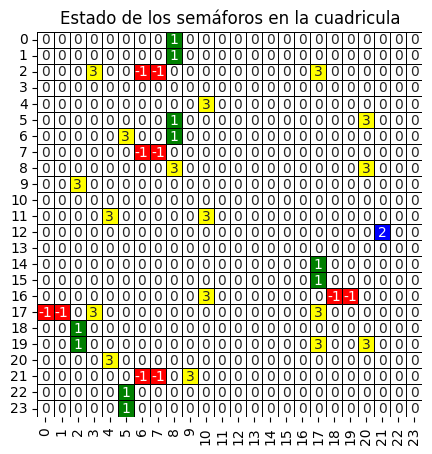

posicion: (12, 21)
[(12, 20)]


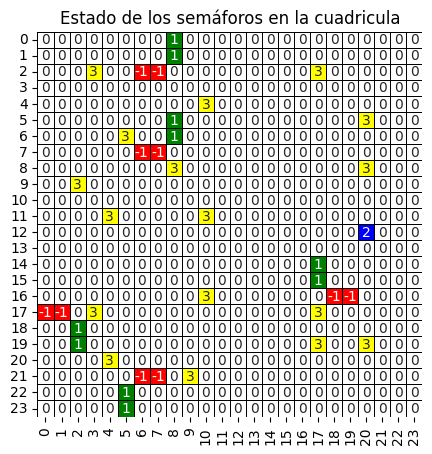

posicion: (12, 20)
[(12, 19)]


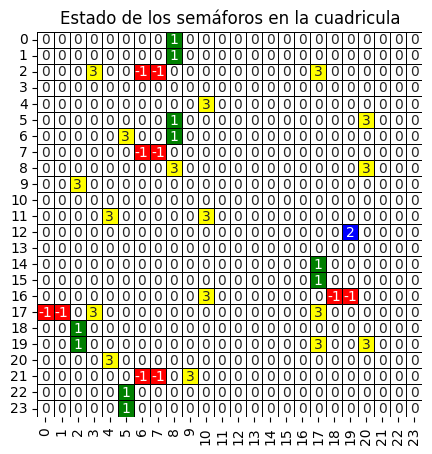

posicion: (12, 19)
[(12, 18)]


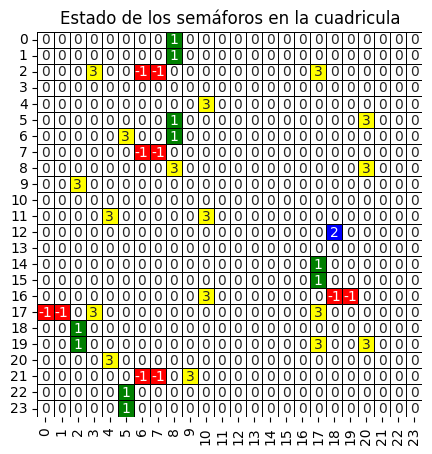

posicion: (12, 18)
[(12, 17)]


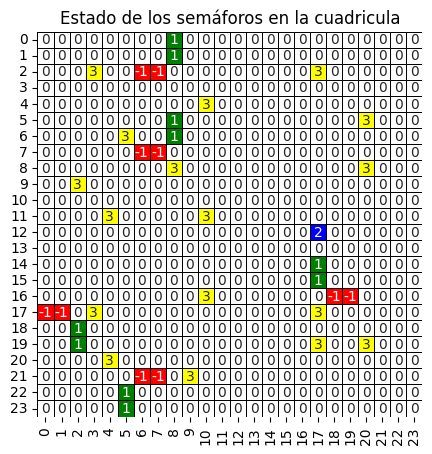

posicion: (12, 17)
[(12, 16)]


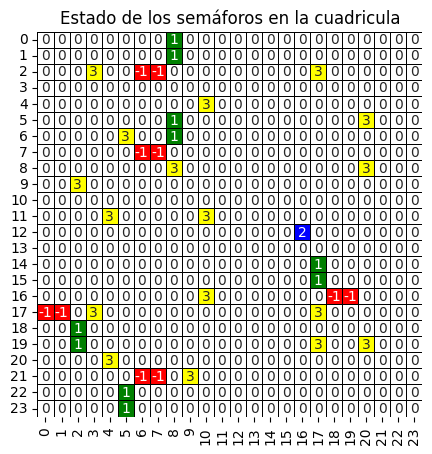

posicion: (12, 16)
[(12, 15)]


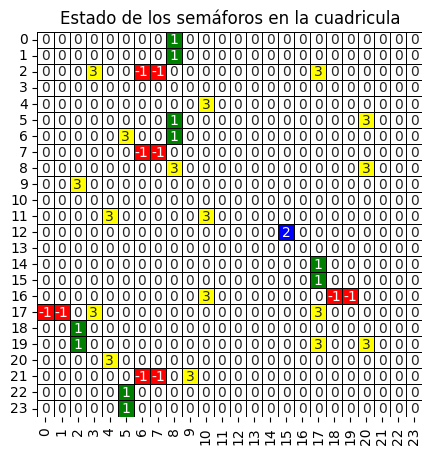

posicion: (12, 15)
[(12, 14)]


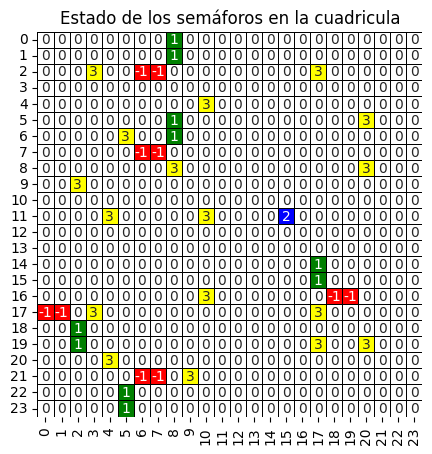

posicion: (11, 15)
[(10, 15)]


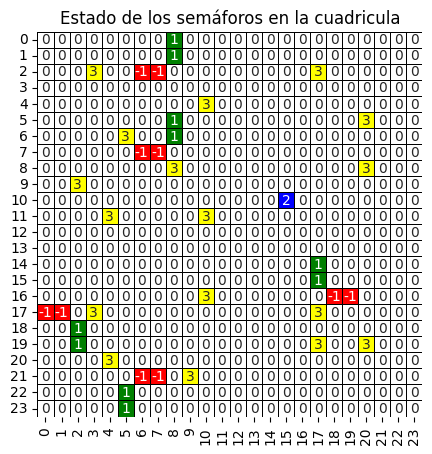

posicion: (10, 15)
[(9, 15)]


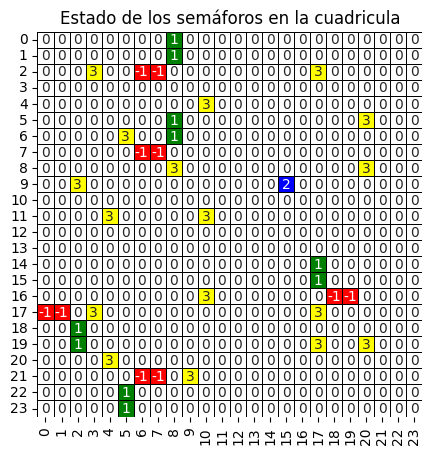

posicion: (9, 15)
[(8, 15)]


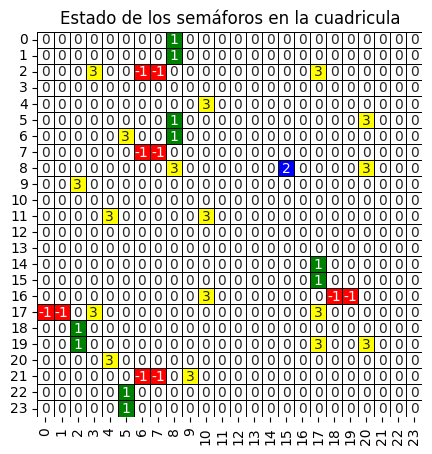

posicion: (8, 15)
[(7, 15)]


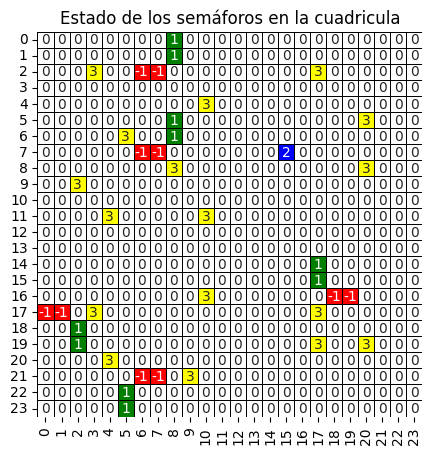

posicion: (7, 15)
[(6, 15)]


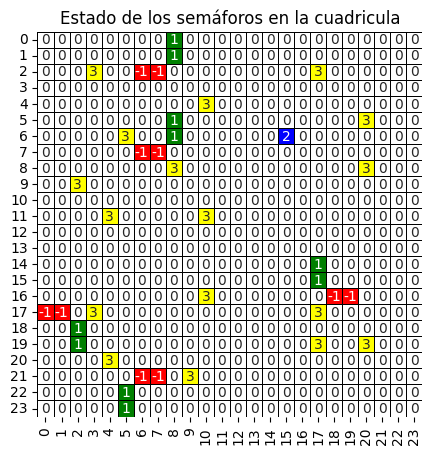

posicion: (6, 15)
[(5, 15)]


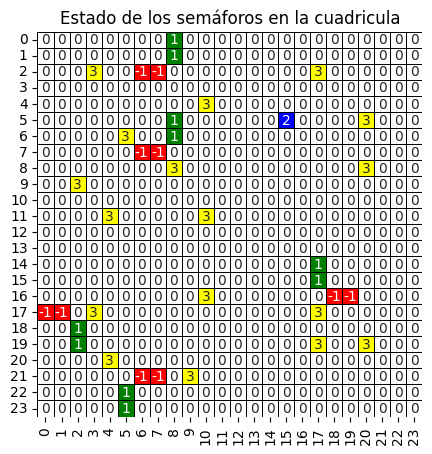

posicion: (5, 15)
[(4, 15)]


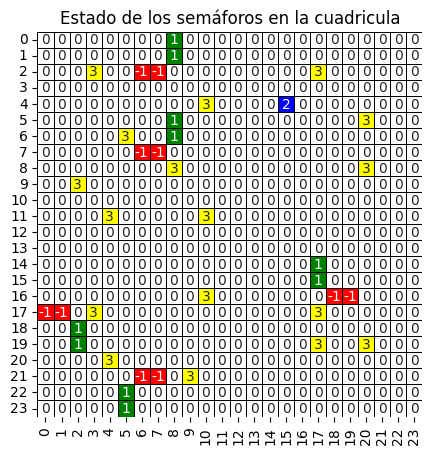

posicion: (4, 15)
[(3, 15)]


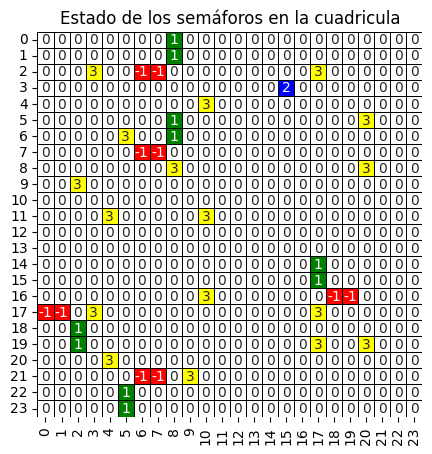

posicion: (3, 15)
[(2, 15)]


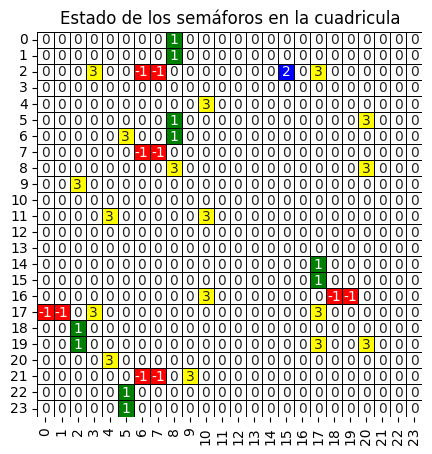

posicion: (2, 15)
[(1, 15)]


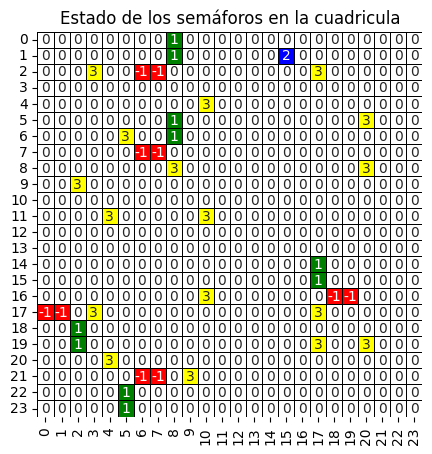

posicion: (1, 15)
[(1, 14)]


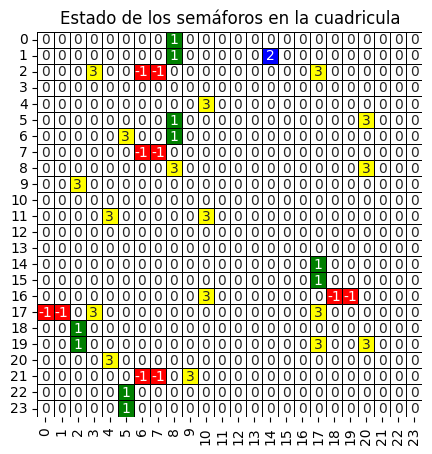

posicion: (1, 14)
[(1, 13)]


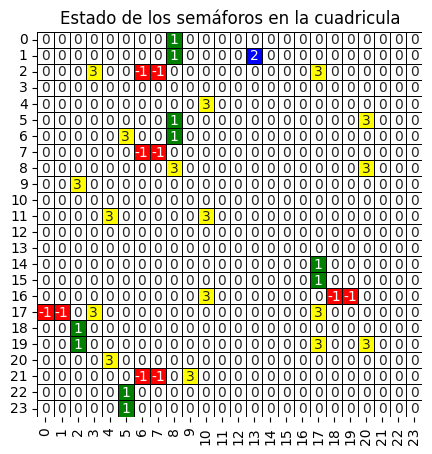

posicion: (1, 13)
[(1, 12)]


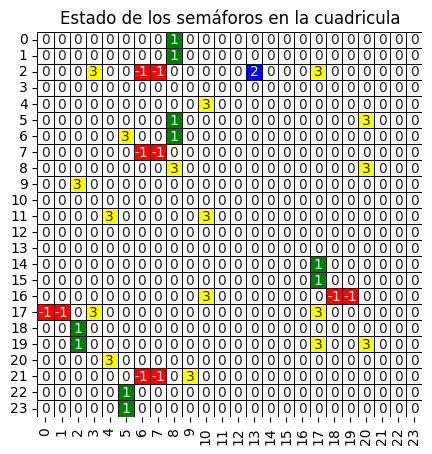

posicion: (2, 13)
[(3, 13)]


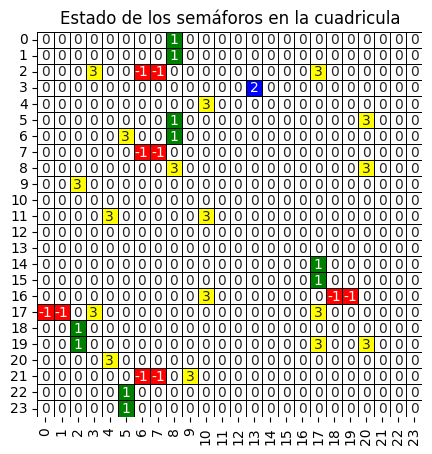

posicion: (3, 13)
[(4, 13)]


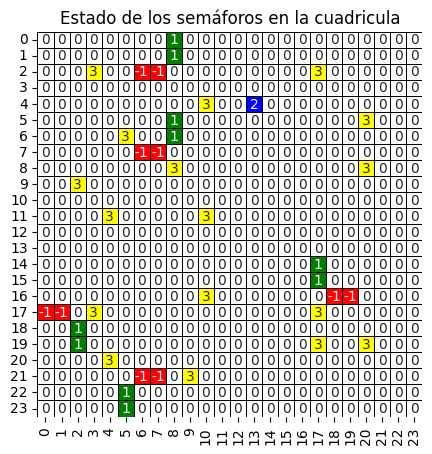

posicion: (4, 13)
[(5, 13)]


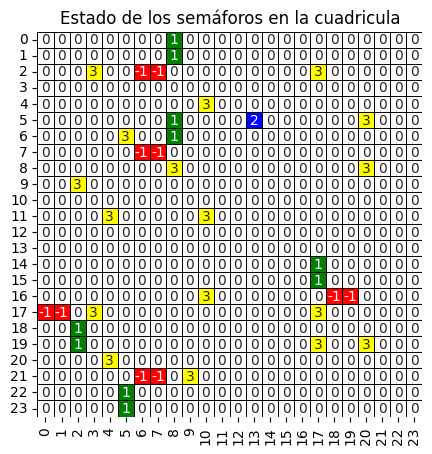

Semaforo 1 cambión de color
Semaforo: 1 | Color: VERDE | Posicion (2, 6)
Semaforo 2 cambión de color
Semaforo: 2 | Color: VERDE | Posicion (2, 7)
Semaforo 3 cambión de color
Semaforo: 3 | Color: VERDE | Posicion (7, 6)
Semaforo 4 cambión de color
Semaforo: 4 | Color: VERDE | Posicion (7, 7)
Semaforo 5 cambión de color
Semaforo: 5 | Color: VERDE | Posicion (17, 0)
Semaforo 6 cambión de color
Semaforo: 6 | Color: VERDE | Posicion (17, 1)
Semaforo 7 cambión de color
Semaforo: 7 | Color: VERDE | Posicion (21, 6)
Semaforo 8 cambión de color
Semaforo: 8 | Color: VERDE | Posicion (21, 7)
Semaforo 9 cambión de color
Semaforo: 9 | Color: VERDE | Posicion (16, 18)
Semaforo 10 cambión de color
Semaforo: 10 | Color: VERDE | Posicion (16, 19)
Semaforo 11 cambión de color
Semaforo: 11 | Color: ROJO | Posicion (0, 8)
Semaforo 12 cambión de color
Semaforo: 12 | Color: ROJO | Posicion (1, 8)
Semaforo 13 cambión de color
Semaforo: 13 | Color: ROJO | Posicion (5, 8)
Semaforo 14 cambión de color
Semaforo:

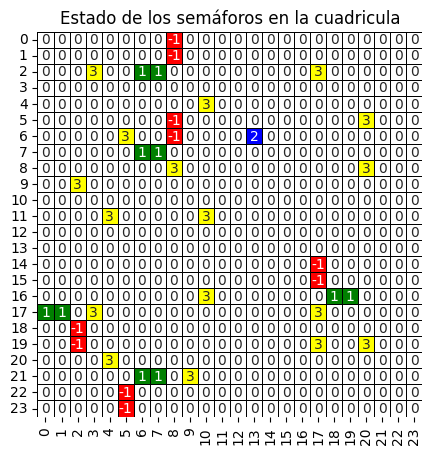

posicion: (6, 13)
[(7, 13)]


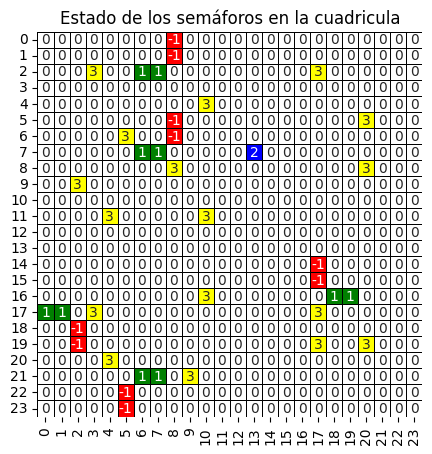

posicion: (7, 13)
[(8, 13)]


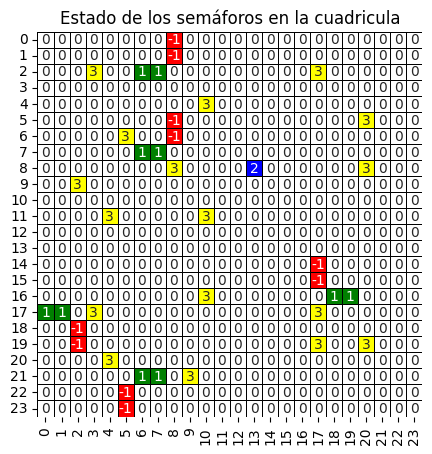

posicion: (8, 13)
[(9, 13)]


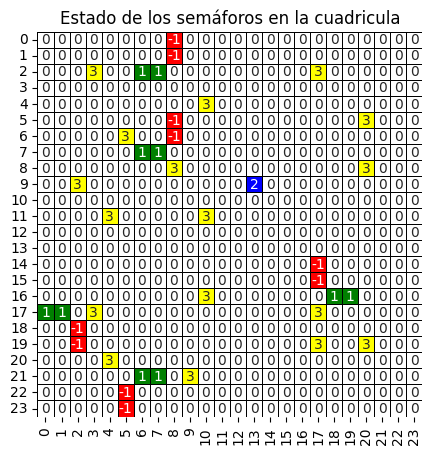

posicion: (9, 13)
[(10, 13)]


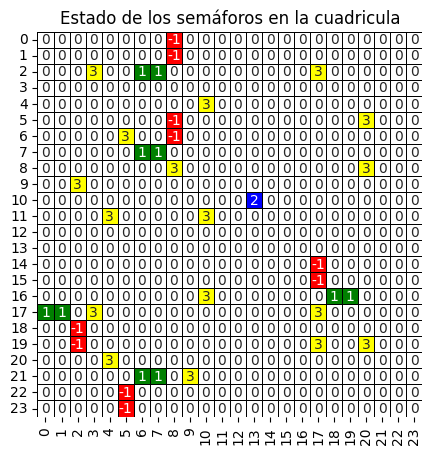

posicion: (10, 13)
[(11, 13)]


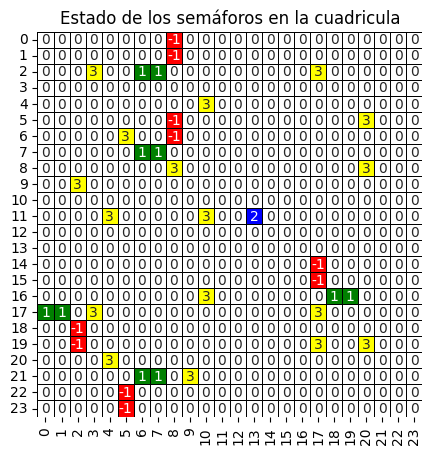

posicion: (11, 13)
[(12, 13)]


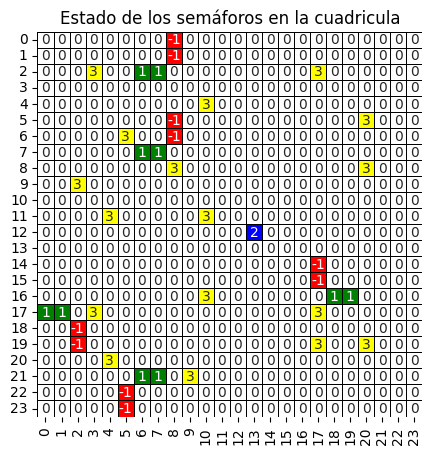

posicion: (12, 13)
[(12, 12)]


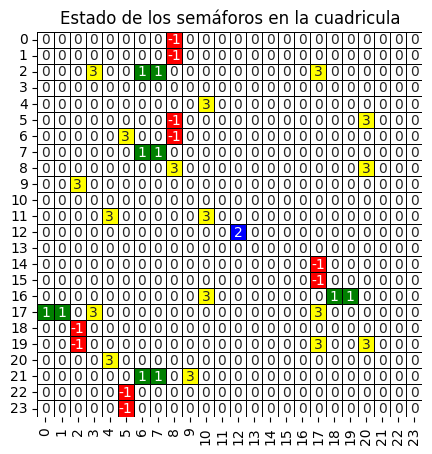

posicion: (12, 12)
[(12, 11)]


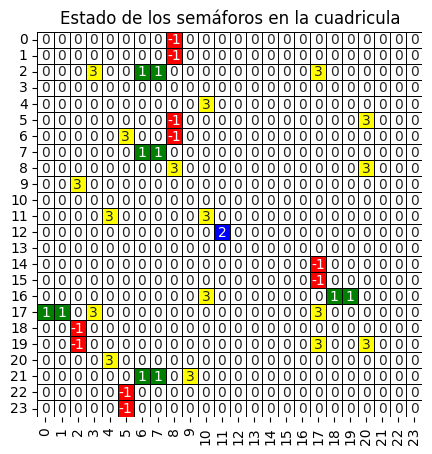

posicion: (12, 11)
[(12, 10)]


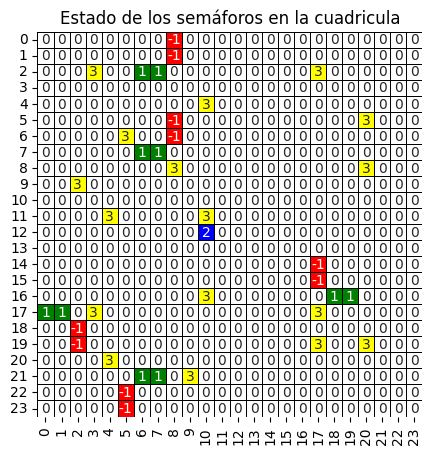

posicion: (12, 10)
[(12, 9)]


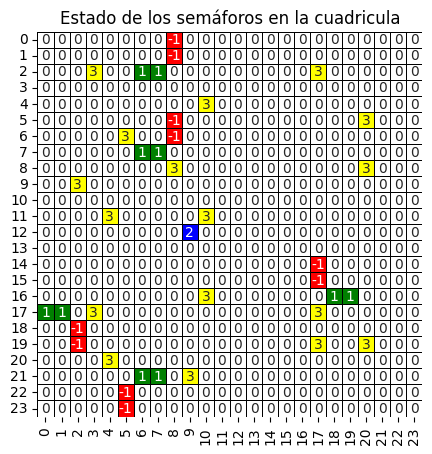

posicion: (12, 9)
[(12, 8)]


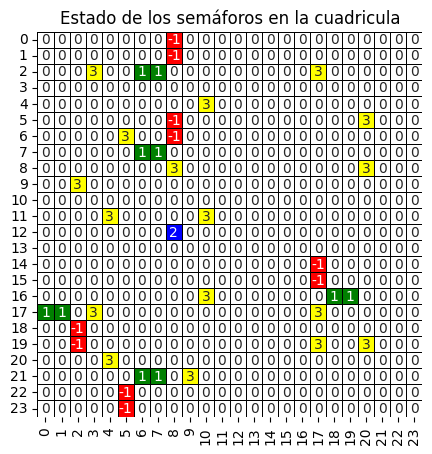

posicion: (12, 8)
[(12, 7)]


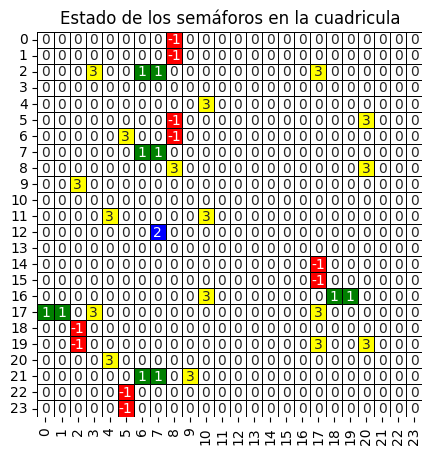

posicion: (12, 7)
[(12, 6)]


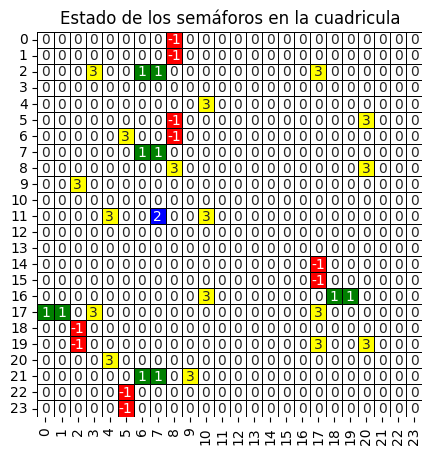

posicion: (11, 7)
[(10, 7)]


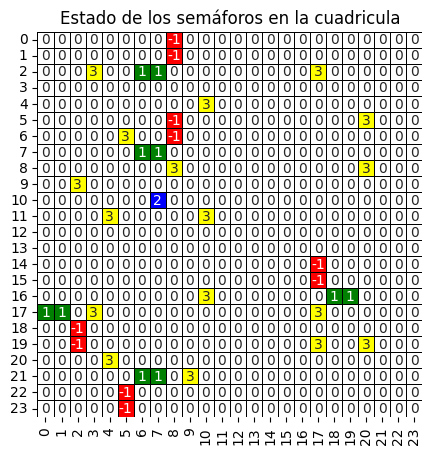

posicion: (10, 7)
[(9, 7)]


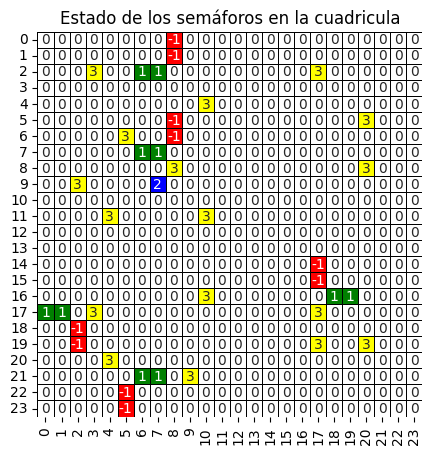

posicion: (9, 7)
[(8, 7)]


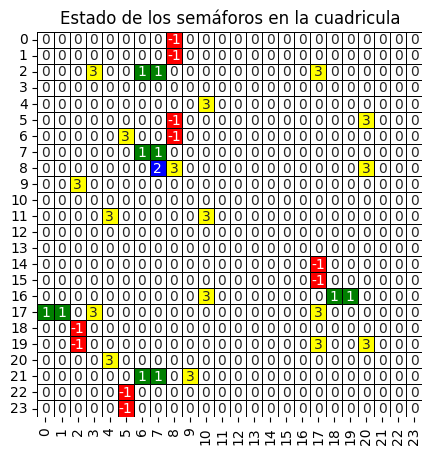

posicion: (8, 7)
[(7, 7)]


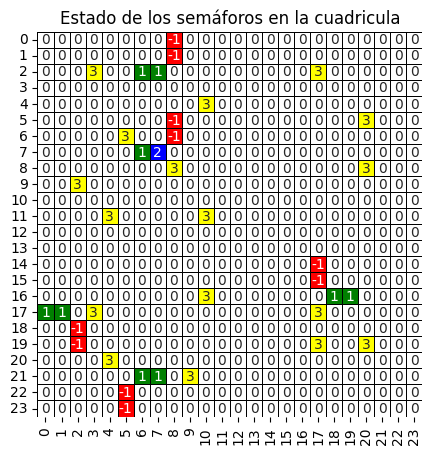

posicion: (7, 7)
[(6, 7)]


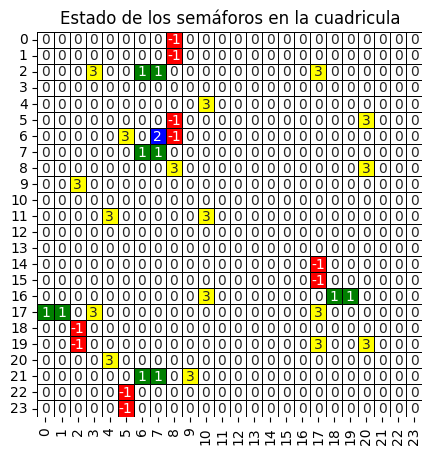

posicion: (6, 7)
[(5, 7)]


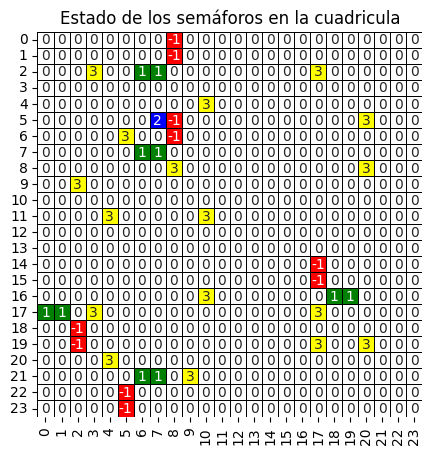

posicion: (5, 7)
[(4, 7)]


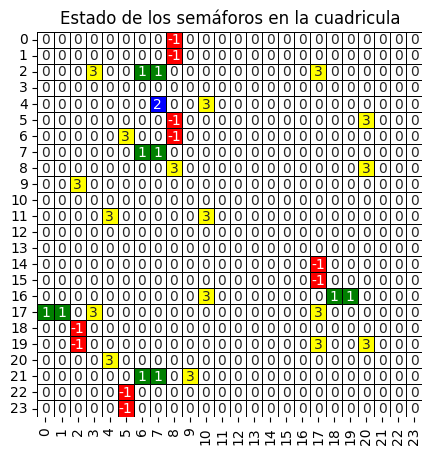

posicion: (4, 7)
[(3, 7)]


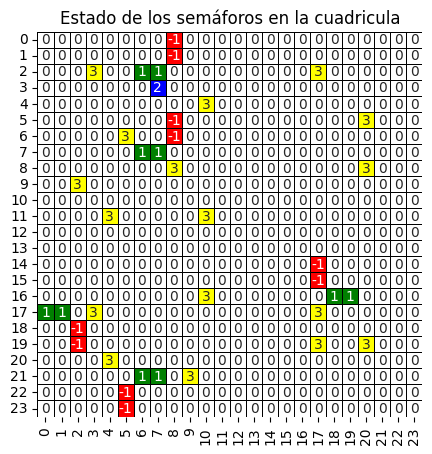

posicion: (3, 7)
[(2, 7)]


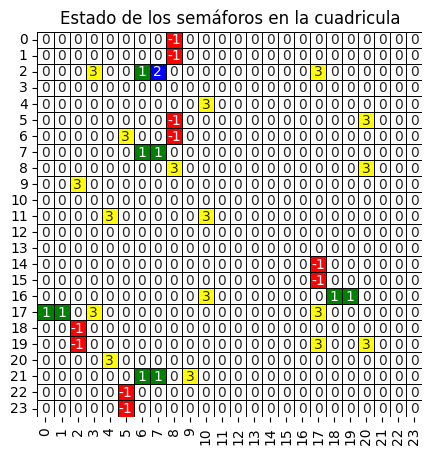

posicion: (2, 7)
[(1, 7)]


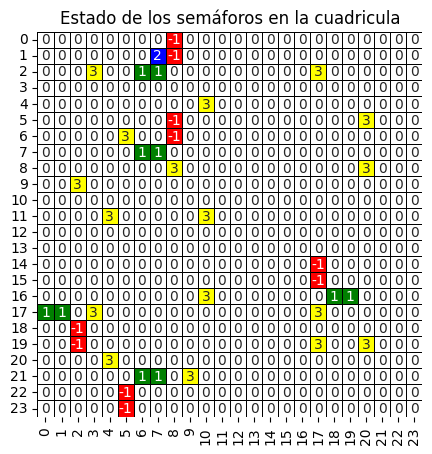

posicion: (1, 7)
[(1, 6)]


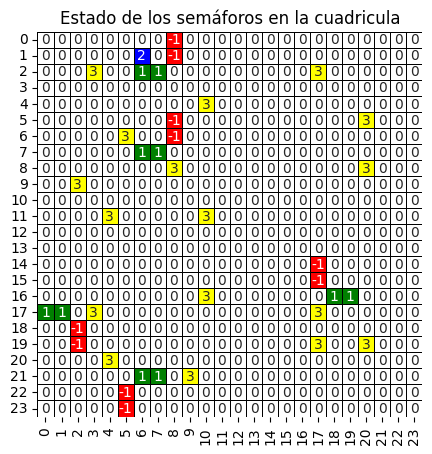

posicion: (1, 6)
[(1, 5)]


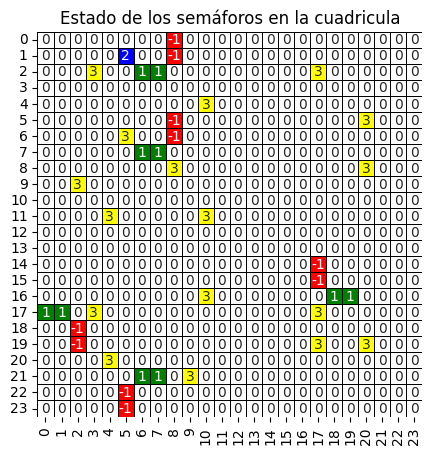

posicion: (1, 5)
[(1, 4)]


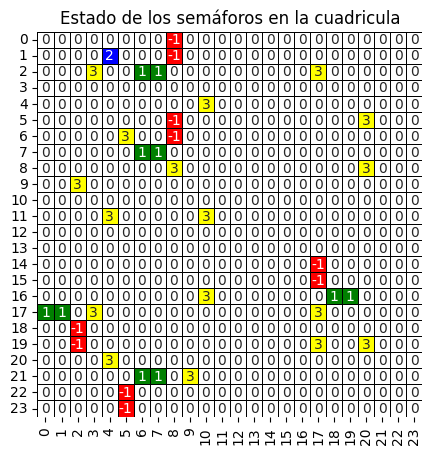

posicion: (1, 4)
[(1, 3)]


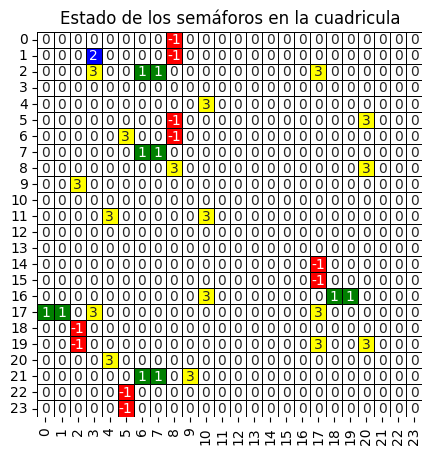

posicion: (1, 3)
[(1, 2)]


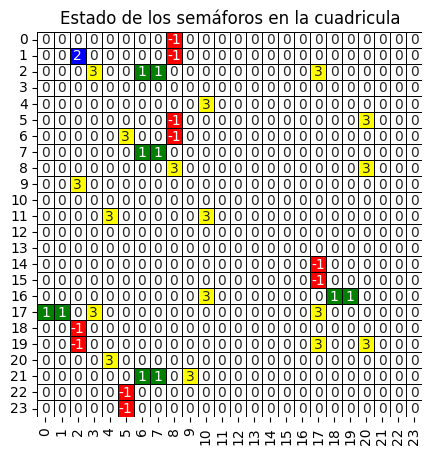

posicion: (1, 2)
[(1, 1)]


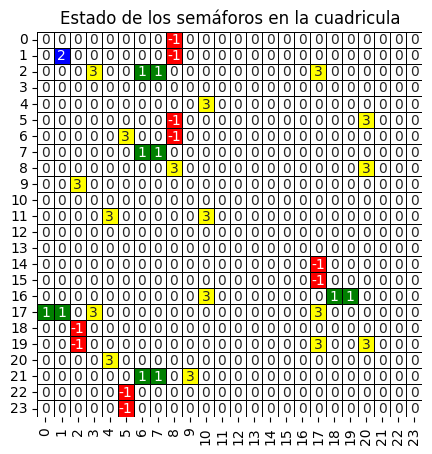

posicion: (1, 1)
[(1, 0)]


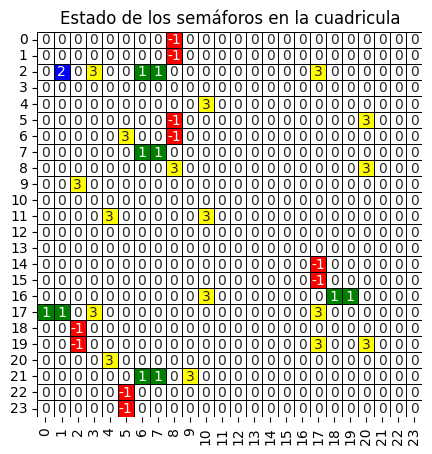

posicion: (2, 1)
[(3, 1)]


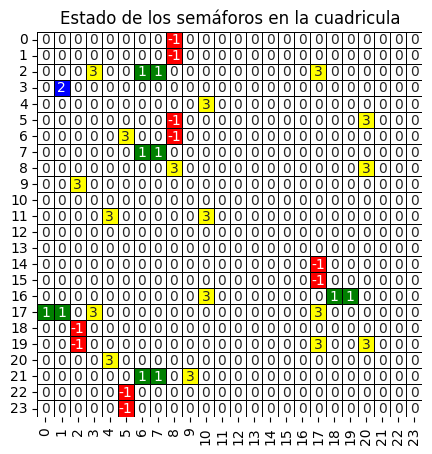

posicion: (3, 1)
[(4, 1)]


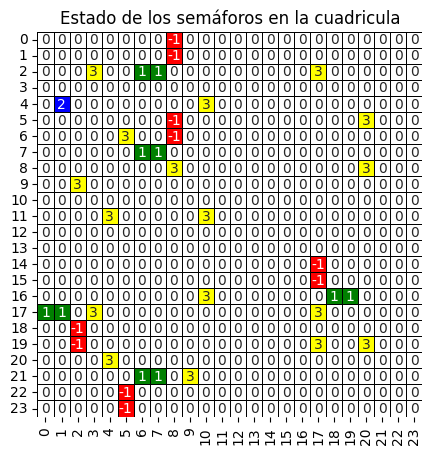

posicion: (4, 1)
[(5, 1)]


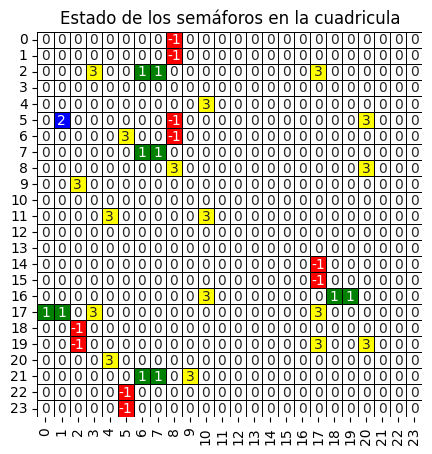

posicion: (5, 1)
[(6, 1)]


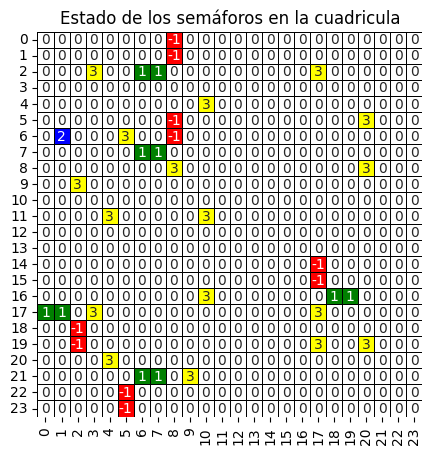

posicion: (6, 1)
[(7, 1)]


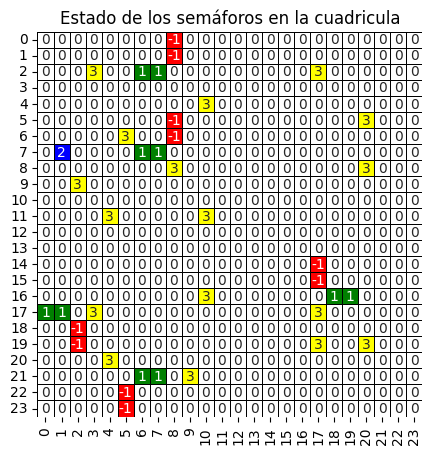

posicion: (7, 1)
[(8, 1)]


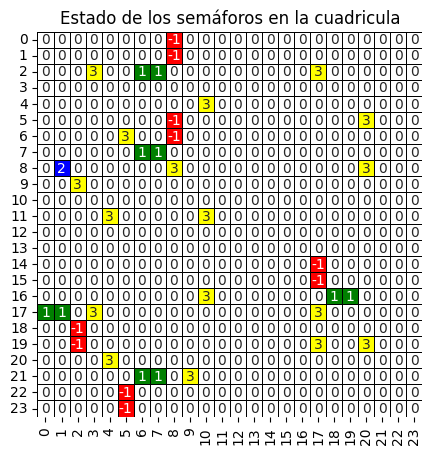

posicion: (8, 1)
[(9, 1)]


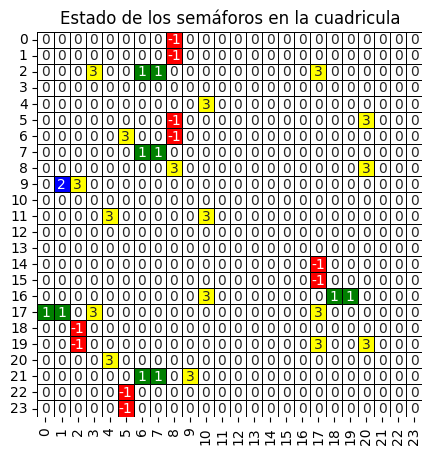

posicion: (9, 1)
[(10, 1)]


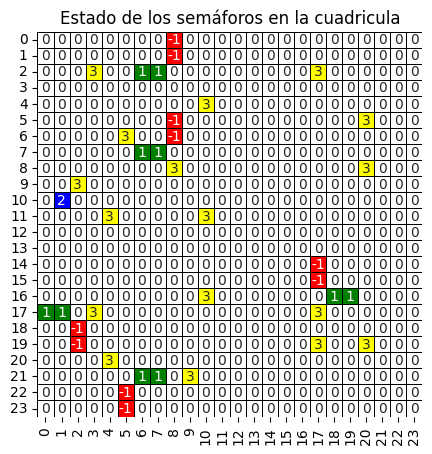

posicion: (10, 1)
[(11, 1)]


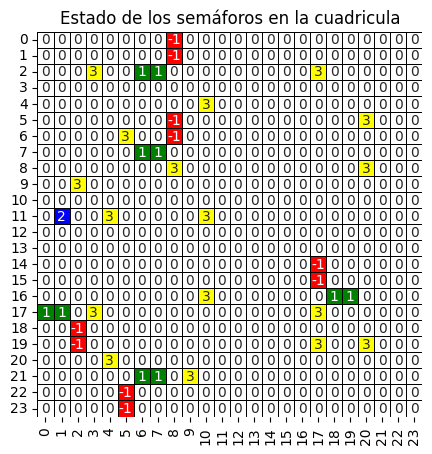

Semaforo 1 cambión de color
Semaforo: 1 | Color: ROJO | Posicion (2, 6)
Semaforo 2 cambión de color
Semaforo: 2 | Color: ROJO | Posicion (2, 7)
Semaforo 3 cambión de color
Semaforo: 3 | Color: ROJO | Posicion (7, 6)
Semaforo 4 cambión de color
Semaforo: 4 | Color: ROJO | Posicion (7, 7)
Semaforo 5 cambión de color
Semaforo: 5 | Color: ROJO | Posicion (17, 0)
Semaforo 6 cambión de color
Semaforo: 6 | Color: ROJO | Posicion (17, 1)
Semaforo 7 cambión de color
Semaforo: 7 | Color: ROJO | Posicion (21, 6)
Semaforo 8 cambión de color
Semaforo: 8 | Color: ROJO | Posicion (21, 7)
Semaforo 9 cambión de color
Semaforo: 9 | Color: ROJO | Posicion (16, 18)
Semaforo 10 cambión de color
Semaforo: 10 | Color: ROJO | Posicion (16, 19)
Semaforo 11 cambión de color
Semaforo: 11 | Color: VERDE | Posicion (0, 8)
Semaforo 12 cambión de color
Semaforo: 12 | Color: VERDE | Posicion (1, 8)
Semaforo 13 cambión de color
Semaforo: 13 | Color: VERDE | Posicion (5, 8)
Semaforo 14 cambión de color
Semaforo: 14 | C

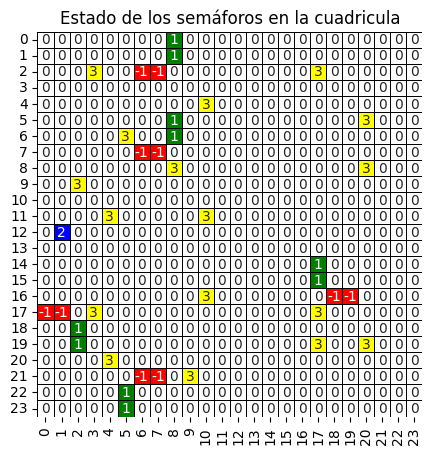

posicion: (12, 1)
[(13, 1)]


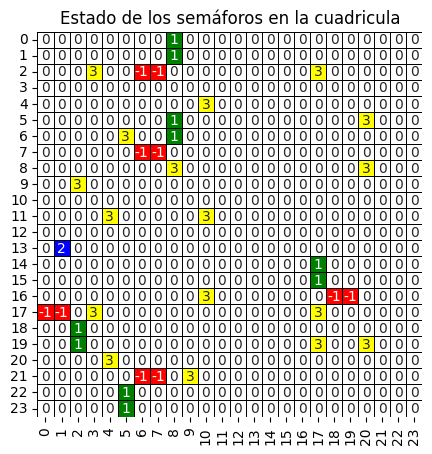

posicion: (13, 1)
[(14, 1)]


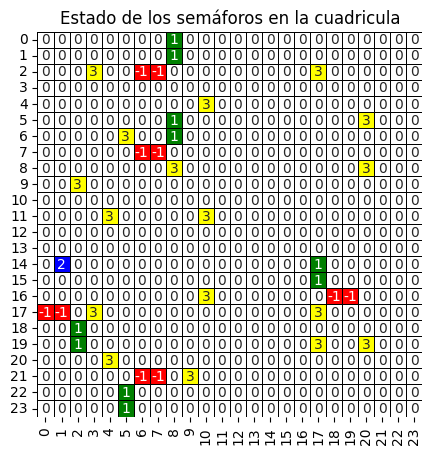

posicion: (14, 1)
[(14, 2)]


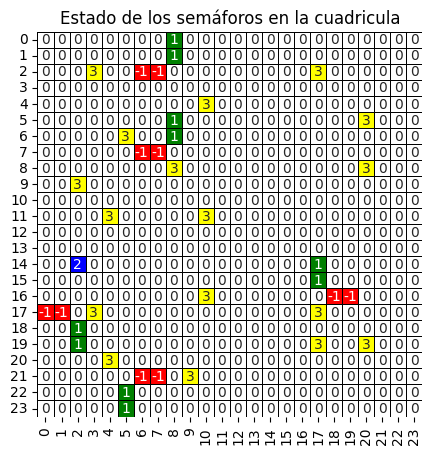

posicion: (14, 2)
[(14, 3)]


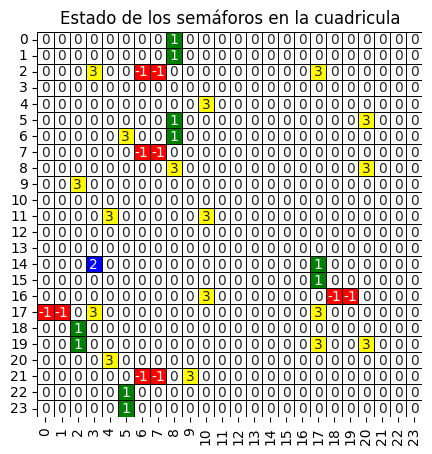

posicion: (14, 3)
[(14, 4)]


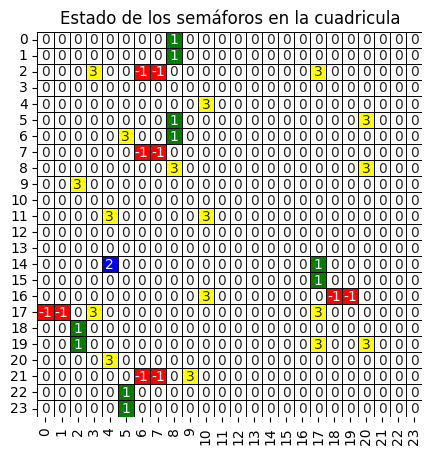

posicion: (14, 4)
[(14, 5)]


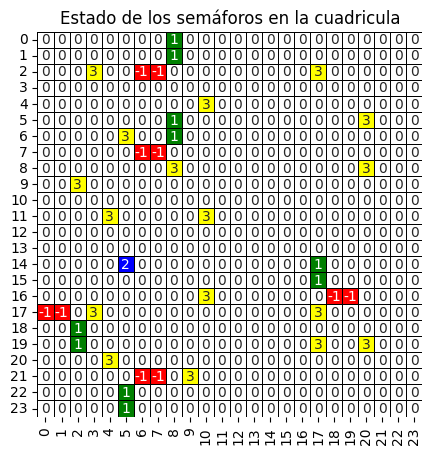

posicion: (14, 5)
[(14, 6)]


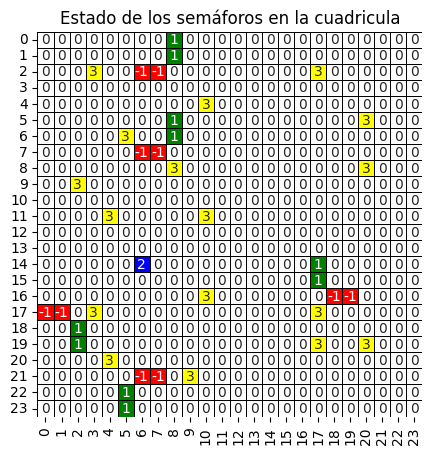

posicion: (14, 6)
[(14, 7)]


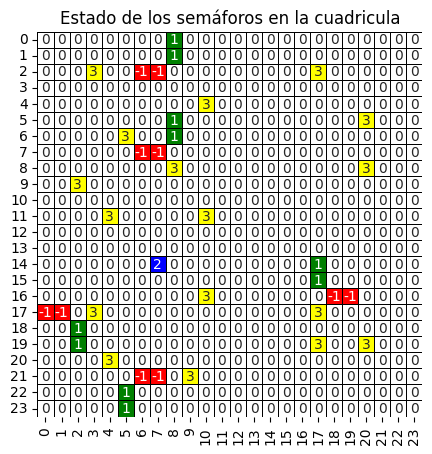

posicion: (14, 7)
[(14, 8)]


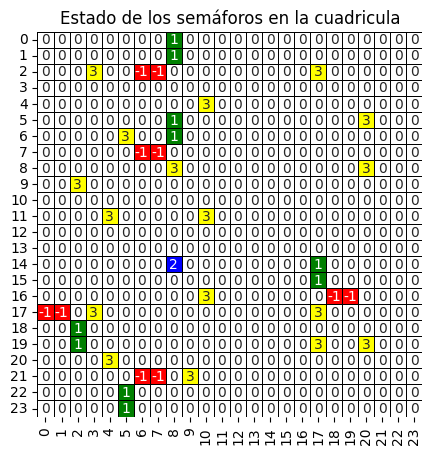

posicion: (14, 8)
[(14, 9)]


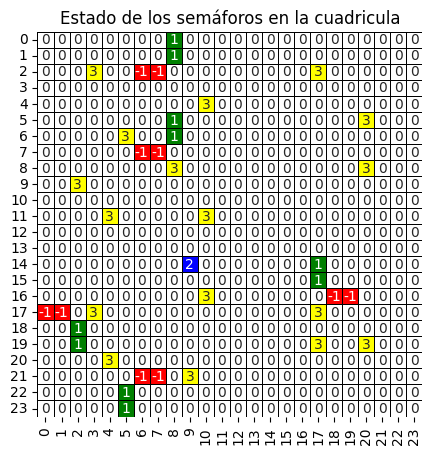

posicion: (14, 9)
[(14, 10)]


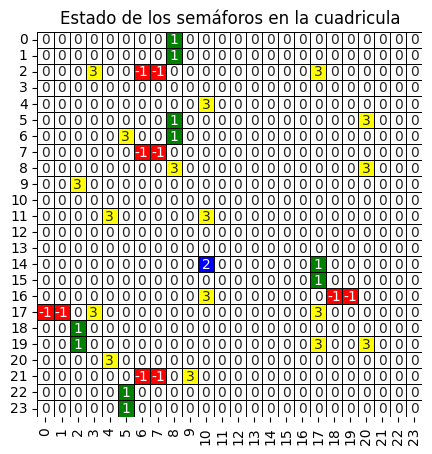

posicion: (14, 10)
[(14, 11)]


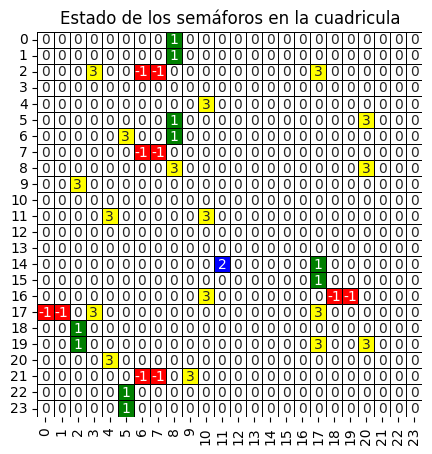

posicion: (14, 11)
[(14, 12)]


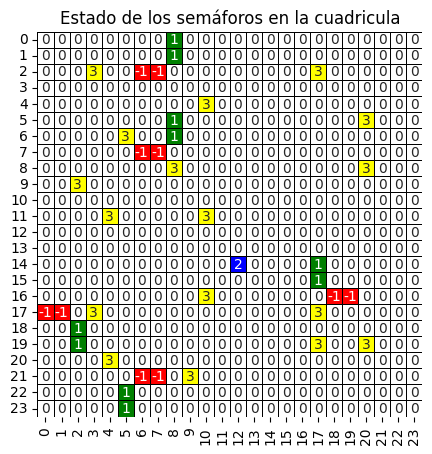

posicion: (14, 12)
[(15, 12)]


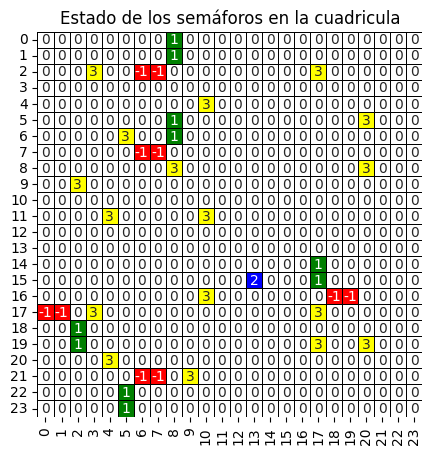

posicion: (15, 13)
[(15, 14)]


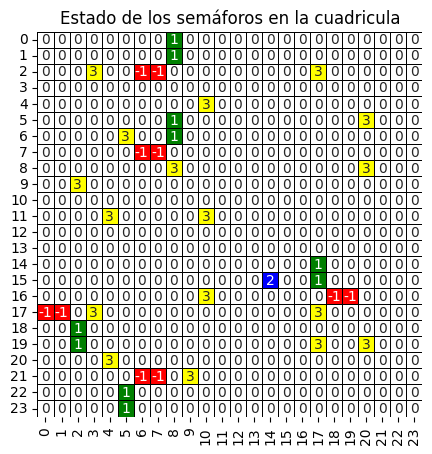

posicion: (15, 14)
[(15, 15)]


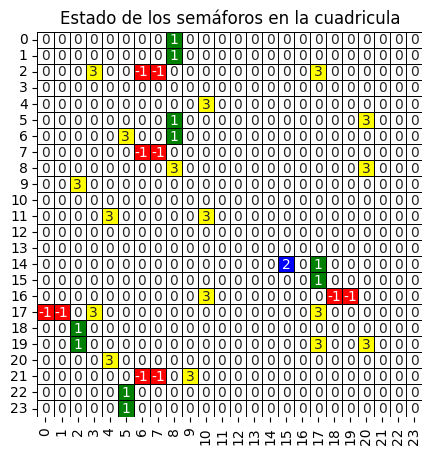

posicion: (14, 15)
[(14, 16)]


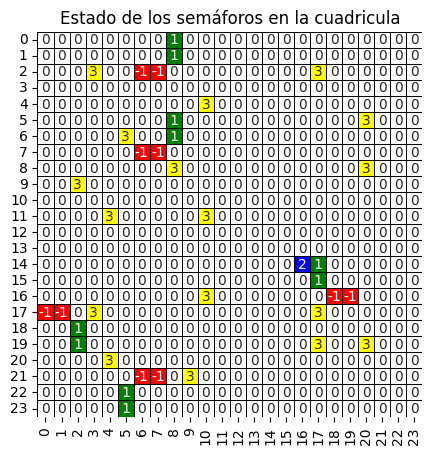

posicion: (14, 16)
[(14, 17)]


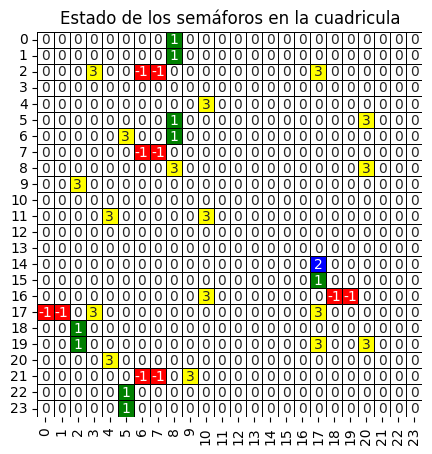

posicion: (14, 17)
[(14, 18)]


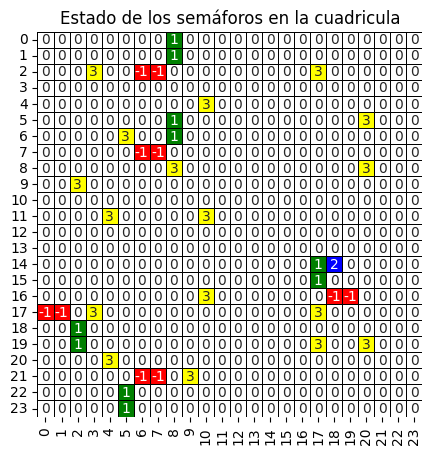

posicion: (14, 18)
[(14, 19)]


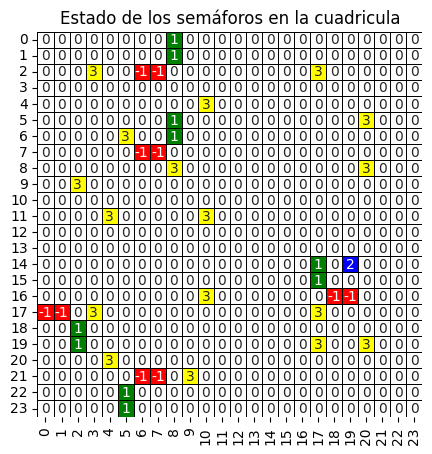

posicion: (14, 19)
[(14, 20)]


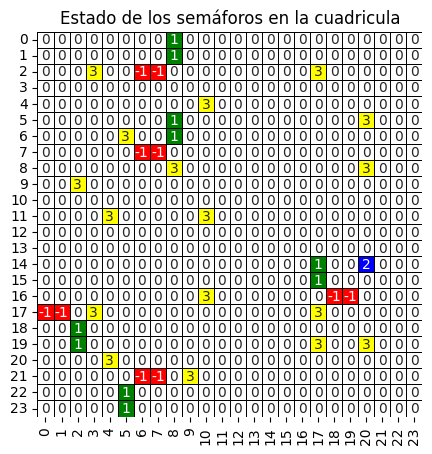

posicion: (14, 20)
[(14, 21)]


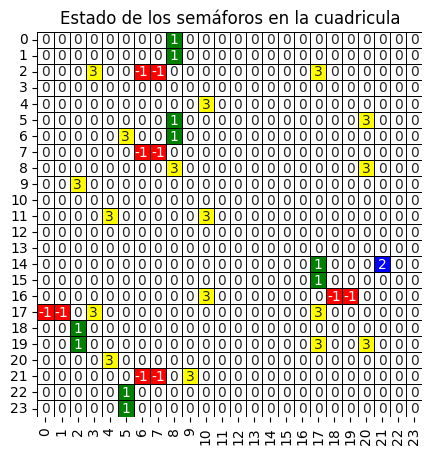

posicion: (14, 21)
[(14, 22)]


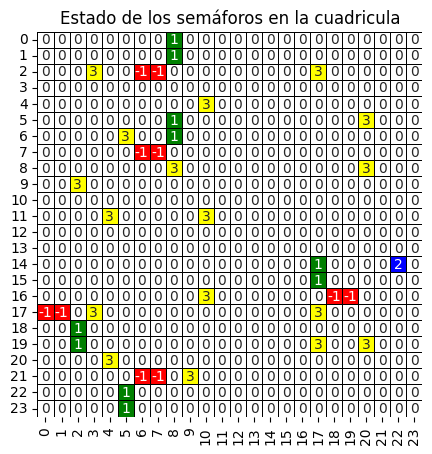

posicion: (14, 22)
[(13, 22)]


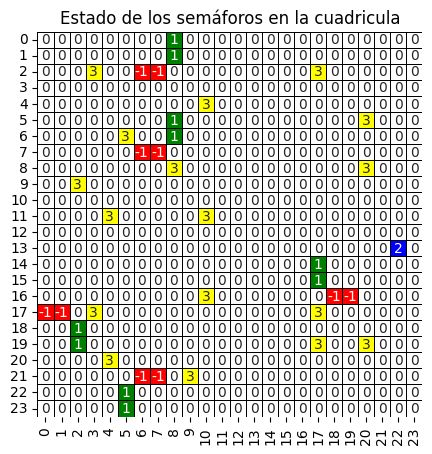

posicion: (13, 22)
[(13, 21)]


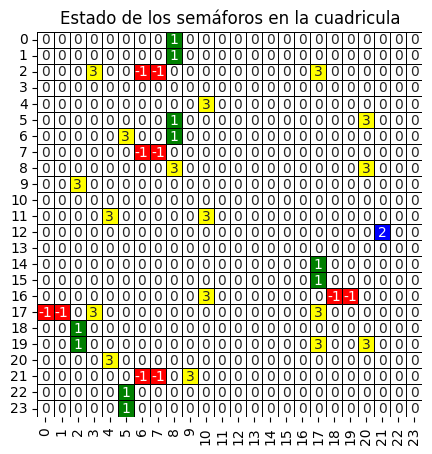

posicion: (12, 21)
[(12, 20)]


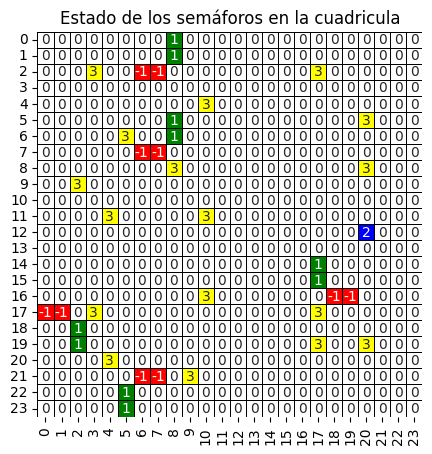

posicion: (12, 20)
[(12, 19)]


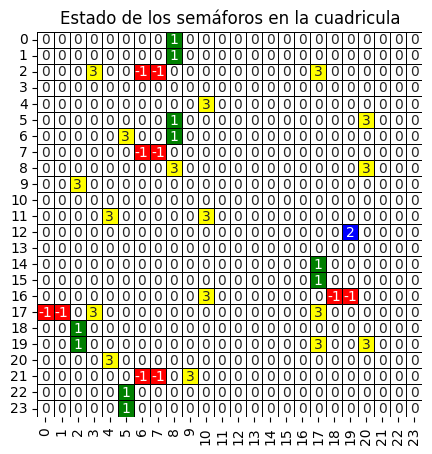

posicion: (12, 19)
[(12, 18)]


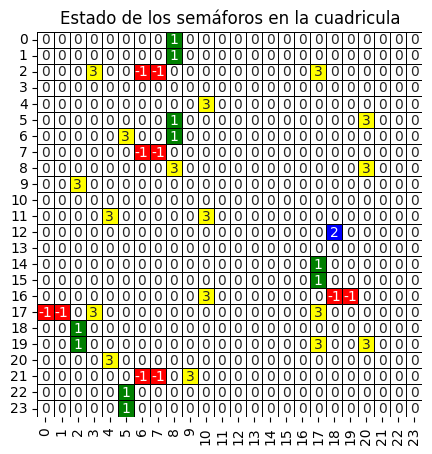

posicion: (12, 18)
[(12, 17)]


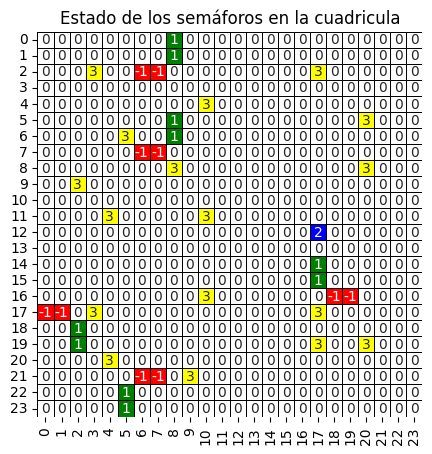

posicion: (12, 17)
[(12, 16)]


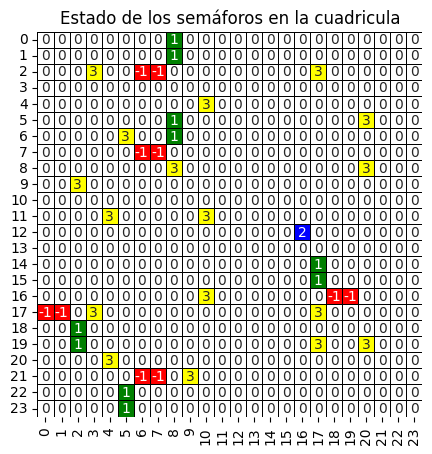

posicion: (12, 16)
[(12, 15)]


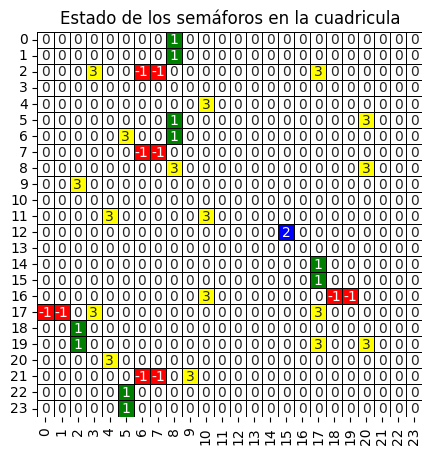

posicion: (12, 15)
[(12, 14)]


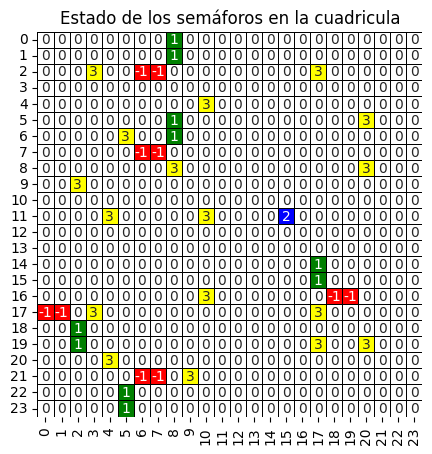

posicion: (11, 15)
[(10, 15)]


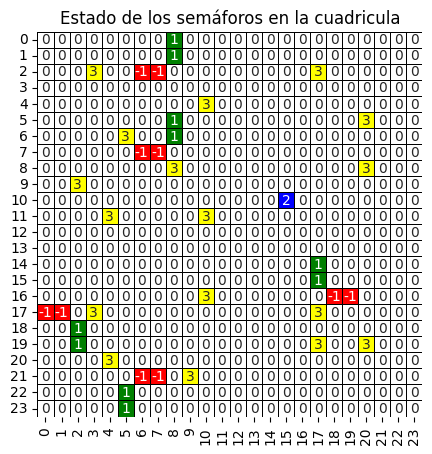

posicion: (10, 15)
[(9, 15)]


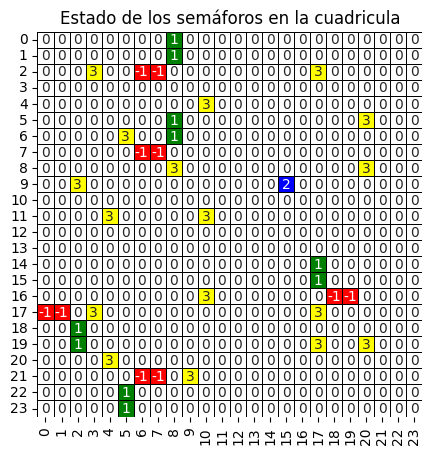

posicion: (9, 15)
[(8, 15)]


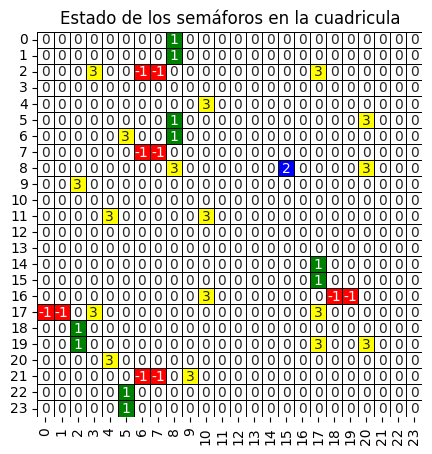

posicion: (8, 15)
[(7, 15)]


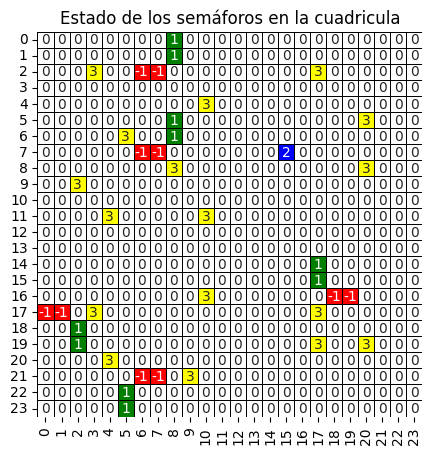

posicion: (7, 15)
[(6, 15)]


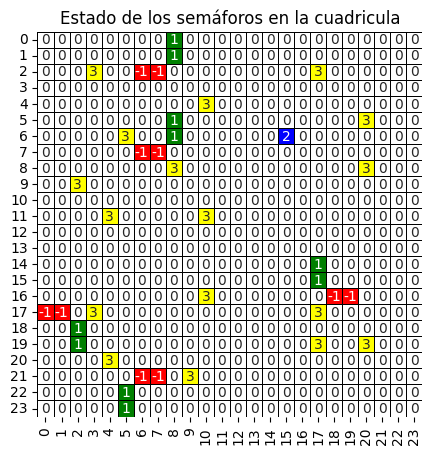

posicion: (6, 15)
[(5, 15)]


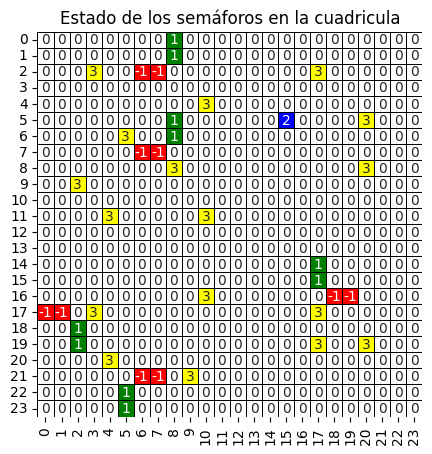

posicion: (5, 15)
[(4, 15)]


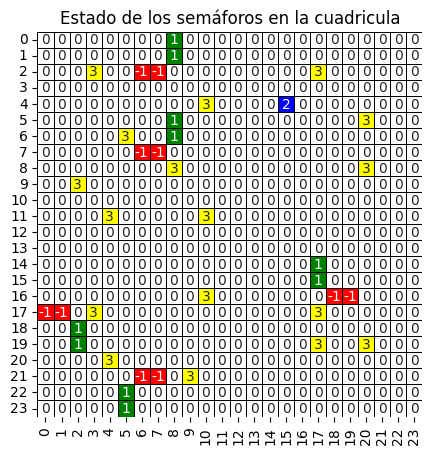

Semaforo 1 cambión de color
Semaforo: 1 | Color: VERDE | Posicion (2, 6)
Semaforo 2 cambión de color
Semaforo: 2 | Color: VERDE | Posicion (2, 7)
Semaforo 3 cambión de color
Semaforo: 3 | Color: VERDE | Posicion (7, 6)
Semaforo 4 cambión de color
Semaforo: 4 | Color: VERDE | Posicion (7, 7)
Semaforo 5 cambión de color
Semaforo: 5 | Color: VERDE | Posicion (17, 0)
Semaforo 6 cambión de color
Semaforo: 6 | Color: VERDE | Posicion (17, 1)
Semaforo 7 cambión de color
Semaforo: 7 | Color: VERDE | Posicion (21, 6)
Semaforo 8 cambión de color
Semaforo: 8 | Color: VERDE | Posicion (21, 7)
Semaforo 9 cambión de color
Semaforo: 9 | Color: VERDE | Posicion (16, 18)
Semaforo 10 cambión de color
Semaforo: 10 | Color: VERDE | Posicion (16, 19)
Semaforo 11 cambión de color
Semaforo: 11 | Color: ROJO | Posicion (0, 8)
Semaforo 12 cambión de color
Semaforo: 12 | Color: ROJO | Posicion (1, 8)
Semaforo 13 cambión de color
Semaforo: 13 | Color: ROJO | Posicion (5, 8)
Semaforo 14 cambión de color
Semaforo:

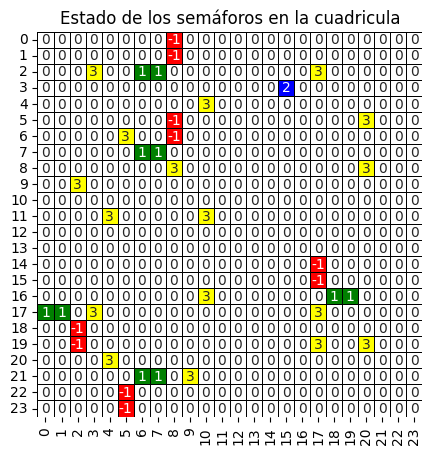

posicion: (3, 15)
[(2, 15)]


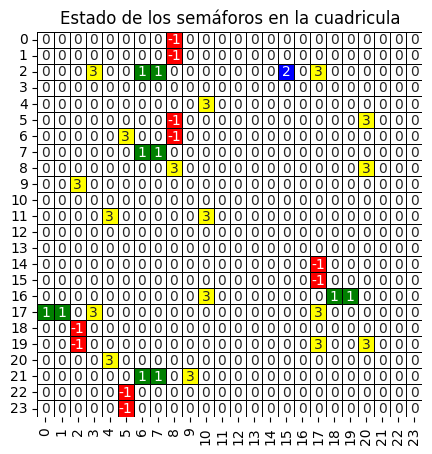

posicion: (2, 15)
[(1, 15)]


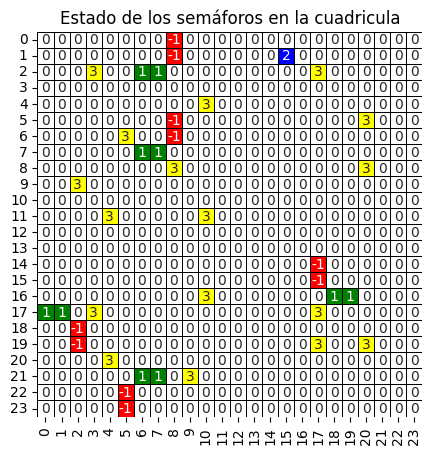

posicion: (1, 15)
[(1, 14)]


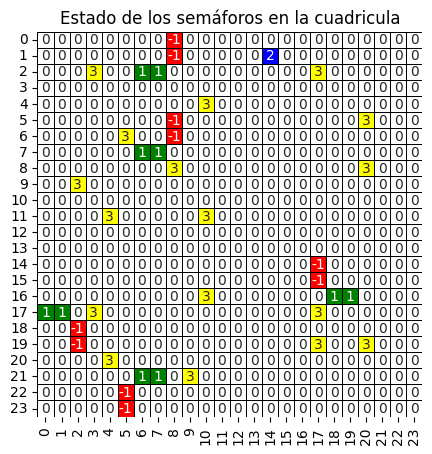

posicion: (1, 14)
[(1, 13)]


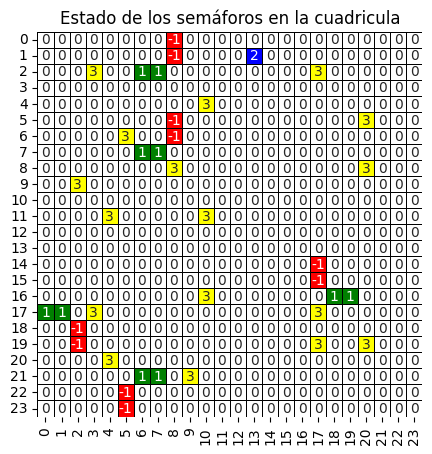

posicion: (1, 13)
[(1, 12)]


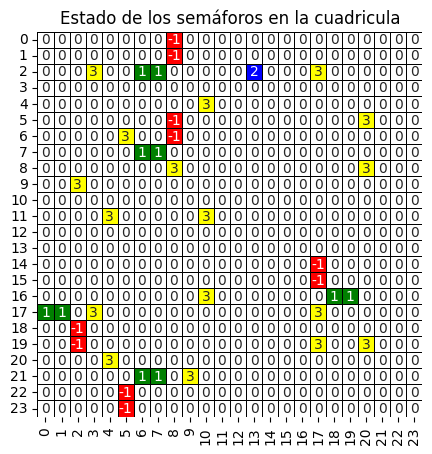

posicion: (2, 13)
[(3, 13)]


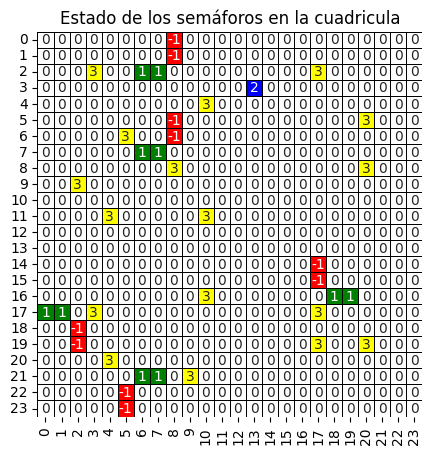

posicion: (3, 13)
[(4, 13)]


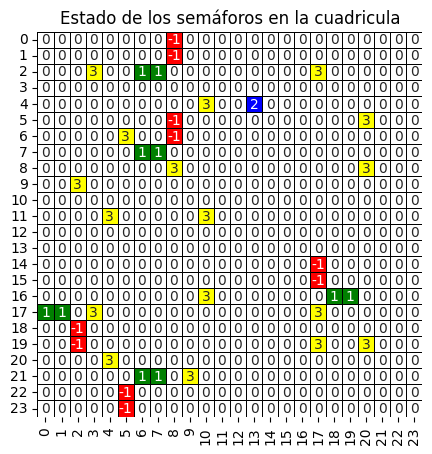

posicion: (4, 13)
[(5, 13)]


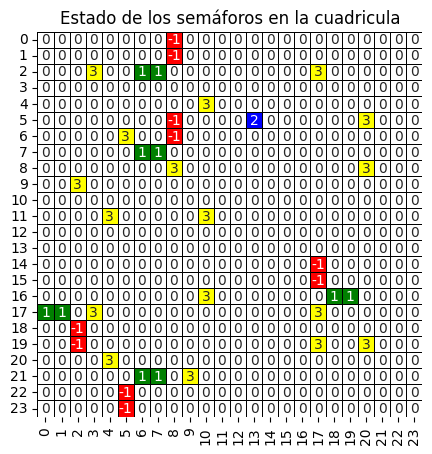

posicion: (5, 13)
[(6, 13)]


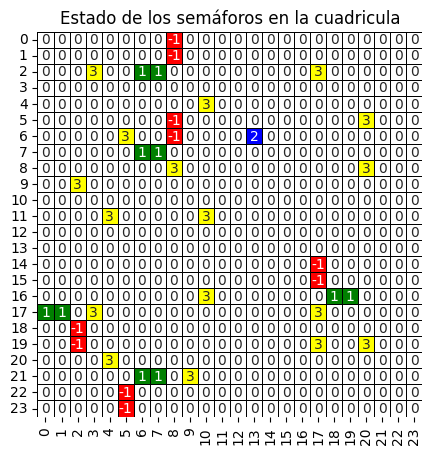

posicion: (6, 13)
[(7, 13)]


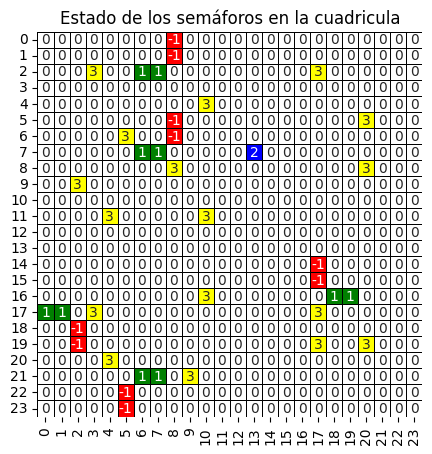

posicion: (7, 13)
[(8, 13)]


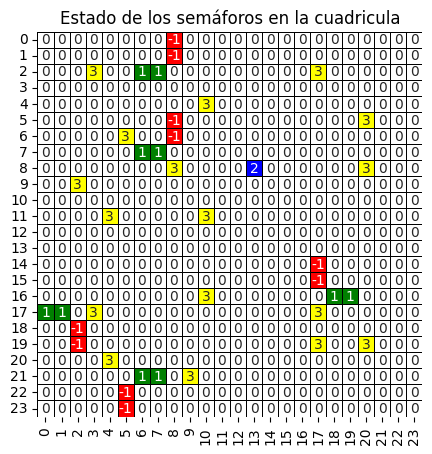

posicion: (8, 13)
[(9, 13)]


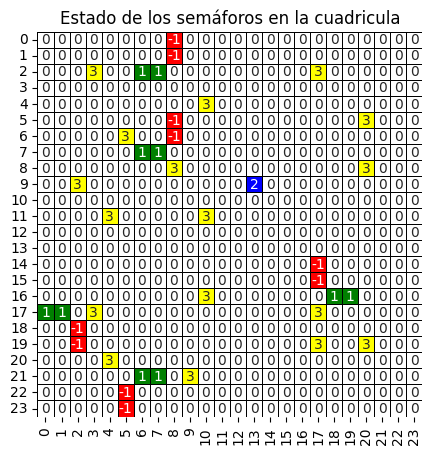

posicion: (9, 13)
[(10, 13)]


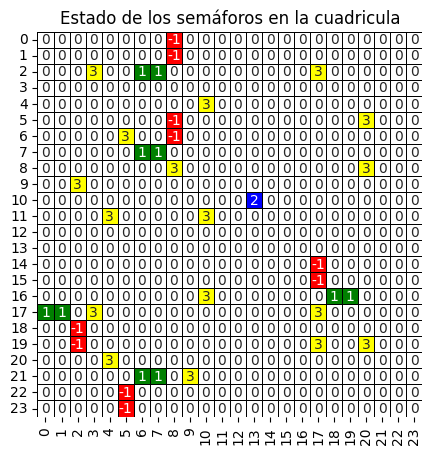

posicion: (10, 13)
[(11, 13)]


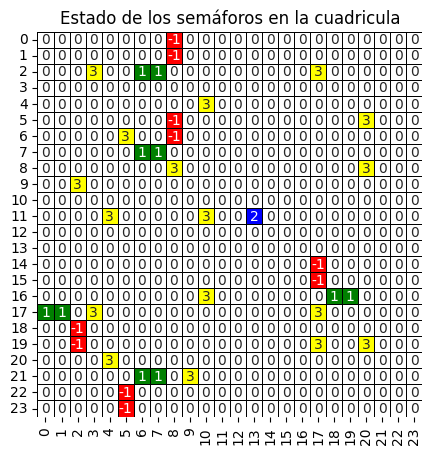

posicion: (11, 13)
[(12, 13)]


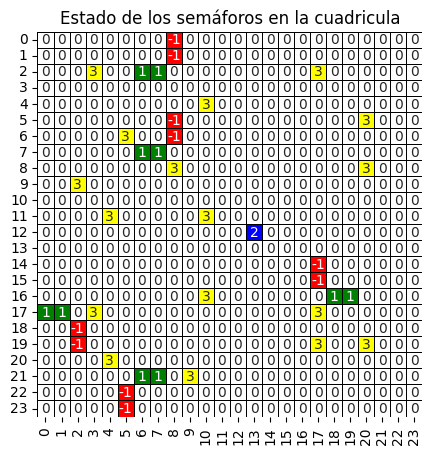

posicion: (12, 13)
[(12, 12)]


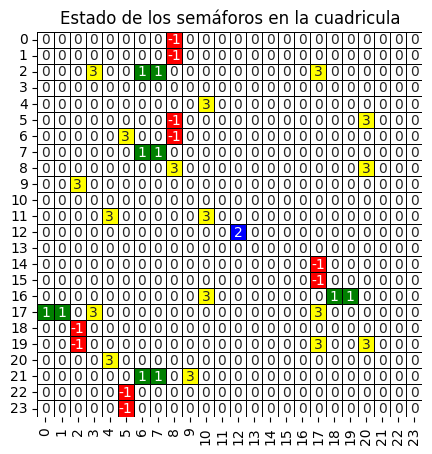

posicion: (12, 12)
[(12, 11)]


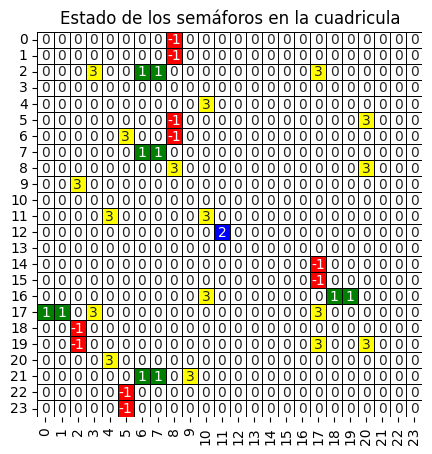

posicion: (12, 11)
[(12, 10)]


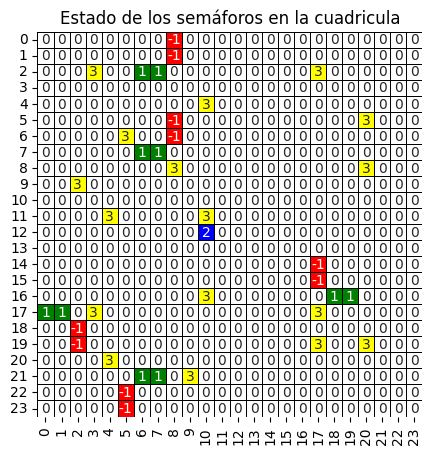

posicion: (12, 10)
[(12, 9)]


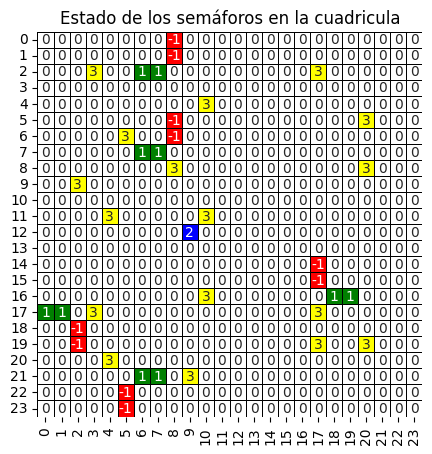

posicion: (12, 9)
[(12, 8)]


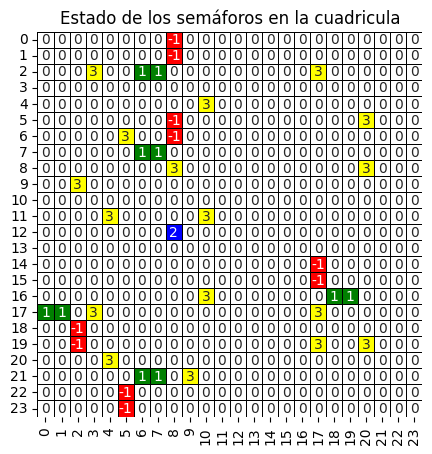

posicion: (12, 8)
[(12, 7)]


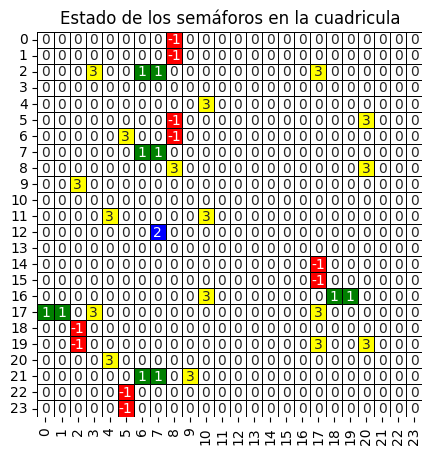

posicion: (12, 7)
[(12, 6)]


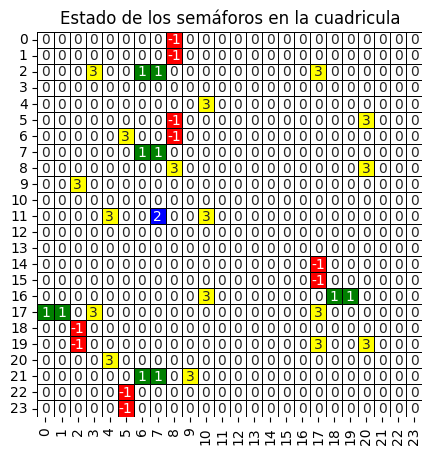

posicion: (11, 7)
[(10, 7)]


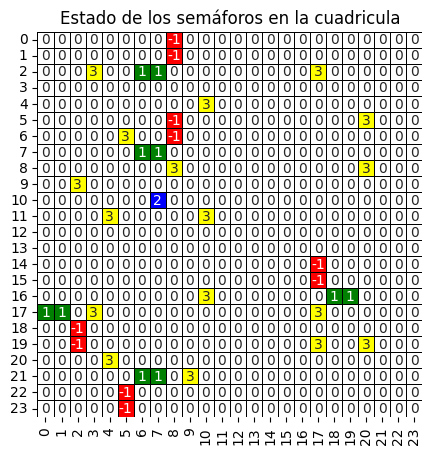

posicion: (10, 7)
[(9, 7)]


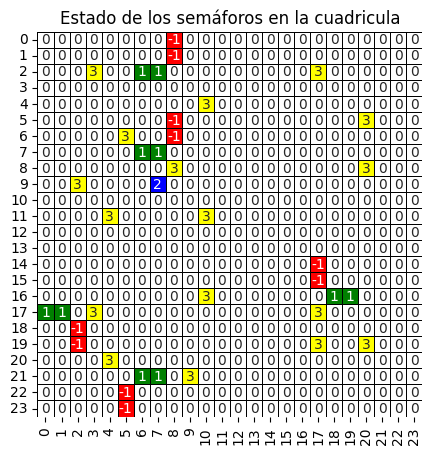

posicion: (9, 7)
[(8, 7)]


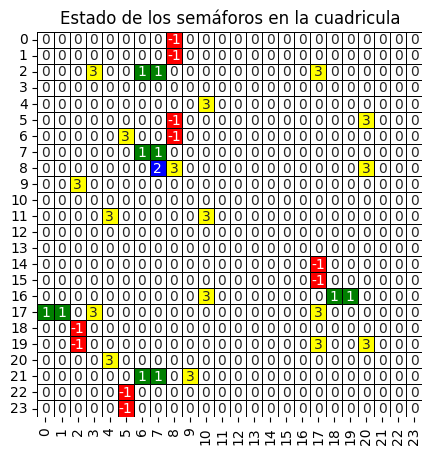

posicion: (8, 7)
[(7, 7)]


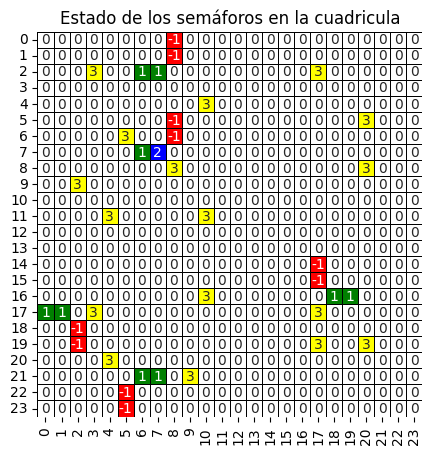

posicion: (7, 7)
[(6, 7)]


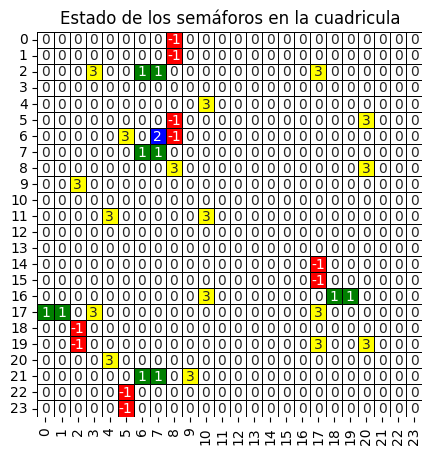

posicion: (6, 7)
[(5, 7)]


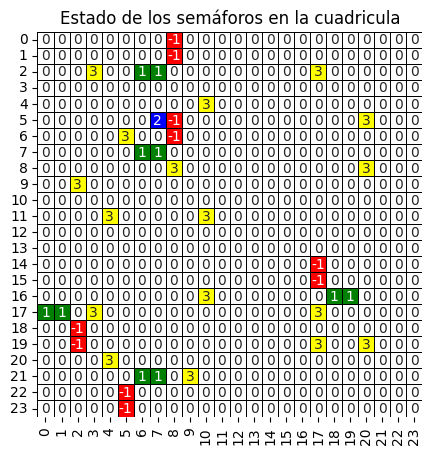

posicion: (5, 7)
[(4, 7)]


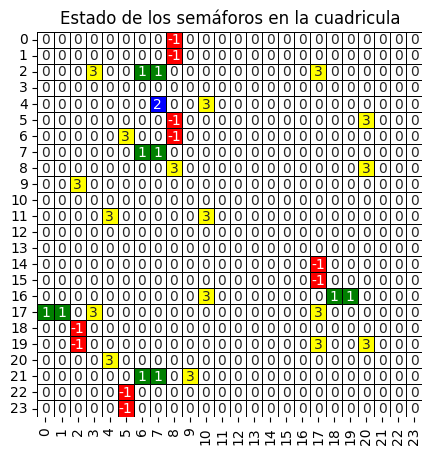

posicion: (4, 7)
[(3, 7)]


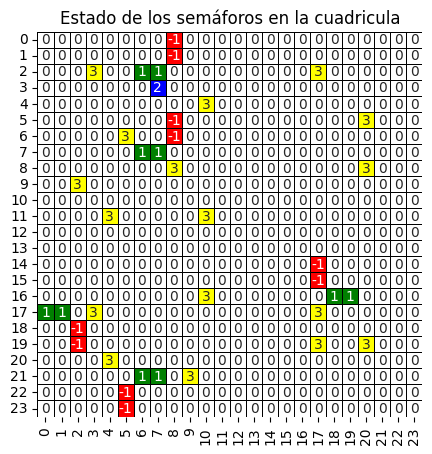

posicion: (3, 7)
[(2, 7)]


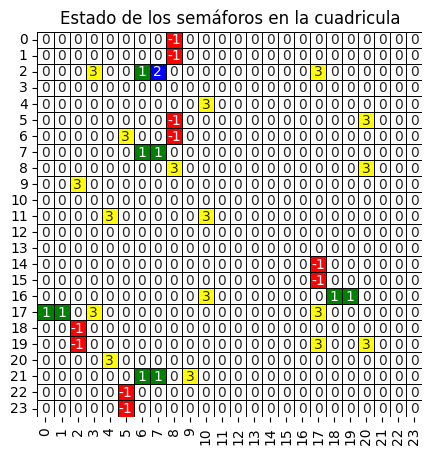

posicion: (2, 7)
[(1, 7)]


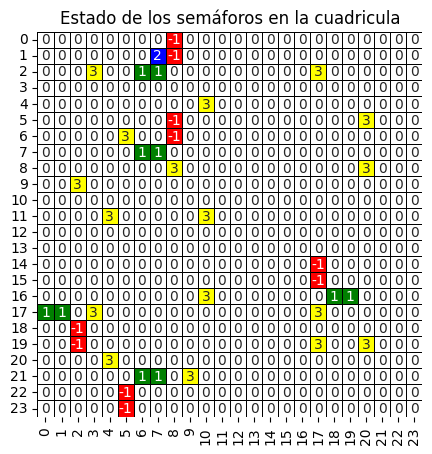

posicion: (1, 7)
[(1, 6)]


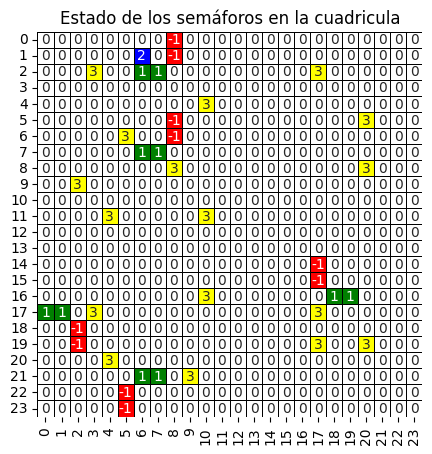

posicion: (1, 6)
[(1, 5)]


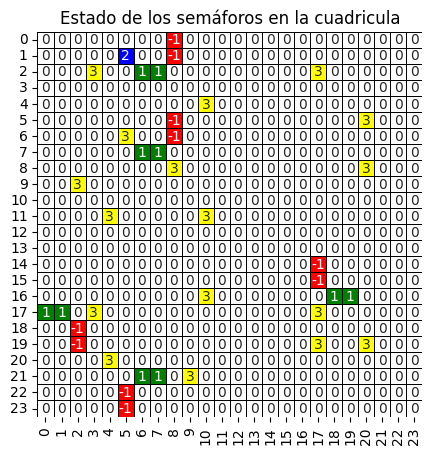

posicion: (1, 5)
[(1, 4)]


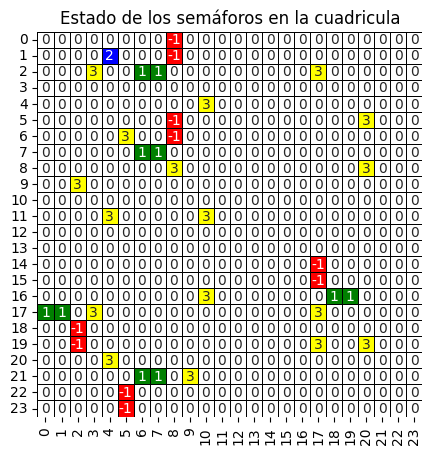

posicion: (1, 4)
[(1, 3)]


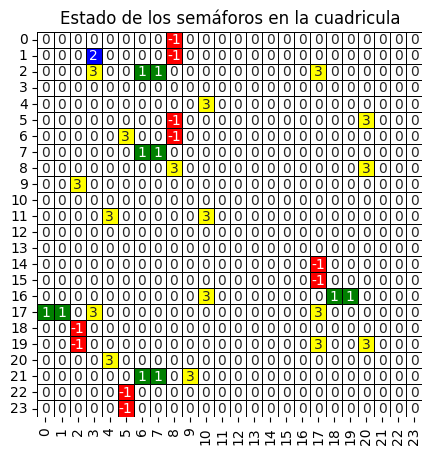

posicion: (1, 3)
[(1, 2)]


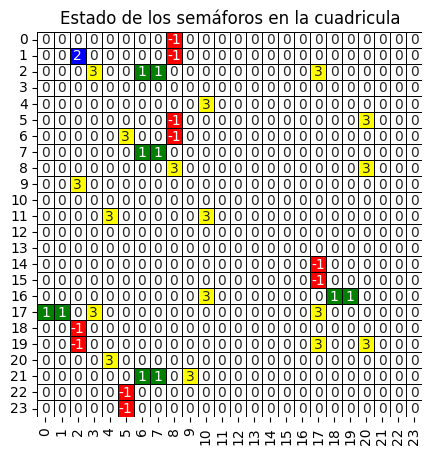

posicion: (1, 2)
[(1, 1)]


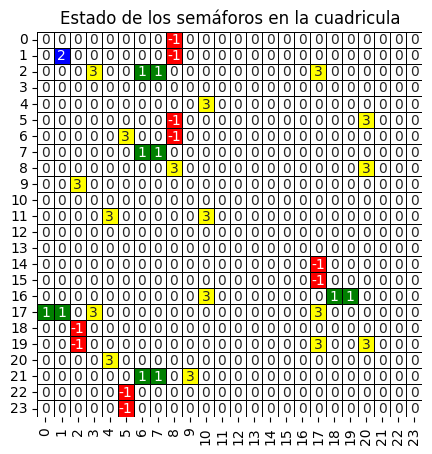

posicion: (1, 1)
[(1, 0)]


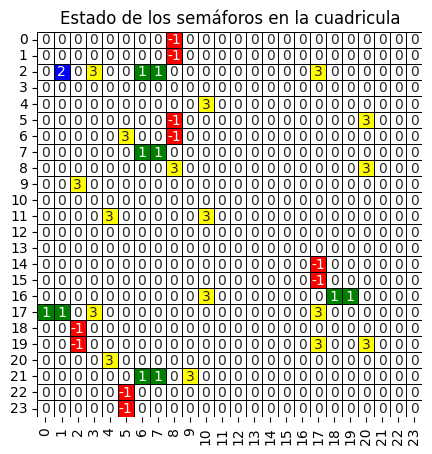

Semaforo 1 cambión de color
Semaforo: 1 | Color: ROJO | Posicion (2, 6)
Semaforo 2 cambión de color
Semaforo: 2 | Color: ROJO | Posicion (2, 7)
Semaforo 3 cambión de color
Semaforo: 3 | Color: ROJO | Posicion (7, 6)
Semaforo 4 cambión de color
Semaforo: 4 | Color: ROJO | Posicion (7, 7)
Semaforo 5 cambión de color
Semaforo: 5 | Color: ROJO | Posicion (17, 0)
Semaforo 6 cambión de color
Semaforo: 6 | Color: ROJO | Posicion (17, 1)
Semaforo 7 cambión de color
Semaforo: 7 | Color: ROJO | Posicion (21, 6)
Semaforo 8 cambión de color
Semaforo: 8 | Color: ROJO | Posicion (21, 7)
Semaforo 9 cambión de color
Semaforo: 9 | Color: ROJO | Posicion (16, 18)
Semaforo 10 cambión de color
Semaforo: 10 | Color: ROJO | Posicion (16, 19)
Semaforo 11 cambión de color
Semaforo: 11 | Color: VERDE | Posicion (0, 8)
Semaforo 12 cambión de color
Semaforo: 12 | Color: VERDE | Posicion (1, 8)
Semaforo 13 cambión de color
Semaforo: 13 | Color: VERDE | Posicion (5, 8)
Semaforo 14 cambión de color
Semaforo: 14 | C

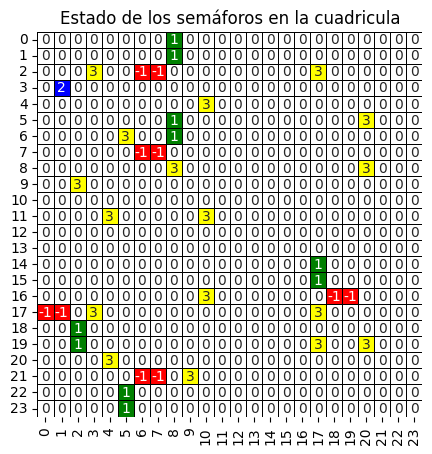

posicion: (3, 1)
[(4, 1)]


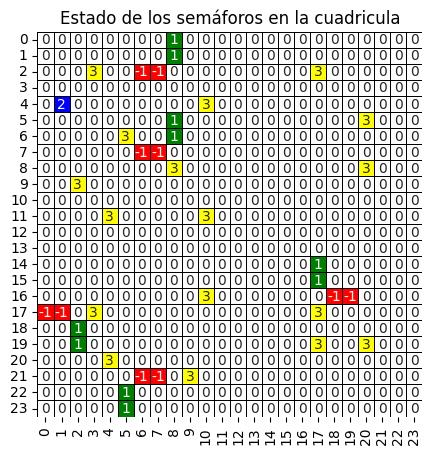

posicion: (4, 1)
[(5, 1)]


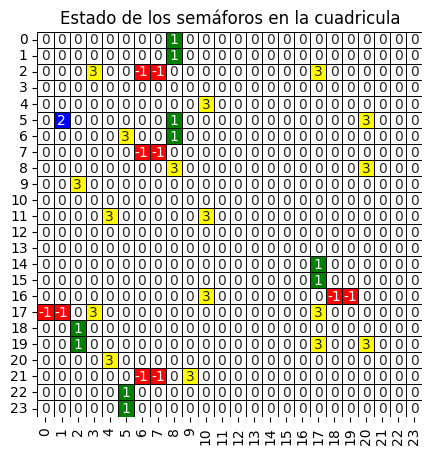

posicion: (5, 1)
[(6, 1)]


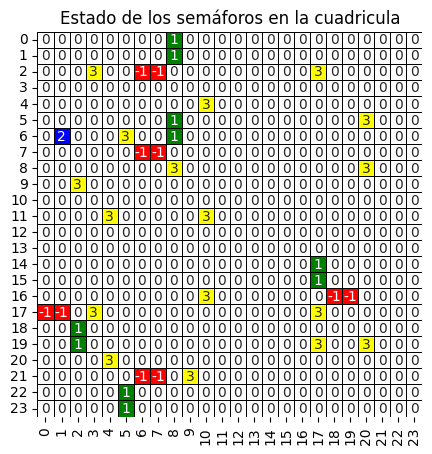

posicion: (6, 1)
[(7, 1)]


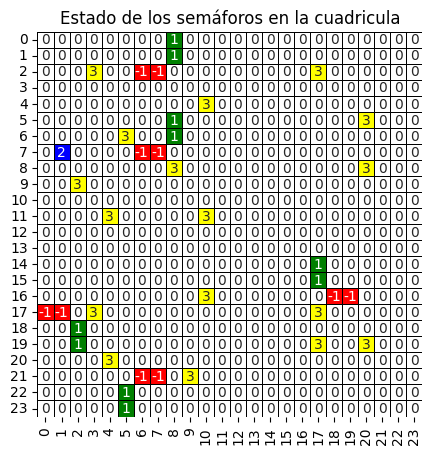

posicion: (7, 1)
[(8, 1)]


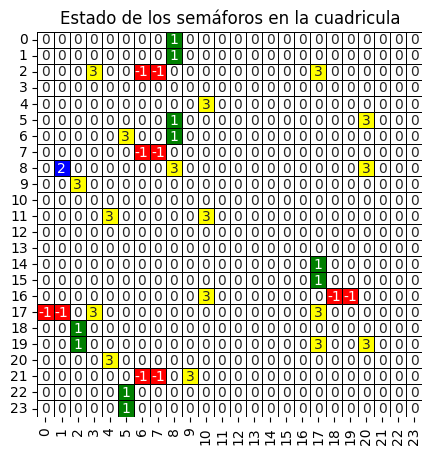

posicion: (8, 1)
[(9, 1)]


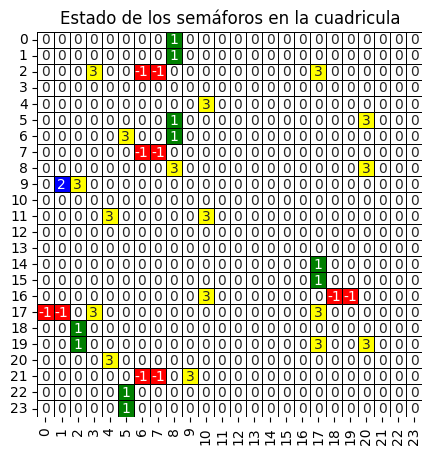

posicion: (9, 1)
[(10, 1)]


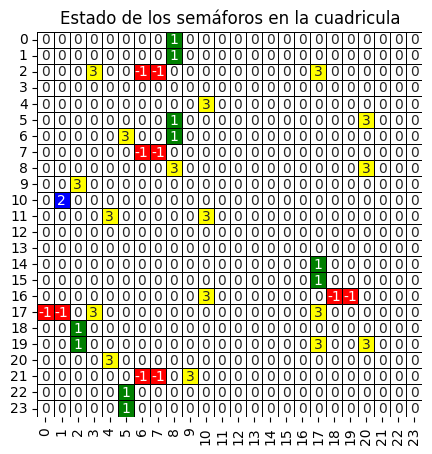

posicion: (10, 1)
[(11, 1)]


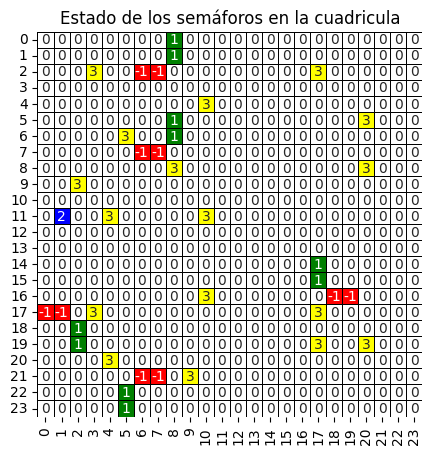

posicion: (11, 1)
[(12, 1)]


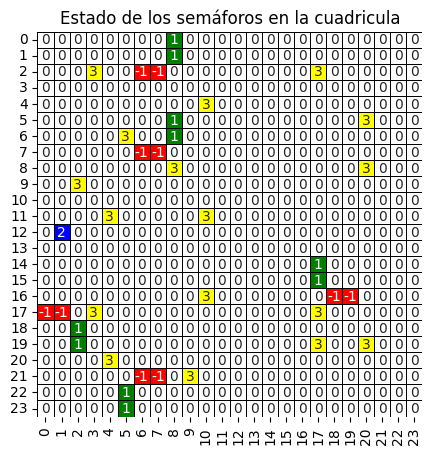

posicion: (12, 1)
[(13, 1)]


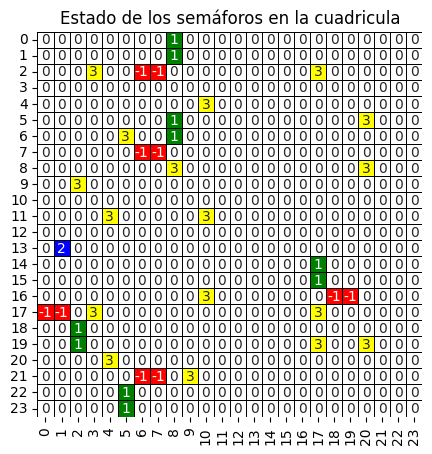

posicion: (13, 1)
[(14, 1)]


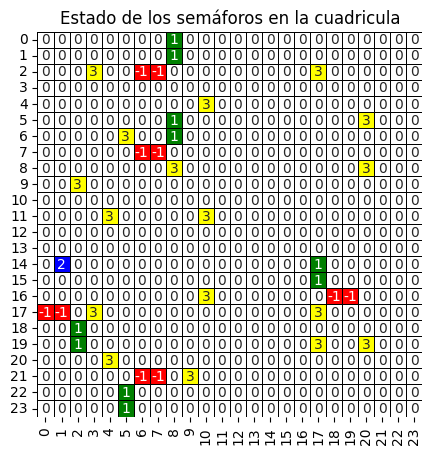

posicion: (14, 1)
[(14, 2)]


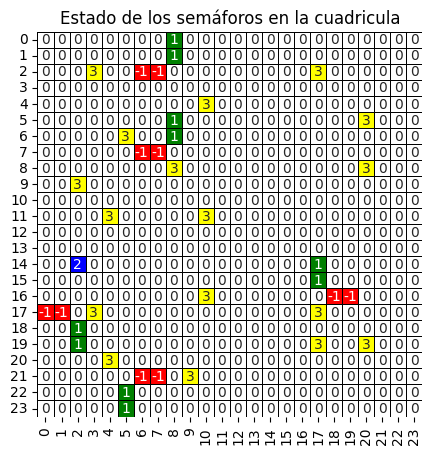

posicion: (14, 2)
[(14, 3)]


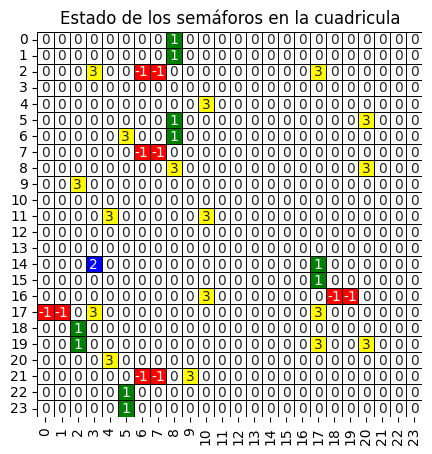

posicion: (14, 3)
[(14, 4)]


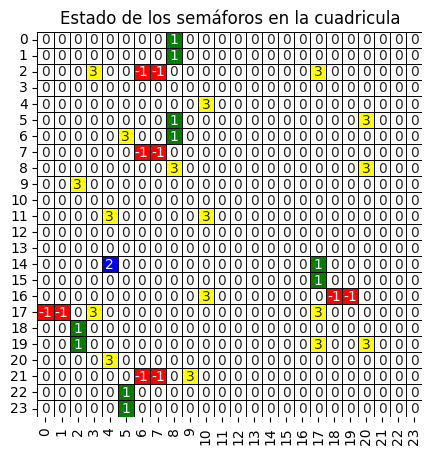

posicion: (14, 4)
[(14, 5)]


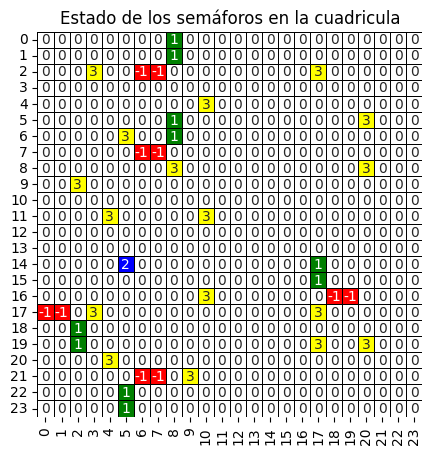

posicion: (14, 5)
[(14, 6)]


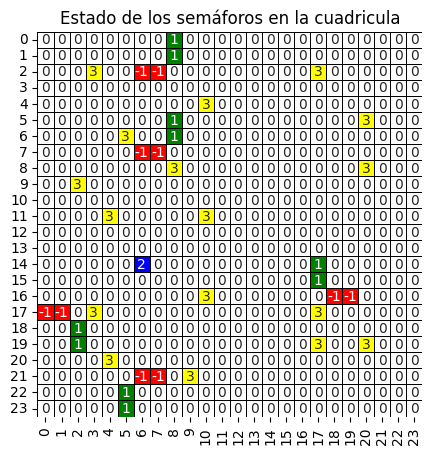

posicion: (14, 6)
[(14, 7)]


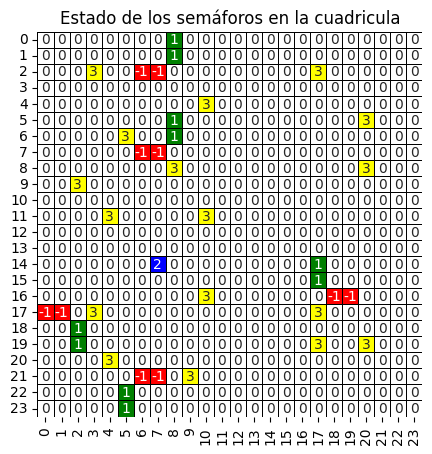

posicion: (14, 7)
[(14, 8)]


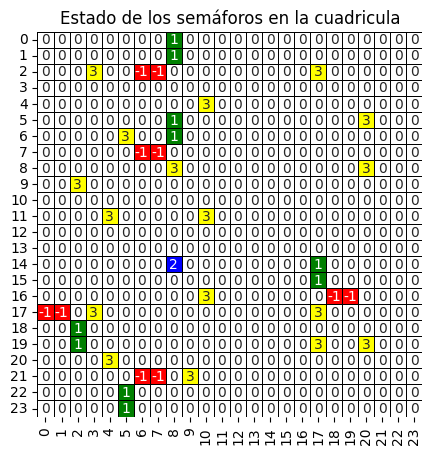

posicion: (14, 8)
[(14, 9)]


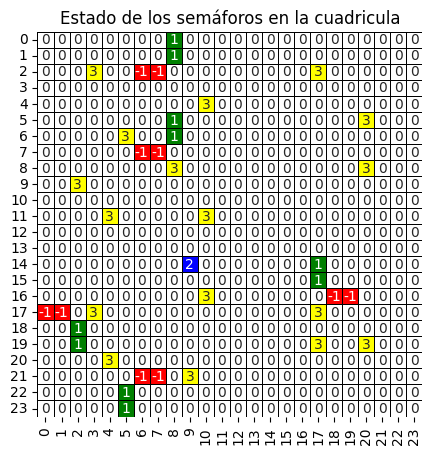

posicion: (14, 9)
[(14, 10)]


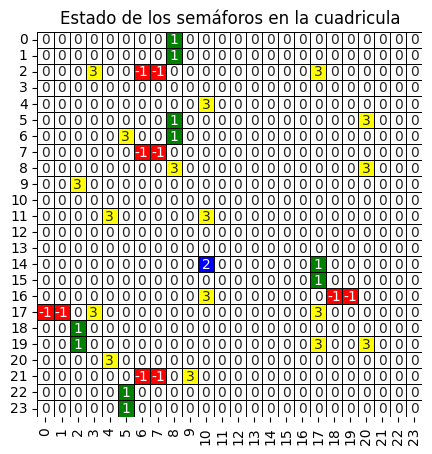

posicion: (14, 10)
[(14, 11)]


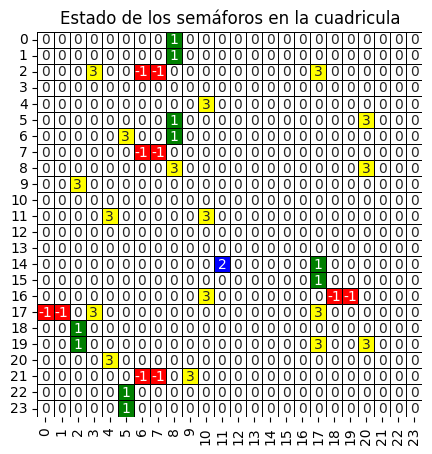

posicion: (14, 11)
[(14, 12)]


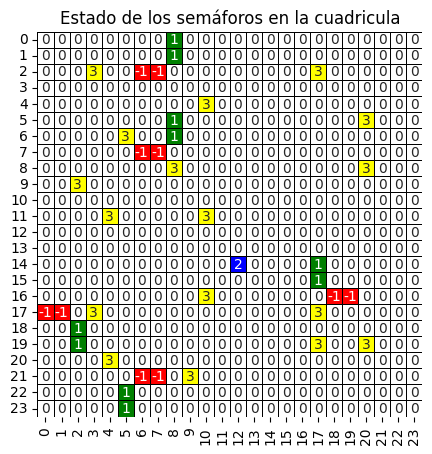

posicion: (14, 12)
[(15, 12)]


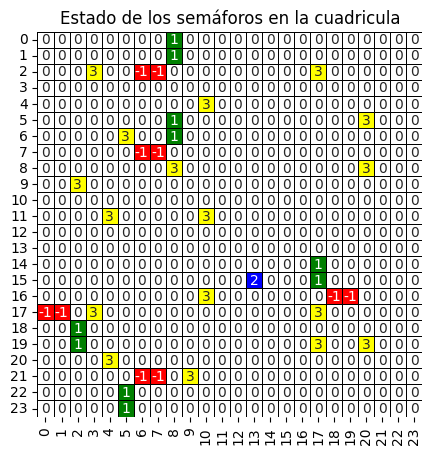

posicion: (15, 13)
[(15, 14)]


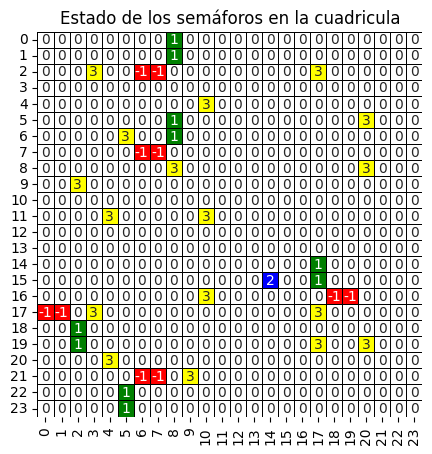

posicion: (15, 14)
[(15, 15)]


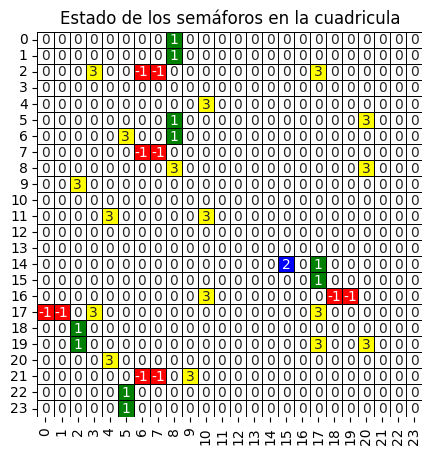

posicion: (14, 15)
[(14, 16)]


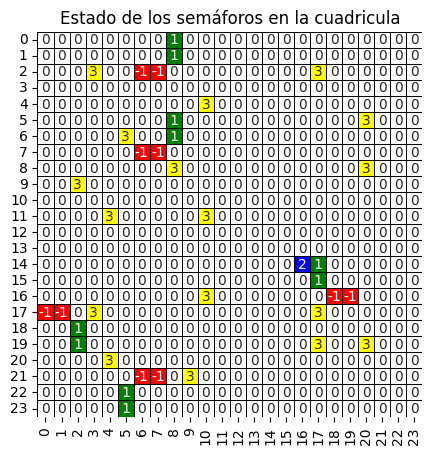

posicion: (14, 16)
[(14, 17)]


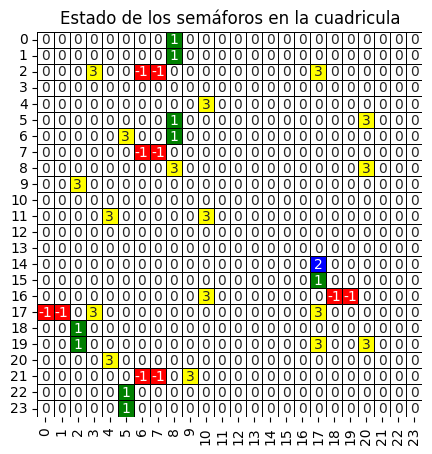

posicion: (14, 17)
[(14, 18)]


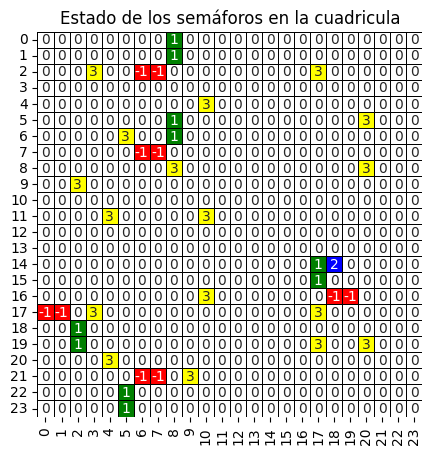

posicion: (14, 18)
[(14, 19)]


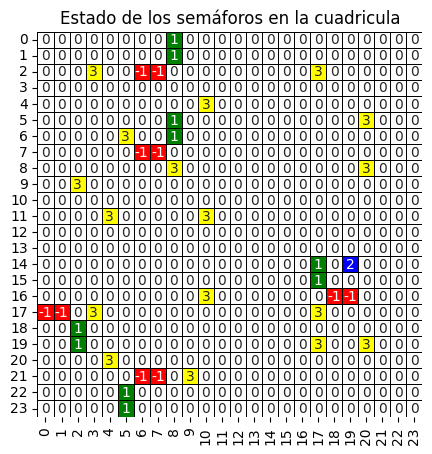

posicion: (14, 19)
[(14, 20)]


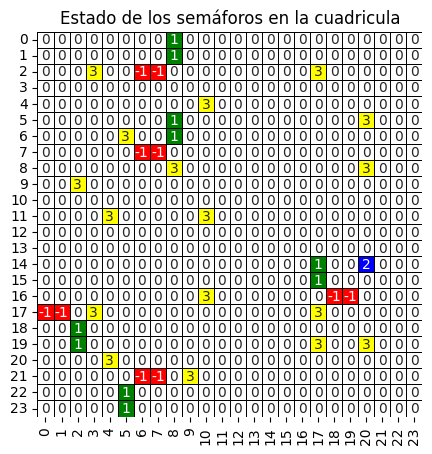

posicion: (14, 20)
[(14, 21)]


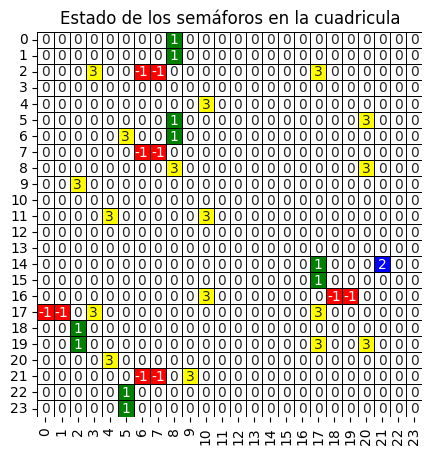

posicion: (14, 21)
[(14, 22)]


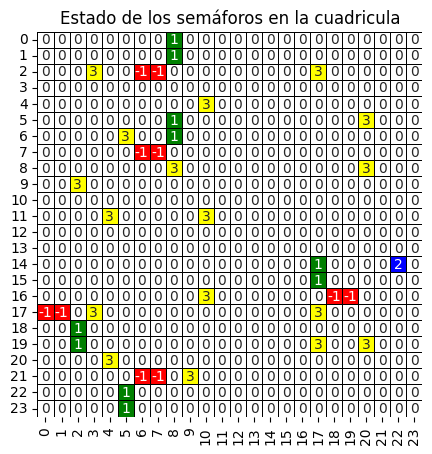

posicion: (14, 22)
[(13, 22)]


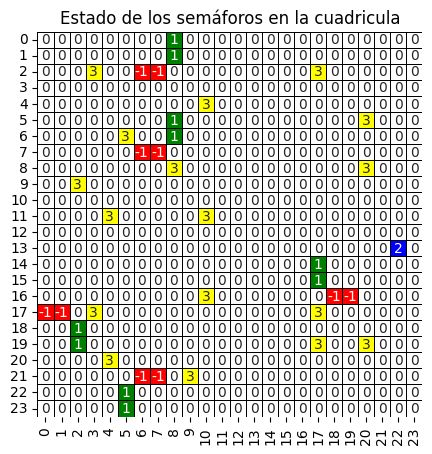

posicion: (13, 22)
[(13, 21)]


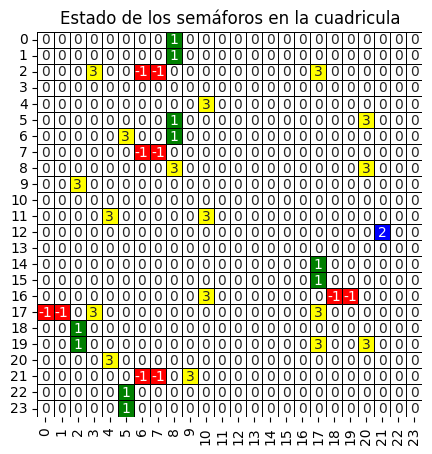

posicion: (12, 21)
[(12, 20)]


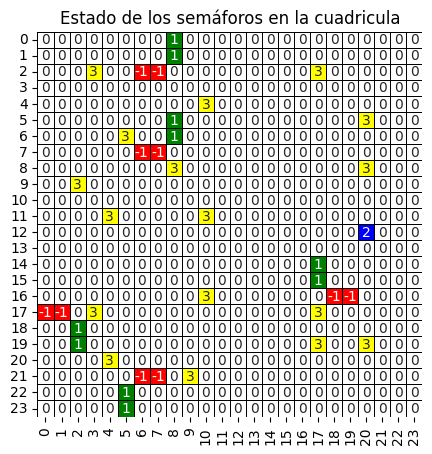

posicion: (12, 20)
[(12, 19)]


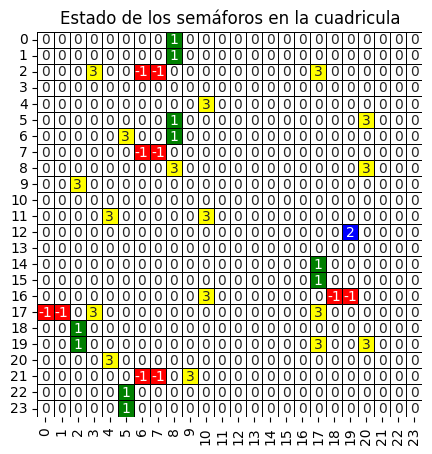

posicion: (12, 19)
[(12, 18)]


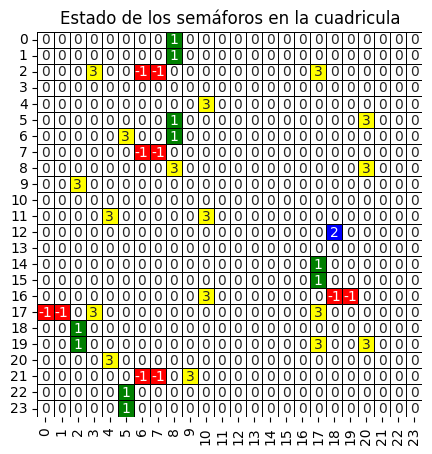

posicion: (12, 18)
[(12, 17)]


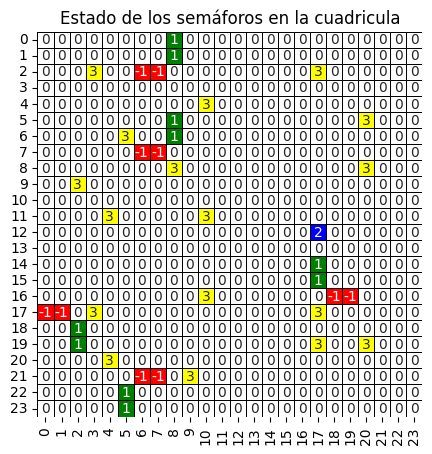

posicion: (12, 17)
[(12, 16)]


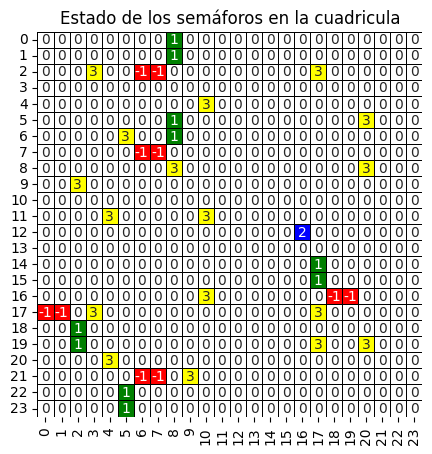

Semaforo 1 cambión de color
Semaforo: 1 | Color: VERDE | Posicion (2, 6)
Semaforo 2 cambión de color
Semaforo: 2 | Color: VERDE | Posicion (2, 7)
Semaforo 3 cambión de color
Semaforo: 3 | Color: VERDE | Posicion (7, 6)
Semaforo 4 cambión de color
Semaforo: 4 | Color: VERDE | Posicion (7, 7)
Semaforo 5 cambión de color
Semaforo: 5 | Color: VERDE | Posicion (17, 0)
Semaforo 6 cambión de color
Semaforo: 6 | Color: VERDE | Posicion (17, 1)
Semaforo 7 cambión de color
Semaforo: 7 | Color: VERDE | Posicion (21, 6)
Semaforo 8 cambión de color
Semaforo: 8 | Color: VERDE | Posicion (21, 7)
Semaforo 9 cambión de color
Semaforo: 9 | Color: VERDE | Posicion (16, 18)
Semaforo 10 cambión de color
Semaforo: 10 | Color: VERDE | Posicion (16, 19)
Semaforo 11 cambión de color
Semaforo: 11 | Color: ROJO | Posicion (0, 8)
Semaforo 12 cambión de color
Semaforo: 12 | Color: ROJO | Posicion (1, 8)
Semaforo 13 cambión de color
Semaforo: 13 | Color: ROJO | Posicion (5, 8)
Semaforo 14 cambión de color
Semaforo:

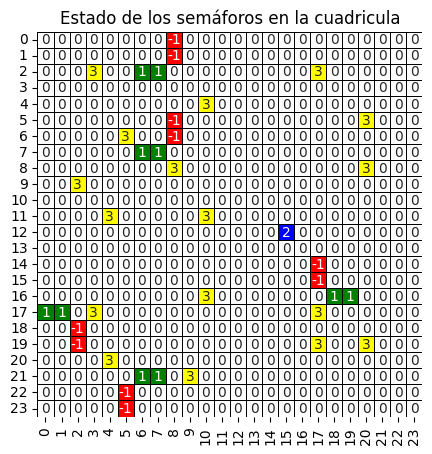

posicion: (12, 15)
[(12, 14)]


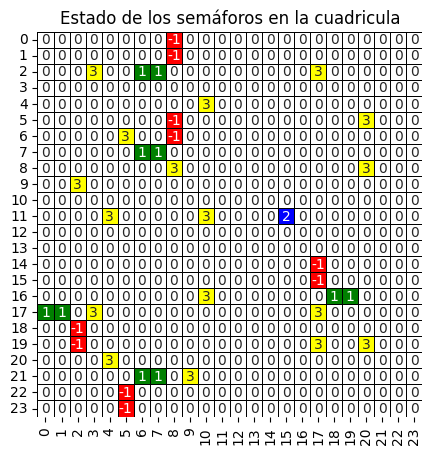

posicion: (11, 15)
[(10, 15)]


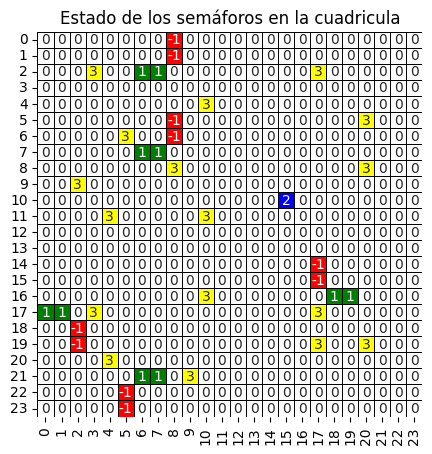

posicion: (10, 15)
[(9, 15)]


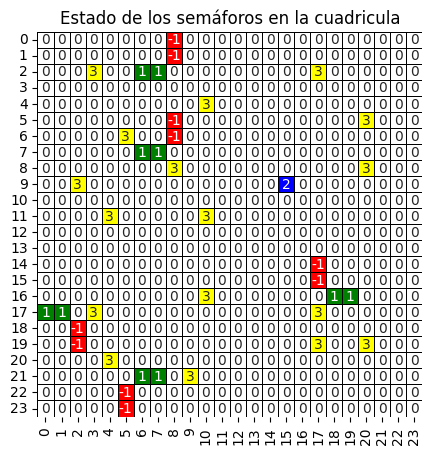

posicion: (9, 15)
[(8, 15)]


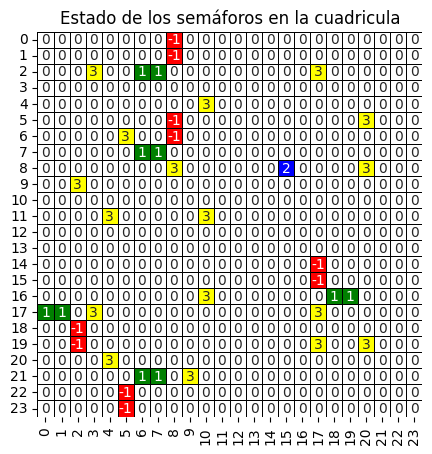

posicion: (8, 15)
[(7, 15)]


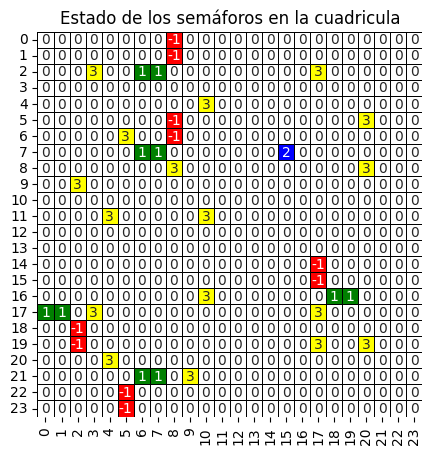

posicion: (7, 15)
[(6, 15)]


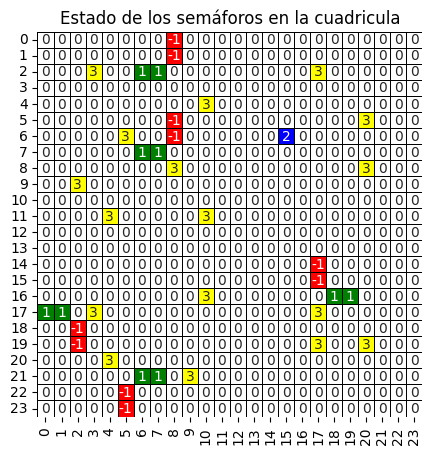

posicion: (6, 15)
[(5, 15)]


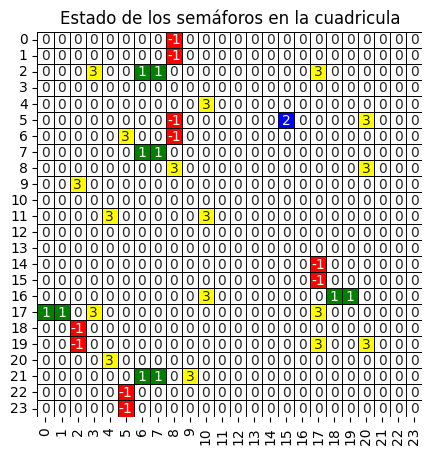

posicion: (5, 15)
[(4, 15)]


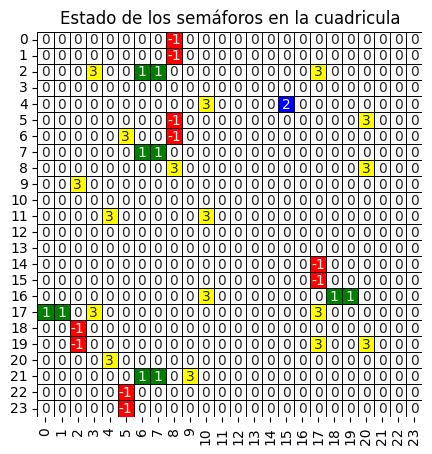

posicion: (4, 15)
[(3, 15)]


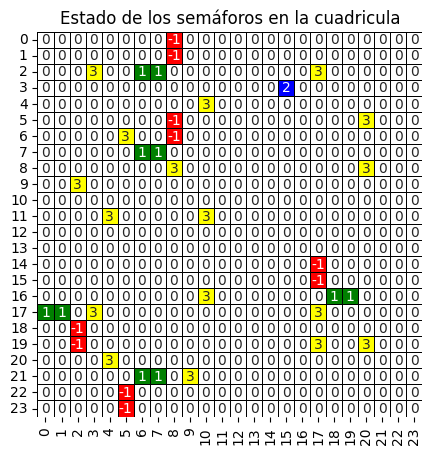

posicion: (3, 15)
[(2, 15)]


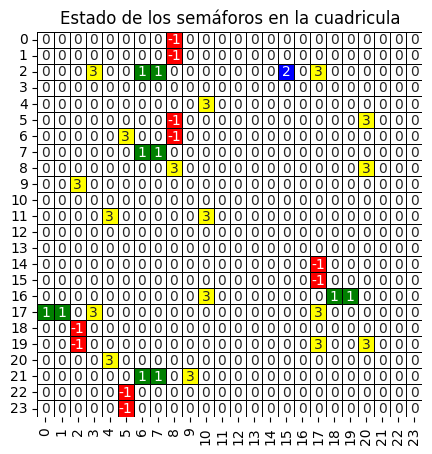

posicion: (2, 15)
[(1, 15)]


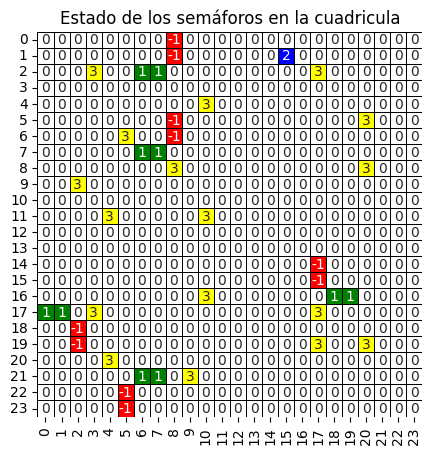

posicion: (1, 15)
[(1, 14)]


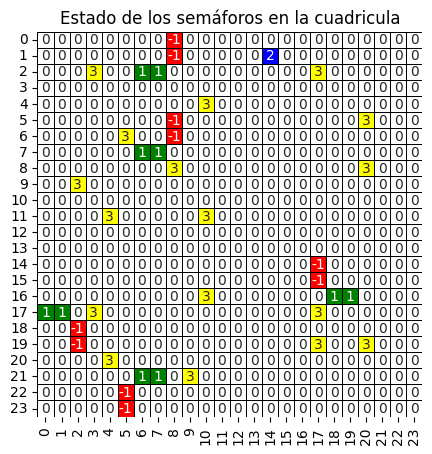

posicion: (1, 14)
[(1, 13)]


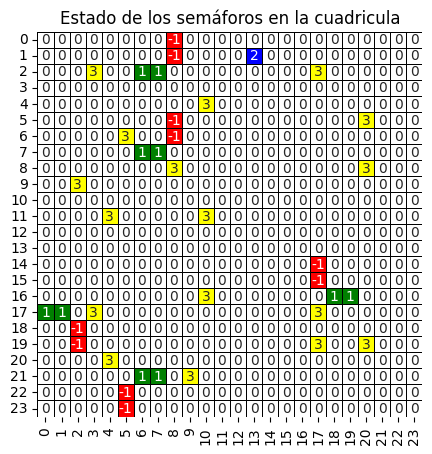

posicion: (1, 13)
[(1, 12)]


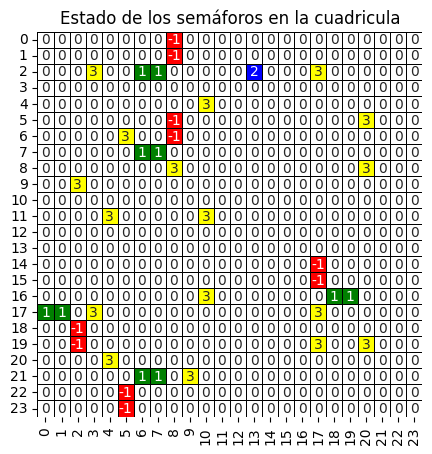

posicion: (2, 13)
[(3, 13)]


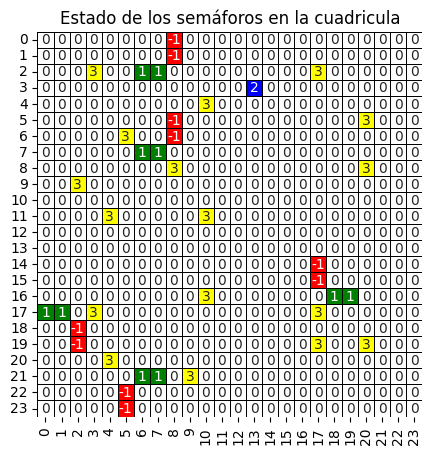

posicion: (3, 13)
[(4, 13)]


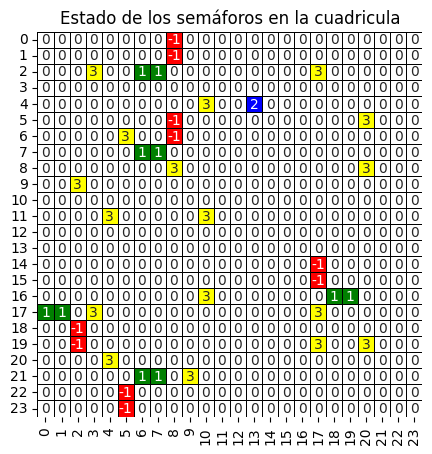

posicion: (4, 13)
[(5, 13)]


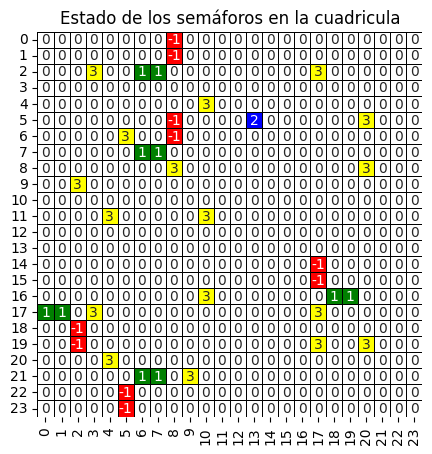

posicion: (5, 13)
[(6, 13)]


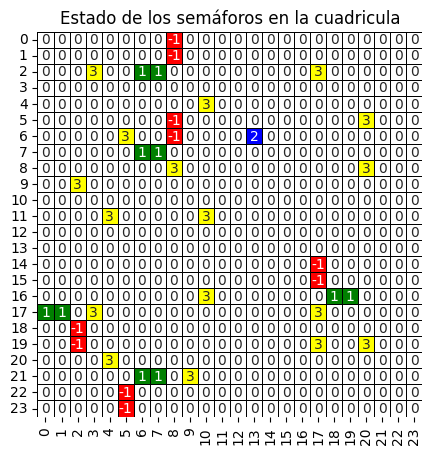

posicion: (6, 13)
[(7, 13)]


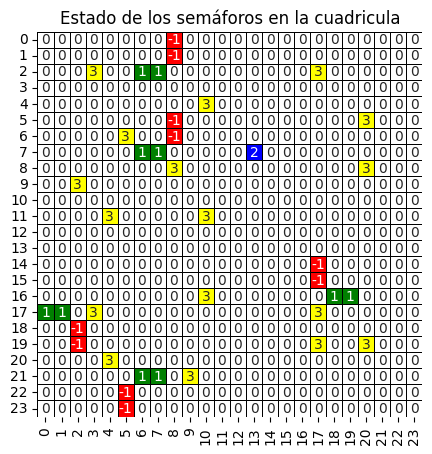

posicion: (7, 13)
[(8, 13)]


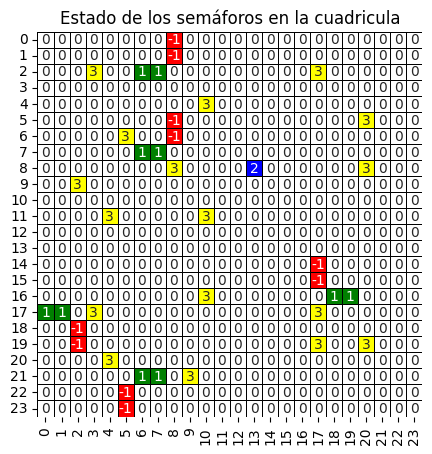

posicion: (8, 13)
[(9, 13)]


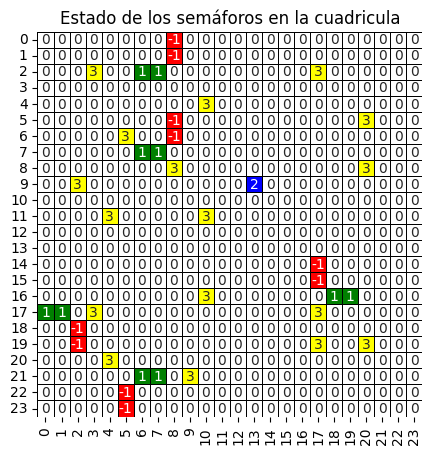

posicion: (9, 13)
[(10, 13)]


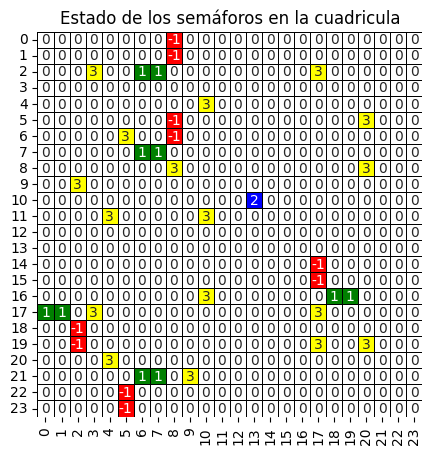

posicion: (10, 13)
[(11, 13)]


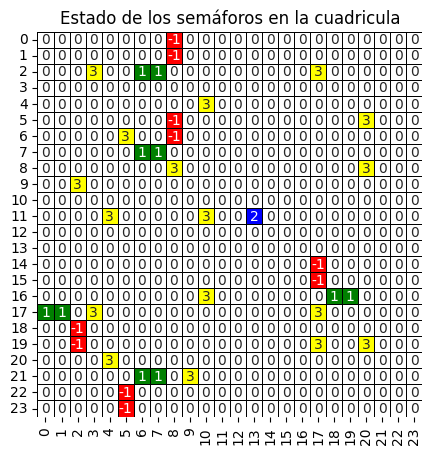

posicion: (11, 13)
[(12, 13)]


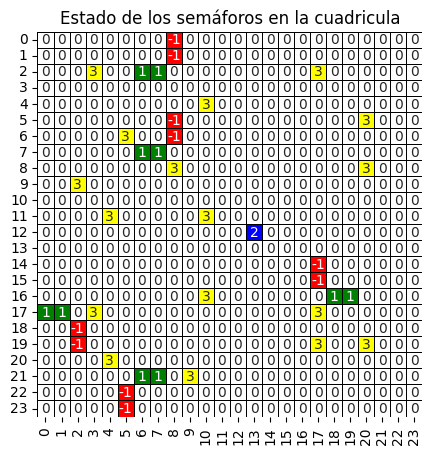

posicion: (12, 13)
[(12, 12)]


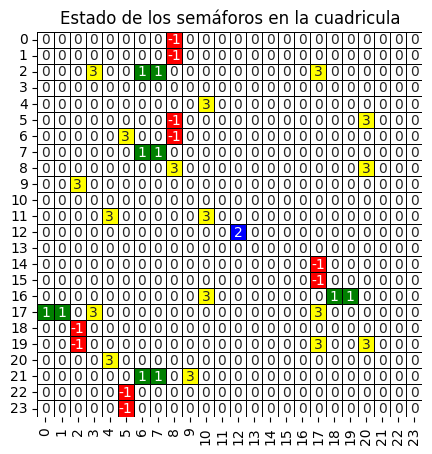

posicion: (12, 12)
[(12, 11)]


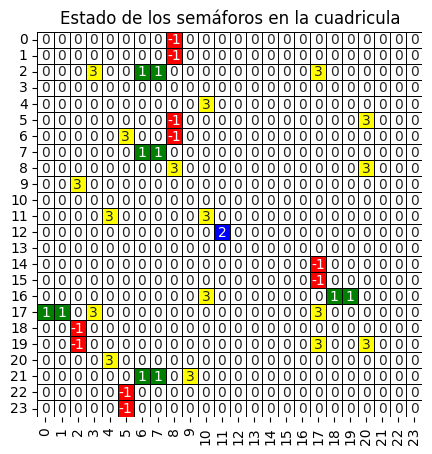

posicion: (12, 11)
[(12, 10)]


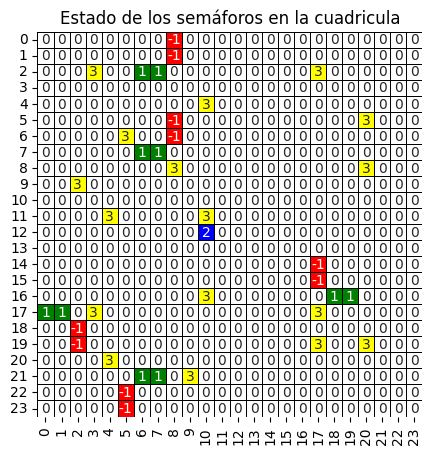

posicion: (12, 10)
[(12, 9)]


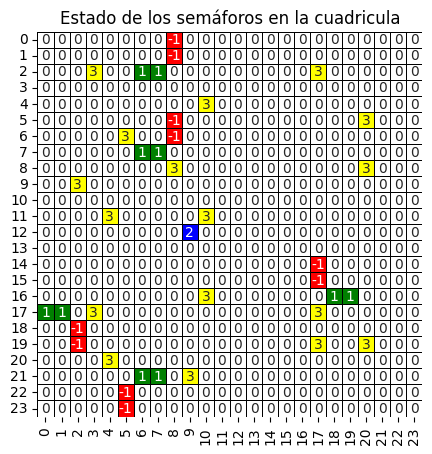

posicion: (12, 9)
[(12, 8)]


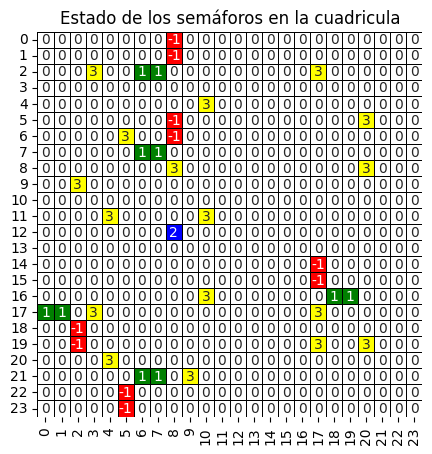

posicion: (12, 8)
[(12, 7)]


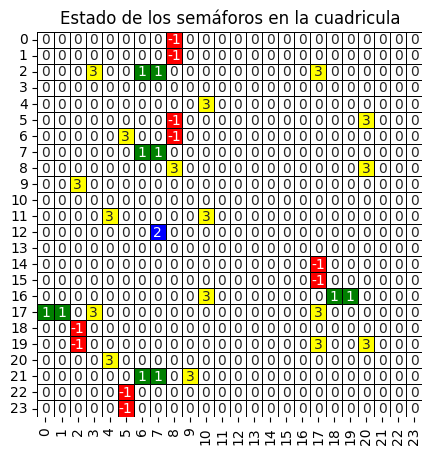

posicion: (12, 7)
[(12, 6)]


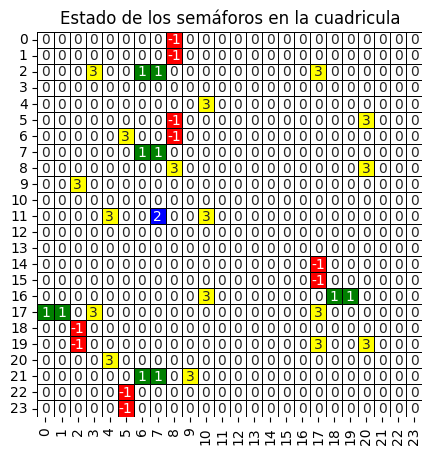

posicion: (11, 7)
[(10, 7)]


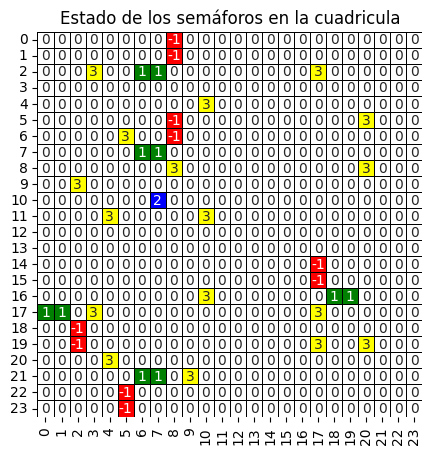

posicion: (10, 7)
[(9, 7)]


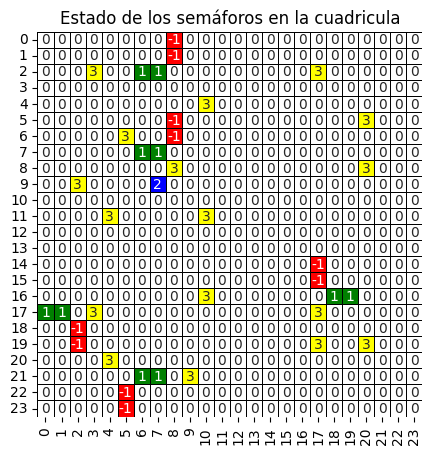

posicion: (9, 7)
[(8, 7)]


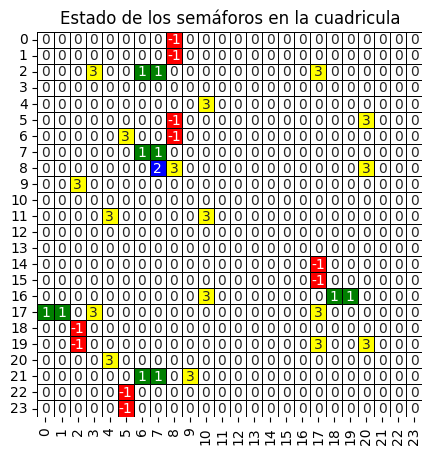

posicion: (8, 7)
[(7, 7)]


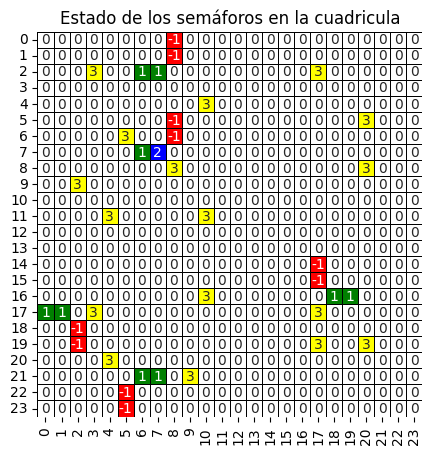

posicion: (7, 7)
[(6, 7)]


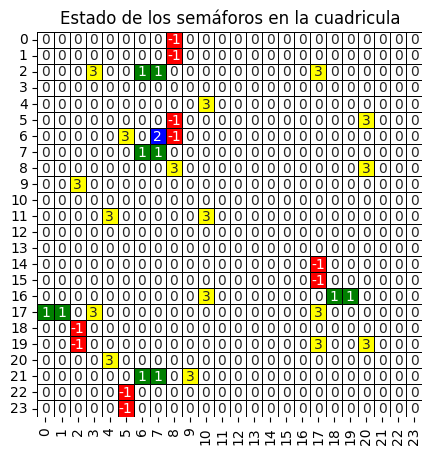

posicion: (6, 7)
[(5, 7)]


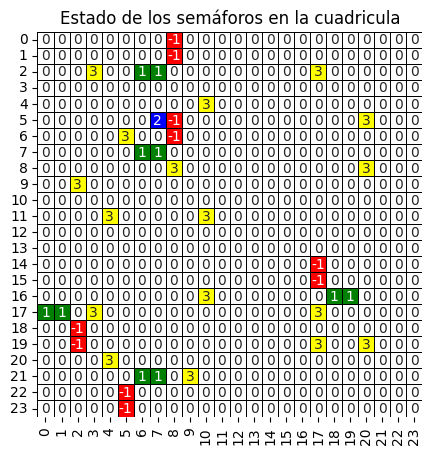

posicion: (5, 7)
[(4, 7)]


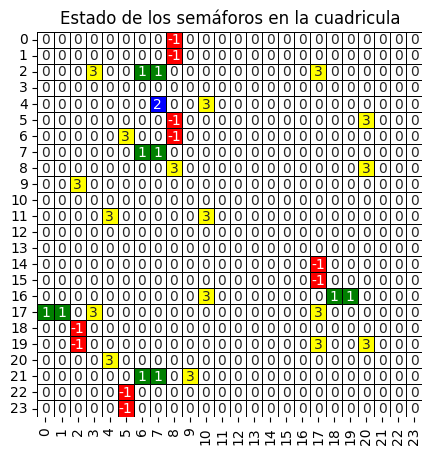

posicion: (4, 7)
[(3, 7)]


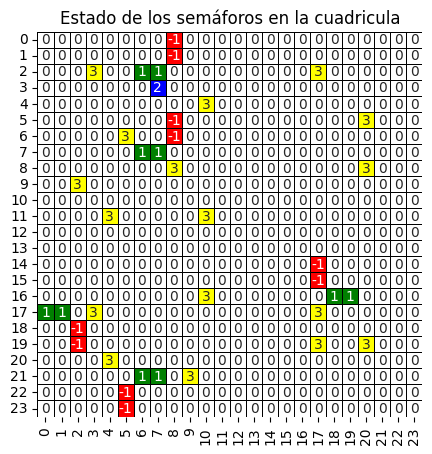

Semaforo 1 cambión de color
Semaforo: 1 | Color: ROJO | Posicion (2, 6)
Semaforo 2 cambión de color
Semaforo: 2 | Color: ROJO | Posicion (2, 7)
Semaforo 3 cambión de color
Semaforo: 3 | Color: ROJO | Posicion (7, 6)
Semaforo 4 cambión de color
Semaforo: 4 | Color: ROJO | Posicion (7, 7)
Semaforo 5 cambión de color
Semaforo: 5 | Color: ROJO | Posicion (17, 0)
Semaforo 6 cambión de color
Semaforo: 6 | Color: ROJO | Posicion (17, 1)
Semaforo 7 cambión de color
Semaforo: 7 | Color: ROJO | Posicion (21, 6)
Semaforo 8 cambión de color
Semaforo: 8 | Color: ROJO | Posicion (21, 7)
Semaforo 9 cambión de color
Semaforo: 9 | Color: ROJO | Posicion (16, 18)
Semaforo 10 cambión de color
Semaforo: 10 | Color: ROJO | Posicion (16, 19)
Semaforo 11 cambión de color
Semaforo: 11 | Color: VERDE | Posicion (0, 8)
Semaforo 12 cambión de color
Semaforo: 12 | Color: VERDE | Posicion (1, 8)
Semaforo 13 cambión de color
Semaforo: 13 | Color: VERDE | Posicion (5, 8)
Semaforo 14 cambión de color
Semaforo: 14 | C

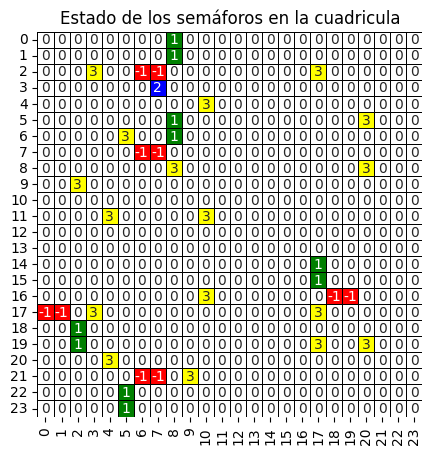

posicion: (3, 7)


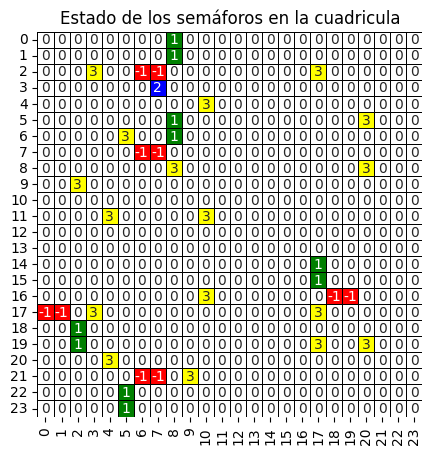

posicion: (3, 7)


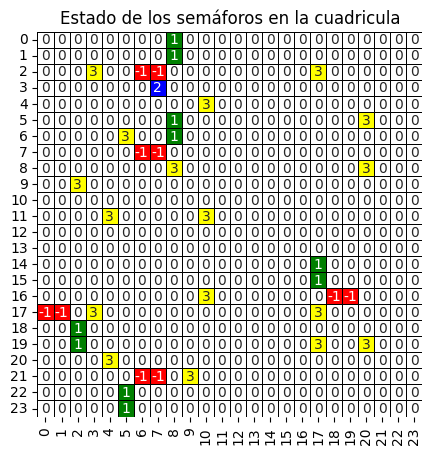

posicion: (3, 7)


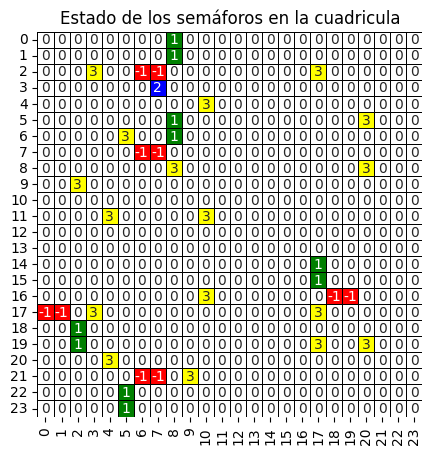

posicion: (3, 7)


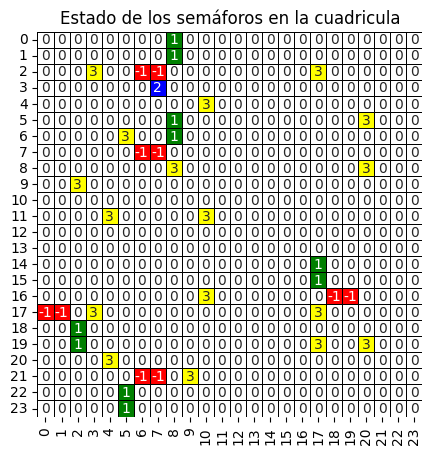

posicion: (3, 7)


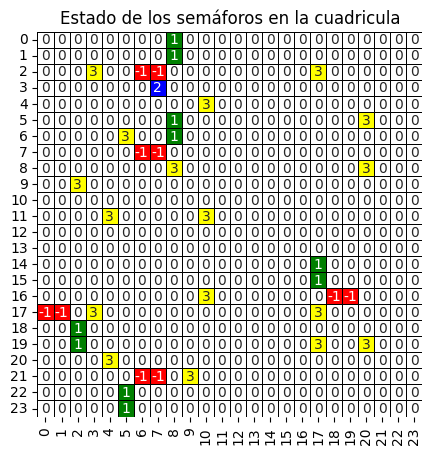

posicion: (3, 7)


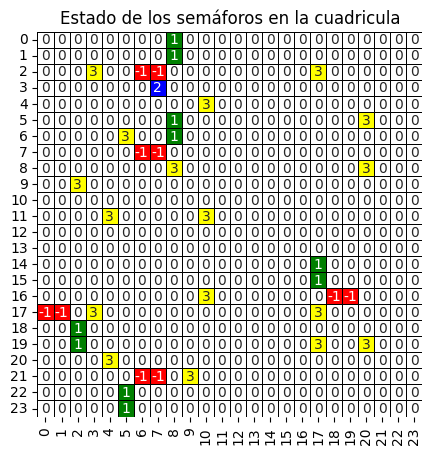

posicion: (3, 7)


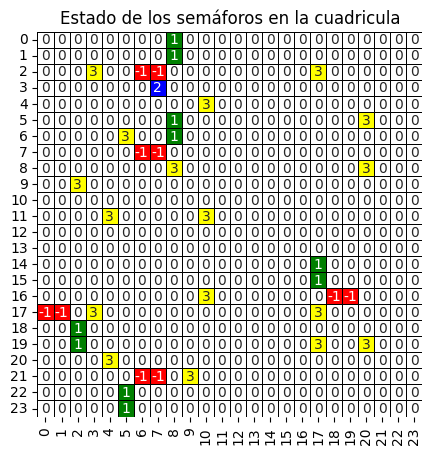

posicion: (3, 7)


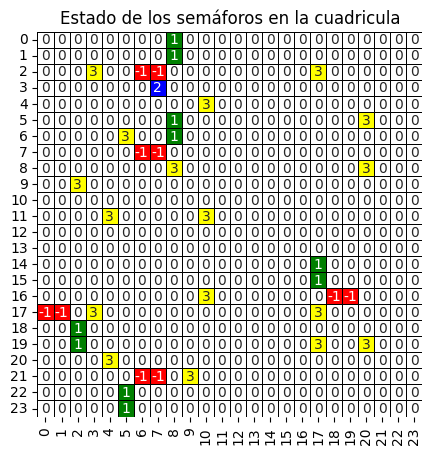

posicion: (3, 7)


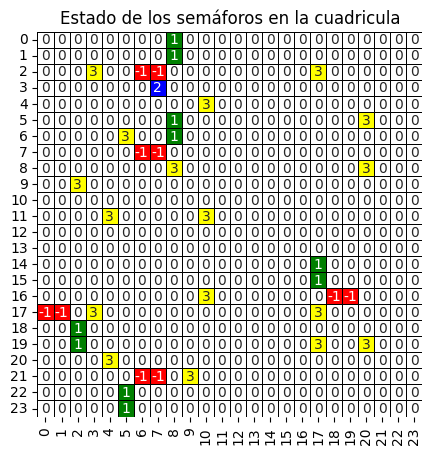

posicion: (3, 7)


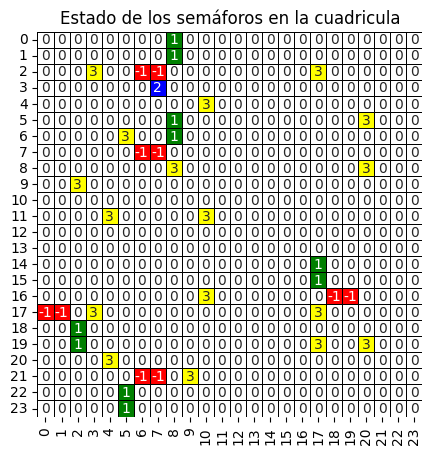

posicion: (3, 7)


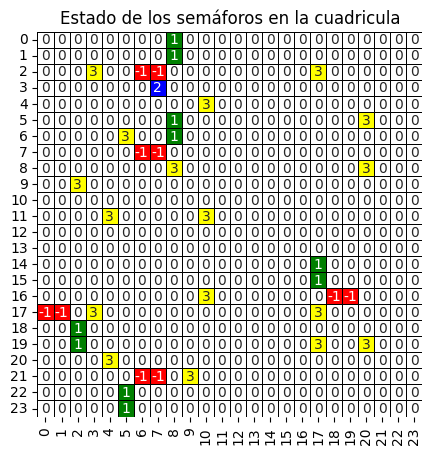

posicion: (3, 7)


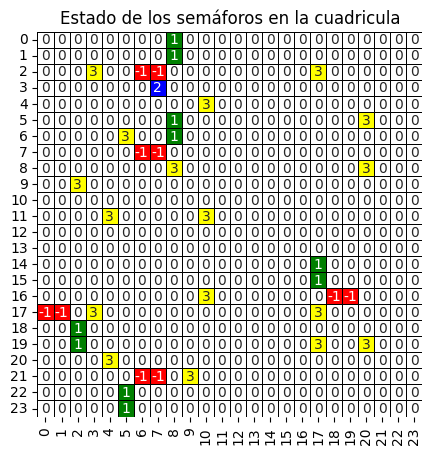

posicion: (3, 7)


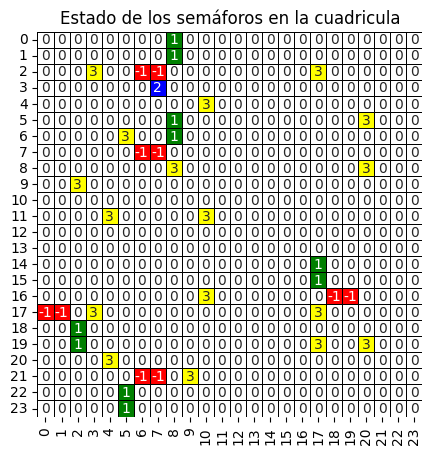

posicion: (3, 7)


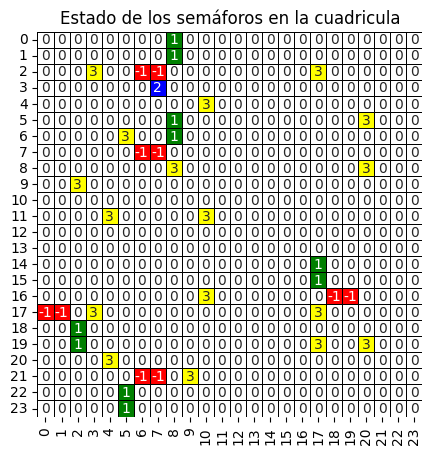

posicion: (3, 7)


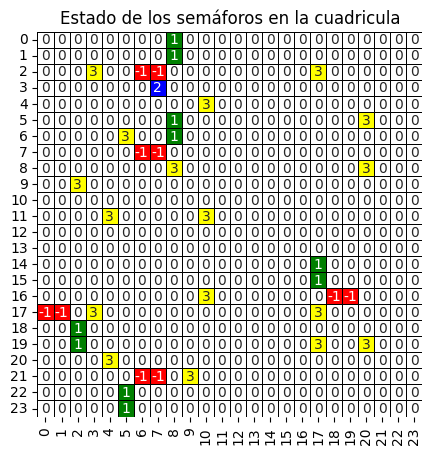

posicion: (3, 7)


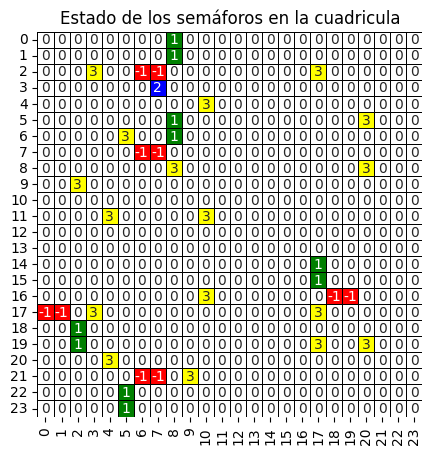

posicion: (3, 7)


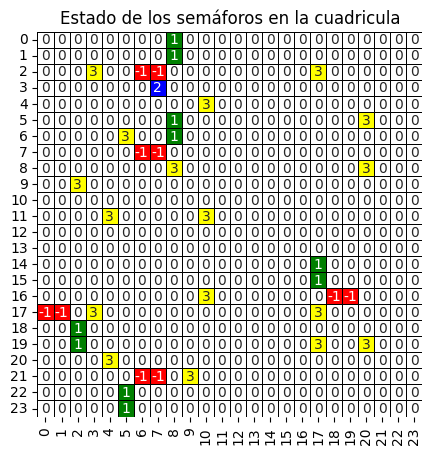

posicion: (3, 7)


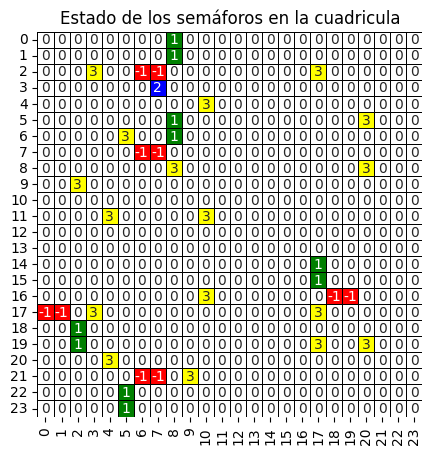

posicion: (3, 7)


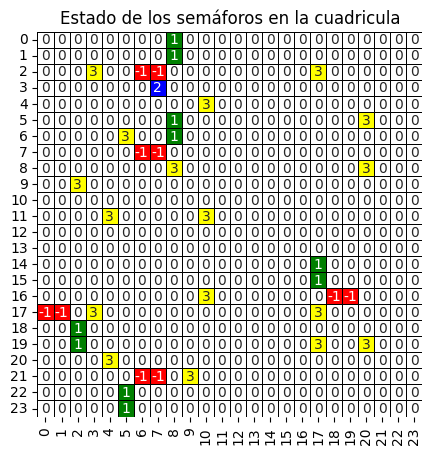

posicion: (3, 7)


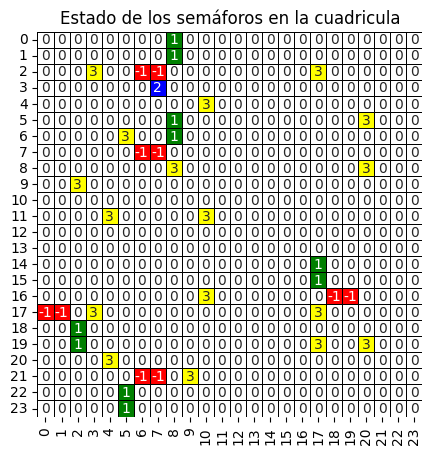

posicion: (3, 7)


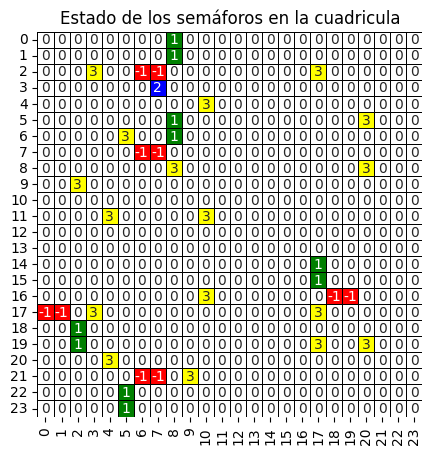

posicion: (3, 7)


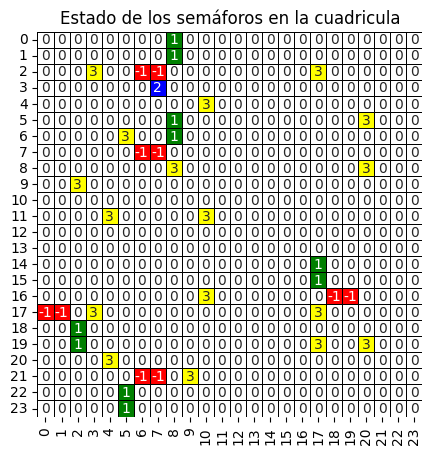

posicion: (3, 7)


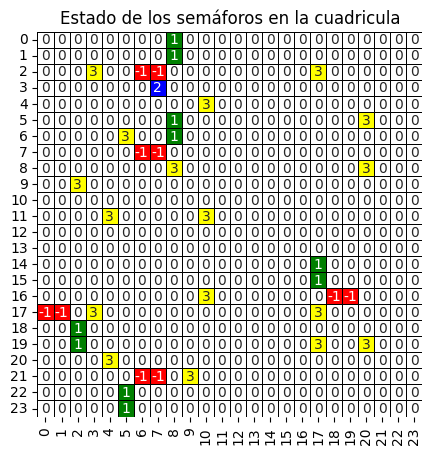

posicion: (3, 7)


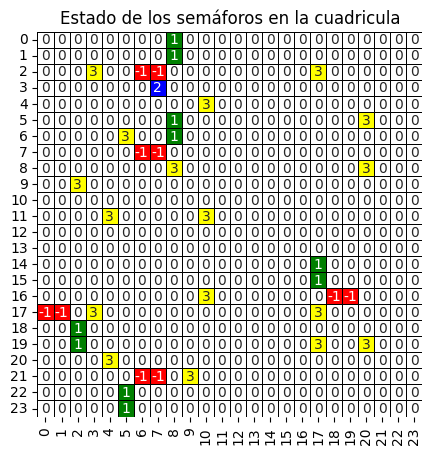

posicion: (3, 7)


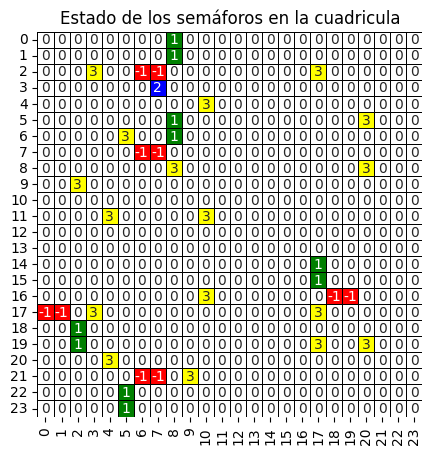

posicion: (3, 7)


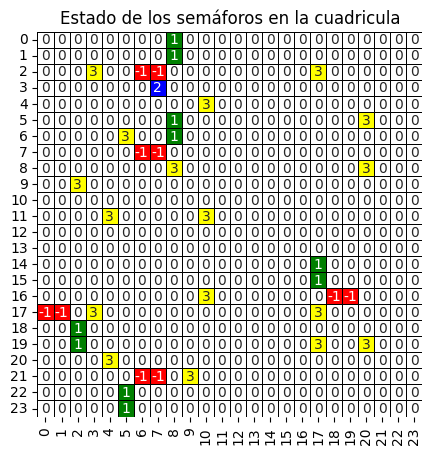

posicion: (3, 7)


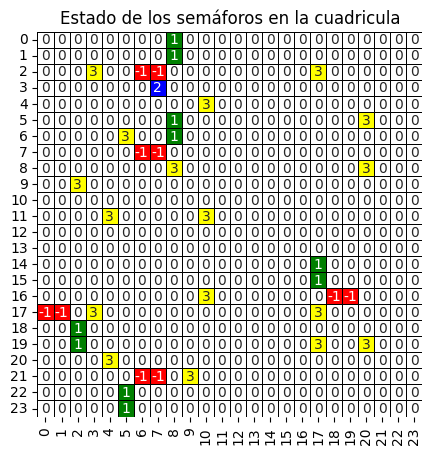

posicion: (3, 7)


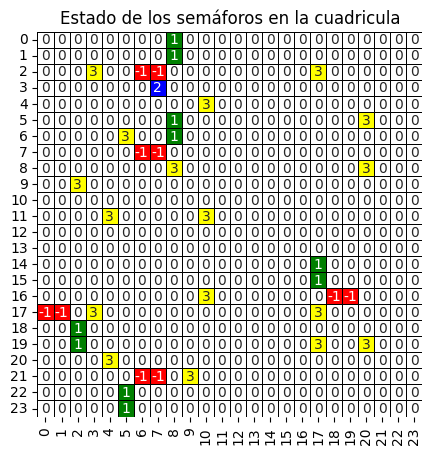

posicion: (3, 7)


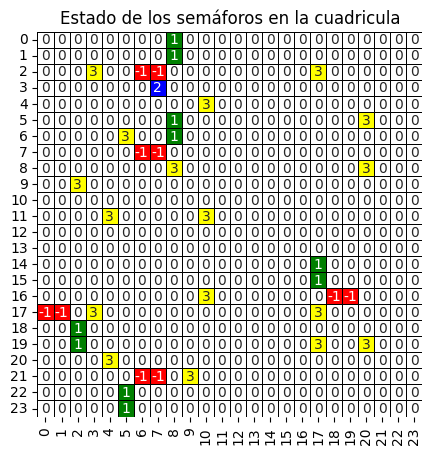

posicion: (3, 7)


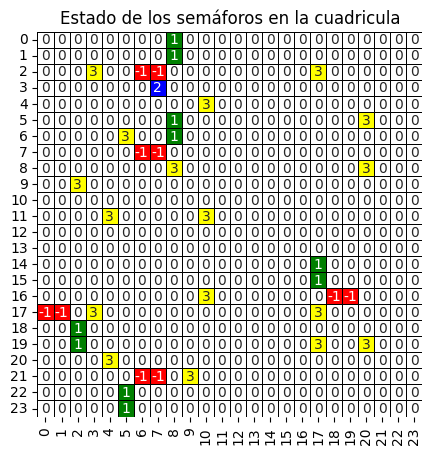

posicion: (3, 7)


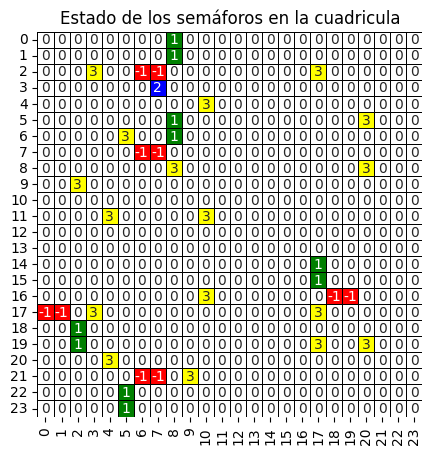

posicion: (3, 7)


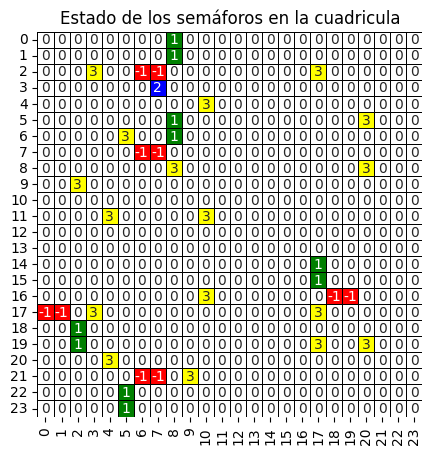

posicion: (3, 7)


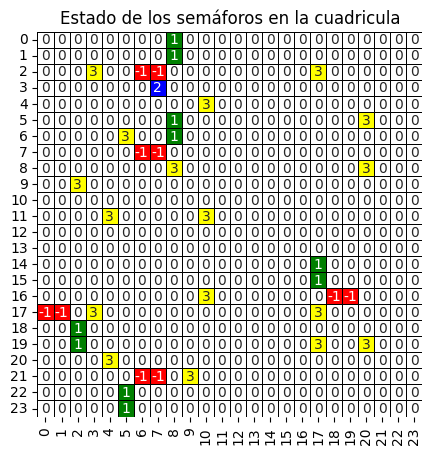

posicion: (3, 7)


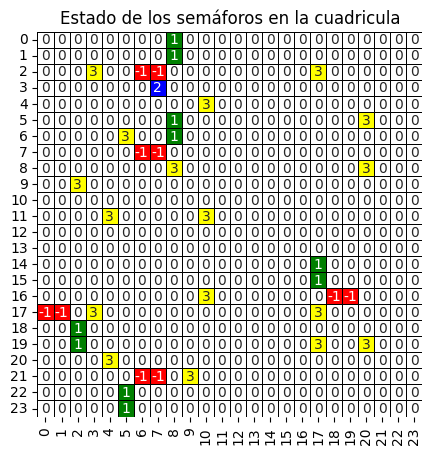

posicion: (3, 7)


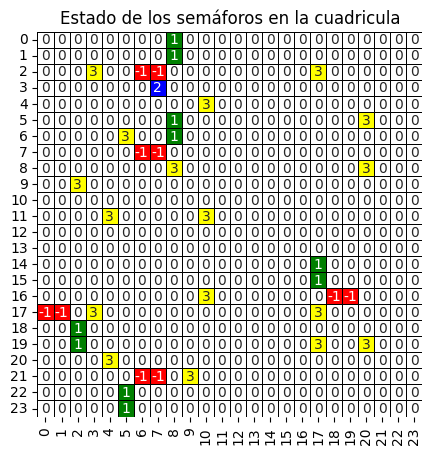

posicion: (3, 7)


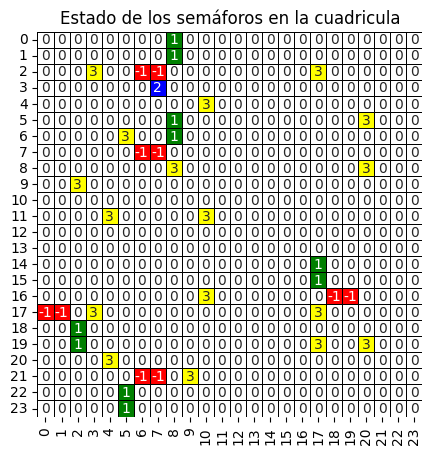

posicion: (3, 7)


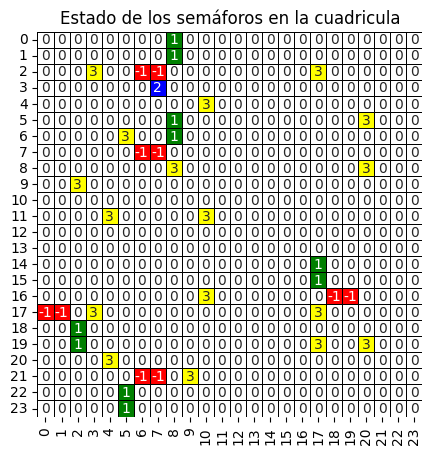

posicion: (3, 7)


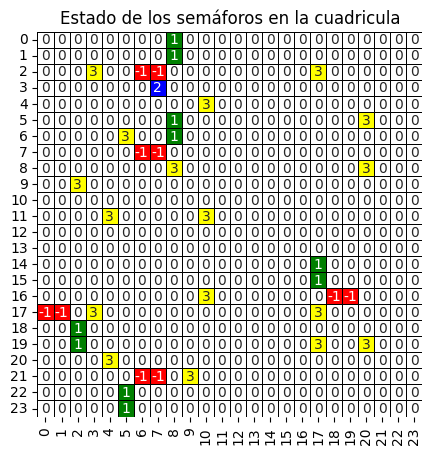

posicion: (3, 7)


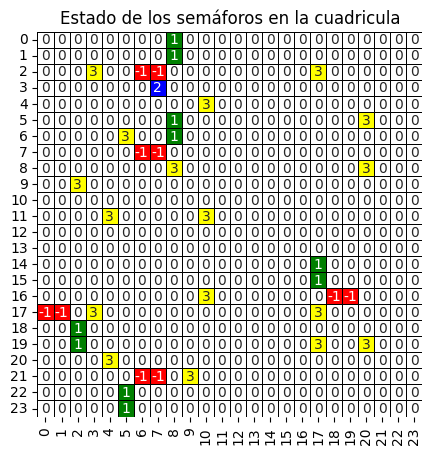

Semaforo 1 cambión de color
Semaforo: 1 | Color: VERDE | Posicion (2, 6)
Semaforo 2 cambión de color
Semaforo: 2 | Color: VERDE | Posicion (2, 7)
Semaforo 3 cambión de color
Semaforo: 3 | Color: VERDE | Posicion (7, 6)
Semaforo 4 cambión de color
Semaforo: 4 | Color: VERDE | Posicion (7, 7)
Semaforo 5 cambión de color
Semaforo: 5 | Color: VERDE | Posicion (17, 0)
Semaforo 6 cambión de color
Semaforo: 6 | Color: VERDE | Posicion (17, 1)
Semaforo 7 cambión de color
Semaforo: 7 | Color: VERDE | Posicion (21, 6)
Semaforo 8 cambión de color
Semaforo: 8 | Color: VERDE | Posicion (21, 7)
Semaforo 9 cambión de color
Semaforo: 9 | Color: VERDE | Posicion (16, 18)
Semaforo 10 cambión de color
Semaforo: 10 | Color: VERDE | Posicion (16, 19)
Semaforo 11 cambión de color
Semaforo: 11 | Color: ROJO | Posicion (0, 8)
Semaforo 12 cambión de color
Semaforo: 12 | Color: ROJO | Posicion (1, 8)
Semaforo 13 cambión de color
Semaforo: 13 | Color: ROJO | Posicion (5, 8)
Semaforo 14 cambión de color
Semaforo:

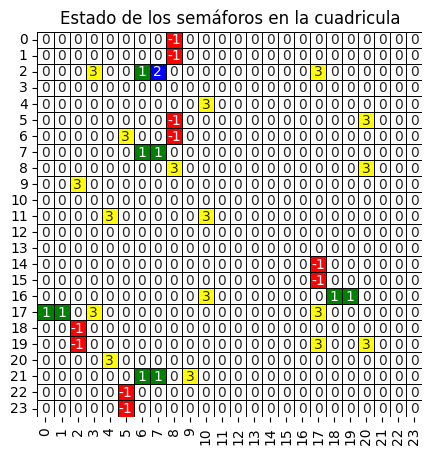

posicion: (2, 7)
[(1, 7)]


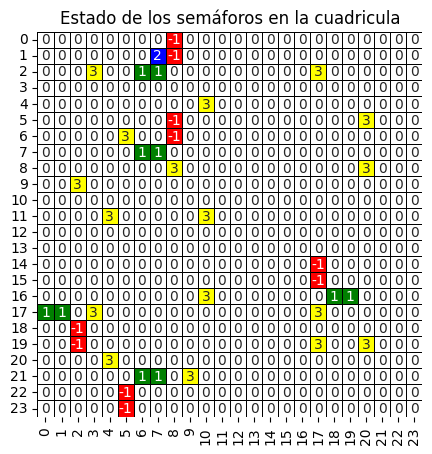

posicion: (1, 7)
[(1, 6)]


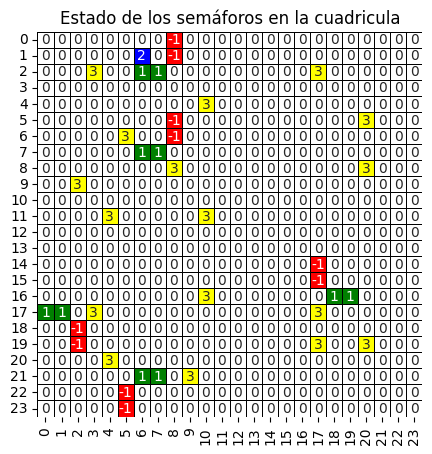

posicion: (1, 6)
[(1, 5)]


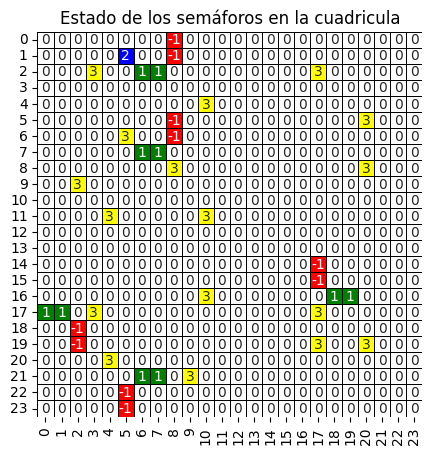

posicion: (1, 5)
[(1, 4)]


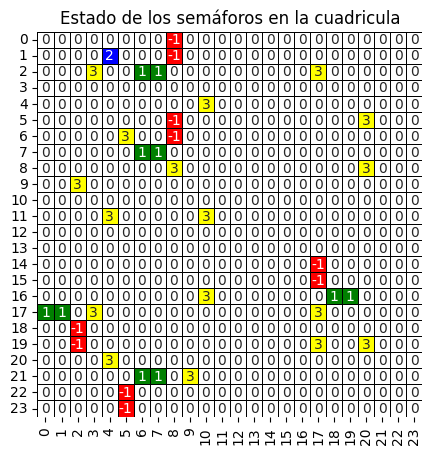

posicion: (1, 4)
[(1, 3)]


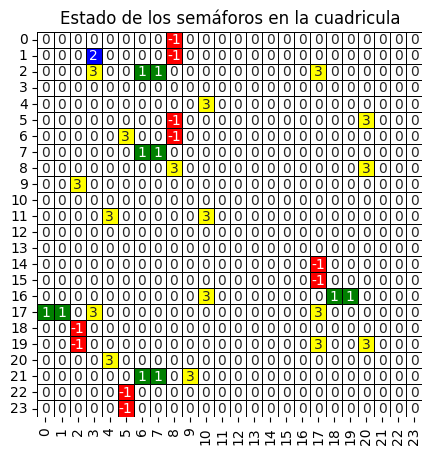

posicion: (1, 3)
[(1, 2)]


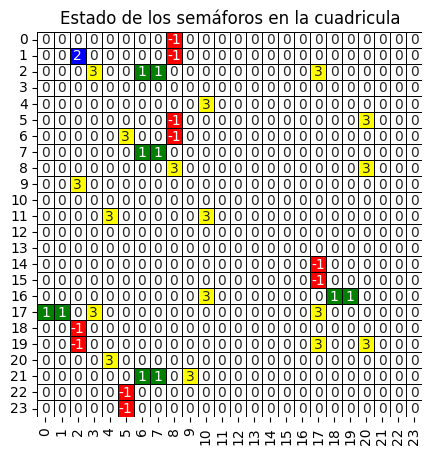

posicion: (1, 2)
[(1, 1)]


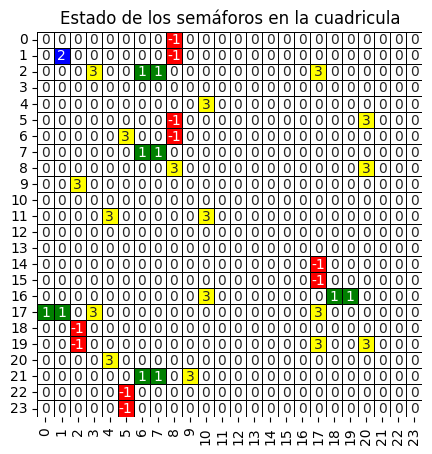

posicion: (1, 1)
[(1, 0)]


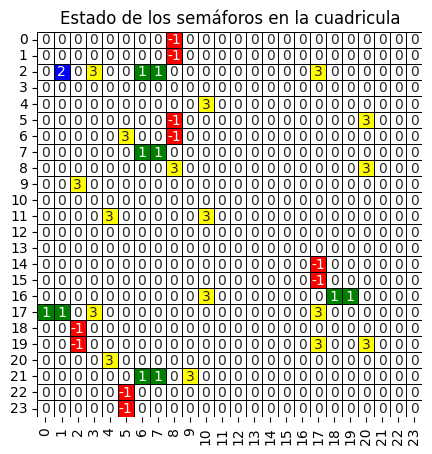

posicion: (2, 1)
[(3, 1)]


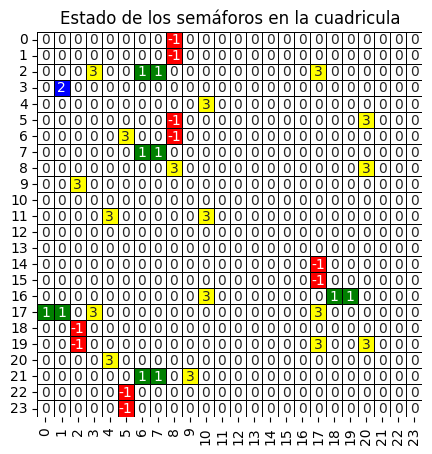

posicion: (3, 1)
[(4, 1)]


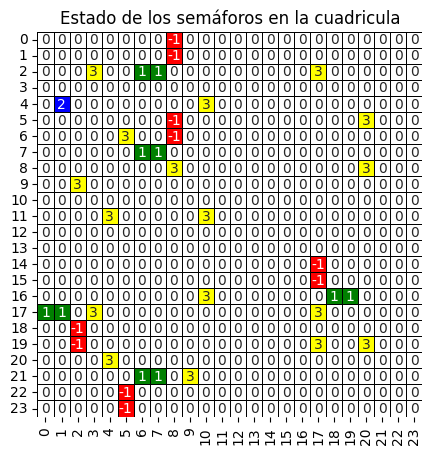

posicion: (4, 1)
[(5, 1)]


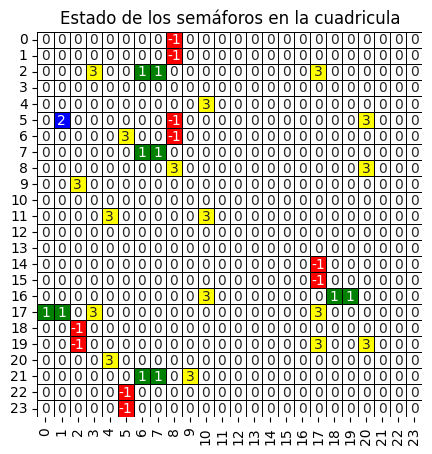

posicion: (5, 1)
[(6, 1)]


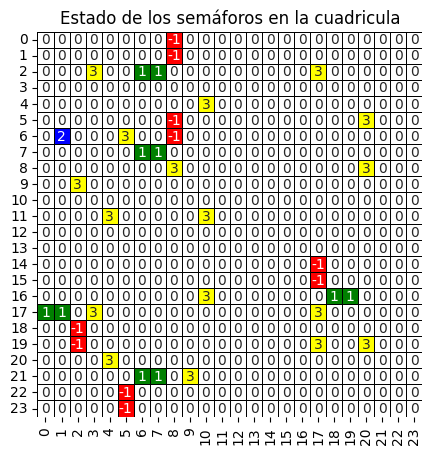

posicion: (6, 1)
[(7, 1)]


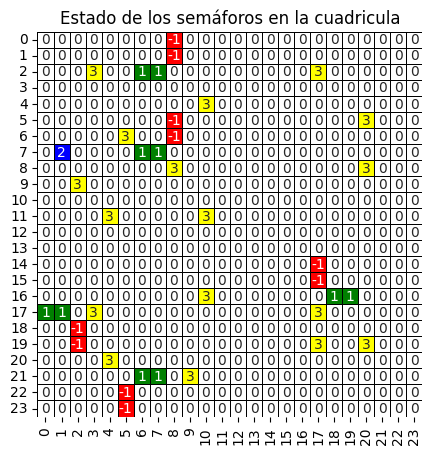

posicion: (7, 1)
[(8, 1)]


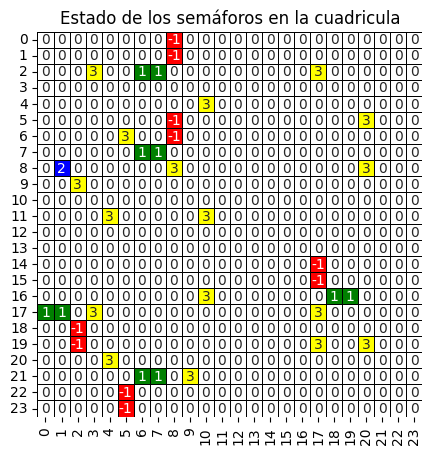

posicion: (8, 1)
[(9, 1)]


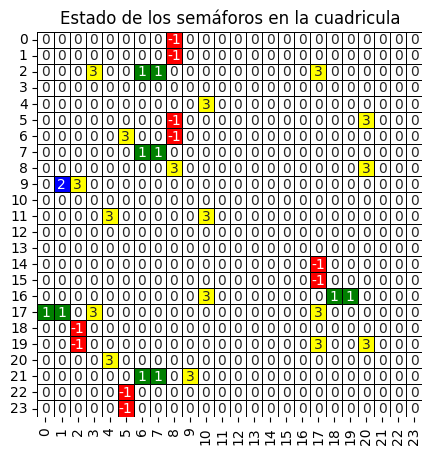

posicion: (9, 1)
[(10, 1)]


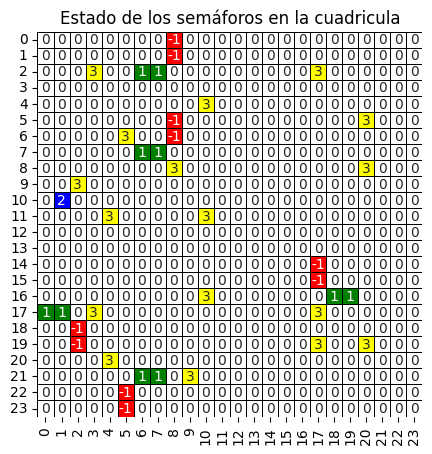

posicion: (10, 1)
[(11, 1)]


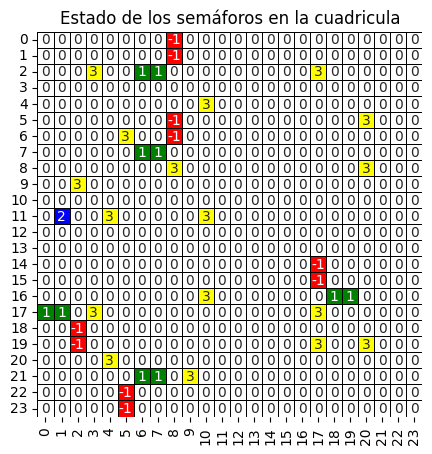

posicion: (11, 1)
[(12, 1)]


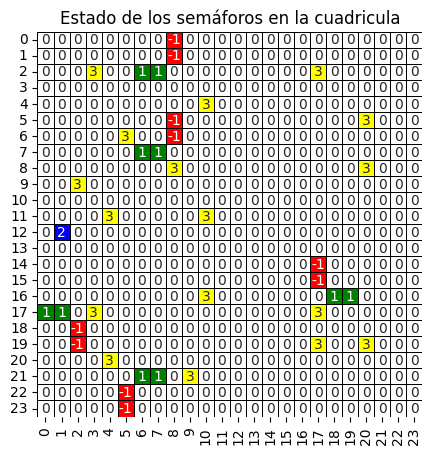

posicion: (12, 1)
[(13, 1)]


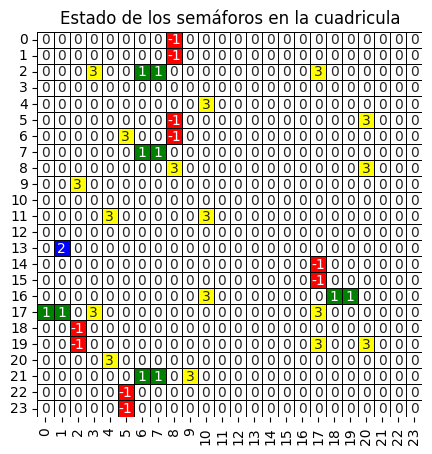

posicion: (13, 1)
[(14, 1)]


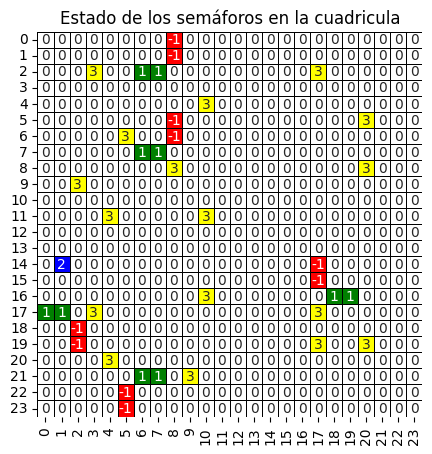

posicion: (14, 1)
[(14, 2)]


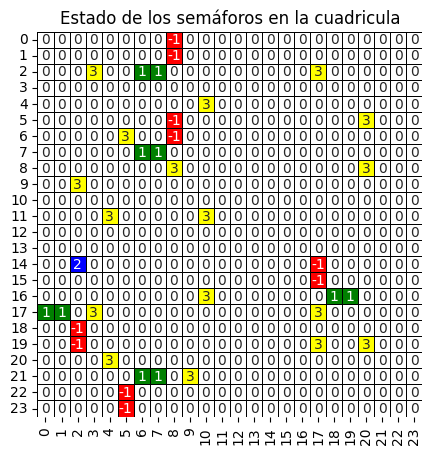

posicion: (14, 2)
[(14, 3)]


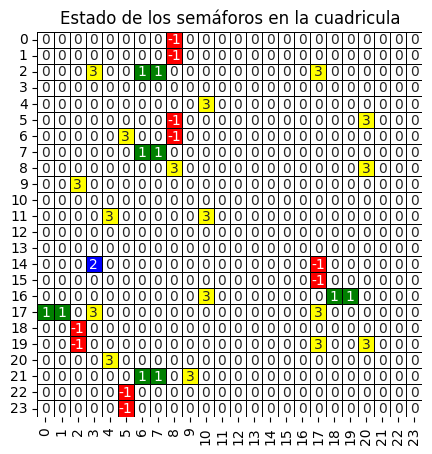

posicion: (14, 3)
[(14, 4)]


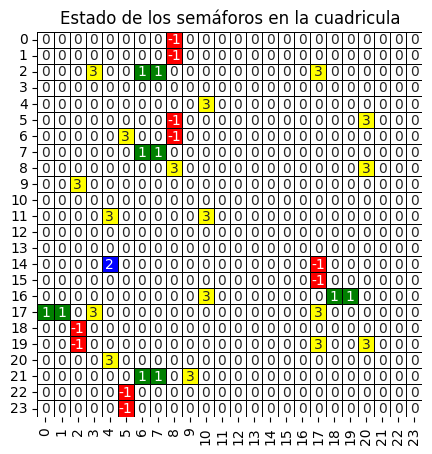

posicion: (14, 4)
[(14, 5)]


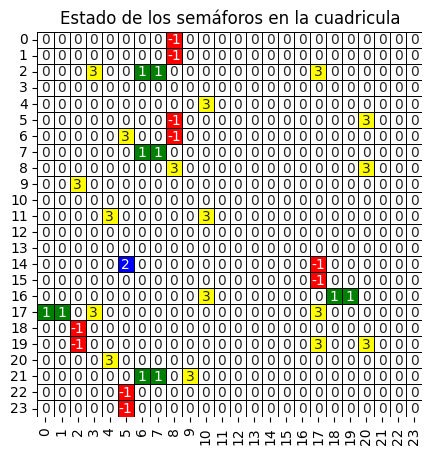

posicion: (14, 5)
[(14, 6)]


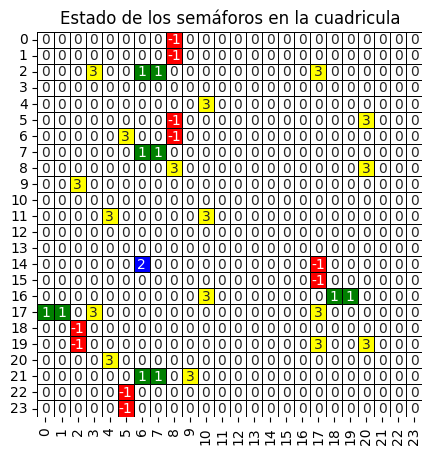

posicion: (14, 6)
[(14, 7)]


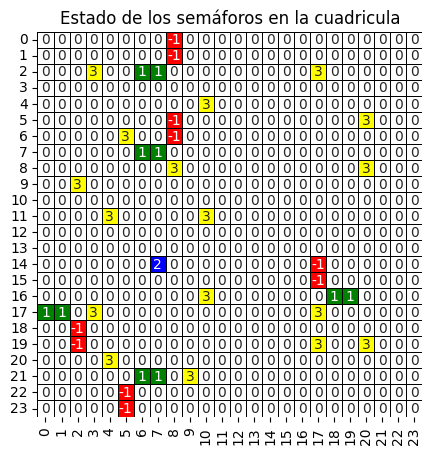

posicion: (14, 7)
[(14, 8)]


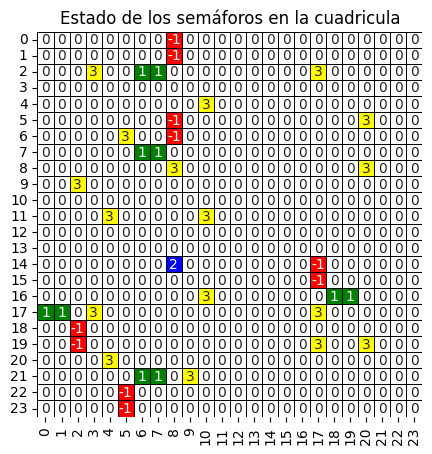

posicion: (14, 8)
[(14, 9)]


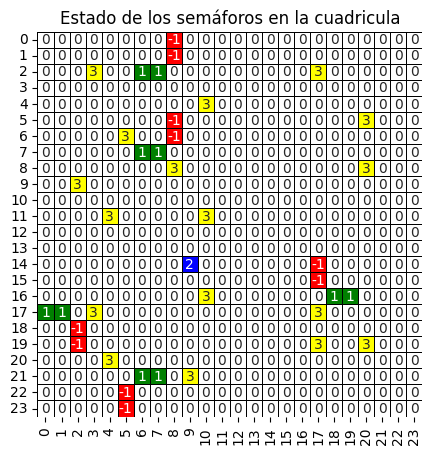

posicion: (14, 9)
[(14, 10)]


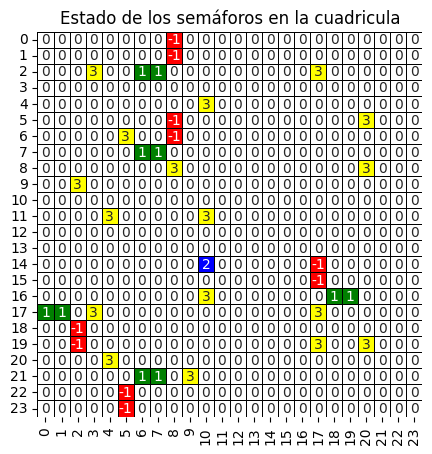

posicion: (14, 10)
[(14, 11)]


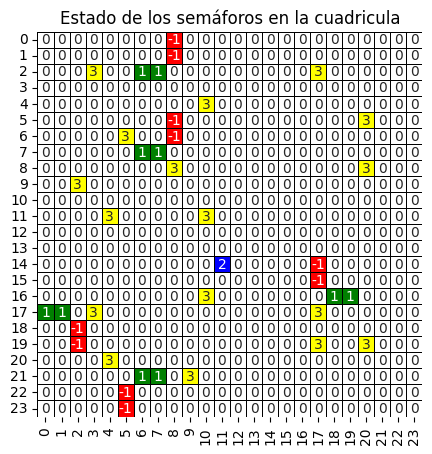

posicion: (14, 11)
[(14, 12)]


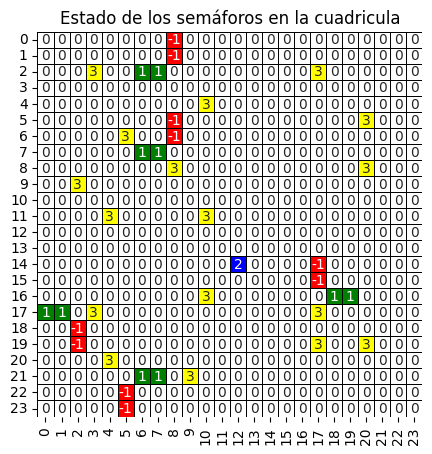

posicion: (14, 12)
[(15, 12)]


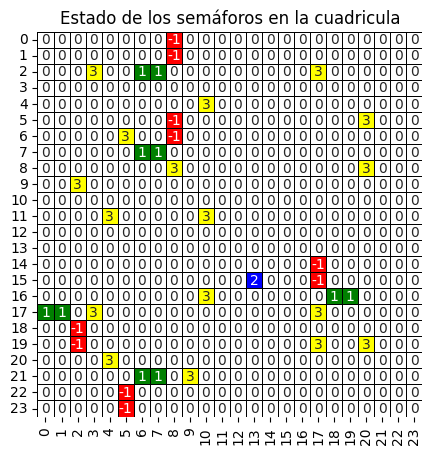

posicion: (15, 13)
[(15, 14)]


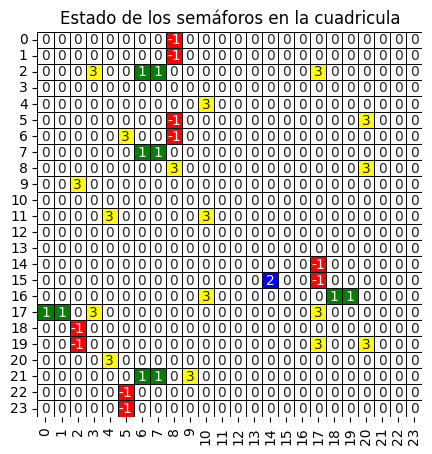

posicion: (15, 14)
[(15, 15)]


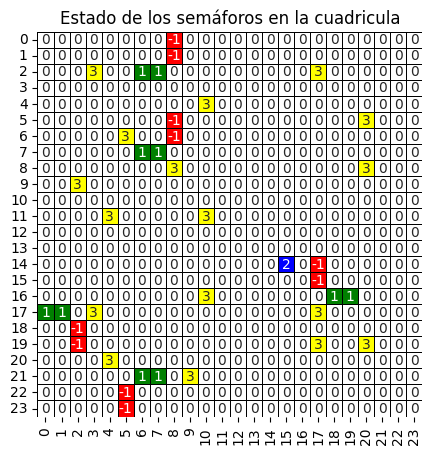

posicion: (14, 15)
[(14, 16)]


KeyboardInterrupt: 

In [ ]:
show_agents()
while m.parked!=m.carsNum:
  m.step()
  show_agents()

# Mostrar todos los agentes
Código del tutorial de MESA

In [ ]:
agent_counts = np.zeros((m.grid.width, m.grid.height))
for cell_content, (x, y) in m.grid.coord_iter():
    agent_count = len(cell_content)
    agent_counts[x][y] = agent_count
# Plot using seaborn, with a visual size of 5x5

g = sns.heatmap(agent_counts, cmap="viridis", annot=True, cbar=False, square=True)
g.figure.set_size_inches(5, 5)
g.set(title="number of agents on each cell of the grid");